In [7]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

import pandas as pd
import matplotlib.image as mpimg
import glob
import re

import scipy.optimize
import numba
import emcee

from tqdm.notebook import tqdm

import sys
sys.path.append('../')
from functions import *

In [8]:
show_details = True

In [17]:
@numba.njit
def deflection_small_angle(param, x, L):
    """
    Calculates the deflection profile using the analytic
    results obtained with the small angle approximation.
    
    The two endpoints of the profile are at (0,0) and (L,0).
    
    Parameters
    ----------
    param : array_like
        Mechanical parameters at the pole.
        
    x : float or numpy array
        Positions where the deflection is evaluated.
        
    L : float
        End-to-end distance of the curved beam.
        
    
    Returns
    -------
    y : float or numpy array
        Deflection amounts at positions `x`.
    """
            
    # Unpack the parameters
    Rx, M0, Ry = param
    
    if (M0 == 0) and (Ry == 0):
        Fc = np.pi**2/L**2
        k = np.sqrt(Fc)
        y = Rx * np.sin(k*x) # Rx here is used as a multiplicative factor;
                             # its real value is Fc
        return y

    if Rx == 0:
        y = L/2*(M0 - Ry*L/3)*x - M0/2*x**2 + Ry/6*x**3
    elif Rx < 0.0:
        k = np.sqrt(-Rx)
        y_part1 = Ry/Rx*(x-L*np.sinh(k*x)/np.sinh(k*L))
        y_part2 = -M0/Rx*((1-np.exp(-k*x)) - (1-np.exp(-k*L))*np.sinh(k*x)/np.sinh(k*L))
        y = y_part1 + y_part2
    else:
        k = np.sqrt(Rx)
        y = M0/Rx*np.cos(k*x) + (M0/Rx*(1-np.cos(k*L)) - Ry/Rx*L)/np.sin(k*L)*np.sin(k*x) + Ry/Rx*x - M0/Rx
        
    return y


@numba.njit
def residual_small_angle(param, x_dat, y_dat, L, Rx_zero=False, M0_zero=False, Ry_zero=False):
    """
    Calculates the differences between the measured deflection
    values and those predicted by the analytical model with 
    specified parameters `param`.

    Parameters
    ----------
    param : array_like
        Mechanical parameters at the pole.
    
    x_dat : float or numpy array
        Measured x-positions of a k-fiber profile.
    
    y_dat : float or numpy array
        Measured y-positions of a k-fiber profile.
    
    L : float
        End-to-end distance of the curved beam.
    
    Rx_zero : boolean
        If True, the Rx value is set to zero, irrespective of the input value.
        
    M0_zero : boolean
        If True, the M0 value is set to zero, irrespective of the input value.
        
    Ry_zero : boolean
        If True, the Ry value is set to zero, irrespective of the input value.
        
        
    Returns
    -------
    res : float or numpy array
        Difference between measured and predicted deflection values.
    """
    
    # Unpack the parameters
    Rx, M0, Ry = param
    
    if Rx_zero:
        Rx = 0
    if Ry_zero:
        Ry = 0
    if M0_zero:
        M0 = 0
        
    param = Rx, M0, Ry
        
    # Deflection values predicted by the model
    y_mod = deflection_small_angle(param, x_dat, L)
        
    res = distances_pair_min_new(x_dat, y_dat, x_dat, y_mod)
    
    return res


@numba.njit
def logpost_small_angle(param, x_dat, y_dat, Rx_zero=False, M0_zero=False, Ry_zero=False):
    
    # Unpack the parameters
    Rx, M0, Ry = param
    
    # Make sure parameters do not wander far during MCMC
    if np.max(np.abs(param)) > 1e2:
        return -np.inf
    
    L = x_dat[-1] - x_dat[0]
    
    Fc = np.pi**2/L**2
    if Rx > 1.3*Fc:
        return -np.inf
    
    if M0 < 0:
        return -np.inf
    
    M1 = M0 - Ry*L
    if M1 < 0:
        return -np.inf
    
    res = residual_small_angle(param, x_dat, y_dat, L, Rx_zero=Rx_zero, M0_zero=M0_zero, Ry_zero=Ry_zero)
    
    return -5*np.log(np.sqrt(np.sum(res**2)))

In [18]:
@numba.njit
def deflection_exact(param, x_dat, y_dat, L, n_div=100):
    """
    Calculates the deflection profile of the k-fiber
    using the exact nonlinear expression of curvature 
    in the Euler-Bernoulli equation.
    
    Parameters
    ----------
    param : array_like
        Mechanical parameters at the pole, along with the starting k-fiber
        angle relative to the pole-kinetochore axis.
        
    x_dat : float or numpy array
        Measured x-positions of a k-fiber profile.
    
    y_dat : float or numpy array
        Measured y-positions of a k-fiber profile.
        
    L : float
        End-to-end distance of the curved beam.
        
    n_div : int
        Number of small divisions in the generated k-fiber profile in the
        `length_conserved=True` case. When `length_conserved=False`, up to
        4 times more divisions are allowed.
    
    
    Returns
    -------
    x_ls : numpy array
        x-positions of the predicted profile.
        
    y_ls : numpy array
        y-positions of the predicted profile.
    """
    
    Rx, M0, Ry, theta0 = param
    
    s_dat_ls, L_contour = contour_fn(x_dat, y_dat)
    ds = L_contour/n_div
    n_steps = int(1.15*n_div)
    
    
    theta_ls = np.zeros(n_steps)
    theta_ls[0] = theta0
    
    x_ls = np.zeros(n_steps)
    y_ls = np.zeros(n_steps)

    for i in range(1,n_steps):
        M = M0 + Rx*y_ls[i-1] - Ry*x_ls[i-1]
        theta_mid = theta_ls[i-1] - ds/2*M
        y_mid = y_ls[i-1] + ds/2*np.sin(theta_mid)
        x_mid = x_ls[i-1] + ds/2*np.cos(theta_mid)

        M_mid = M0 + Rx*y_mid - Ry*x_mid
        theta_ls[i] = theta_ls[i-1] - ds*M_mid
        x_ls[i] = x_ls[i-1] + ds*np.cos(theta_mid)
        y_ls[i] = y_ls[i-1] + ds*np.sin(theta_mid)
    
    return x_ls, y_ls

@numba.njit
def res_fn_exact(param, x_dat, y_dat, L,\
                 Rx_zero=False, M0_zero=False, Ry_zero=False):
    
    Rx, M0, Ry, theta0 = param
    
    if Rx_zero:
        Rx = 0
    if M0_zero:
        M0 = 0
    if Ry_zero:
        Ry = 0
    
    param = Rx, M0, Ry, theta0
    
    x_mod, y_mod = deflection_exact(param, x_dat, y_dat, L)
    
    res = distances_pair_min_new(x_dat, y_dat, x_mod, y_mod)
            
    return res

@numba.njit
def logpost_exact(param, x_dat, y_dat, L,\
                  Rx_zero=False, M0_zero=False, Ry_zero=False, end_to_end=np.inf):
    
    # Unpack the parameters
    Rx, M0, Ry, theta0 = param
    
    # Make sure parameters do not wander far during MCMC
    if np.max(np.abs(param)) > 1e2:
        return -np.inf
    
    if M0_zero:
        M0 = 0
    if Ry_zero:
        Ry = 0
        
    if M0 < 0:
        return -np.inf
    
    M1 = M0 - Ry*L
    if M1 < 0:
        return -np.inf
    
    Fc = np.pi**2/L**2
    if Rx > 1.3*Fc:
        return -np.inf
    
    res = res_fn_exact(param, x_dat, y_dat, L, Rx_zero=Rx_zero, M0_zero=M0_zero, Ry_zero=Ry_zero)
    
    penalty_end_match = 1+(res[-1]/end_to_end)**2
    
    return -10*( np.log(np.sum(res**2)) + np.log(penalty_end_match) )

In [19]:
cols = ['Rx', 'M0', 'Ry', 'theta0'] # Parameter names for MCMC inference
n_dim = len(cols) # Number of parameters in the model

n_walkers = 10   # number of MCMC walkers
n_steps = 10000    # number of MCMC steps during each filtering round
sigma_start = 0.02 # standard deviation of the random multiplying factor centered
                   # around 1, used to randomize the initial positions of the walkers
end_to_end = 0.01  # End-to-end distance for end-matching

path = "../../dat/WT unmanipulated k-fiber shapes/"
cells = sorted(glob.glob("%s/*"%path))
cells = [cell for cell in cells if not 'Icon' in cell]

Fx_only
20171215_cell004 0
pole_left 14.979744078254473
P-K distance (L) =  6.39 um
Initial angle =  10.26 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 396.90it/s]


Exact method error (mcmc): 0.0258
Small-angle error: 0.0255


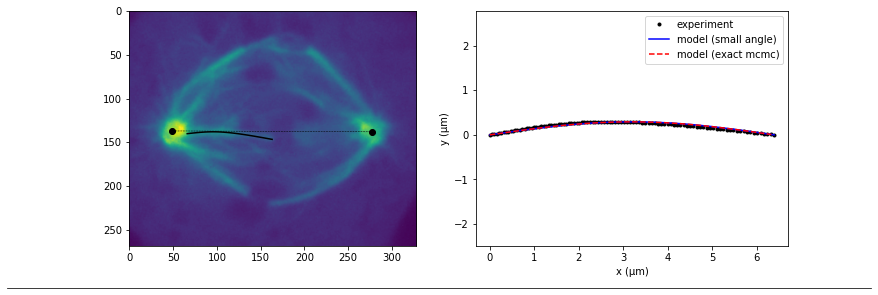

Fx_only
20171215_cell004 1
pole_right 14.979744078254473
P-K distance (L) =  6.69 um
Initial angle =  4.86 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 396.11it/s]


Exact method error (mcmc): 0.0073
Small-angle error: 0.0037


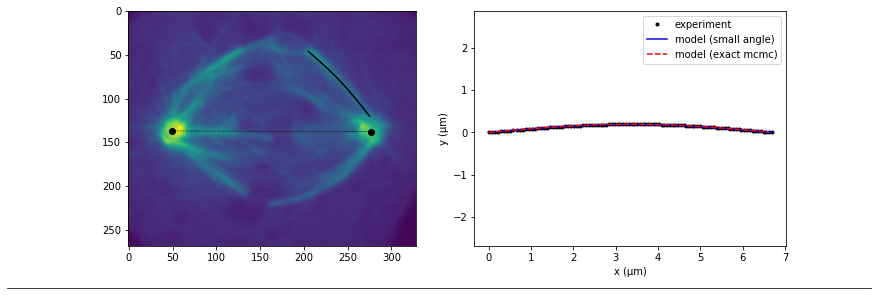

Fx_only
20171215_cell004 2
pole_right 14.979744078254473
P-K distance (L) =  8.38 um
Initial angle =  22.45 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 397.51it/s]


Exact method error (mcmc): 0.0369
Small-angle error: 0.0337


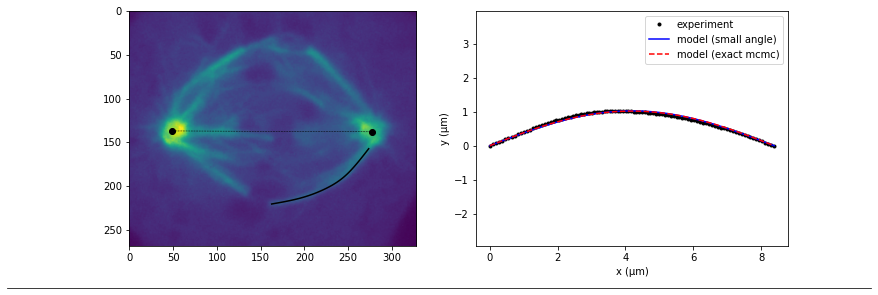

Fx_only
20171215_cell004 3
pole_right 14.979744078254473
P-K distance (L) =  8.35 um
Initial angle =  28.00 degrees


100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 381.29it/s]


Exact method error (mcmc): 0.0494
Small-angle error: 0.0528


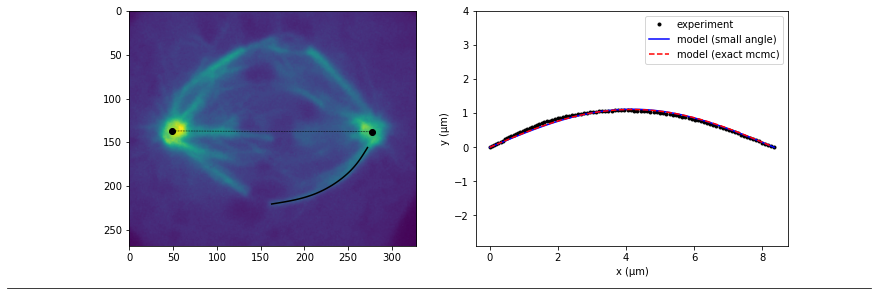

Fx_only
20171215_cell004a 0
pole_left 14.3883
P-K distance (L) =  8.23 um
Initial angle =  21.61 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 392.27it/s]


Exact method error (mcmc): 0.0441
Small-angle error: 0.0446


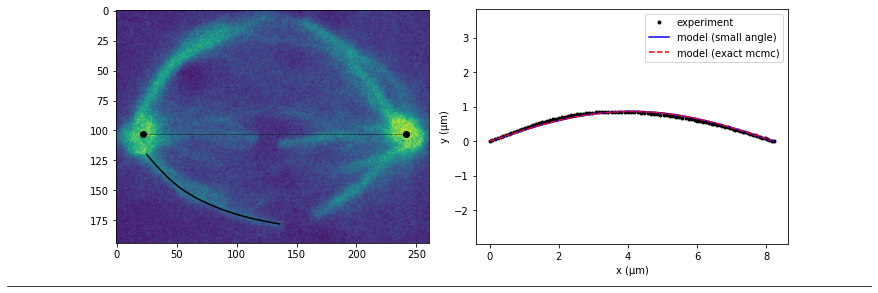

Fx_only
20171215_cell004a 1
pole_right 14.3883
P-K distance (L) =  5.78 um
Initial angle =  5.82 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 389.89it/s]


Exact method error (mcmc): 0.0083
Small-angle error: 0.0092


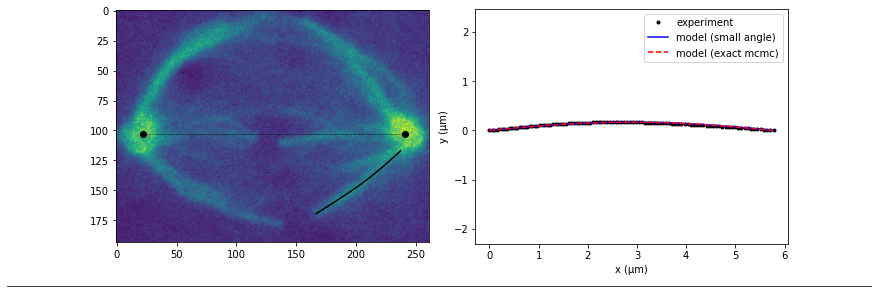

Fx_only
20171215_cell005 0
pole_left 13.807007798940361
P-K distance (L) =  6.22 um
Initial angle =  25.90 degrees


100%|████████████████████████████████████| 10000/10000 [00:23<00:00, 426.00it/s]


Exact method error (mcmc): 0.0472
Small-angle error: 0.0475


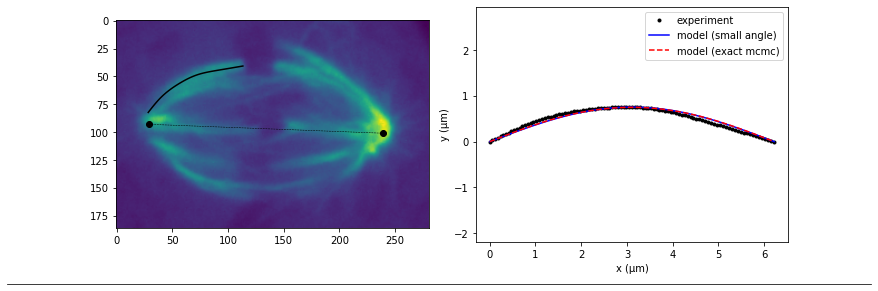

Fx_only
20171215_cell005 1
pole_right 13.807007798940361
P-K distance (L) =  7.42 um
Initial angle =  17.45 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 399.75it/s]


Exact method error (mcmc): 0.0206
Small-angle error: 0.0192


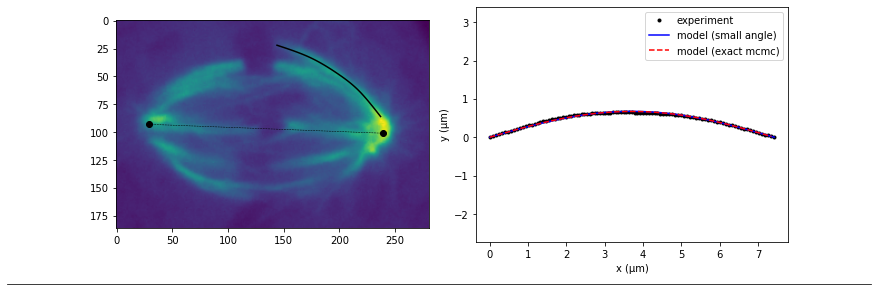

Fx_only
20171215_cell005 2
pole_right 13.807007798940361
P-K distance (L) =  5.44 um
Initial angle =  15.00 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 399.21it/s]


Exact method error (mcmc): 0.0301
Small-angle error: 0.0299


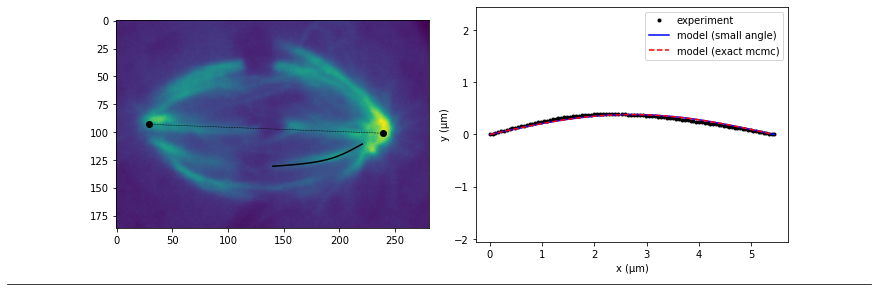

Fx_only
20171219_cell003 0
pole_left 16.766377403899746
P-K distance (L) =  8.12 um
Initial angle =  9.10 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 396.11it/s]


Exact method error (mcmc): 0.0121
Small-angle error: 0.0092


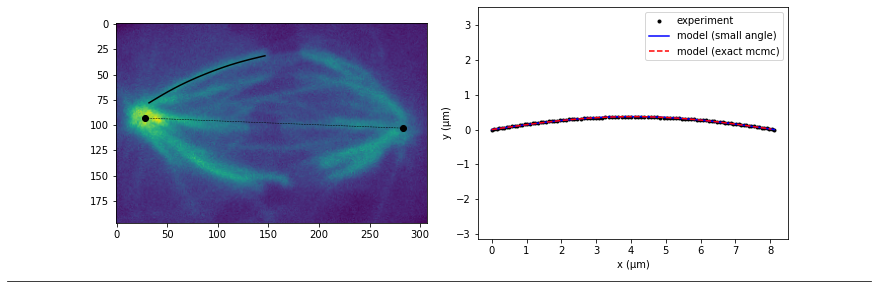

Fx_only
20171219_cell003 1
pole_left 16.766377403899746
P-K distance (L) =  5.50 um
Initial angle =  8.75 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 395.14it/s]


Exact method error (mcmc): 0.0104
Small-angle error: 0.0113


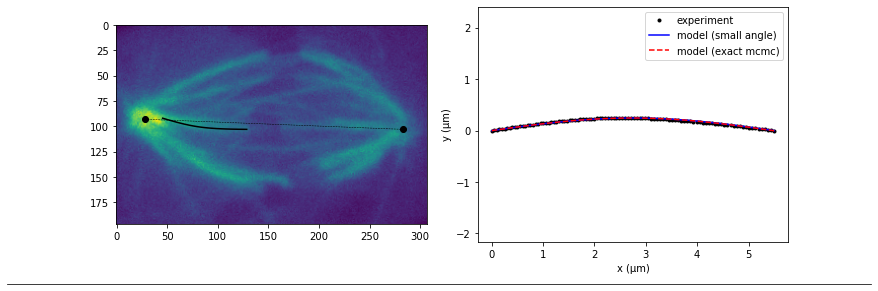

Fx_only
20180611_cell002 0
pole_left 14.283473842171588
P-K distance (L) =  6.64 um
Initial angle =  22.71 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 392.15it/s]


Exact method error (mcmc): 0.0573
Small-angle error: 0.0577


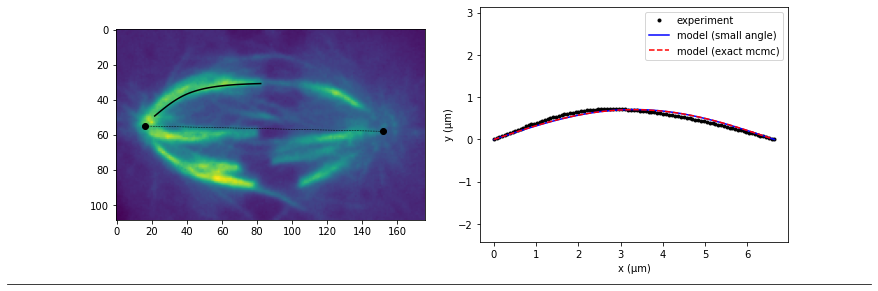

Fx_only
20180611_cell002 1
pole_left 14.283473842171588
P-K distance (L) =  6.59 um
Initial angle =  21.91 degrees


100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 382.84it/s]


Exact method error (mcmc): 0.0274
Small-angle error: 0.0266


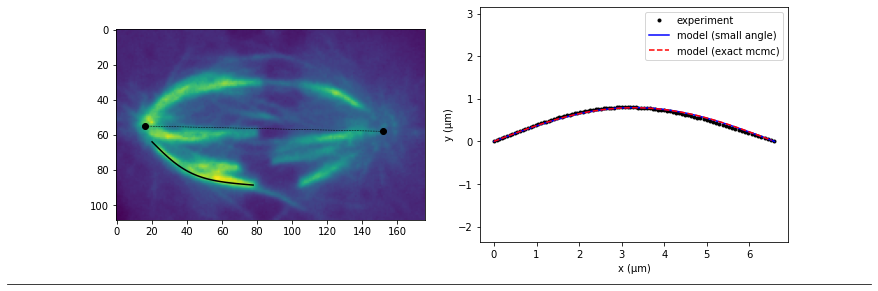

Fx_only
20180611_cell002 2
pole_left 14.283473842171588
P-K distance (L) =  6.59 um
Initial angle =  21.91 degrees


100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 378.79it/s]


Exact method error (mcmc): 0.0274
Small-angle error: 0.0266


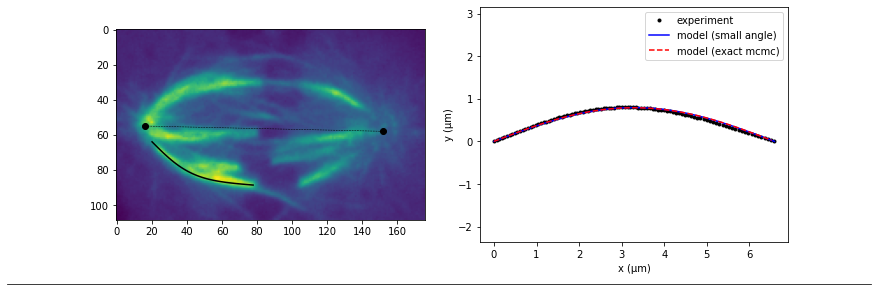

Fx_only
20180612_cell001 0
pole_left 14.806489286795841
P-K distance (L) =  7.85 um
Initial angle =  21.07 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 389.37it/s]


Exact method error (mcmc): 0.0349
Small-angle error: 0.0331


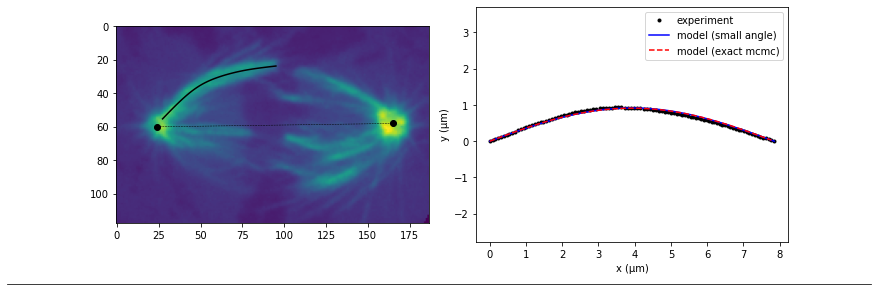

Fx_only
20180612_cell001 1
pole_left 14.806489286795841
P-K distance (L) =  4.69 um
Initial angle =  11.81 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 390.34it/s]


Exact method error (mcmc): 0.0370
Small-angle error: 0.0370


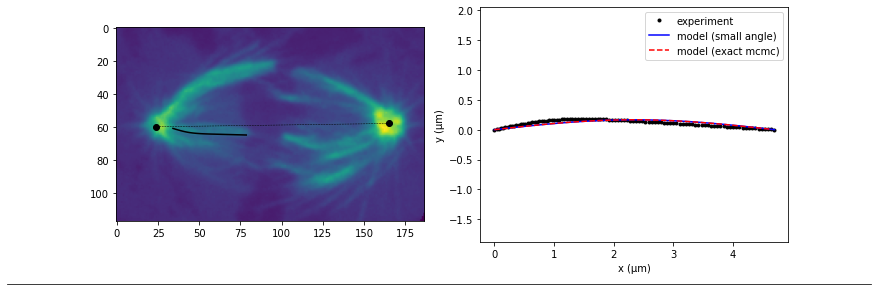

Fx_only
20180612_cell003 0
pole_left 13.021693438259096
P-K distance (L) =  5.70 um
Initial angle =  23.85 degrees


100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 371.44it/s]


Exact method error (mcmc): 0.0416
Small-angle error: 0.0427


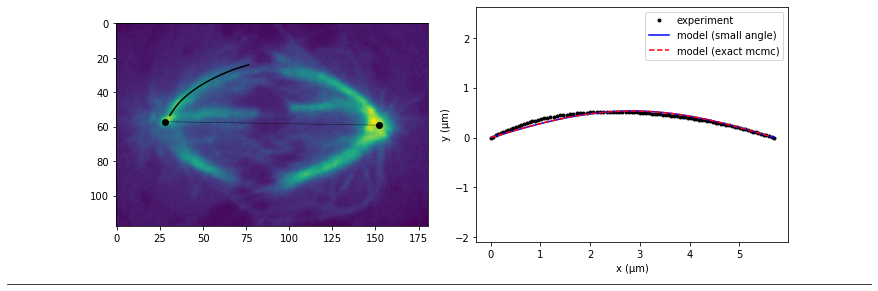

Fx_only
20180612_cell003 1
pole_left 13.021693438259096
P-K distance (L) =  4.84 um
Initial angle =  15.69 degrees


100%|████████████████████████████████████| 10000/10000 [00:30<00:00, 323.83it/s]


Exact method error (mcmc): 0.0544
Small-angle error: 0.0543


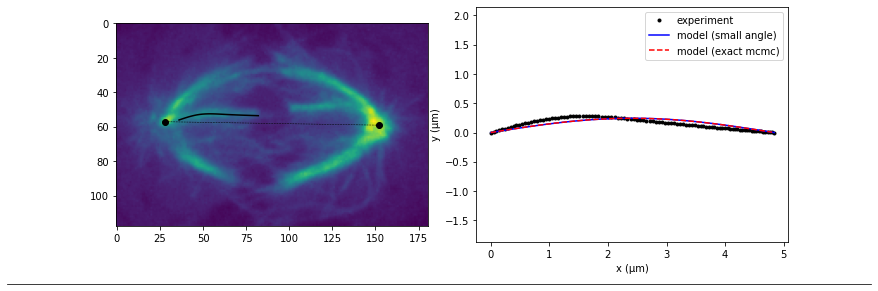

Fx_only
20180612_cell003 2
pole_right 13.021693438259096
P-K distance (L) =  5.89 um
Initial angle =  23.08 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 395.36it/s]


Exact method error (mcmc): 0.0340
Small-angle error: 0.0350


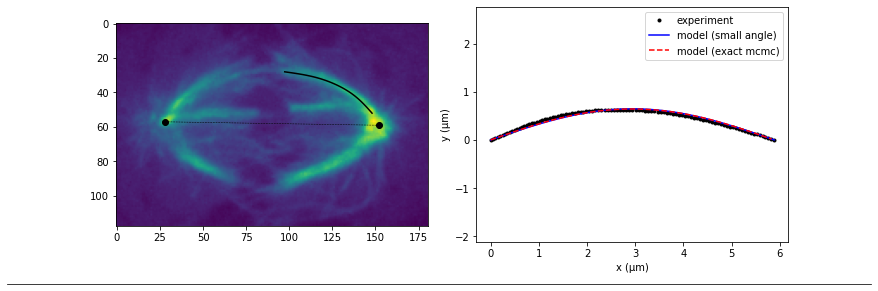

Fx_only
20180620_cell013 0
pole_left 14.625561527681594
P-K distance (L) =  5.89 um
Initial angle =  4.07 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 398.44it/s]


Exact method error (mcmc): 0.0099
Small-angle error: 0.0101


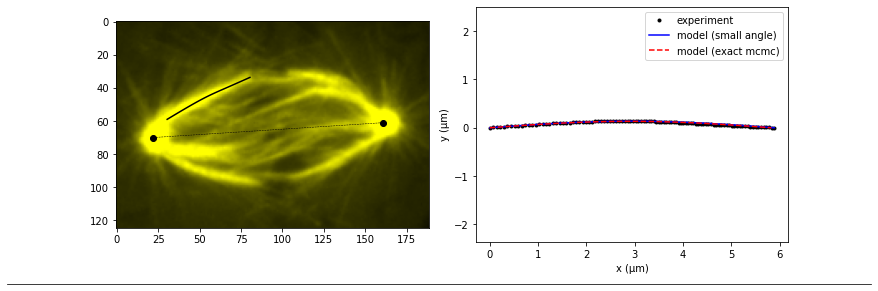

Fx_only
20180620_cell013 1
pole_left 14.625561527681594
P-K distance (L) =  6.28 um
Initial angle =  16.50 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 401.10it/s]


Exact method error (mcmc): 0.0389
Small-angle error: 0.0391


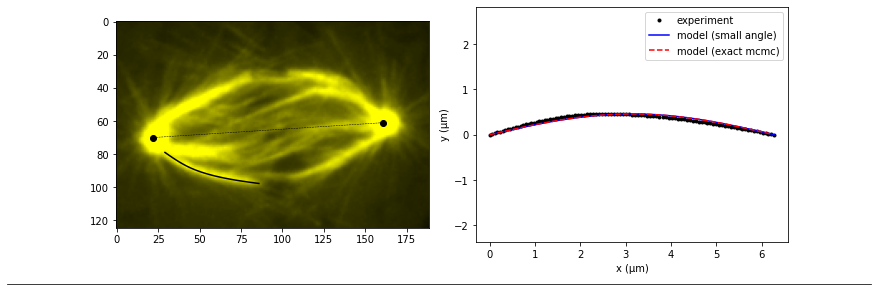

Fx_only
20180620_cell013 2
pole_right 14.625561527681594
P-K distance (L) =  6.07 um
Initial angle =  7.39 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 399.84it/s]


Exact method error (mcmc): 0.0355
Small-angle error: 0.0339


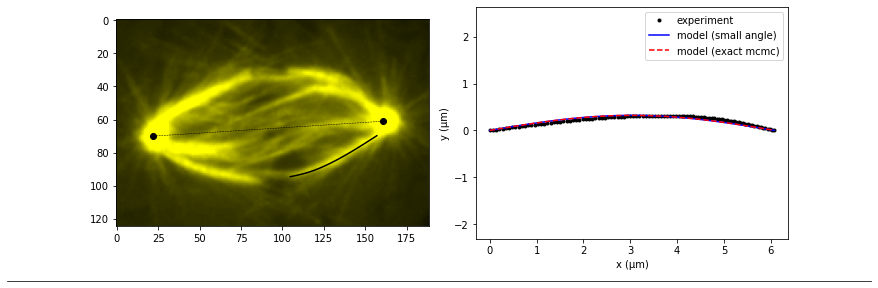

Fx_only
20180622_cell015 0
pole_left 16.388411301892564
P-K distance (L) =  7.51 um
Initial angle =  18.18 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 388.17it/s]


Exact method error (mcmc): 0.0730
Small-angle error: 0.0734


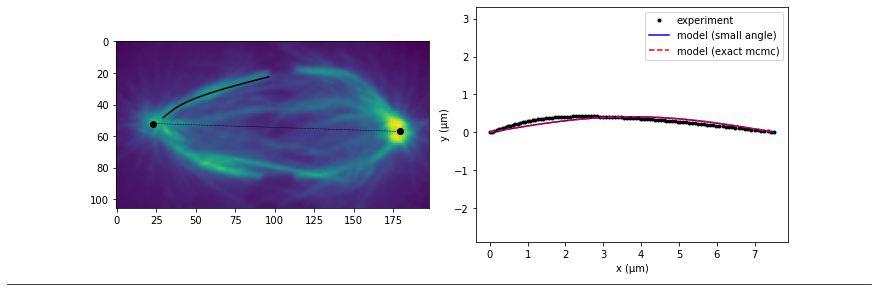

Fx_only
20180622_cell015 1
pole_left 16.388411301892564
P-K distance (L) =  7.19 um
Initial angle =  18.74 degrees


100%|████████████████████████████████████| 10000/10000 [00:27<00:00, 368.07it/s]


Exact method error (mcmc): 0.0380
Small-angle error: 0.0380


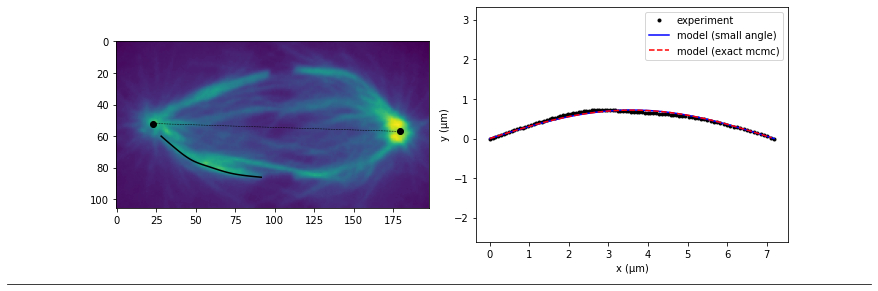

Fx_only
20180622_cell016 0
pole_left 15.225
P-K distance (L) =  6.11 um
Initial angle =  13.57 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 397.69it/s]


Exact method error (mcmc): 0.0149
Small-angle error: 0.0121


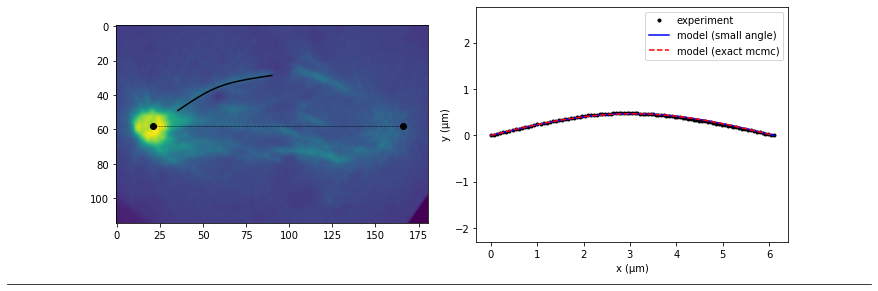

Fx_only
20180622_cell020 0
pole_left 12.401117893157858
P-K distance (L) =  6.69 um
Initial angle =  28.34 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 402.06it/s]


Exact method error (mcmc): 0.0628
Small-angle error: 0.0650


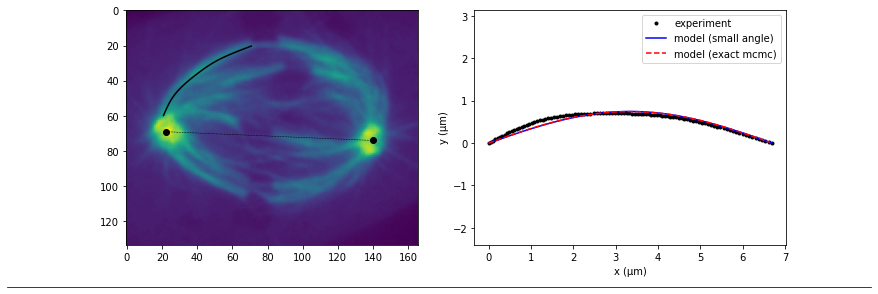

Fx_only
20180622_cell020 1
pole_right 12.401117893157858
P-K distance (L) =  6.03 um
Initial angle =  24.49 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 393.38it/s]


Exact method error (mcmc): 0.0079
Small-angle error: 0.0090


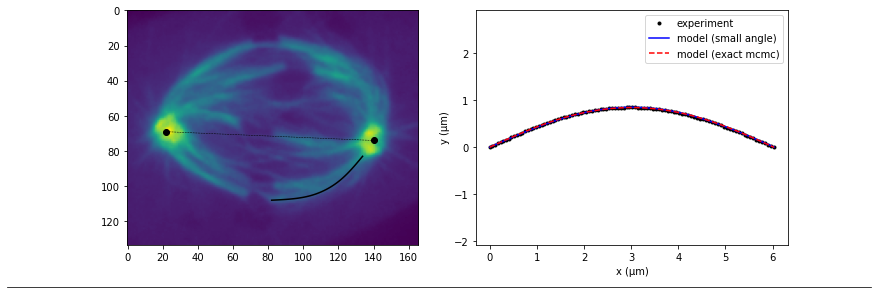

Fx_only
20180622_cell020 2
pole_left 12.401117893157858
P-K distance (L) =  5.00 um
Initial angle =  13.21 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 399.10it/s]


Exact method error (mcmc): 0.0247
Small-angle error: 0.0243


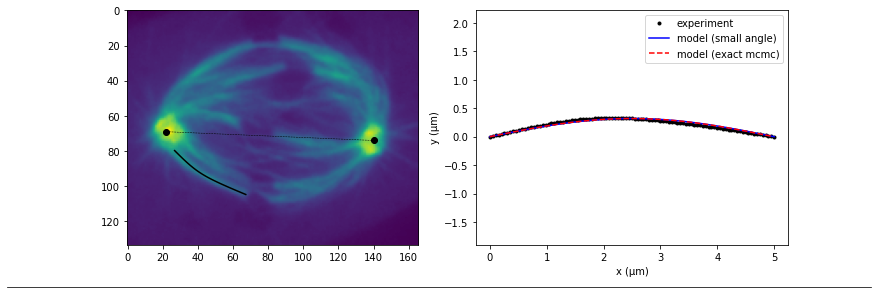

Fx_only
20180622_cell020 3
pole_right 12.401117893157858
P-K distance (L) =  5.47 um
Initial angle =  25.99 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 390.33it/s]


Exact method error (mcmc): 0.0325
Small-angle error: 0.0339


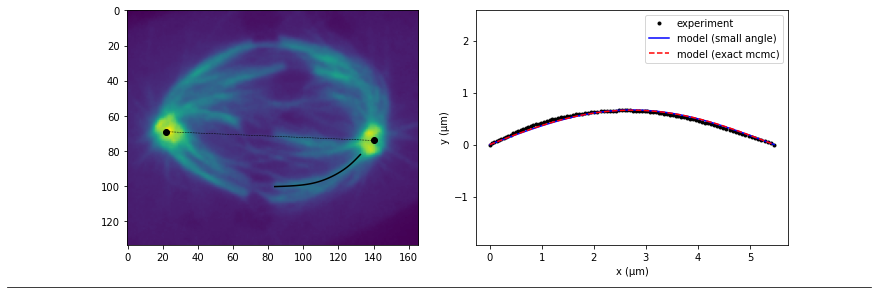

Fx_only
20180622_cell026 0
pole_left 14.598398884809251
P-K distance (L) =  5.74 um
Initial angle =  24.35 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 388.03it/s]


Exact method error (mcmc): 0.0564
Small-angle error: 0.0574


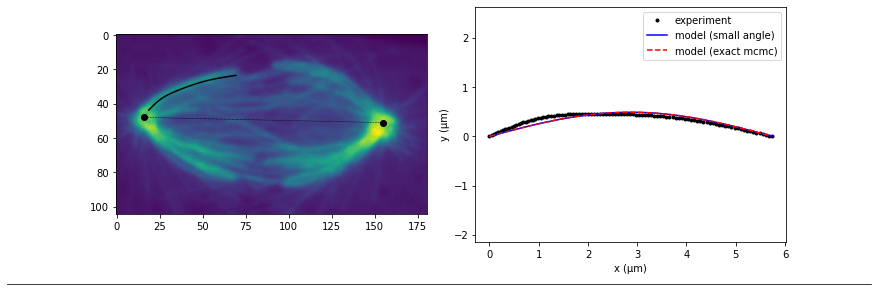

Fx_only
20180622_cell026 1
pole_left 14.598398884809251
P-K distance (L) =  5.88 um
Initial angle =  13.64 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 391.42it/s]


Exact method error (mcmc): 0.0243
Small-angle error: 0.0243


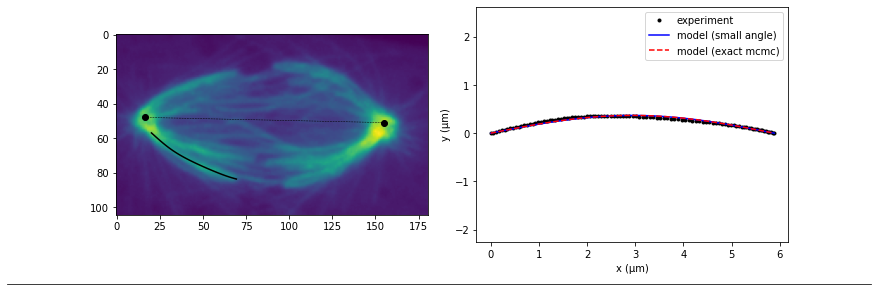

Fx_only
20180622_cell026 2
pole_right 14.598398884809251
P-K distance (L) =  6.41 um
Initial angle =  33.09 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 399.43it/s]


Exact method error (mcmc): 0.0935
Small-angle error: 0.0955


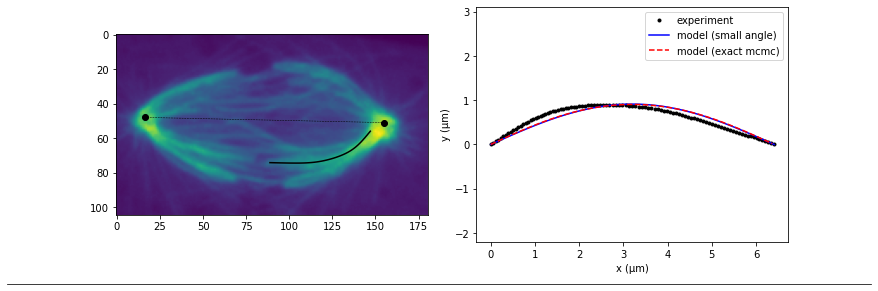

Fx_only
20180622_cell026 3
pole_right 14.598398884809251
P-K distance (L) =  6.13 um
Initial angle =  22.85 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 402.01it/s]


Exact method error (mcmc): 0.0205
Small-angle error: 0.0206


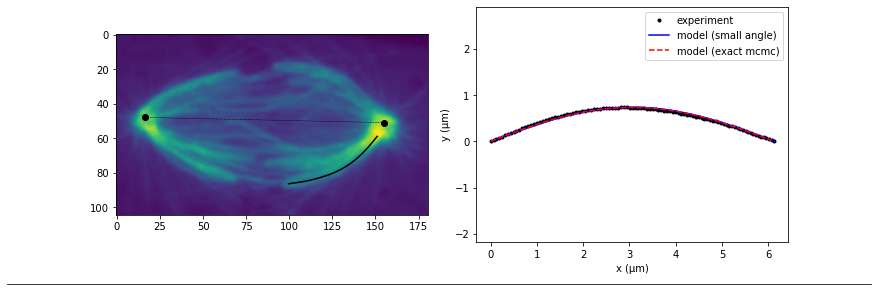

Fx_only
20180622_cell027 0
pole_left 14.181220857175873
P-K distance (L) =  4.89 um
Initial angle =  9.20 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 401.60it/s]


Exact method error (mcmc): 0.0255
Small-angle error: 0.0247


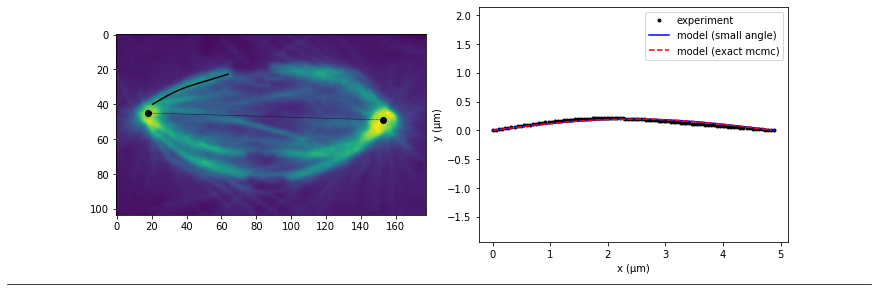

Fx_only
20180622_cell027 1
pole_left 14.181220857175873
P-K distance (L) =  5.44 um
Initial angle =  15.19 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 396.23it/s]


Exact method error (mcmc): 0.0177
Small-angle error: 0.0174


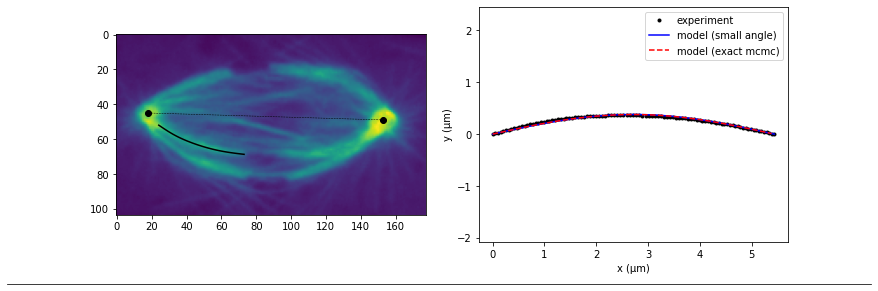

Fx_only
20180622_cell027 2
pole_left 14.181220857175873
P-K distance (L) =  6.23 um
Initial angle =  20.25 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 398.81it/s]


Exact method error (mcmc): 0.0240
Small-angle error: 0.0245


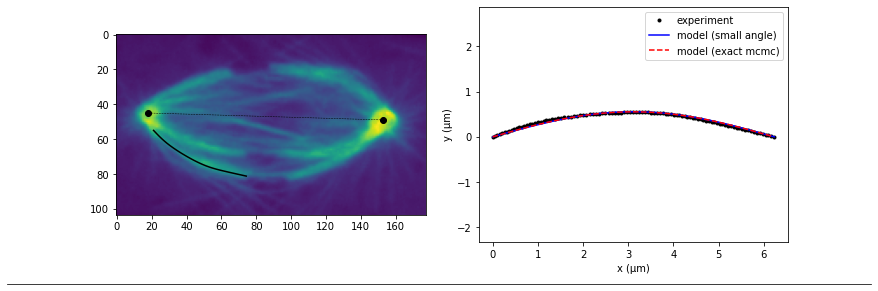

Fx_only
20180622_cell027 3
pole_right 14.181220857175873
P-K distance (L) =  6.82 um
Initial angle =  21.28 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 392.59it/s]


Exact method error (mcmc): 0.0495
Small-angle error: 0.0492


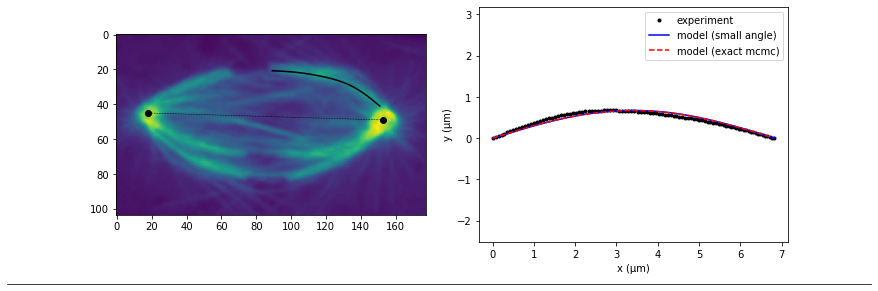

Fx_only
20180622_cell027 4
pole_right 14.181220857175873
P-K distance (L) =  5.78 um
Initial angle =  15.63 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 392.66it/s]


Exact method error (mcmc): 0.0060
Small-angle error: 0.0067


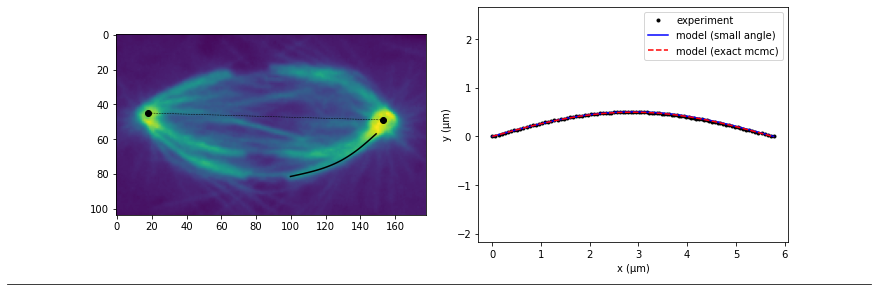

Fx_only
20180622_cell028 0
pole_left 16.907934527907305
P-K distance (L) =  7.63 um
Initial angle =  15.89 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 392.33it/s]


Exact method error (mcmc): 0.0260
Small-angle error: 0.0253


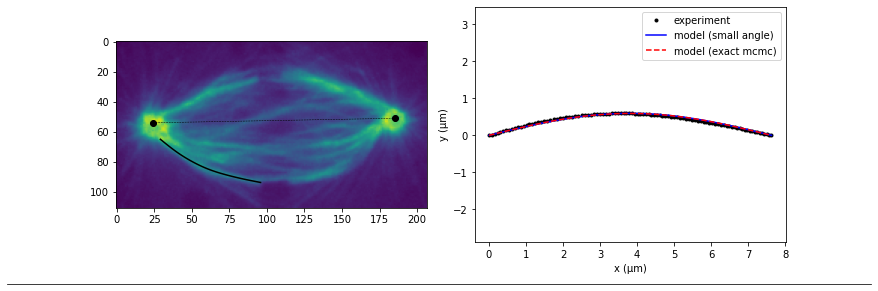

Fx_only
20180622_cell028 1
pole_right 16.907934527907305
P-K distance (L) =  5.90 um
Initial angle =  26.89 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 394.61it/s]


Exact method error (mcmc): 0.0712
Small-angle error: 0.0724


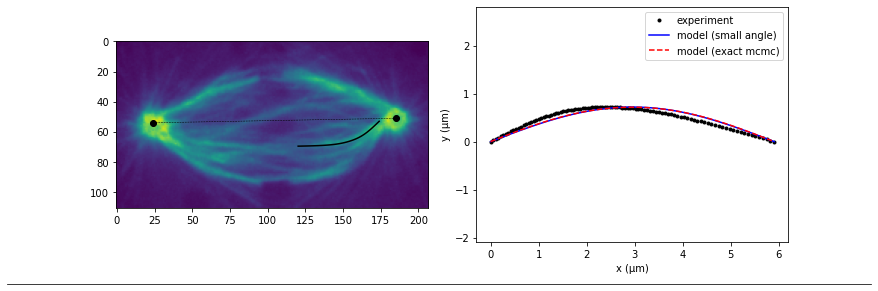

Fx_only
20180622_cell030 0
pole_left 14.071567076910801
P-K distance (L) =  5.60 um
Initial angle =  31.47 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 397.85it/s]


Exact method error (mcmc): 0.0529
Small-angle error: 0.0548


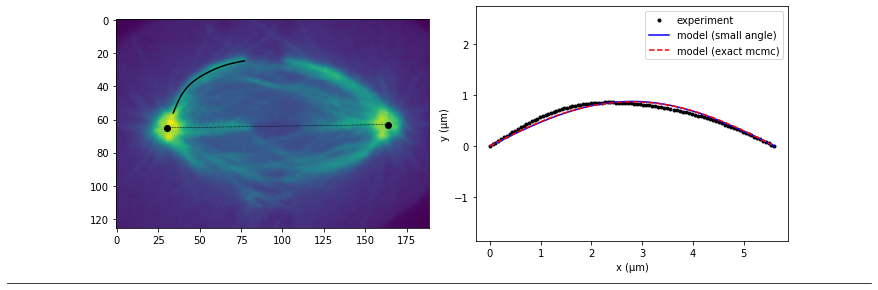

Fx_only
20180622_cell030 1
pole_right 14.071567076910801
P-K distance (L) =  6.70 um
Initial angle =  23.23 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 397.73it/s]


Exact method error (mcmc): 0.0484
Small-angle error: 0.0495


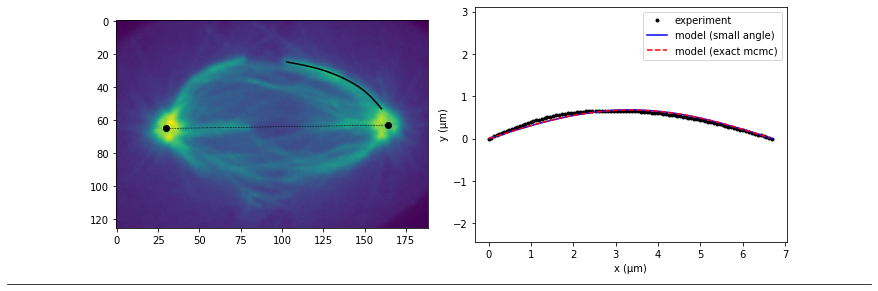

Fx_only
20180626_cell001 0
pole_left 14.286175135423758
P-K distance (L) =  6.04 um
Initial angle =  15.38 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 399.81it/s]


Exact method error (mcmc): 0.0445
Small-angle error: 0.0445


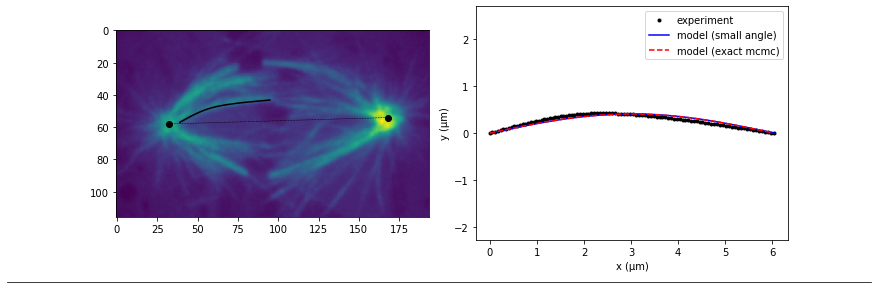

Fx_only
20180626_cell001 1
pole_left 14.286175135423758
P-K distance (L) =  5.18 um
Initial angle =  18.14 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 400.30it/s]


Exact method error (mcmc): 0.0176
Small-angle error: 0.0163


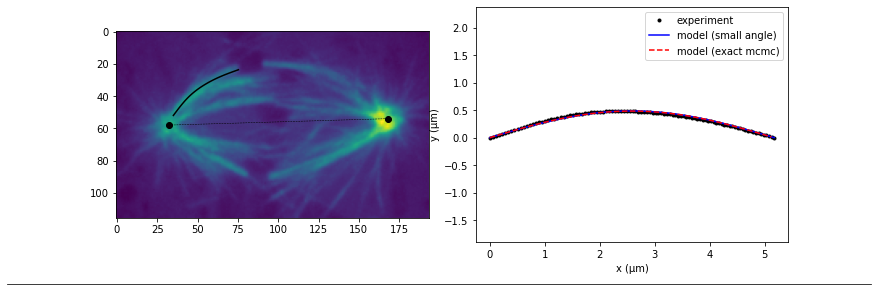

Fx_only
20180626_cell001 2
pole_right 14.286175135423758
P-K distance (L) =  6.93 um
Initial angle =  31.42 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 398.91it/s]


Exact method error (mcmc): 0.0954
Small-angle error: 0.0974


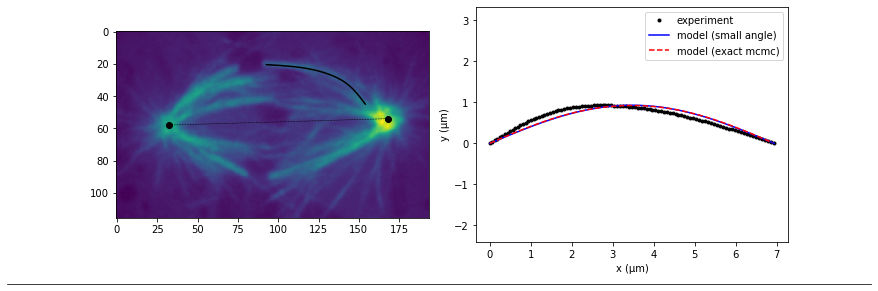

Fx_only
20180628_cell002 0
pole_left 13.236664987828316
P-K distance (L) =  7.16 um
Initial angle =  15.71 degrees


100%|████████████████████████████████████| 10000/10000 [00:27<00:00, 357.55it/s]


Exact method error (mcmc): 0.0147
Small-angle error: 0.0156


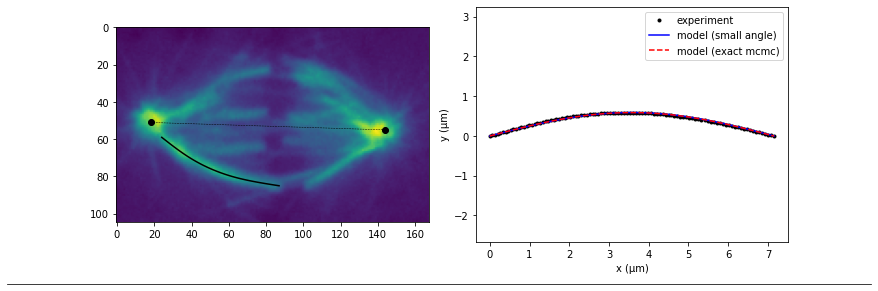

Fx_only
20180628_cell006 0
pole_left 16.826557134482385
P-K distance (L) =  6.16 um
Initial angle =  18.85 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 394.58it/s]


Exact method error (mcmc): 0.0543
Small-angle error: 0.0535


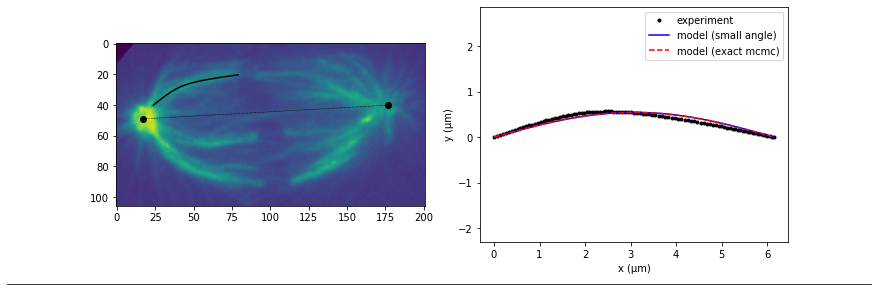

Fx_only
20180628_cell006 1
pole_left 16.826557134482385
P-K distance (L) =  6.62 um
Initial angle =  30.69 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 396.70it/s]


Exact method error (mcmc): 0.1049
Small-angle error: 0.1069


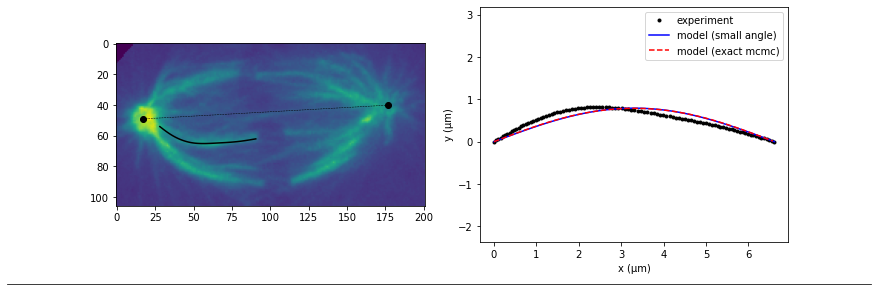

Fx_only
20180628_cell006 2
pole_left 16.826557134482385
P-K distance (L) =  8.07 um
Initial angle =  33.12 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 398.01it/s]


Exact method error (mcmc): 0.1222
Small-angle error: 0.1245


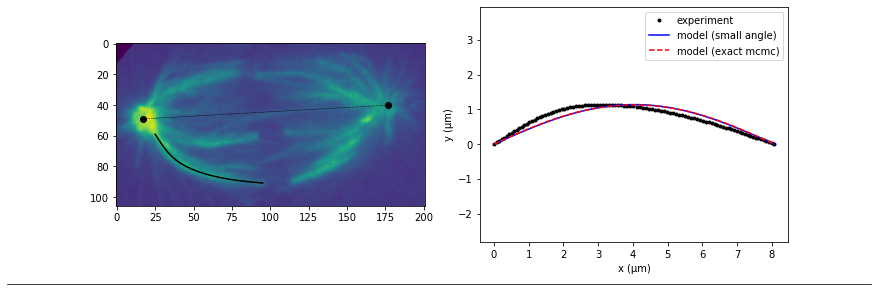

Fx_only
20180628_cell010 0
pole_left 12.8117211958425
P-K distance (L) =  5.65 um
Initial angle =  18.30 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 398.06it/s]


Exact method error (mcmc): 0.0206
Small-angle error: 0.0173


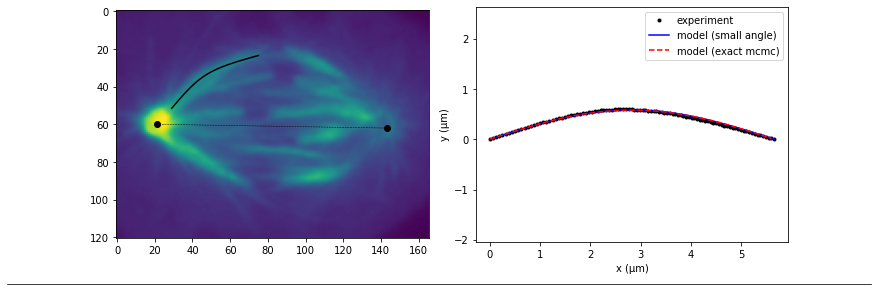

Fx_only
20180628_cell010 1
pole_left 12.8117211958425
P-K distance (L) =  3.77 um
Initial angle =  13.11 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 389.67it/s]


Exact method error (mcmc): 0.0149
Small-angle error: 0.0152


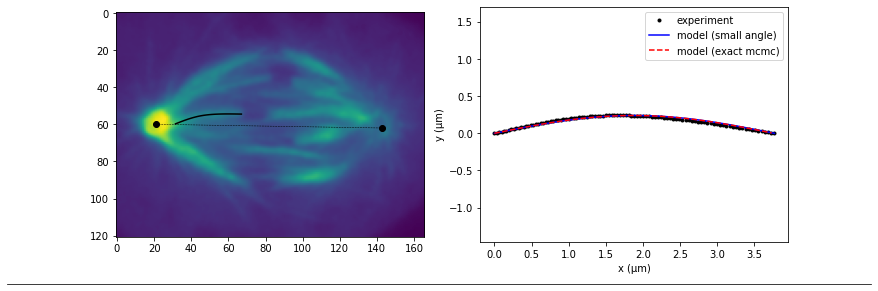

Fx_only
20180628_cell010 2
pole_left 12.8117211958425
P-K distance (L) =  5.36 um
Initial angle =  10.08 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 402.64it/s]


Exact method error (mcmc): 0.0087
Small-angle error: 0.0081


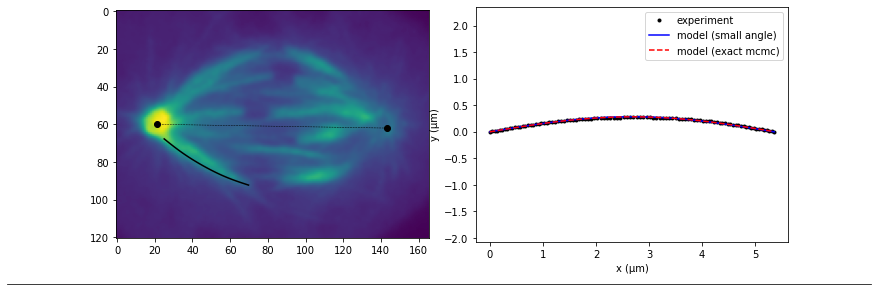

Fx_only
20180628_cell010 3
pole_right 12.8117211958425
P-K distance (L) =  5.25 um
Initial angle =  12.63 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 398.90it/s]


Exact method error (mcmc): 0.0338
Small-angle error: 0.0320


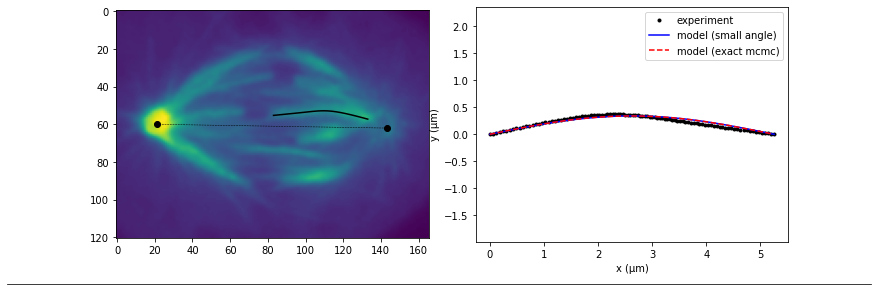

Fx_only
20180628_cell013 0
pole_left 15.015367128378845
P-K distance (L) =  7.91 um
Initial angle =  19.16 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 385.14it/s]


Exact method error (mcmc): 0.0488
Small-angle error: 0.0486


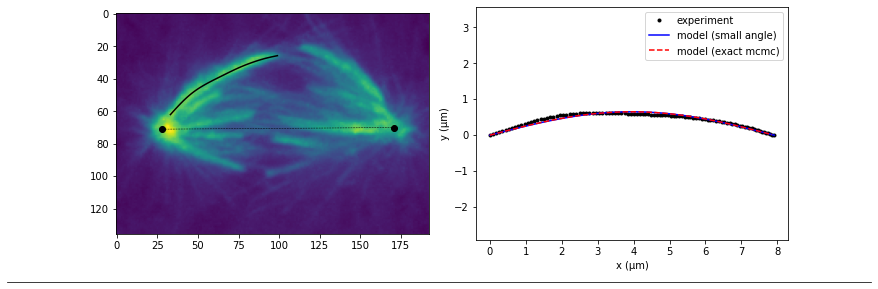

Fx_only
20180628_cell013 1
pole_left 15.015367128378845
P-K distance (L) =  3.82 um
Initial angle =  4.60 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 400.34it/s]


Exact method error (mcmc): 0.0155
Small-angle error: 0.0154


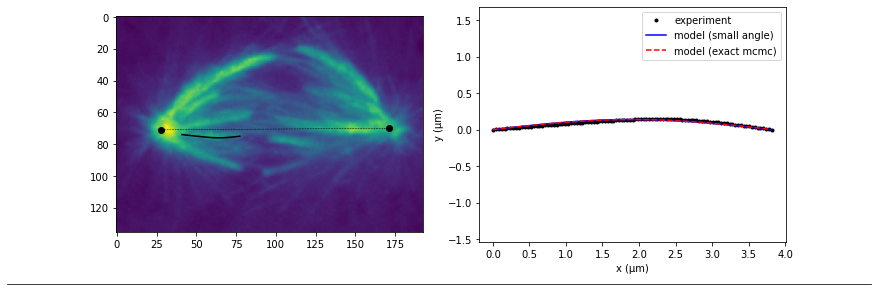

Fx_only
20180628_cell013 2
pole_left 15.015367128378845
P-K distance (L) =  4.54 um
Initial angle =  7.26 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 400.81it/s]


Exact method error (mcmc): 0.0119
Small-angle error: 0.0115


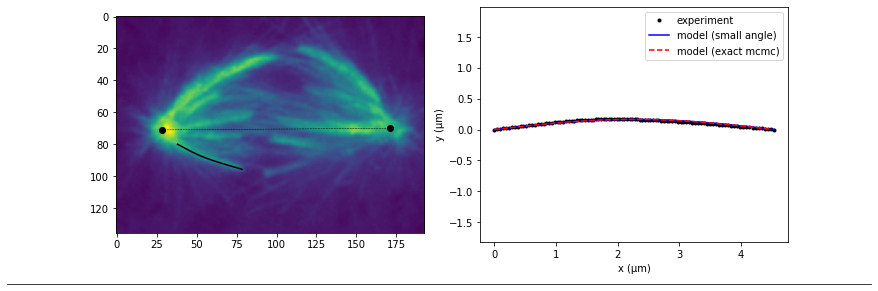

Fx_only
20180628_cell013 3
pole_right 15.015367128378845
P-K distance (L) =  6.59 um
Initial angle =  25.61 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 395.94it/s]


Exact method error (mcmc): 0.0688
Small-angle error: 0.0700


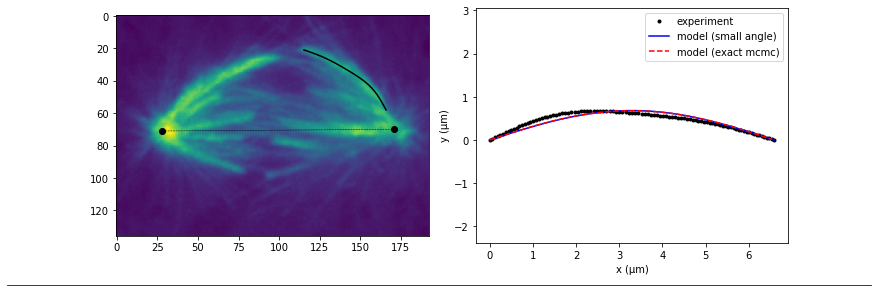

Fx_only
20180628_cell013 4
pole_right 15.015367128378845
P-K distance (L) =  6.37 um
Initial angle =  15.49 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 397.46it/s]


Exact method error (mcmc): 0.0289
Small-angle error: 0.0290


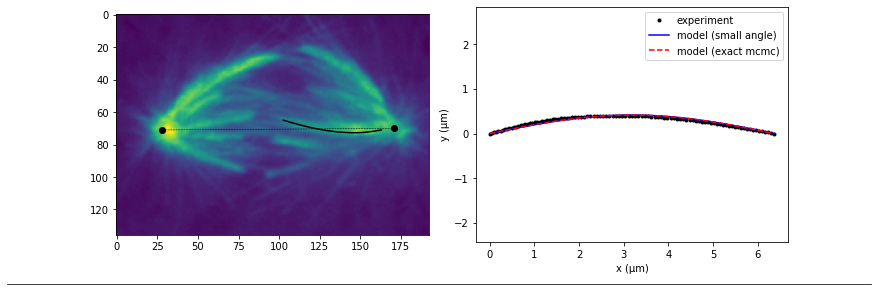

Fx_only
20180810_cell005 0
pole_left 14.527993667399501
P-K distance (L) =  5.53 um
Initial angle =  16.72 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 397.50it/s]


Exact method error (mcmc): 0.0150
Small-angle error: 0.0155


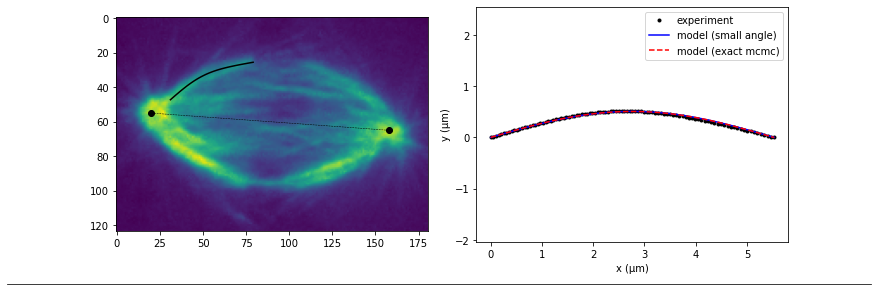

Fx_only
20180810_cell005 1
pole_right 14.527993667399501
P-K distance (L) =  5.86 um
Initial angle =  16.98 degrees


100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 383.16it/s]


Exact method error (mcmc): 0.0383
Small-angle error: 0.0386


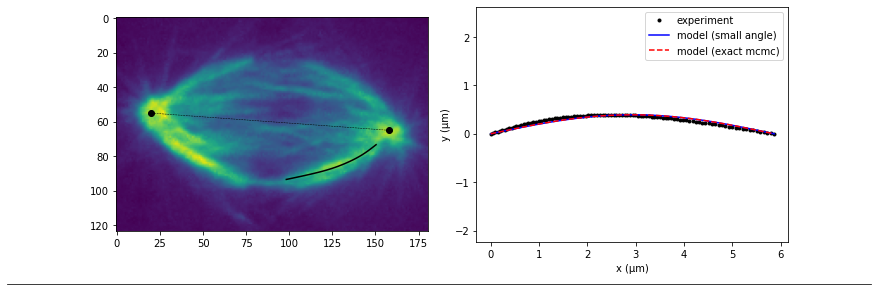

Fx_only
20180810_cell005 2
pole_left 14.527993667399501
P-K distance (L) =  6.05 um
Initial angle =  11.13 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 398.86it/s]


Exact method error (mcmc): 0.0101
Small-angle error: 0.0076


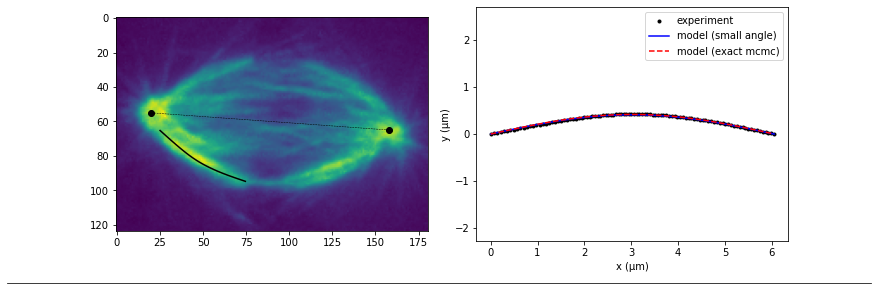

Fx_only
20180810_cell006 0
pole_left 16.811808350085364
P-K distance (L) =  5.45 um
Initial angle =  9.95 degrees


100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 381.13it/s]


Exact method error (mcmc): 0.0131
Small-angle error: 0.0122


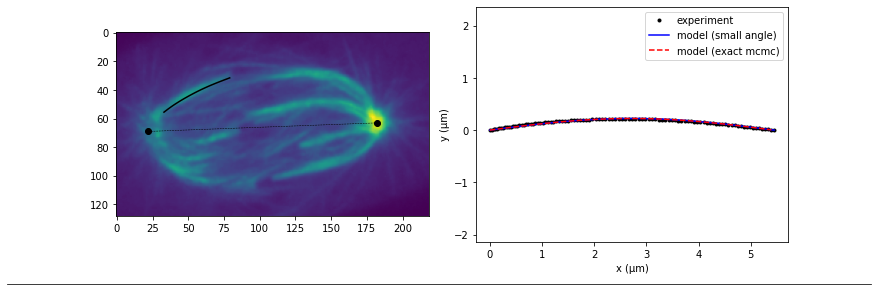

Fx_only
20180810_cell006 1
pole_right 16.811808350085364
P-K distance (L) =  8.93 um
Initial angle =  28.80 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 401.12it/s]


Exact method error (mcmc): 0.1351
Small-angle error: 0.1362


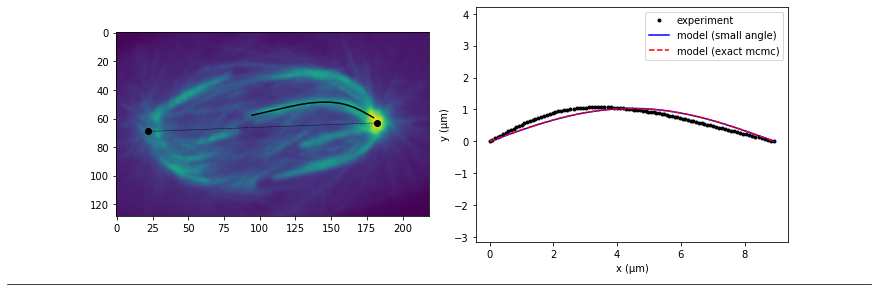

Fx_only
20180810_cell006 2
pole_right 16.811808350085364
P-K distance (L) =  4.95 um
Initial angle =  6.79 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 402.48it/s]


Exact method error (mcmc): 0.0105
Small-angle error: 0.0099


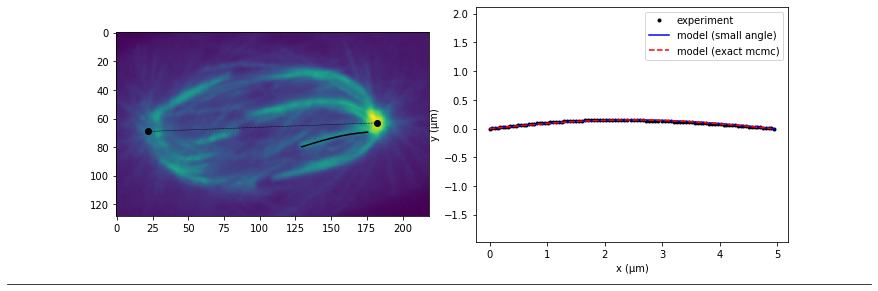

Fx_only
20180810_cell006 3
pole_right 16.811808350085364
P-K distance (L) =  8.32 um
Initial angle =  32.25 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 399.98it/s]


Exact method error (mcmc): 0.1495
Small-angle error: 0.1511


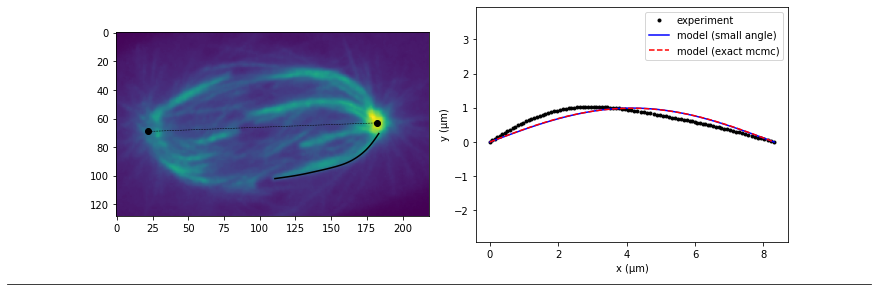

Fx_only
20210526_cell001 0
pole_left 20.895263817430017
P-K distance (L) =  7.11 um
Initial angle =  11.91 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 400.38it/s]


Exact method error (mcmc): 0.0132
Small-angle error: 0.0132


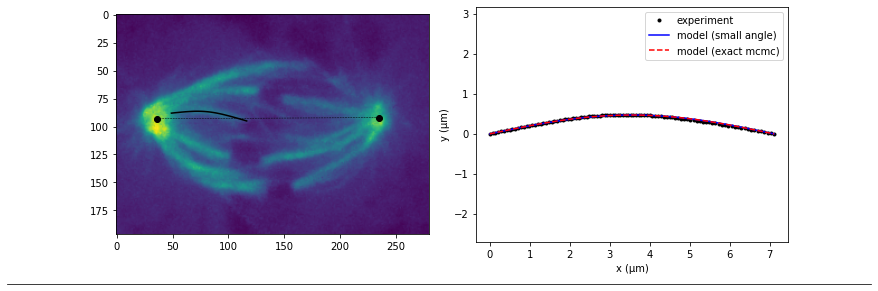

Fx_only
20210526_cell001 1
pole_right 20.895263817430017
P-K distance (L) =  10.57 um
Initial angle =  24.21 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 393.76it/s]


Exact method error (mcmc): 0.1105
Small-angle error: 0.1125


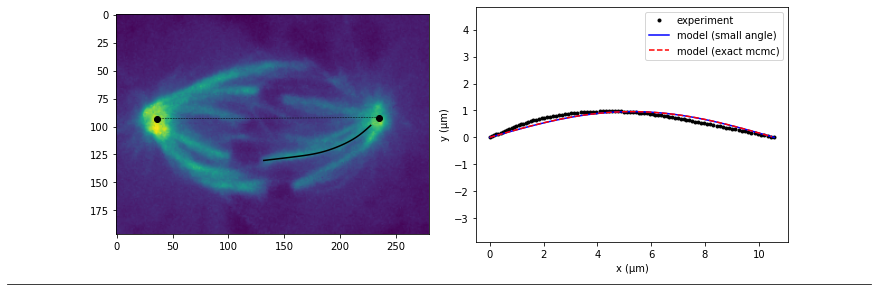

Fx_only
20210526_cell001 2
pole_right 20.895263817430017
P-K distance (L) =  8.96 um
Initial angle =  16.00 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 399.32it/s]


Exact method error (mcmc): 0.0710
Small-angle error: 0.0712


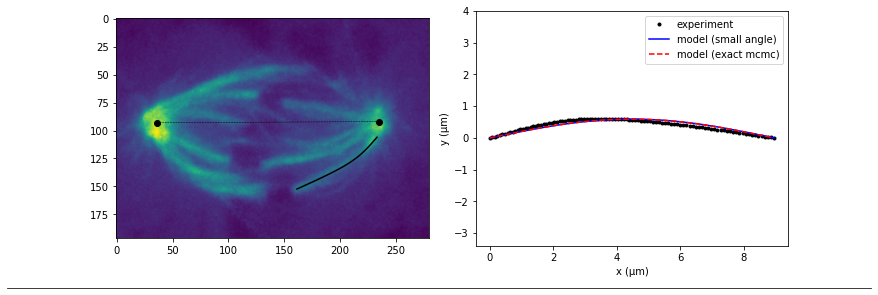

Fx_only
20210526_cell001 3
pole_left 20.895263817430017
P-K distance (L) =  13.48 um
Initial angle =  15.17 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 400.44it/s]


Exact method error (mcmc): 0.0389
Small-angle error: 0.0360


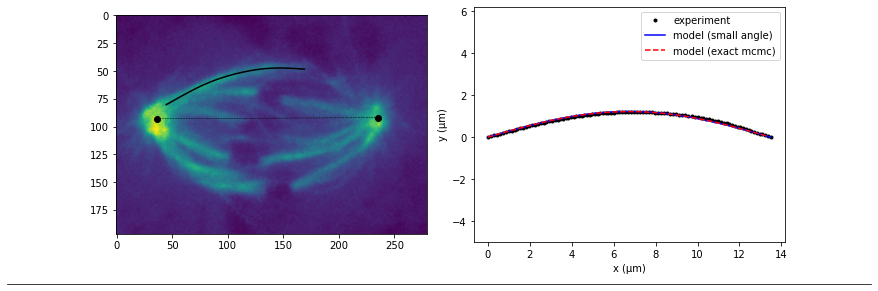

Fx_only
20210526_cell001 4
pole_right 20.895263817430017
P-K distance (L) =  7.30 um
Initial angle =  4.63 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 396.87it/s]


Exact method error (mcmc): 0.0029
Small-angle error: 0.0043


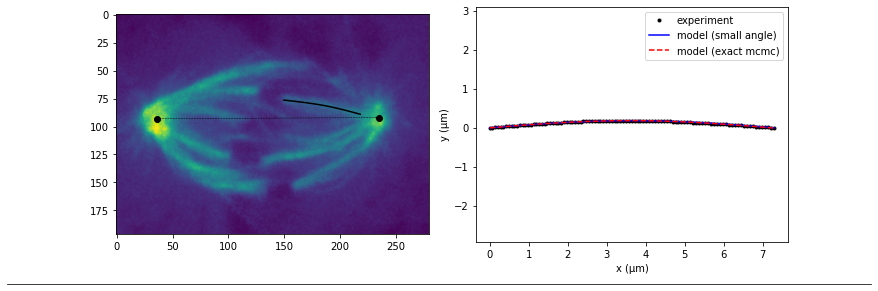

Fx_only
20210526_cell004 0
pole_left 28.035
P-K distance (L) =  10.42 um
Initial angle =  12.33 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 403.38it/s]


Exact method error (mcmc): 0.0490
Small-angle error: 0.0472


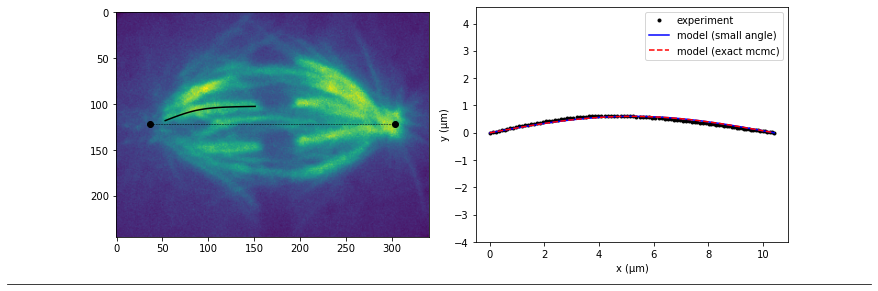

Fx_only
20210526_cell004 1
pole_left 28.035
P-K distance (L) =  10.60 um
Initial angle =  16.54 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 404.73it/s]


Exact method error (mcmc): 0.0716
Small-angle error: 0.0715


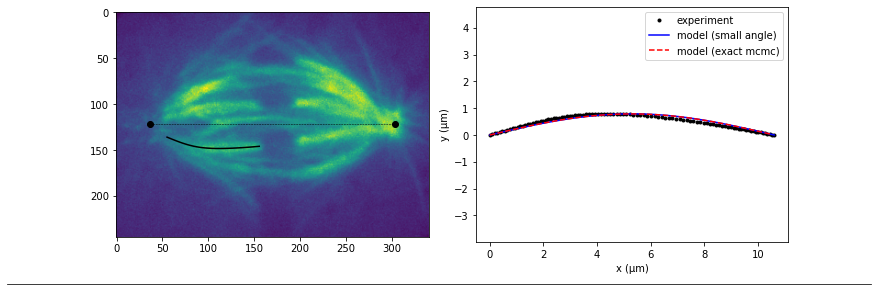

Fx_only
20210526_cell004 2
pole_right 28.035
P-K distance (L) =  10.32 um
Initial angle =  21.96 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 403.38it/s]


Exact method error (mcmc): 0.1009
Small-angle error: 0.1016


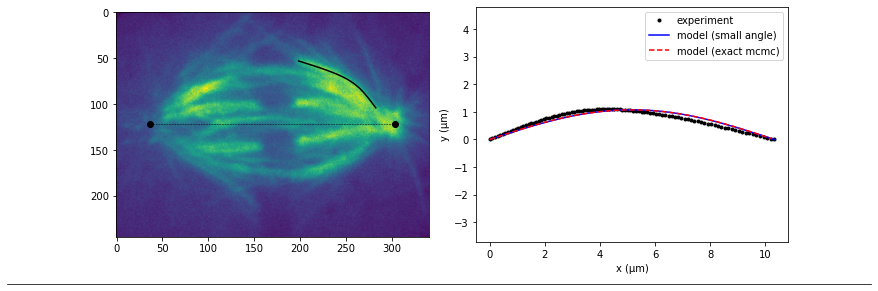

Fx_only
20210526_cell004 3
pole_right 28.035
P-K distance (L) =  7.48 um
Initial angle =  11.65 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 403.29it/s]


Exact method error (mcmc): 0.0251
Small-angle error: 0.0245


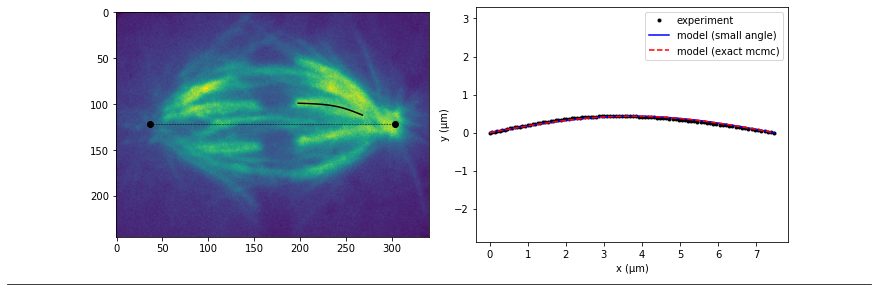

Fx_only
20210526_cell004 4
pole_right 28.035
P-K distance (L) =  8.60 um
Initial angle =  1.56 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 398.19it/s]


Exact method error (mcmc): 0.0006
Small-angle error: 0.0010


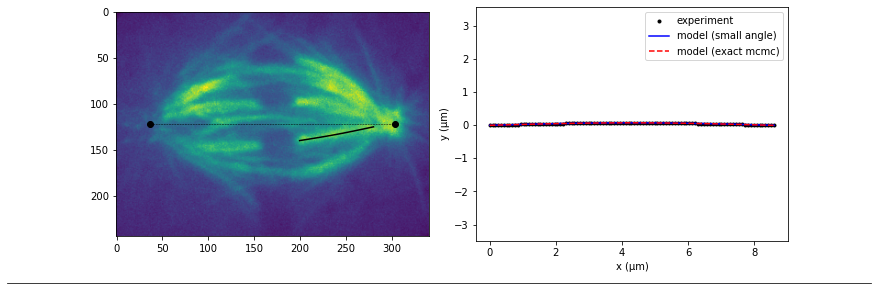

Fx_only
20210526_cell004 5
pole_right 28.035
P-K distance (L) =  10.24 um
Initial angle =  22.64 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 398.00it/s]


Exact method error (mcmc): 0.0610
Small-angle error: 0.0624


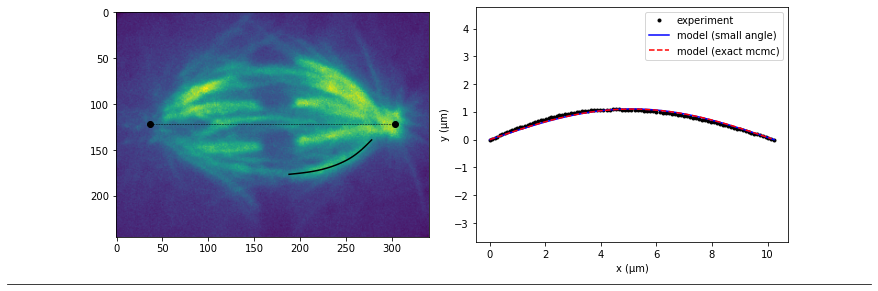

Fx_only
20210526_cell006 0
pole_left 23.998874973631576
P-K distance (L) =  8.55 um
Initial angle =  14.35 degrees


100%|████████████████████████████████████| 10000/10000 [00:31<00:00, 317.45it/s]


Exact method error (mcmc): 0.0260
Small-angle error: 0.0250


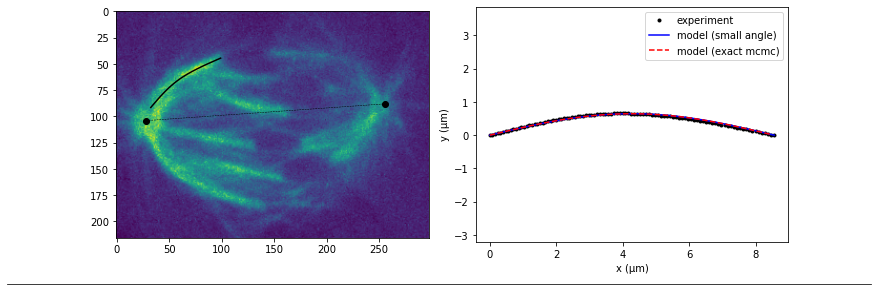

Fx_only
20210526_cell006 1
pole_left 23.998874973631576
P-K distance (L) =  13.26 um
Initial angle =  30.14 degrees


100%|████████████████████████████████████| 10000/10000 [00:28<00:00, 350.80it/s]


Exact method error (mcmc): 0.1992
Small-angle error: 0.2024


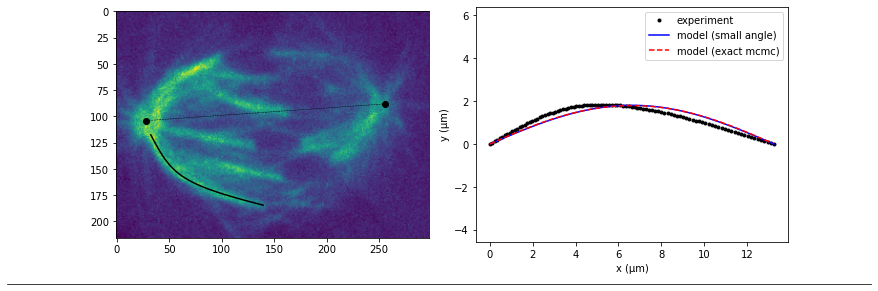

Fx_only
20210526_cell006 2
pole_left 23.998874973631576
P-K distance (L) =  9.00 um
Initial angle =  2.39 degrees


100%|████████████████████████████████████| 10000/10000 [00:27<00:00, 362.27it/s]


Exact method error (mcmc): 0.0025
Small-angle error: 0.0037


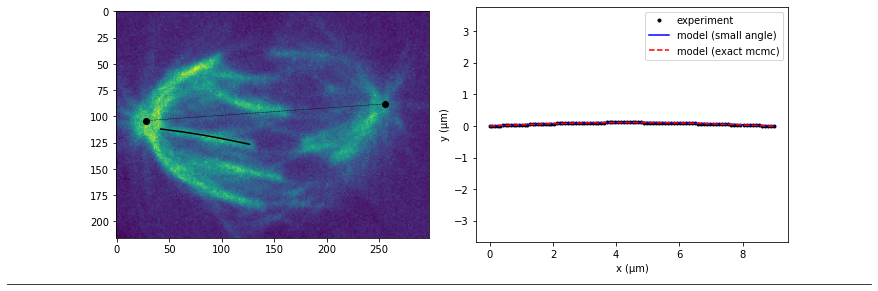

Fx_only
20210526_cell007 0
pole_left 26.275397713450506
P-K distance (L) =  8.61 um
Initial angle =  12.54 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 395.48it/s]


Exact method error (mcmc): 0.0442
Small-angle error: 0.0439


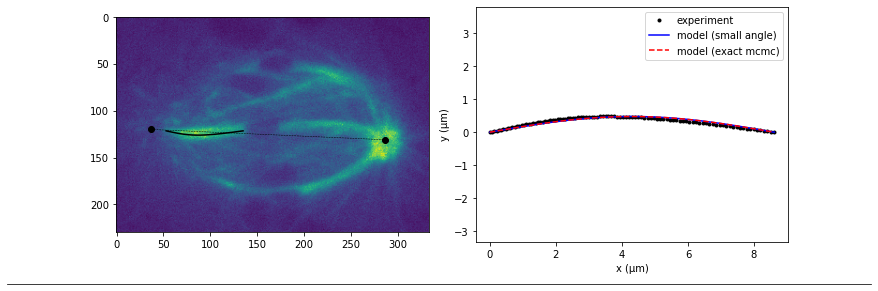

Fx_only
20210526_cell007 1
pole_right 26.275397713450506
P-K distance (L) =  10.99 um
Initial angle =  17.37 degrees


100%|████████████████████████████████████| 10000/10000 [00:27<00:00, 362.31it/s]


Exact method error (mcmc): 0.0796
Small-angle error: 0.0801


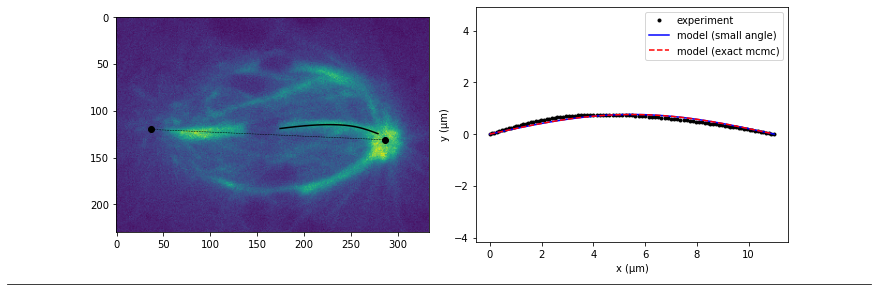

Fx_only
20210526_cell007 2
pole_right 26.275397713450506
P-K distance (L) =  8.85 um
Initial angle =  17.35 degrees


100%|████████████████████████████████████| 10000/10000 [00:27<00:00, 363.82it/s]


Exact method error (mcmc): 0.0277
Small-angle error: 0.0272


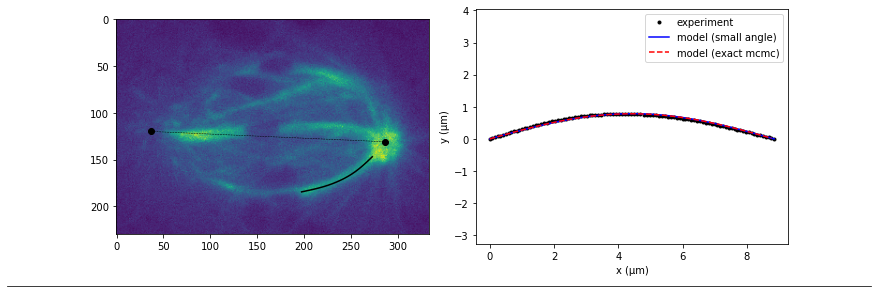

Fx_only
20210526_cell007 3
pole_right 26.275397713450506
P-K distance (L) =  11.33 um
Initial angle =  41.81 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 398.17it/s]


Exact method error (mcmc): 0.1948
Small-angle error: 0.2056


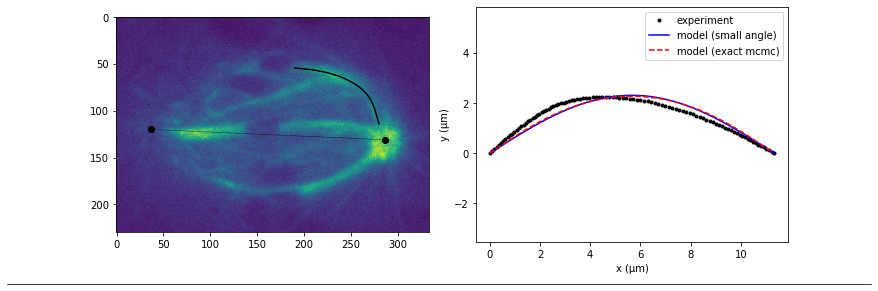

Fy_Mp_only
20171215_cell004 0
pole_left 14.979744078254473
P-K distance (L) =  6.39 um
Initial angle =  10.26 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 398.62it/s]


Exact method error (mcmc): 0.0064
Small-angle error: 0.0071


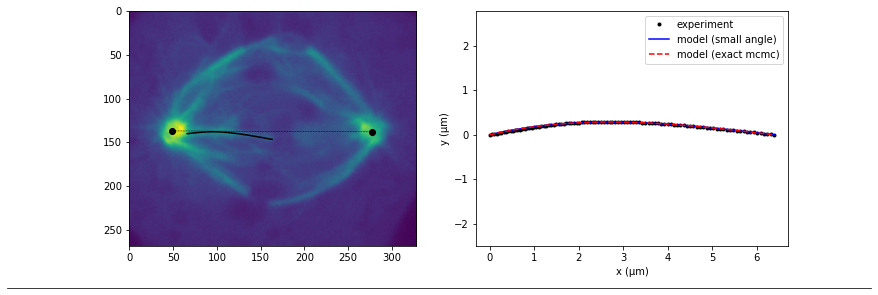

Fy_Mp_only
20171215_cell004 1
pole_right 14.979744078254473
P-K distance (L) =  6.69 um
Initial angle =  4.86 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 399.86it/s]


Exact method error (mcmc): 0.0210
Small-angle error: 0.0201


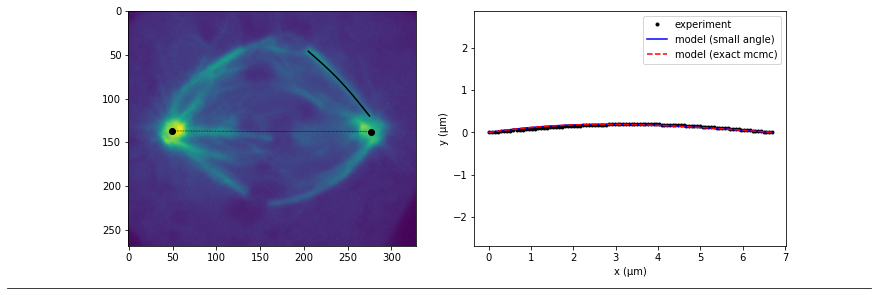

Fy_Mp_only
20171215_cell004 2
pole_right 14.979744078254473
P-K distance (L) =  8.38 um
Initial angle =  22.45 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 400.10it/s]


Exact method error (mcmc): 0.0665
Small-angle error: 0.0530


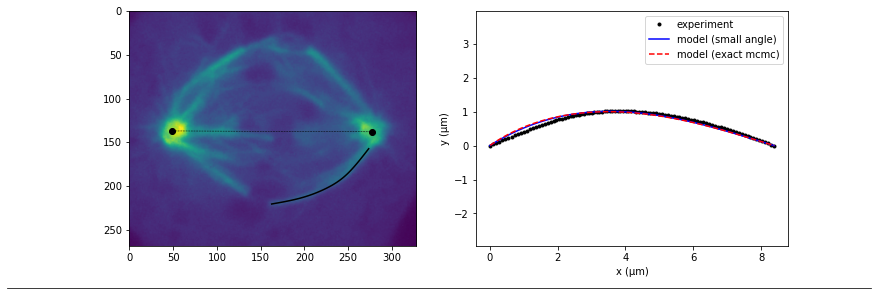

Fy_Mp_only
20171215_cell004 3
pole_right 14.979744078254473
P-K distance (L) =  8.35 um
Initial angle =  28.00 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 399.36it/s]


Exact method error (mcmc): 0.0623
Small-angle error: 0.0550


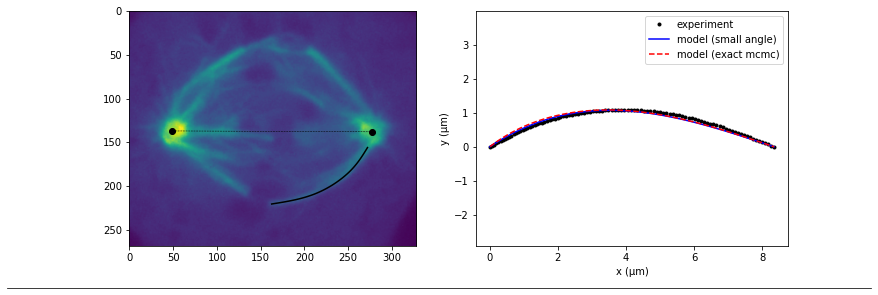

Fy_Mp_only
20171215_cell004a 0
pole_left 14.3883
P-K distance (L) =  8.23 um
Initial angle =  21.61 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 399.76it/s]


Exact method error (mcmc): 0.0410
Small-angle error: 0.0339


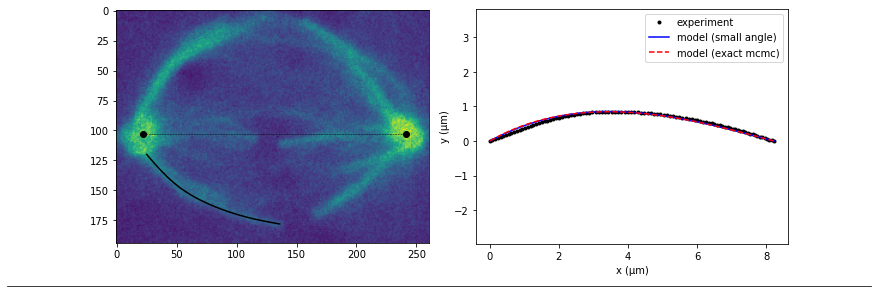

Fy_Mp_only
20171215_cell004a 1
pole_right 14.3883
P-K distance (L) =  5.78 um
Initial angle =  5.82 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 400.33it/s]


Exact method error (mcmc): 0.0065
Small-angle error: 0.0077


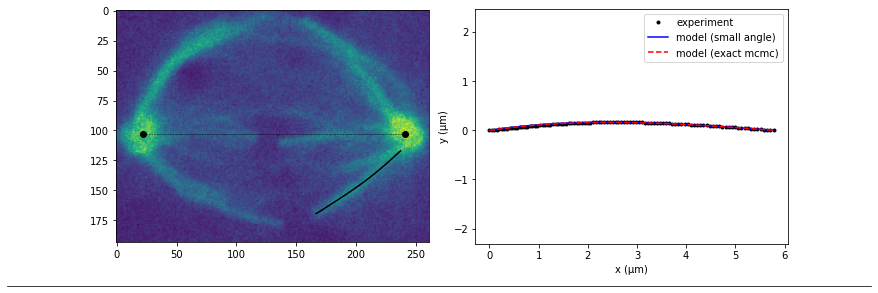

Fy_Mp_only
20171215_cell005 0
pole_left 13.807007798940361
P-K distance (L) =  6.22 um
Initial angle =  25.90 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 403.12it/s]


Exact method error (mcmc): 0.0333
Small-angle error: 0.0448


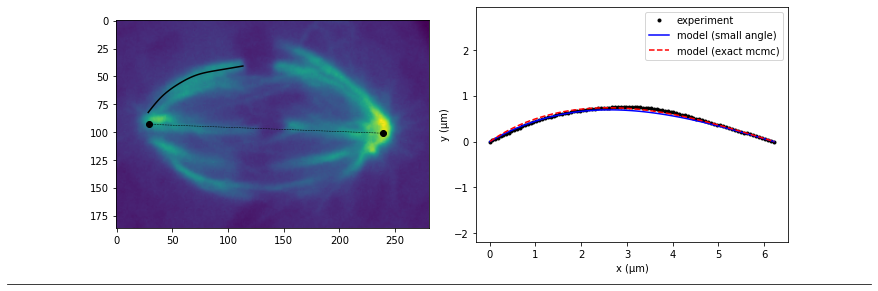

Fy_Mp_only
20171215_cell005 1
pole_right 13.807007798940361
P-K distance (L) =  7.42 um
Initial angle =  17.45 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 403.44it/s]


Exact method error (mcmc): 0.0496
Small-angle error: 0.0449


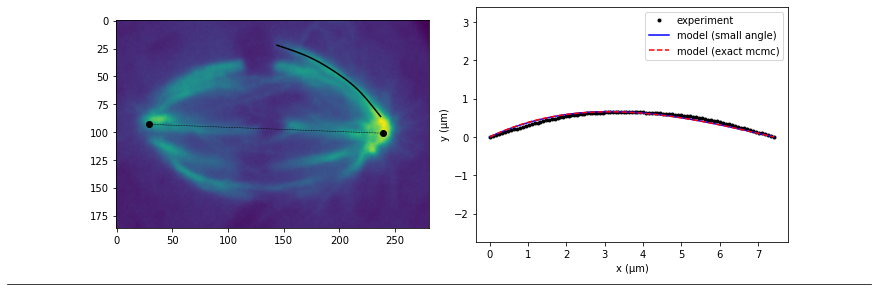

Fy_Mp_only
20171215_cell005 2
pole_right 13.807007798940361
P-K distance (L) =  5.44 um
Initial angle =  15.00 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 401.17it/s]


Exact method error (mcmc): 0.0114
Small-angle error: 0.0108


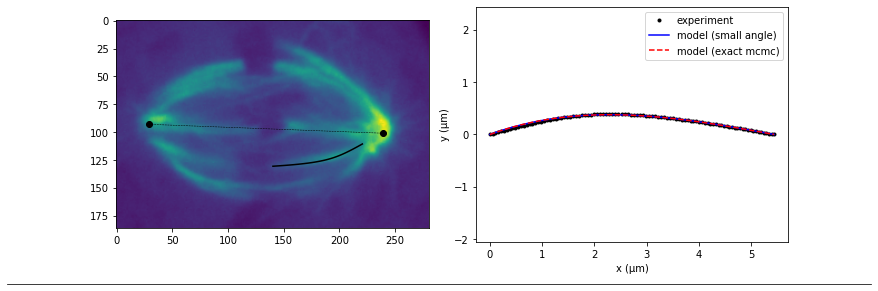

Fy_Mp_only
20171219_cell003 0
pole_left 16.766377403899746
P-K distance (L) =  8.12 um
Initial angle =  9.10 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 404.53it/s]


Exact method error (mcmc): 0.0311
Small-angle error: 0.0310


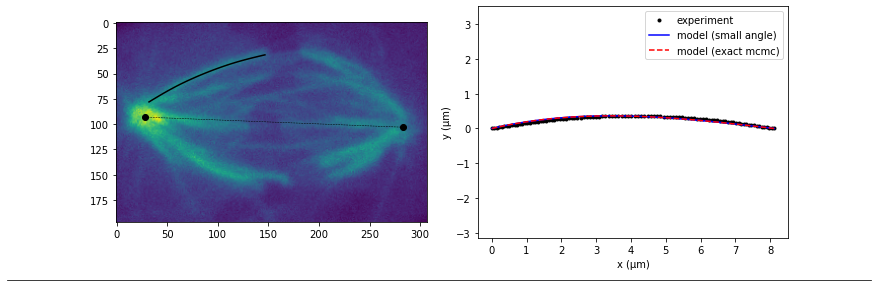

Fy_Mp_only
20171219_cell003 1
pole_left 16.766377403899746
P-K distance (L) =  5.50 um
Initial angle =  8.75 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 401.67it/s]


Exact method error (mcmc): 0.0130
Small-angle error: 0.0132


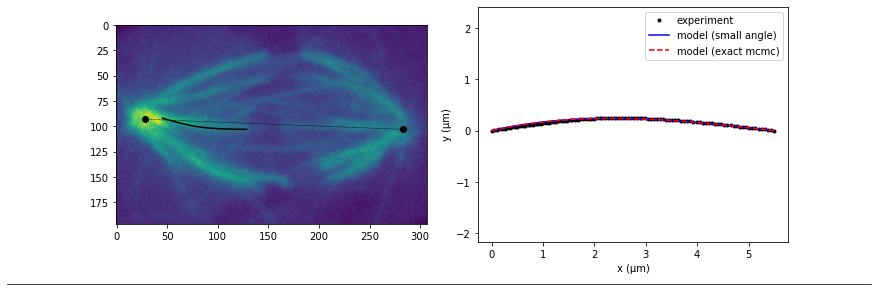

Fy_Mp_only
20180611_cell002 0
pole_left 14.283473842171588
P-K distance (L) =  6.64 um
Initial angle =  22.71 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 401.09it/s]


Exact method error (mcmc): 0.0215
Small-angle error: 0.0154


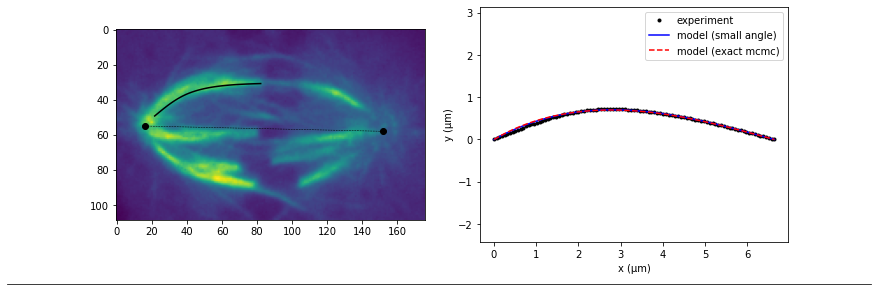

Fy_Mp_only
20180611_cell002 1
pole_left 14.283473842171588
P-K distance (L) =  6.59 um
Initial angle =  21.91 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 403.18it/s]


Exact method error (mcmc): 0.0569
Small-angle error: 0.0593


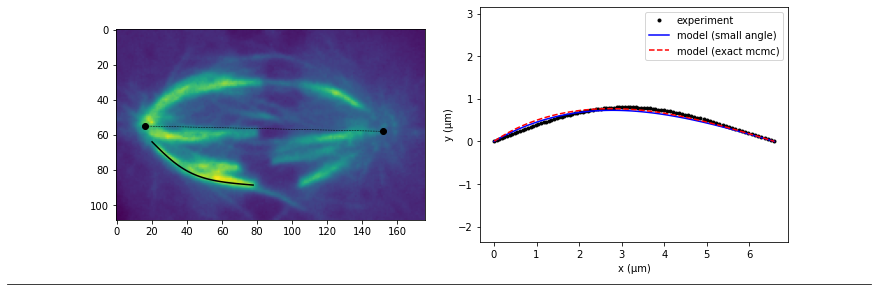

Fy_Mp_only
20180611_cell002 2
pole_left 14.283473842171588
P-K distance (L) =  6.59 um
Initial angle =  21.91 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 403.07it/s]


Exact method error (mcmc): 0.0569
Small-angle error: 0.0552


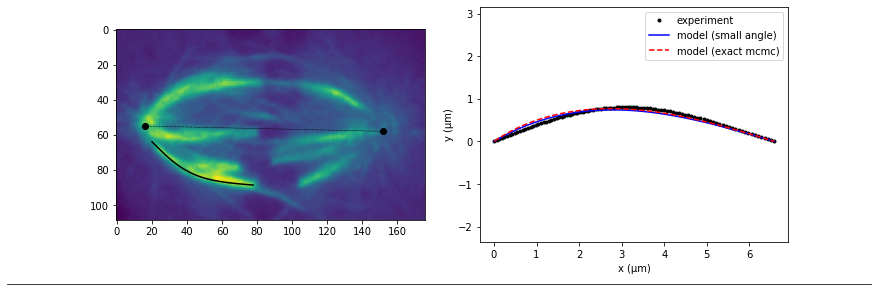

Fy_Mp_only
20180612_cell001 0
pole_left 14.806489286795841
P-K distance (L) =  7.85 um
Initial angle =  21.07 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 402.84it/s]


Exact method error (mcmc): 0.0635
Small-angle error: 0.0533


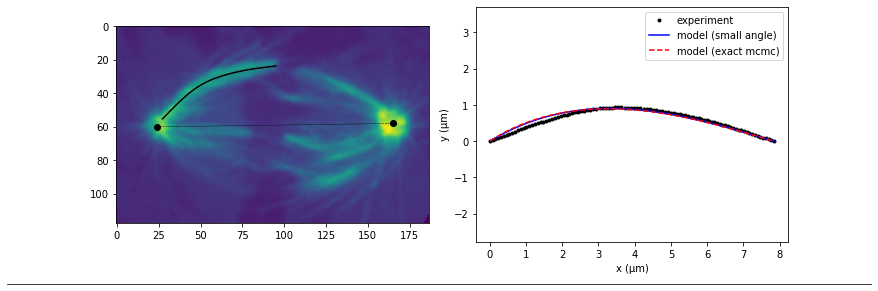

Fy_Mp_only
20180612_cell001 1
pole_left 14.806489286795841
P-K distance (L) =  4.69 um
Initial angle =  11.81 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 400.81it/s]


Exact method error (mcmc): 0.0215
Small-angle error: 0.0215


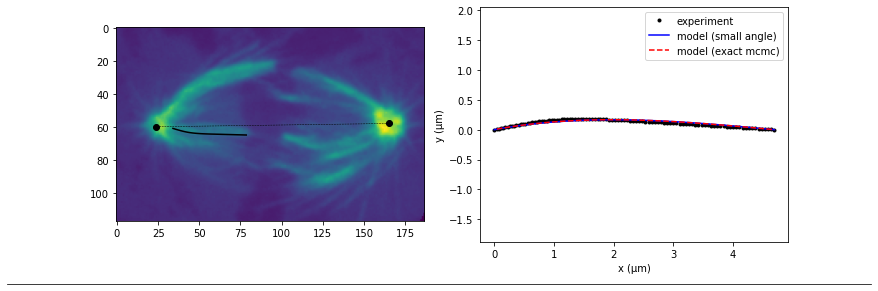

Fy_Mp_only
20180612_cell003 0
pole_left 13.021693438259096
P-K distance (L) =  5.70 um
Initial angle =  23.85 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 399.16it/s]


Exact method error (mcmc): 0.0151
Small-angle error: 0.0145


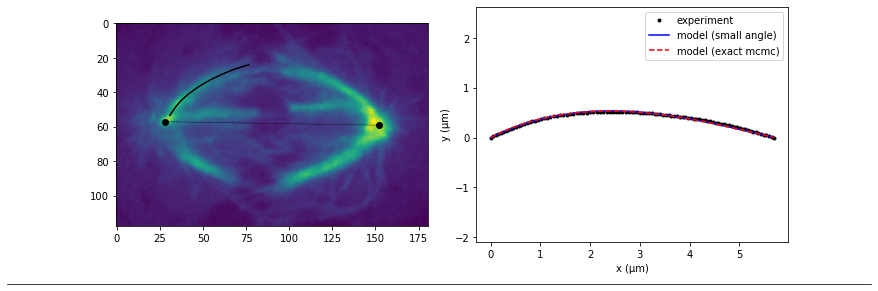

Fy_Mp_only
20180612_cell003 1
pole_left 13.021693438259096
P-K distance (L) =  4.84 um
Initial angle =  15.69 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 399.51it/s]


Exact method error (mcmc): 0.0326
Small-angle error: 0.0324


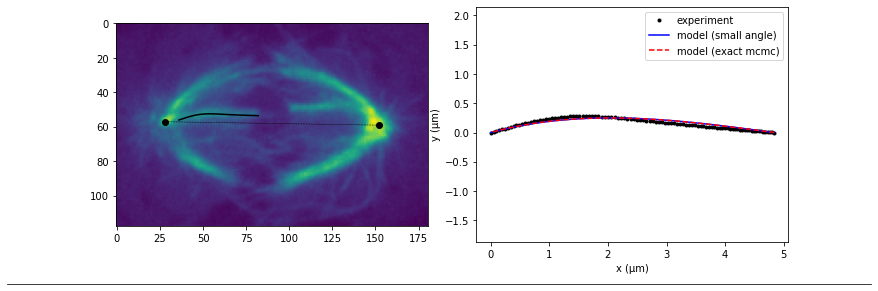

Fy_Mp_only
20180612_cell003 2
pole_right 13.021693438259096
P-K distance (L) =  5.89 um
Initial angle =  23.08 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 400.27it/s]


Exact method error (mcmc): 0.0291
Small-angle error: 0.0356


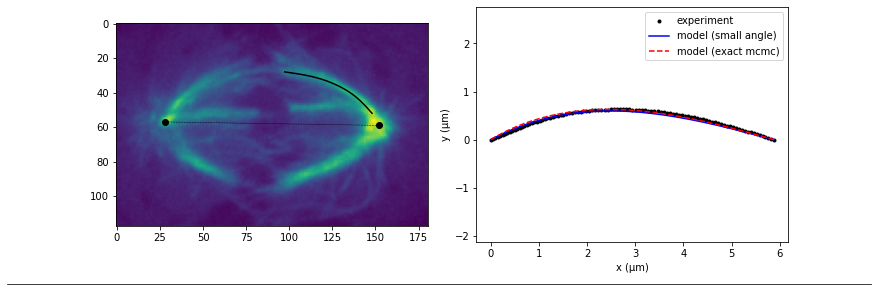

Fy_Mp_only
20180620_cell013 0
pole_left 14.625561527681594
P-K distance (L) =  5.89 um
Initial angle =  4.07 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 396.69it/s]


Exact method error (mcmc): 0.0094
Small-angle error: 0.0147


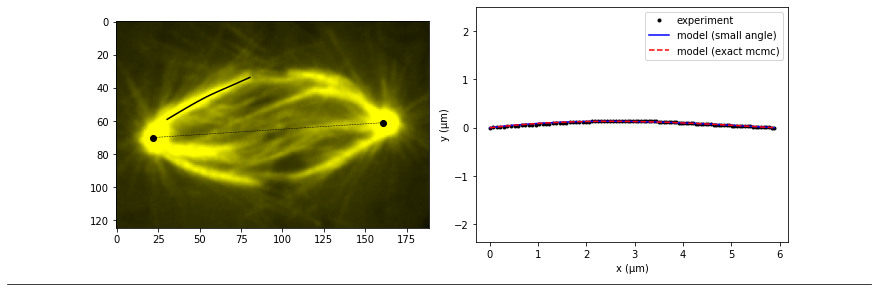

Fy_Mp_only
20180620_cell013 1
pole_left 14.625561527681594
P-K distance (L) =  6.28 um
Initial angle =  16.50 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 398.63it/s]


Exact method error (mcmc): 0.0087
Small-angle error: 0.0077


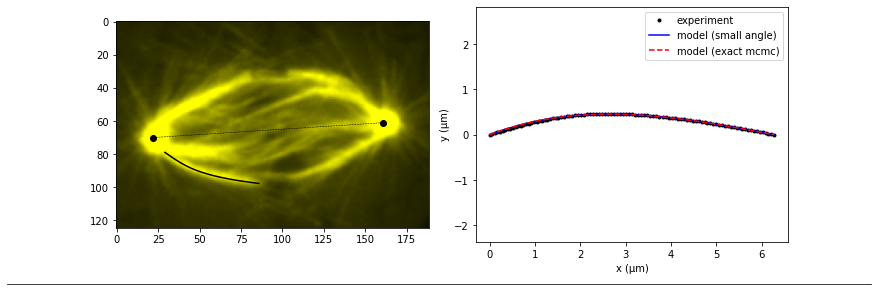

Fy_Mp_only
20180620_cell013 2
pole_right 14.625561527681594
P-K distance (L) =  6.07 um
Initial angle =  7.39 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 401.65it/s]


Exact method error (mcmc): 0.0619
Small-angle error: 0.0601


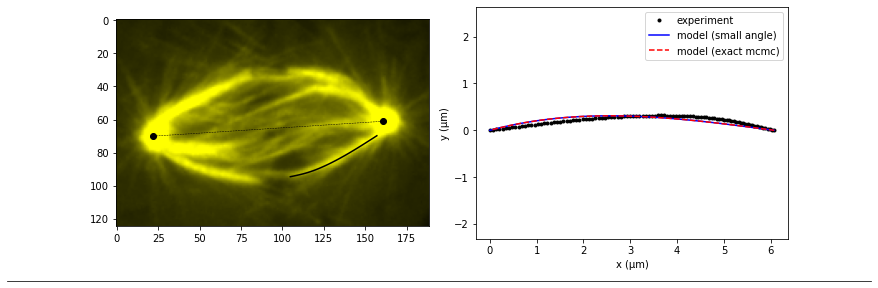

Fy_Mp_only
20180622_cell015 0
pole_left 16.388411301892564
P-K distance (L) =  7.51 um
Initial angle =  18.18 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 402.61it/s]


Exact method error (mcmc): 0.0345
Small-angle error: 0.0351


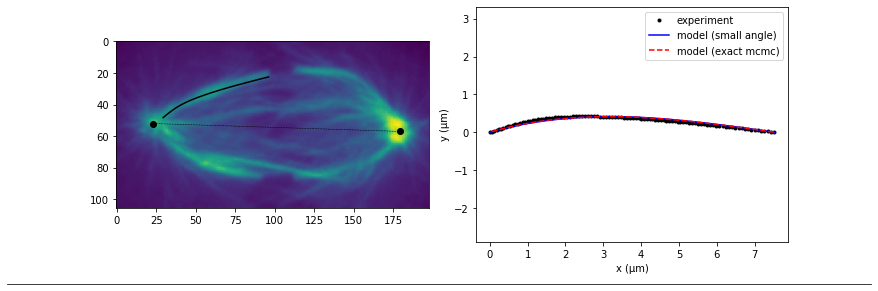

Fy_Mp_only
20180622_cell015 1
pole_left 16.388411301892564
P-K distance (L) =  7.19 um
Initial angle =  18.74 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 397.56it/s]


Exact method error (mcmc): 0.0427
Small-angle error: 0.0452


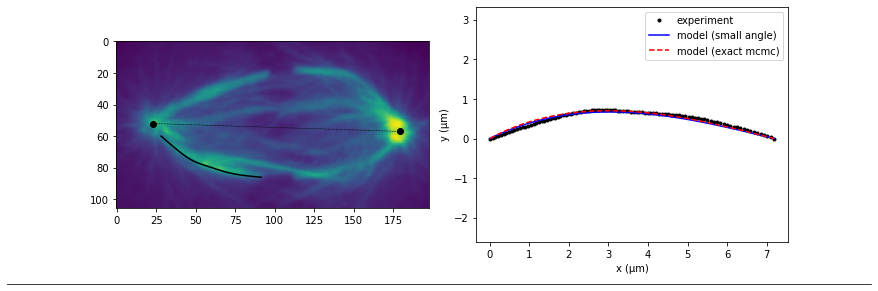

Fy_Mp_only
20180622_cell016 0
pole_left 15.225
P-K distance (L) =  6.11 um
Initial angle =  13.57 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 399.10it/s]


Exact method error (mcmc): 0.0356
Small-angle error: 0.0320


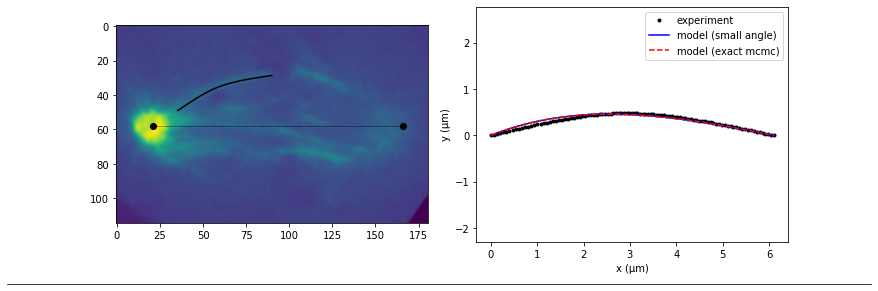

Fy_Mp_only
20180622_cell020 0
pole_left 12.401117893157858
P-K distance (L) =  6.69 um
Initial angle =  28.34 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 402.65it/s]


Exact method error (mcmc): 0.0214
Small-angle error: 0.0238


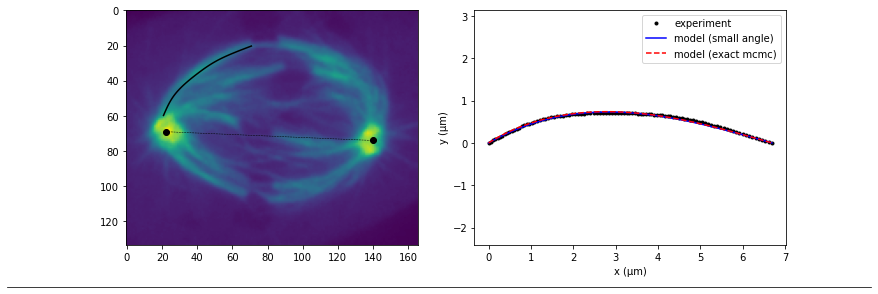

Fy_Mp_only
20180622_cell020 1
pole_right 12.401117893157858
P-K distance (L) =  6.03 um
Initial angle =  24.49 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 403.49it/s]


Exact method error (mcmc): 0.0755
Small-angle error: 0.0644


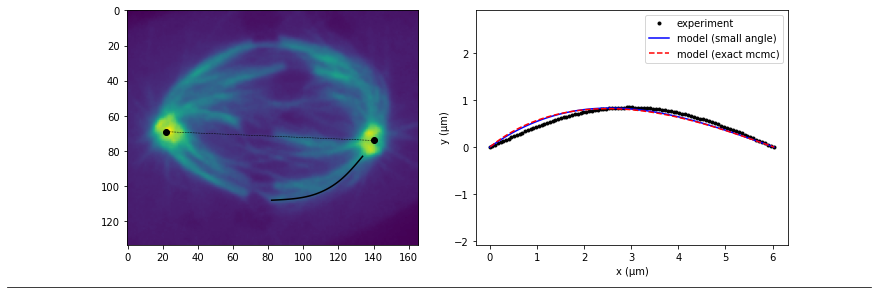

Fy_Mp_only
20180622_cell020 2
pole_left 12.401117893157858
P-K distance (L) =  5.00 um
Initial angle =  13.21 degrees


100%|████████████████████████████████████| 10000/10000 [00:27<00:00, 367.86it/s]


Exact method error (mcmc): 0.0121
Small-angle error: 0.0112


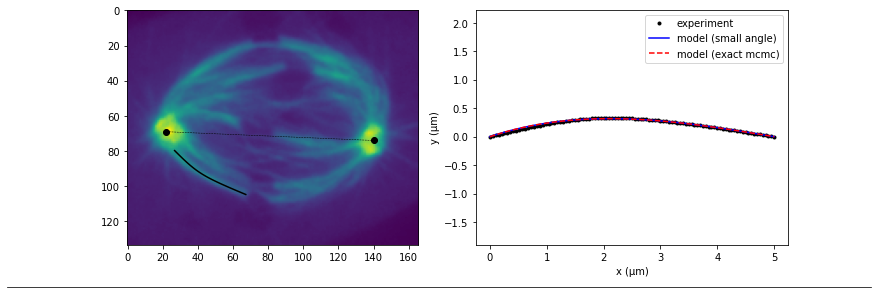

Fy_Mp_only
20180622_cell020 3
pole_right 12.401117893157858
P-K distance (L) =  5.47 um
Initial angle =  25.99 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 402.39it/s]


Exact method error (mcmc): 0.0329
Small-angle error: 0.0424


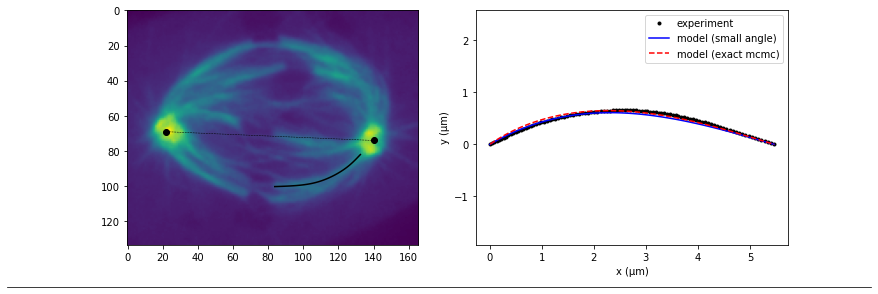

Fy_Mp_only
20180622_cell026 0
pole_left 14.598398884809251
P-K distance (L) =  5.74 um
Initial angle =  24.35 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 400.94it/s]


Exact method error (mcmc): 0.0165
Small-angle error: 0.0222


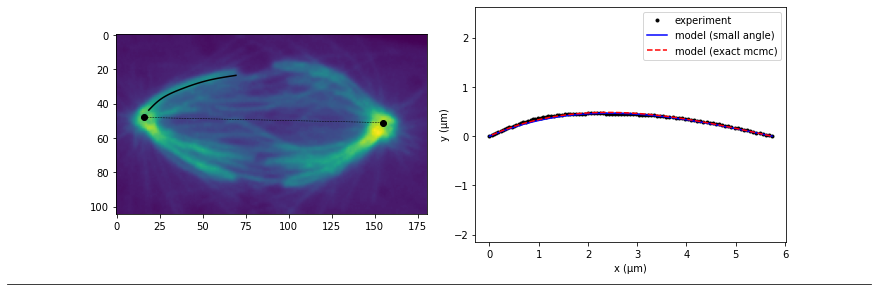

Fy_Mp_only
20180622_cell026 1
pole_left 14.598398884809251
P-K distance (L) =  5.88 um
Initial angle =  13.64 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 401.15it/s]


Exact method error (mcmc): 0.0160
Small-angle error: 0.0150


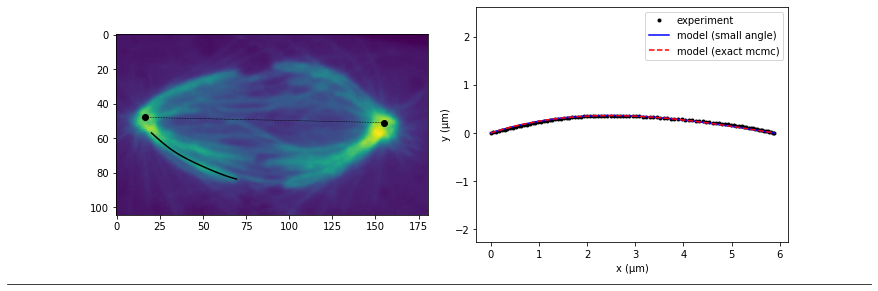

Fy_Mp_only
20180622_cell026 2
pole_right 14.598398884809251
P-K distance (L) =  6.41 um
Initial angle =  33.09 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 401.79it/s]


Exact method error (mcmc): 0.0135
Small-angle error: 0.0140


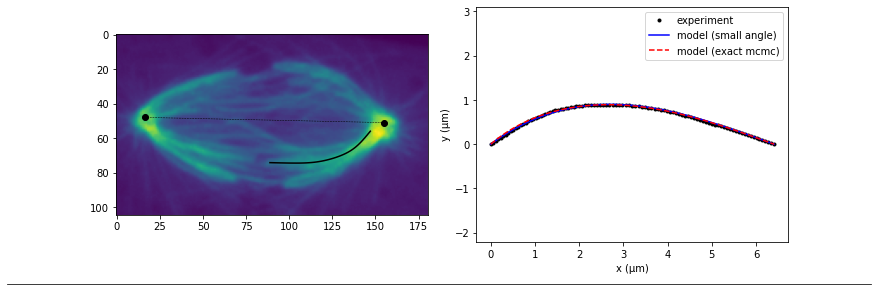

Fy_Mp_only
20180622_cell026 3
pole_right 14.598398884809251
P-K distance (L) =  6.13 um
Initial angle =  22.85 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 398.69it/s]


Exact method error (mcmc): 0.0513
Small-angle error: 0.0432


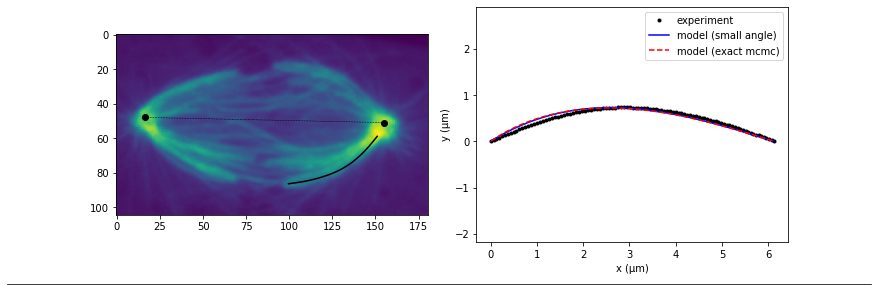

Fy_Mp_only
20180622_cell027 0
pole_left 14.181220857175873
P-K distance (L) =  4.89 um
Initial angle =  9.20 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 400.57it/s]


Exact method error (mcmc): 0.0124
Small-angle error: 0.0105


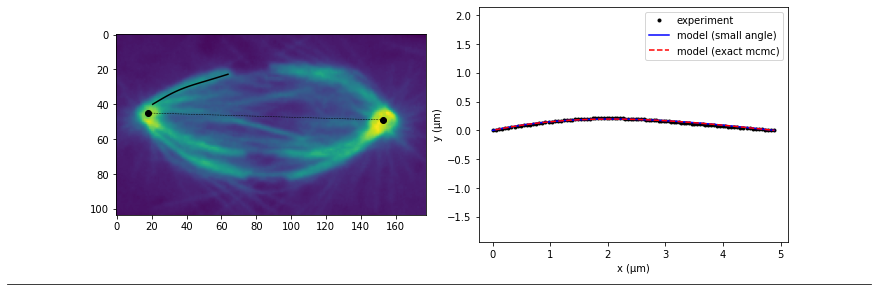

Fy_Mp_only
20180622_cell027 1
pole_left 14.181220857175873
P-K distance (L) =  5.44 um
Initial angle =  15.19 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 402.61it/s]


Exact method error (mcmc): 0.0202
Small-angle error: 0.0194


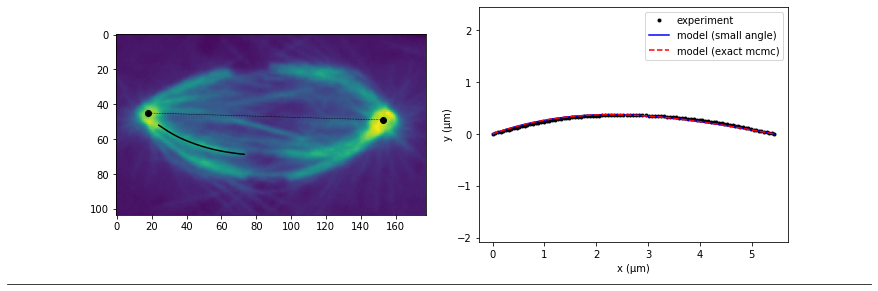

Fy_Mp_only
20180622_cell027 2
pole_left 14.181220857175873
P-K distance (L) =  6.23 um
Initial angle =  20.25 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 403.14it/s]


Exact method error (mcmc): 0.0326
Small-angle error: 0.0307


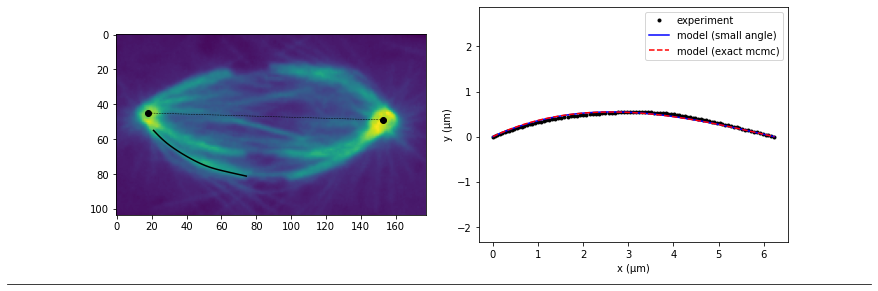

Fy_Mp_only
20180622_cell027 3
pole_right 14.181220857175873
P-K distance (L) =  6.82 um
Initial angle =  21.28 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 401.64it/s]


Exact method error (mcmc): 0.0190
Small-angle error: 0.0136


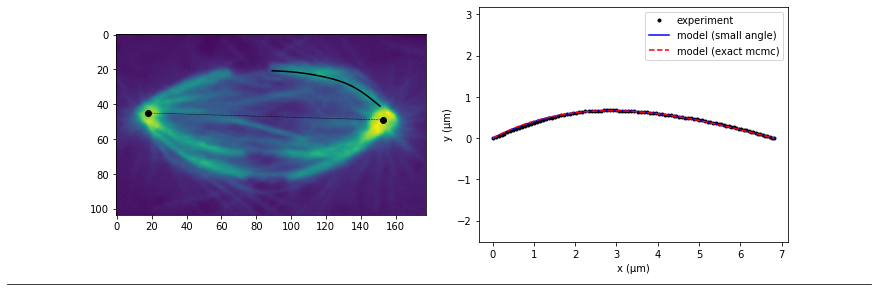

Fy_Mp_only
20180622_cell027 4
pole_right 14.181220857175873
P-K distance (L) =  5.78 um
Initial angle =  15.63 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 402.98it/s]


Exact method error (mcmc): 0.0403
Small-angle error: 0.0358


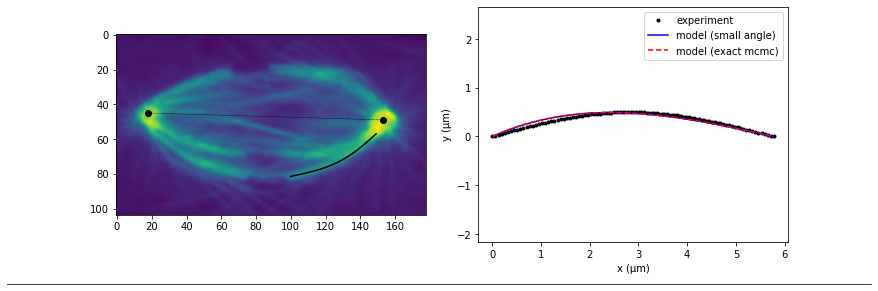

Fy_Mp_only
20180622_cell028 0
pole_left 16.907934527907305
P-K distance (L) =  7.63 um
Initial angle =  15.89 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 402.00it/s]


Exact method error (mcmc): 0.0309
Small-angle error: 0.0282


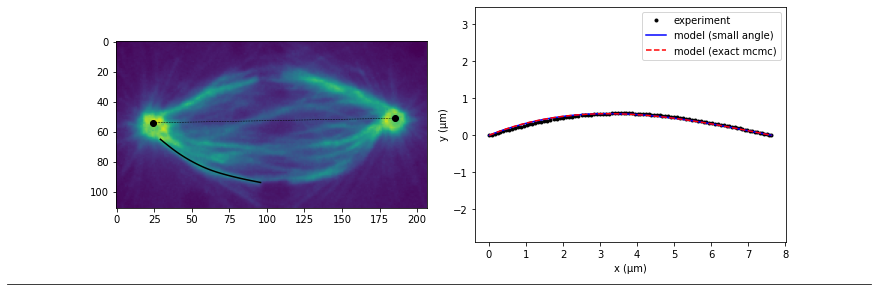

Fy_Mp_only
20180622_cell028 1
pole_right 16.907934527907305
P-K distance (L) =  5.90 um
Initial angle =  26.89 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 400.98it/s]


Exact method error (mcmc): 0.0180
Small-angle error: 0.0189


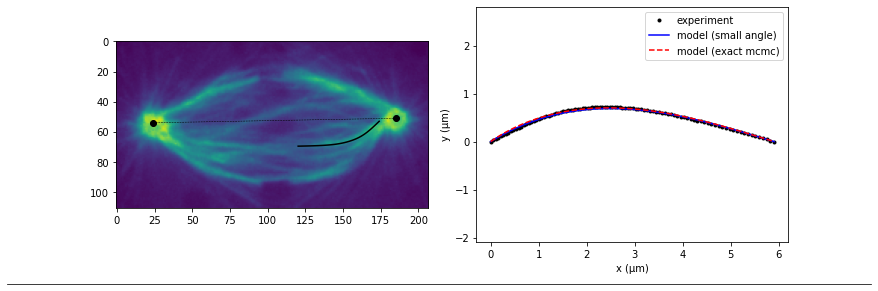

Fy_Mp_only
20180622_cell030 0
pole_left 14.071567076910801
P-K distance (L) =  5.60 um
Initial angle =  31.47 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 401.28it/s]


Exact method error (mcmc): 0.0381
Small-angle error: 0.0241


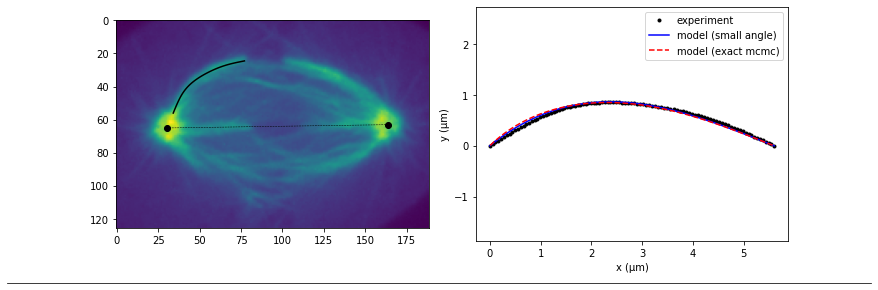

Fy_Mp_only
20180622_cell030 1
pole_right 14.071567076910801
P-K distance (L) =  6.70 um
Initial angle =  23.23 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 401.14it/s]


Exact method error (mcmc): 0.0182
Small-angle error: 0.0274


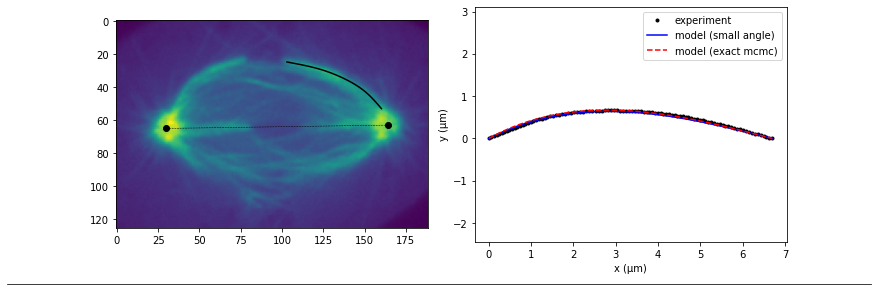

Fy_Mp_only
20180626_cell001 0
pole_left 14.286175135423758
P-K distance (L) =  6.04 um
Initial angle =  15.38 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 401.30it/s]


Exact method error (mcmc): 0.0150
Small-angle error: 0.0146


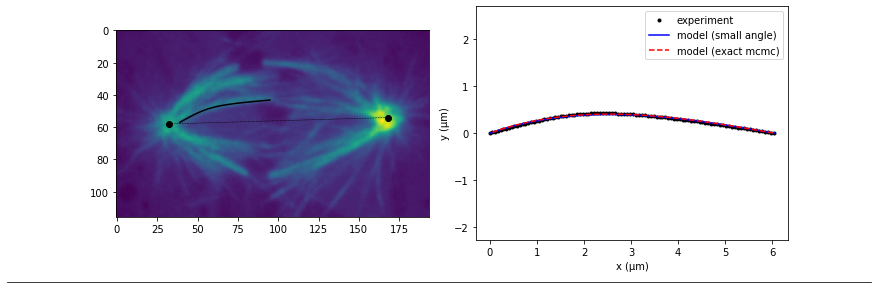

Fy_Mp_only
20180626_cell001 1
pole_left 14.286175135423758
P-K distance (L) =  5.18 um
Initial angle =  18.14 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 397.73it/s]


Exact method error (mcmc): 0.0291
Small-angle error: 0.0246


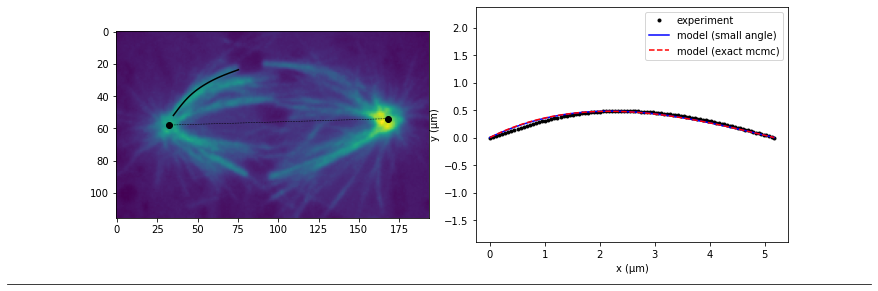

Fy_Mp_only
20180626_cell001 2
pole_right 14.286175135423758
P-K distance (L) =  6.93 um
Initial angle =  31.42 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 403.11it/s]


Exact method error (mcmc): 0.0148
Small-angle error: 0.0561


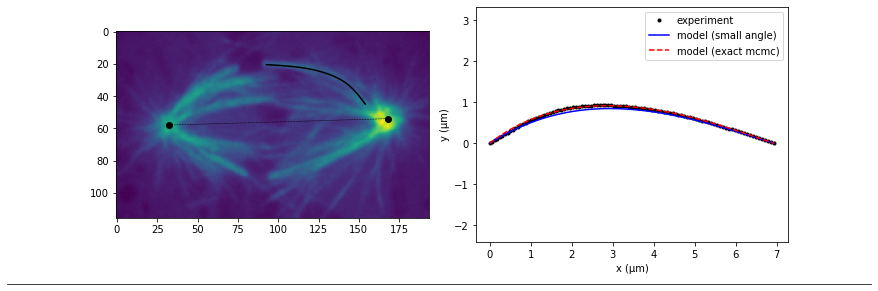

Fy_Mp_only
20180628_cell002 0
pole_left 13.236664987828316
P-K distance (L) =  7.16 um
Initial angle =  15.71 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 397.23it/s]


Exact method error (mcmc): 0.0412
Small-angle error: 0.0387


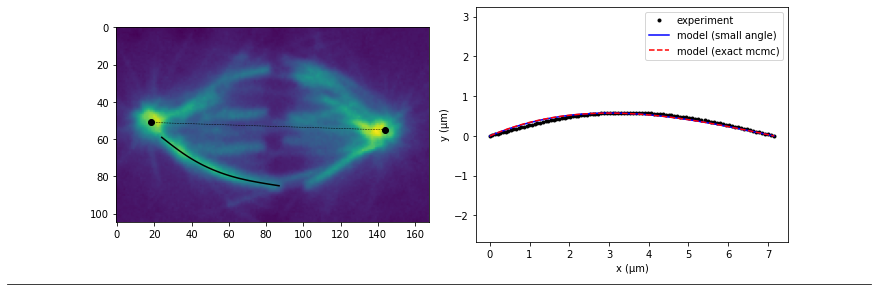

Fy_Mp_only
20180628_cell006 0
pole_left 16.826557134482385
P-K distance (L) =  6.16 um
Initial angle =  18.85 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 405.40it/s]


Exact method error (mcmc): 0.0197
Small-angle error: 0.0168


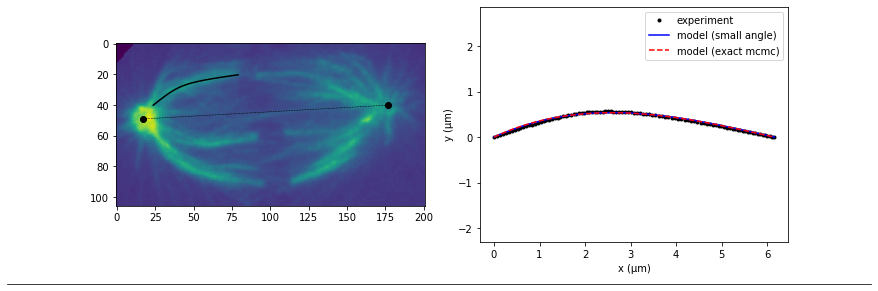

Fy_Mp_only
20180628_cell006 1
pole_left 16.826557134482385
P-K distance (L) =  6.62 um
Initial angle =  30.69 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 402.43it/s]


Exact method error (mcmc): 0.0330
Small-angle error: 0.0377


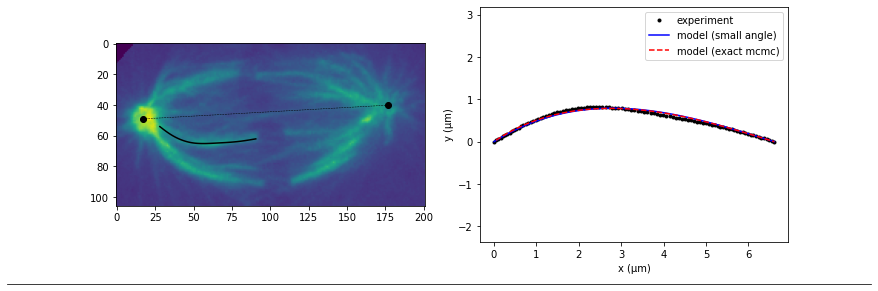

Fy_Mp_only
20180628_cell006 2
pole_left 16.826557134482385
P-K distance (L) =  8.07 um
Initial angle =  33.12 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 399.53it/s]


Exact method error (mcmc): 0.0229
Small-angle error: 0.0252


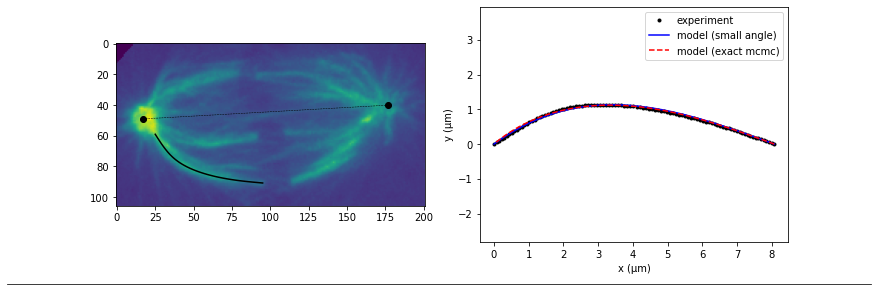

Fy_Mp_only
20180628_cell010 0
pole_left 12.8117211958425
P-K distance (L) =  5.65 um
Initial angle =  18.30 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 404.94it/s]


Exact method error (mcmc): 0.0428
Small-angle error: 0.0363


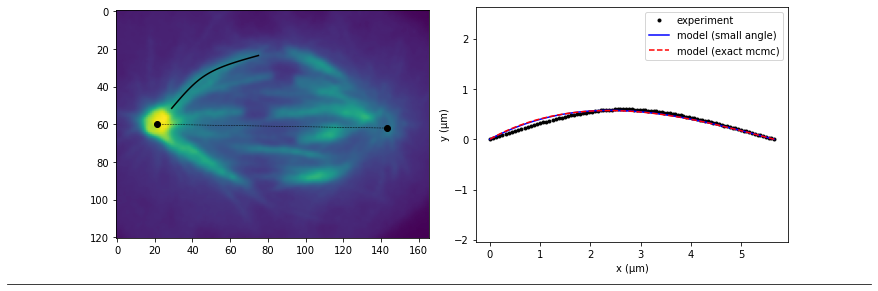

Fy_Mp_only
20180628_cell010 1
pole_left 12.8117211958425
P-K distance (L) =  3.77 um
Initial angle =  13.11 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 403.17it/s]


Exact method error (mcmc): 0.0093
Small-angle error: 0.0095


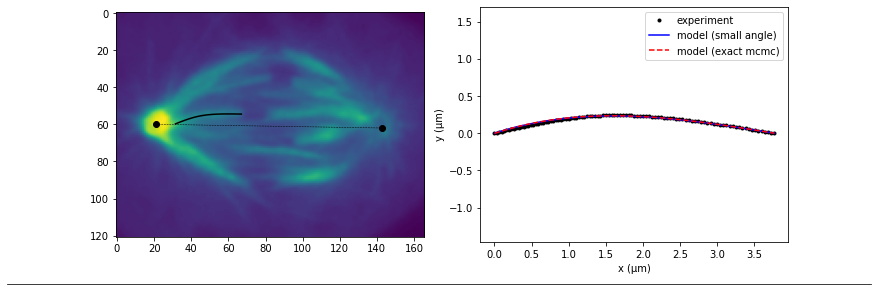

Fy_Mp_only
20180628_cell010 2
pole_left 12.8117211958425
P-K distance (L) =  5.36 um
Initial angle =  10.08 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 402.75it/s]


Exact method error (mcmc): 0.0287
Small-angle error: 0.0285


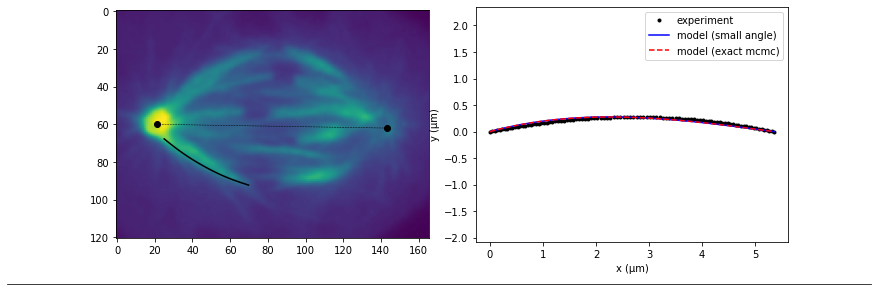

Fy_Mp_only
20180628_cell010 3
pole_right 12.8117211958425
P-K distance (L) =  5.25 um
Initial angle =  12.63 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 403.12it/s]


Exact method error (mcmc): 0.0215
Small-angle error: 0.0186


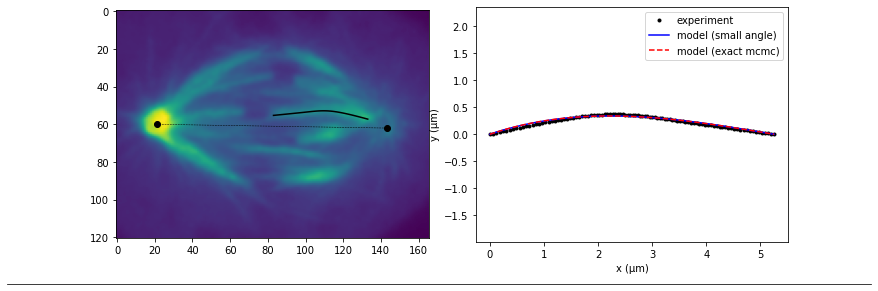

Fy_Mp_only
20180628_cell013 0
pole_left 15.015367128378845
P-K distance (L) =  7.91 um
Initial angle =  19.16 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 403.18it/s]


Exact method error (mcmc): 0.0377
Small-angle error: 0.0330


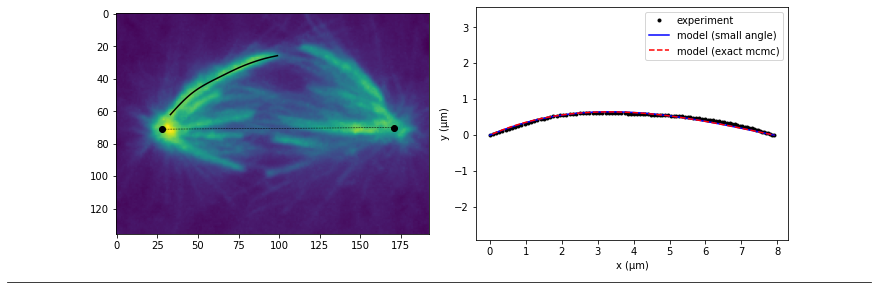

Fy_Mp_only
20180628_cell013 1
pole_left 15.015367128378845
P-K distance (L) =  3.82 um
Initial angle =  4.60 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 405.18it/s]


Exact method error (mcmc): 0.0279
Small-angle error: 0.0275


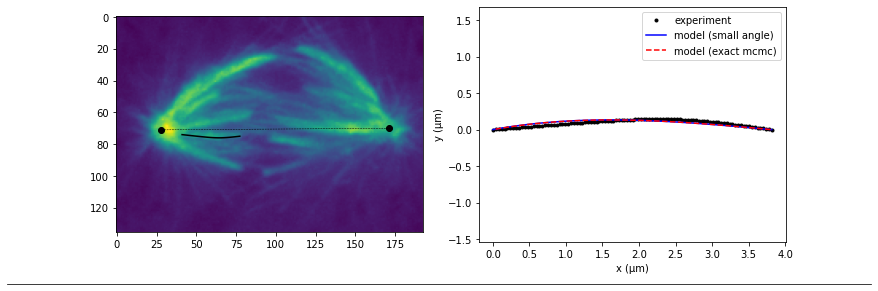

Fy_Mp_only
20180628_cell013 2
pole_left 15.015367128378845
P-K distance (L) =  4.54 um
Initial angle =  7.26 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 405.13it/s]


Exact method error (mcmc): 0.0064
Small-angle error: 0.0064


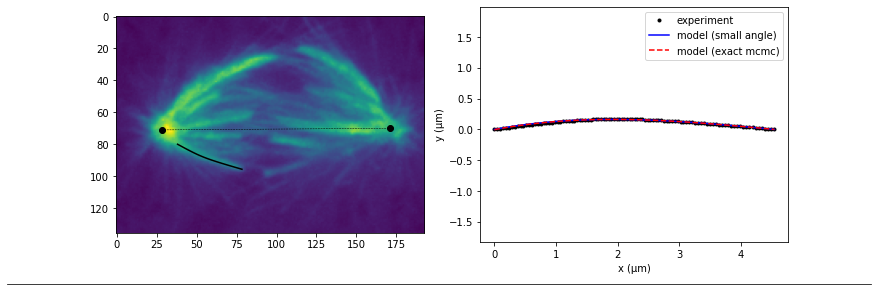

Fy_Mp_only
20180628_cell013 3
pole_right 15.015367128378845
P-K distance (L) =  6.59 um
Initial angle =  25.61 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 406.48it/s]


Exact method error (mcmc): 0.0193
Small-angle error: 0.0193


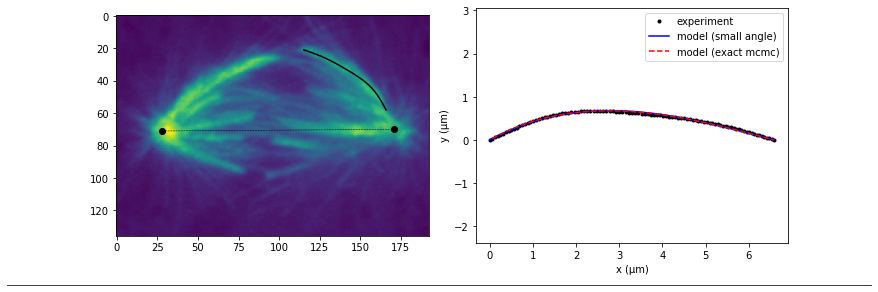

Fy_Mp_only
20180628_cell013 4
pole_right 15.015367128378845
P-K distance (L) =  6.37 um
Initial angle =  15.49 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 403.89it/s]


Exact method error (mcmc): 0.0113
Small-angle error: 0.0120


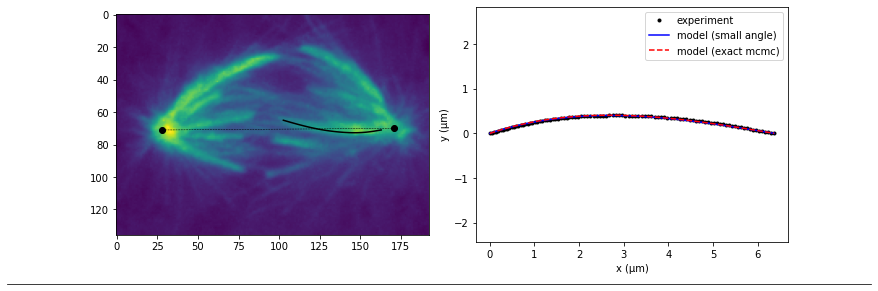

Fy_Mp_only
20180810_cell005 0
pole_left 14.527993667399501
P-K distance (L) =  5.53 um
Initial angle =  16.72 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 405.99it/s]


Exact method error (mcmc): 0.0371
Small-angle error: 0.0372


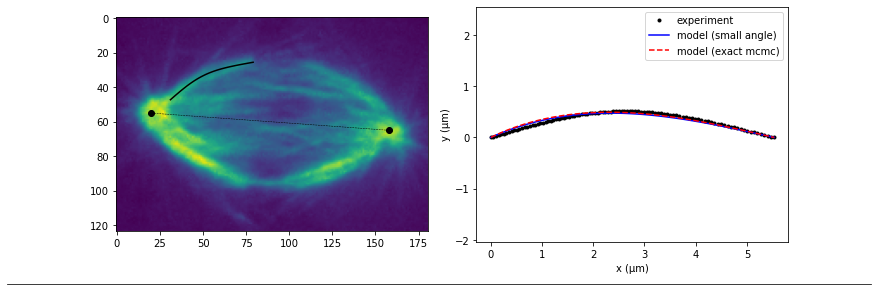

Fy_Mp_only
20180810_cell005 1
pole_right 14.527993667399501
P-K distance (L) =  5.86 um
Initial angle =  16.98 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 406.97it/s]


Exact method error (mcmc): 0.0037
Small-angle error: 0.0122


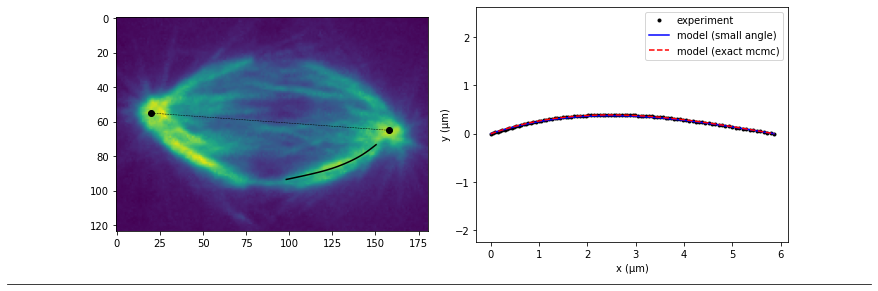

Fy_Mp_only
20180810_cell005 2
pole_left 14.527993667399501
P-K distance (L) =  6.05 um
Initial angle =  11.13 degrees


100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 377.21it/s]


Exact method error (mcmc): 0.0452
Small-angle error: 0.0420


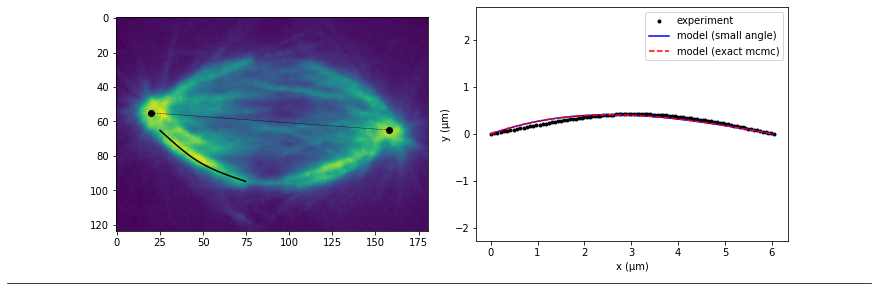

Fy_Mp_only
20180810_cell006 0
pole_left 16.811808350085364
P-K distance (L) =  5.45 um
Initial angle =  9.95 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 386.09it/s]


Exact method error (mcmc): 0.0097
Small-angle error: 0.0100


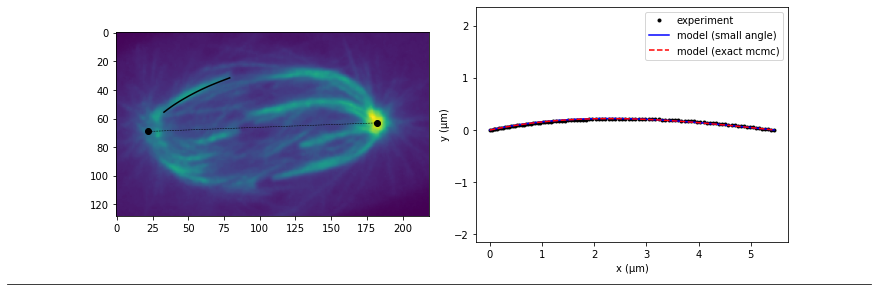

Fy_Mp_only
20180810_cell006 1
pole_right 16.811808350085364
P-K distance (L) =  8.93 um
Initial angle =  28.80 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 386.88it/s]


Exact method error (mcmc): 0.0429
Small-angle error: 0.0462


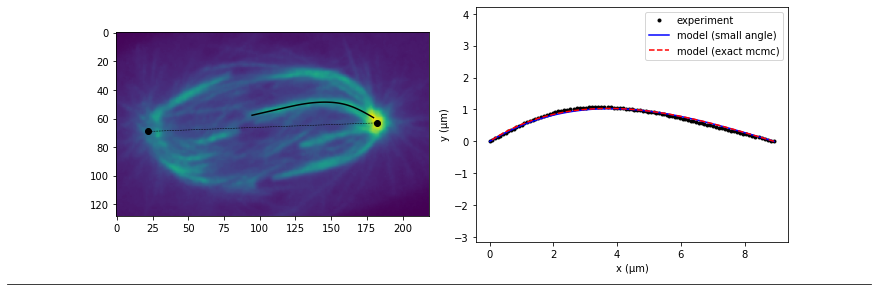

Fy_Mp_only
20180810_cell006 2
pole_right 16.811808350085364
P-K distance (L) =  4.95 um
Initial angle =  6.79 degrees


100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 373.81it/s]


Exact method error (mcmc): 0.0030
Small-angle error: 0.0054


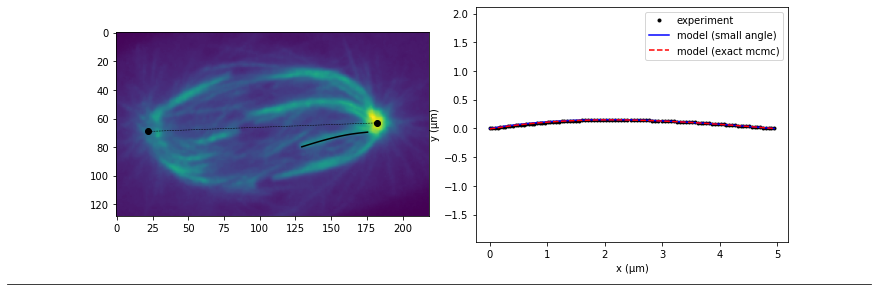

Fy_Mp_only
20180810_cell006 3
pole_right 16.811808350085364
P-K distance (L) =  8.32 um
Initial angle =  32.25 degrees


100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 375.40it/s]


Exact method error (mcmc): 0.0556
Small-angle error: 0.0779


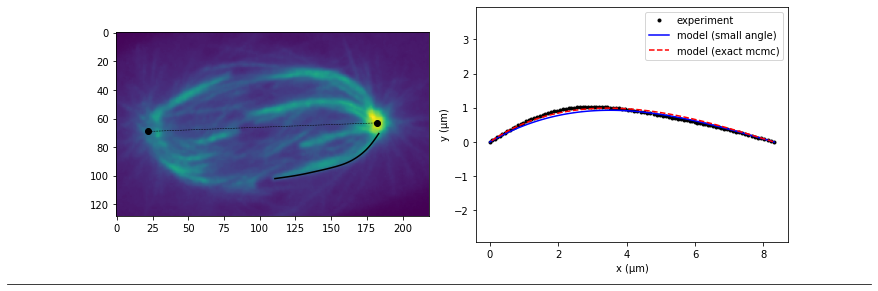

Fy_Mp_only
20210526_cell001 0
pole_left 20.895263817430017
P-K distance (L) =  7.11 um
Initial angle =  11.91 degrees


100%|████████████████████████████████████| 10000/10000 [00:27<00:00, 364.11it/s]


Exact method error (mcmc): 0.0355
Small-angle error: 0.0344


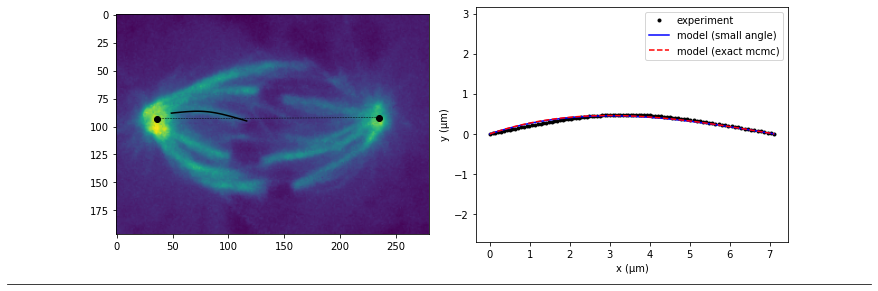

Fy_Mp_only
20210526_cell001 1
pole_right 20.895263817430017
P-K distance (L) =  10.57 um
Initial angle =  24.21 degrees


100%|████████████████████████████████████| 10000/10000 [00:27<00:00, 361.18it/s]


Exact method error (mcmc): 0.0256
Small-angle error: 0.0379


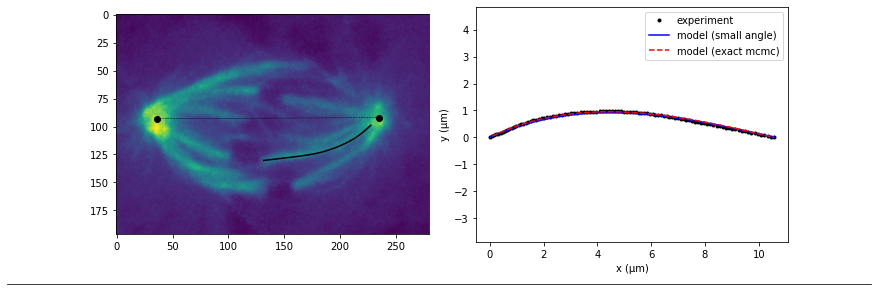

Fy_Mp_only
20210526_cell001 2
pole_right 20.895263817430017
P-K distance (L) =  8.96 um
Initial angle =  16.00 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 391.50it/s]


Exact method error (mcmc): 0.0222
Small-angle error: 0.0226


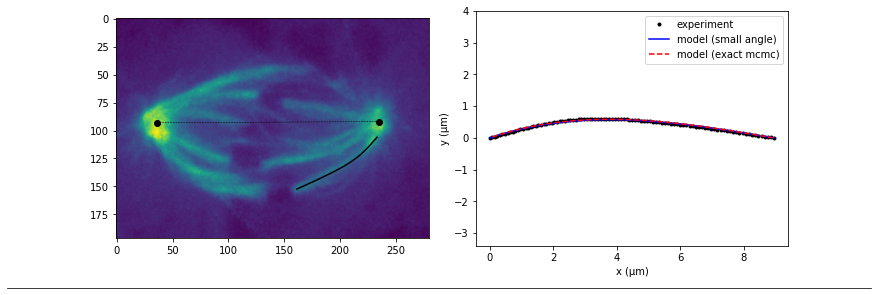

Fy_Mp_only
20210526_cell001 3
pole_left 20.895263817430017
P-K distance (L) =  13.48 um
Initial angle =  15.17 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 401.58it/s]


Exact method error (mcmc): 0.1427
Small-angle error: 0.1352


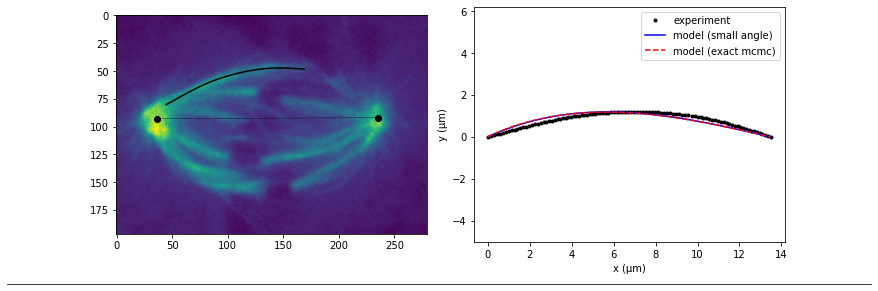

Fy_Mp_only
20210526_cell001 4
pole_right 20.895263817430017
P-K distance (L) =  7.30 um
Initial angle =  4.63 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 397.78it/s]


Exact method error (mcmc): 0.0134
Small-angle error: 0.0137


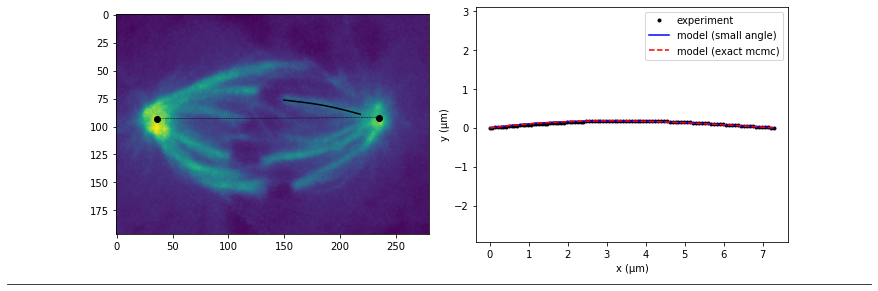

Fy_Mp_only
20210526_cell004 0
pole_left 28.035
P-K distance (L) =  10.42 um
Initial angle =  12.33 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 399.96it/s]


Exact method error (mcmc): 0.0203
Small-angle error: 0.0210


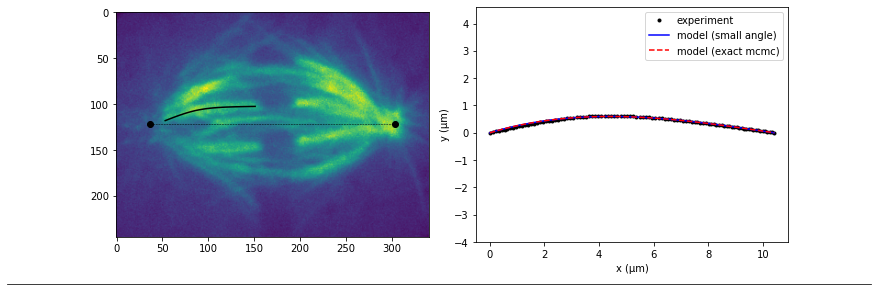

Fy_Mp_only
20210526_cell004 1
pole_left 28.035
P-K distance (L) =  10.60 um
Initial angle =  16.54 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 387.87it/s]


Exact method error (mcmc): 0.0192
Small-angle error: 0.0173


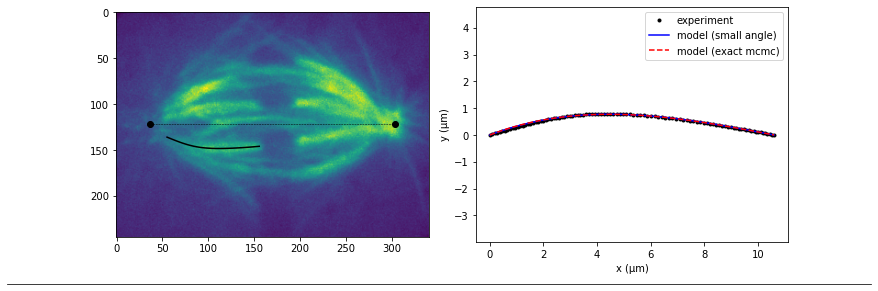

Fy_Mp_only
20210526_cell004 2
pole_right 28.035
P-K distance (L) =  10.32 um
Initial angle =  21.96 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 401.41it/s]


Exact method error (mcmc): 0.0380
Small-angle error: 0.0372


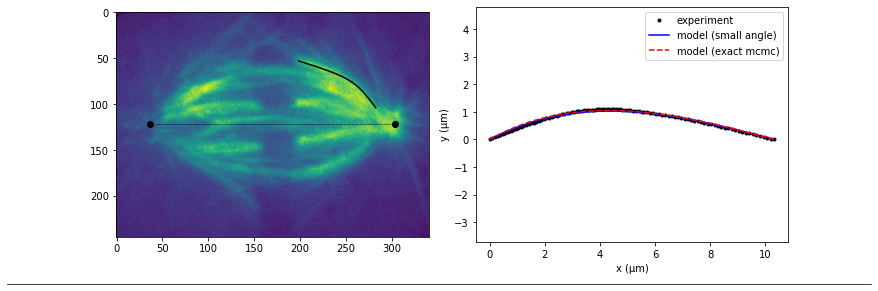

Fy_Mp_only
20210526_cell004 3
pole_right 28.035
P-K distance (L) =  7.48 um
Initial angle =  11.65 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 403.93it/s]


Exact method error (mcmc): 0.0198
Small-angle error: 0.0196


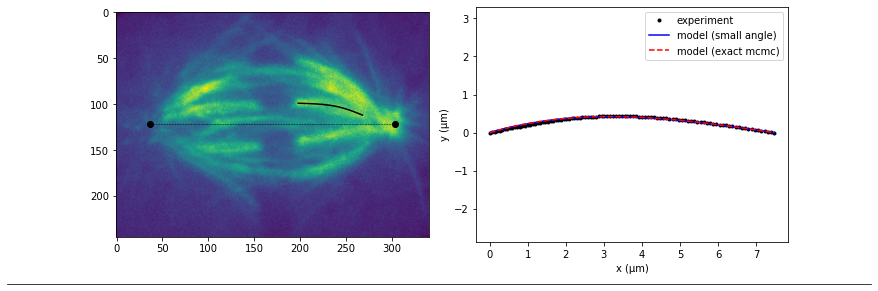

Fy_Mp_only
20210526_cell004 4
pole_right 28.035
P-K distance (L) =  8.60 um
Initial angle =  1.56 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 399.35it/s]


Exact method error (mcmc): 0.0056
Small-angle error: 0.0064


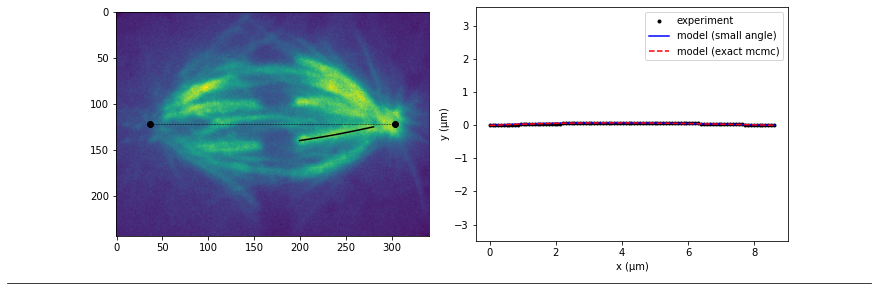

Fy_Mp_only
20210526_cell004 5
pole_right 28.035
P-K distance (L) =  10.24 um
Initial angle =  22.64 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 398.89it/s]


Exact method error (mcmc): 0.0478
Small-angle error: 0.0395


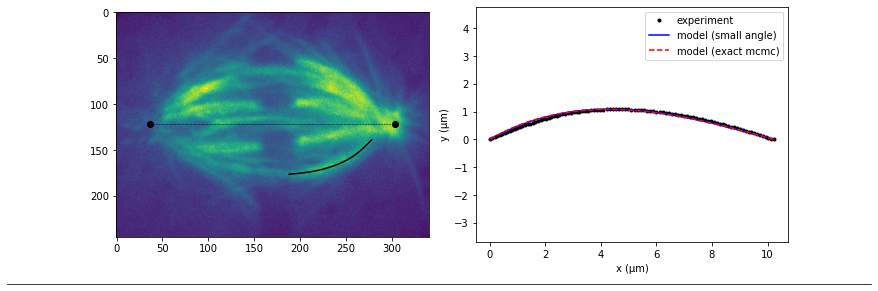

Fy_Mp_only
20210526_cell006 0
pole_left 23.998874973631576
P-K distance (L) =  8.55 um
Initial angle =  14.35 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 386.75it/s]


Exact method error (mcmc): 0.0410
Small-angle error: 0.0384


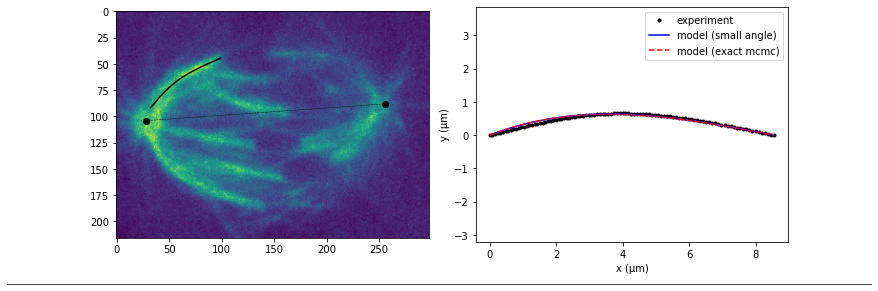

Fy_Mp_only
20210526_cell006 1
pole_left 23.998874973631576
P-K distance (L) =  13.26 um
Initial angle =  30.14 degrees


100%|████████████████████████████████████| 10000/10000 [00:29<00:00, 341.13it/s]


Exact method error (mcmc): 0.0586
Small-angle error: 0.0704


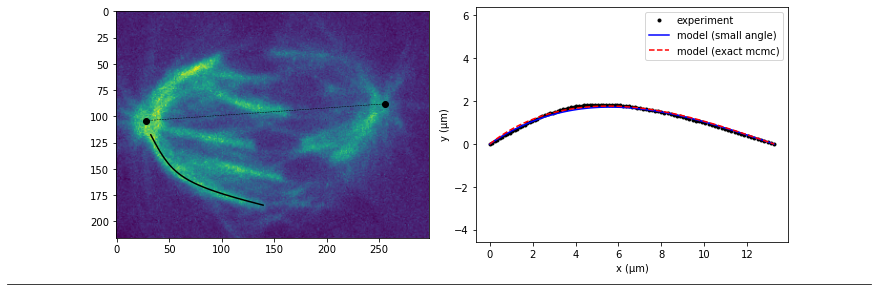

Fy_Mp_only
20210526_cell006 2
pole_left 23.998874973631576
P-K distance (L) =  9.00 um
Initial angle =  2.39 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 396.87it/s]


Exact method error (mcmc): 0.0066
Small-angle error: 0.0077


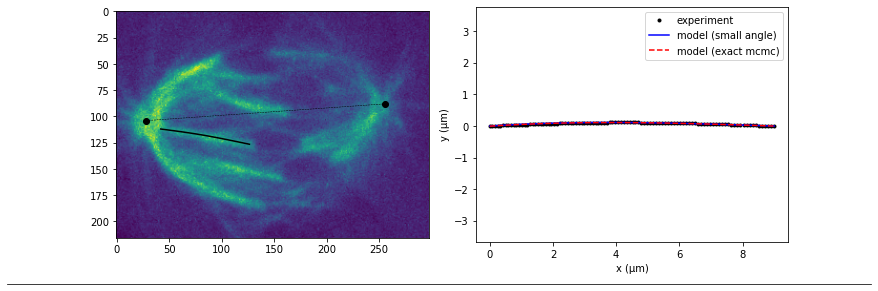

Fy_Mp_only
20210526_cell007 0
pole_left 26.275397713450506
P-K distance (L) =  8.61 um
Initial angle =  12.54 degrees


100%|████████████████████████████████████| 10000/10000 [00:27<00:00, 361.69it/s]


Exact method error (mcmc): 0.0107
Small-angle error: 0.0111


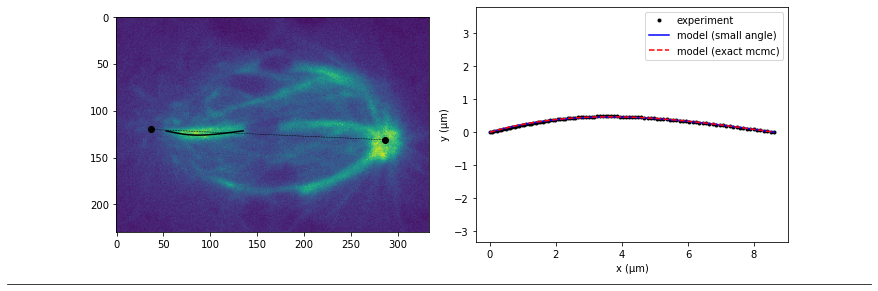

Fy_Mp_only
20210526_cell007 1
pole_right 26.275397713450506
P-K distance (L) =  10.99 um
Initial angle =  17.37 degrees


100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 384.32it/s]


Exact method error (mcmc): 0.0157
Small-angle error: 0.0122


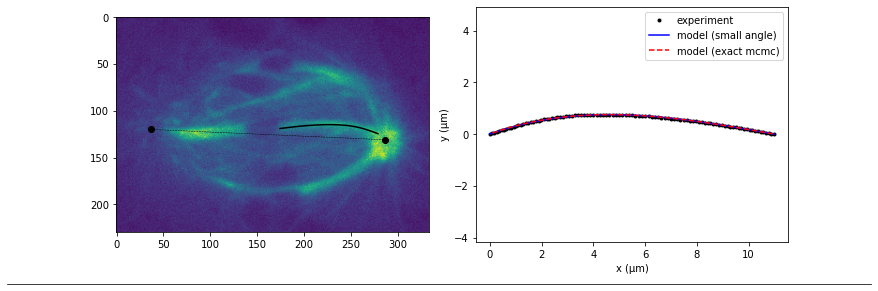

Fy_Mp_only
20210526_cell007 2
pole_right 26.275397713450506
P-K distance (L) =  8.85 um
Initial angle =  17.35 degrees


100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 381.62it/s]


Exact method error (mcmc): 0.0486
Small-angle error: 0.0445


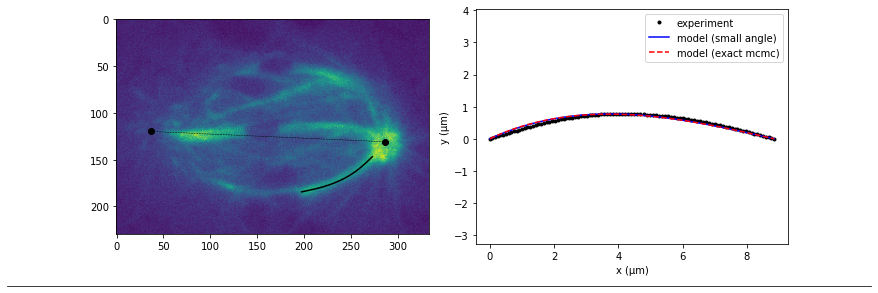

Fy_Mp_only
20210526_cell007 3
pole_right 26.275397713450506
P-K distance (L) =  11.33 um
Initial angle =  41.81 degrees


100%|████████████████████████████████████| 10000/10000 [00:27<00:00, 362.46it/s]


Exact method error (mcmc): 0.0655
Small-angle error: 0.0246


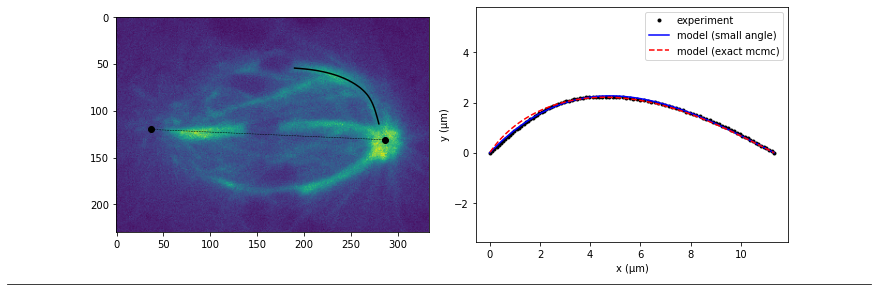

Fy_Mk_only
20171215_cell004 0
pole_left 14.979744078254473
P-K distance (L) =  6.39 um
Initial angle =  10.26 degrees


100%|████████████████████████████████████| 10000/10000 [00:28<00:00, 353.92it/s]


Exact method error (mcmc): 0.0505
Small-angle error: 0.0505


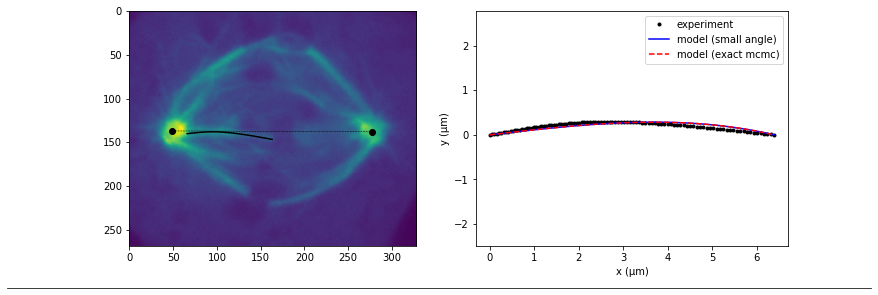

Fy_Mk_only
20171215_cell004 1
pole_right 14.979744078254473
P-K distance (L) =  6.69 um
Initial angle =  4.86 degrees


100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 370.64it/s]


Exact method error (mcmc): 0.0151
Small-angle error: 0.0141


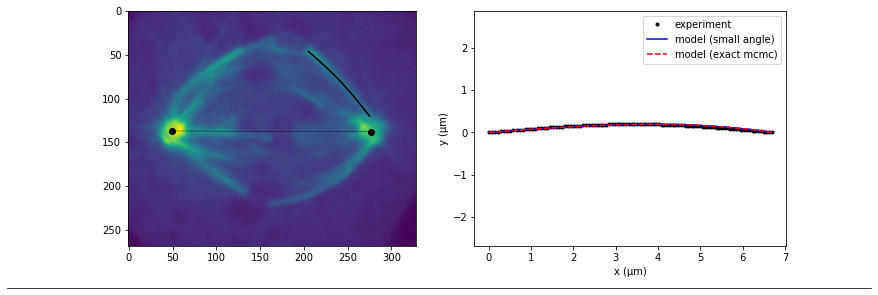

Fy_Mk_only
20171215_cell004 2
pole_right 14.979744078254473
P-K distance (L) =  8.38 um
Initial angle =  22.45 degrees


100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 371.66it/s]


Exact method error (mcmc): 0.1315
Small-angle error: 0.1223


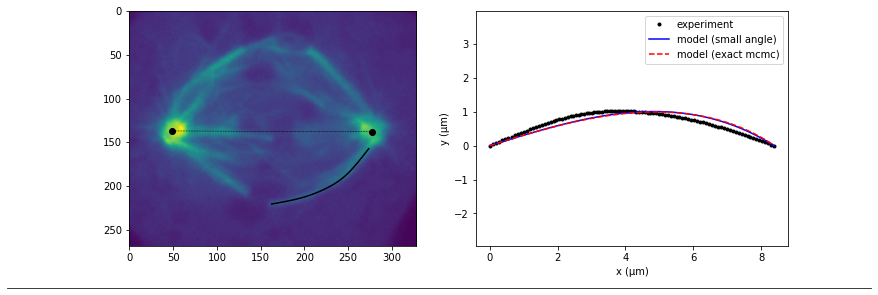

Fy_Mk_only
20171215_cell004 3
pole_right 14.979744078254473
P-K distance (L) =  8.35 um
Initial angle =  28.00 degrees


100%|████████████████████████████████████| 10000/10000 [00:27<00:00, 369.57it/s]


Exact method error (mcmc): 0.1482
Small-angle error: 0.1404


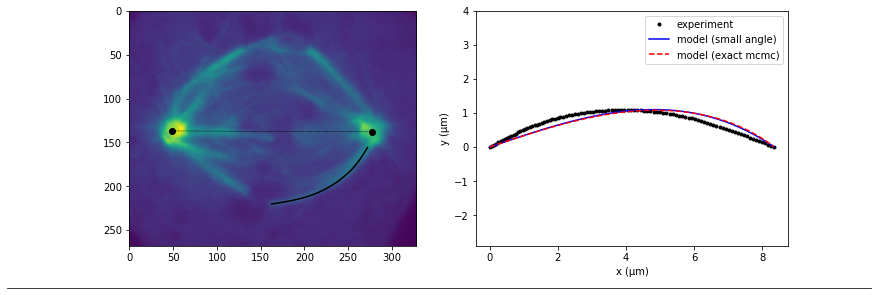

Fy_Mk_only
20171215_cell004a 0
pole_left 14.3883
P-K distance (L) =  8.23 um
Initial angle =  21.61 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 398.34it/s]


Exact method error (mcmc): 0.1210
Small-angle error: 0.1162


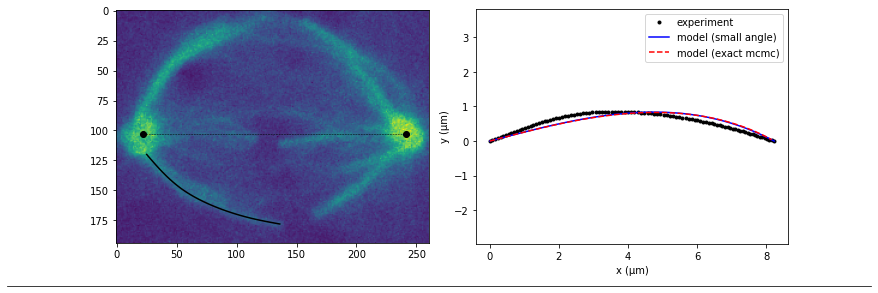

Fy_Mk_only
20171215_cell004a 1
pole_right 14.3883
P-K distance (L) =  5.78 um
Initial angle =  5.82 degrees


100%|████████████████████████████████████| 10000/10000 [00:33<00:00, 300.42it/s]


Exact method error (mcmc): 0.0237
Small-angle error: 0.0238


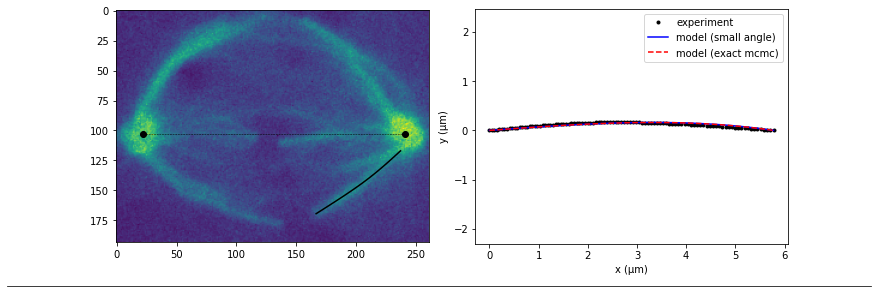

Fy_Mk_only
20171215_cell005 0
pole_left 13.807007798940361
P-K distance (L) =  6.22 um
Initial angle =  25.90 degrees


100%|████████████████████████████████████| 10000/10000 [00:28<00:00, 356.74it/s]


Exact method error (mcmc): 0.1170
Small-angle error: 0.1114


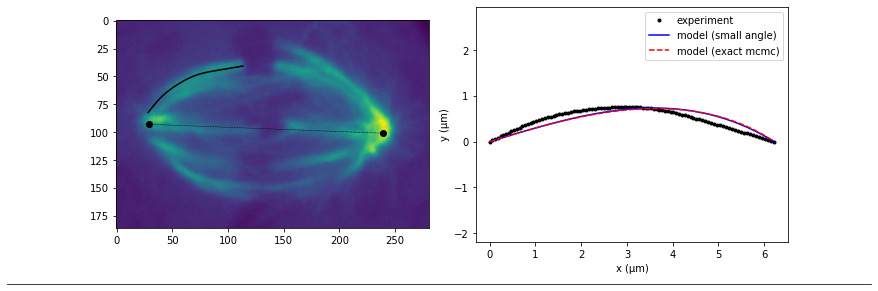

Fy_Mk_only
20171215_cell005 1
pole_right 13.807007798940361
P-K distance (L) =  7.42 um
Initial angle =  17.45 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 402.28it/s]


Exact method error (mcmc): 0.0732
Small-angle error: 0.0699


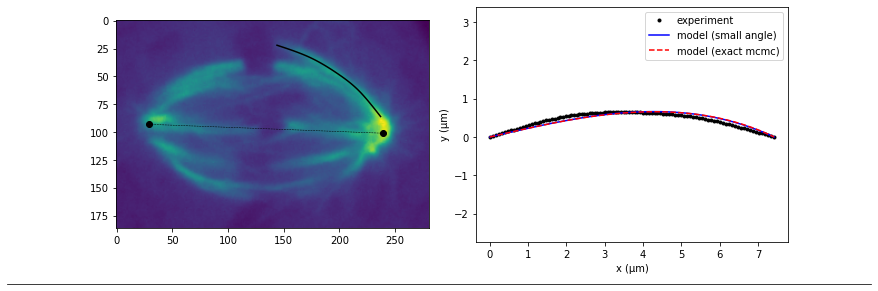

Fy_Mk_only
20171215_cell005 2
pole_right 13.807007798940361
P-K distance (L) =  5.44 um
Initial angle =  15.00 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 403.43it/s]


Exact method error (mcmc): 0.0644
Small-angle error: 0.0633


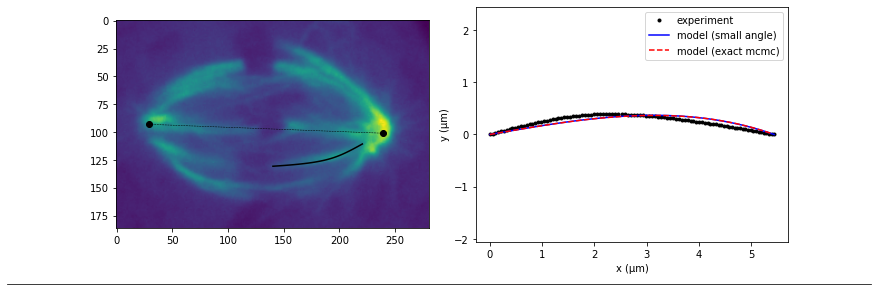

Fy_Mk_only
20171219_cell003 0
pole_left 16.766377403899746
P-K distance (L) =  8.12 um
Initial angle =  9.10 degrees


100%|████████████████████████████████████| 10000/10000 [00:27<00:00, 368.81it/s]


Exact method error (mcmc): 0.0351
Small-angle error: 0.0350


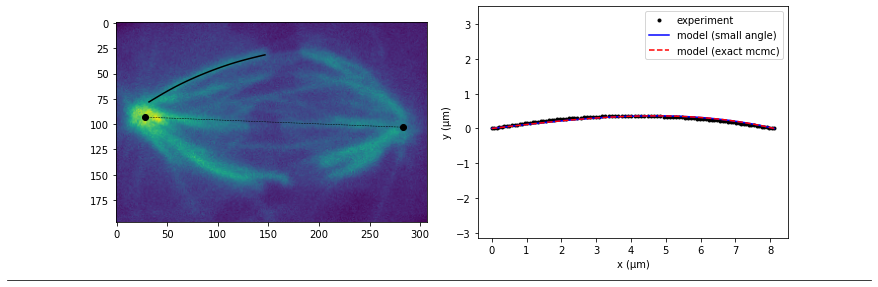

Fy_Mk_only
20171219_cell003 1
pole_left 16.766377403899746
P-K distance (L) =  5.50 um
Initial angle =  8.75 degrees


100%|████████████████████████████████████| 10000/10000 [00:27<00:00, 362.04it/s]


Exact method error (mcmc): 0.0331
Small-angle error: 0.0331


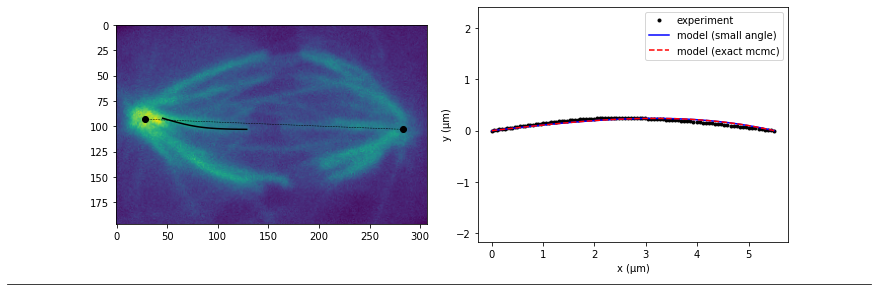

Fy_Mk_only
20180611_cell002 0
pole_left 14.283473842171588
P-K distance (L) =  6.64 um
Initial angle =  22.71 degrees


100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 380.96it/s]


Exact method error (mcmc): 0.1218
Small-angle error: 0.1180


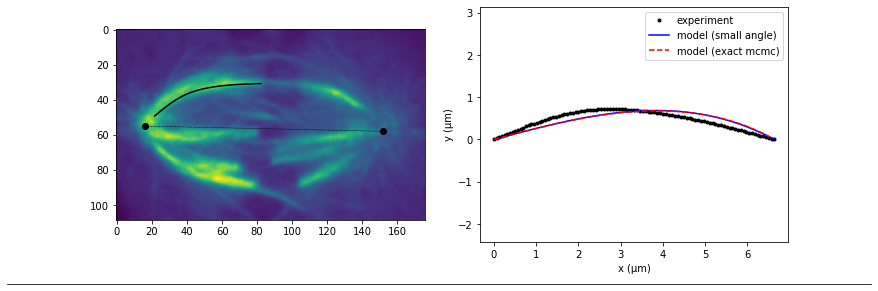

Fy_Mk_only
20180611_cell002 1
pole_left 14.283473842171588
P-K distance (L) =  6.59 um
Initial angle =  21.91 degrees


100%|████████████████████████████████████| 10000/10000 [00:29<00:00, 338.51it/s]


Exact method error (mcmc): 0.1013
Small-angle error: 0.0956


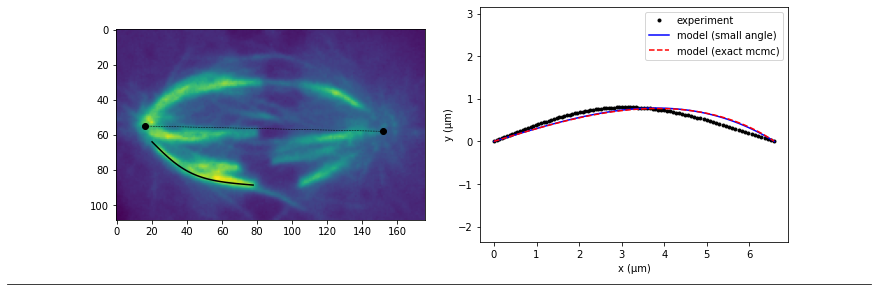

Fy_Mk_only
20180611_cell002 2
pole_left 14.283473842171588
P-K distance (L) =  6.59 um
Initial angle =  21.91 degrees


100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 373.95it/s]


Exact method error (mcmc): 0.1013
Small-angle error: 0.0956


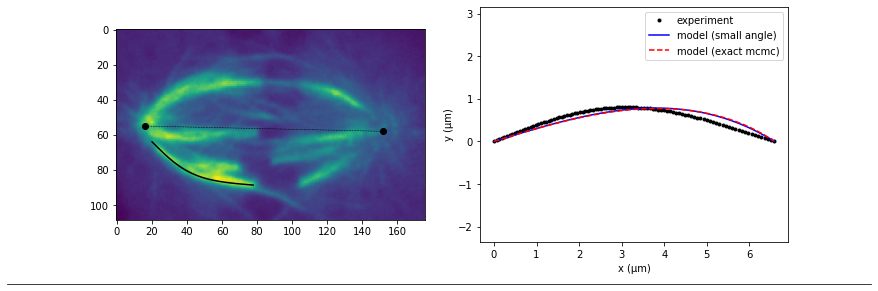

Fy_Mk_only
20180612_cell001 0
pole_left 14.806489286795841
P-K distance (L) =  7.85 um
Initial angle =  21.07 degrees


100%|████████████████████████████████████| 10000/10000 [00:28<00:00, 349.40it/s]


Exact method error (mcmc): 0.1206
Small-angle error: 0.1139


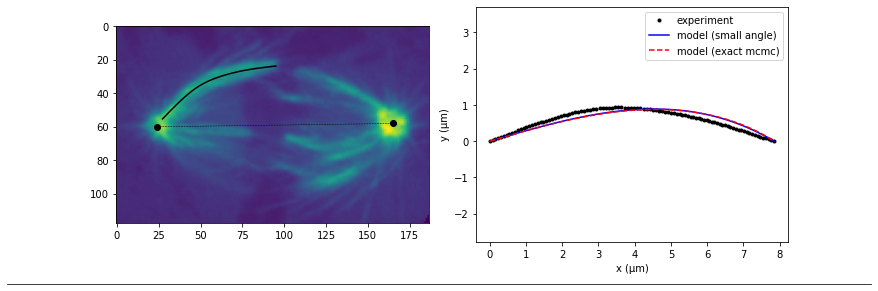

Fy_Mk_only
20180612_cell001 1
pole_left 14.806489286795841
P-K distance (L) =  4.69 um
Initial angle =  11.81 degrees


100%|████████████████████████████████████| 10000/10000 [00:27<00:00, 369.81it/s]


Exact method error (mcmc): 0.0500
Small-angle error: 0.0500


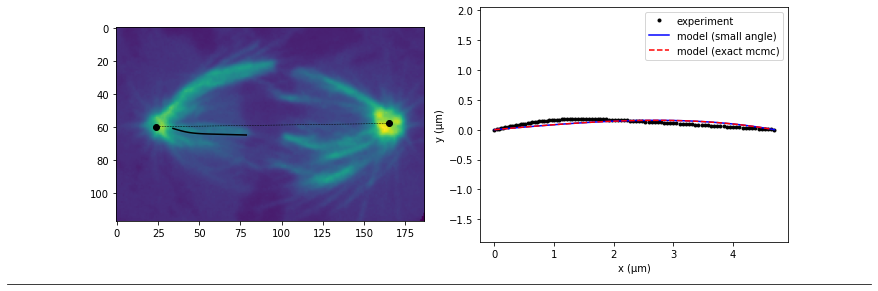

Fy_Mk_only
20180612_cell003 0
pole_left 13.021693438259096
P-K distance (L) =  5.70 um
Initial angle =  23.85 degrees


100%|████████████████████████████████████| 10000/10000 [00:28<00:00, 351.72it/s]


Exact method error (mcmc): 0.0834
Small-angle error: 0.0820


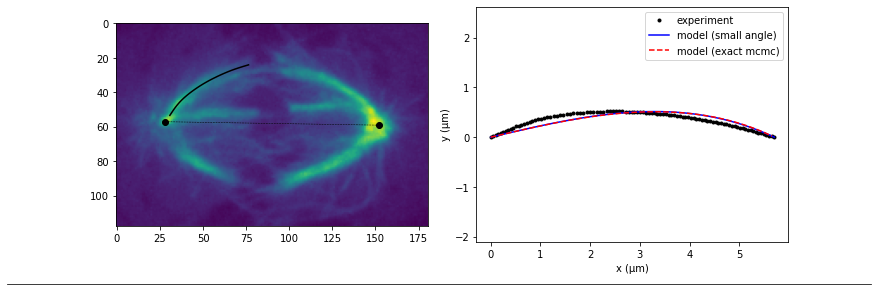

Fy_Mk_only
20180612_cell003 1
pole_left 13.021693438259096
P-K distance (L) =  4.84 um
Initial angle =  15.69 degrees


100%|████████████████████████████████████| 10000/10000 [00:29<00:00, 343.00it/s]


Exact method error (mcmc): 0.0749
Small-angle error: 0.0745


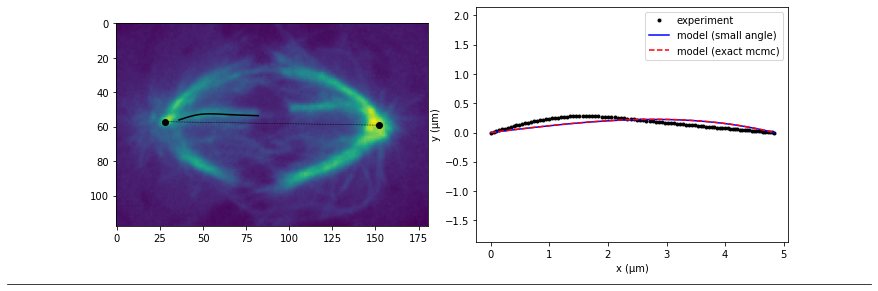

Fy_Mk_only
20180612_cell003 2
pole_right 13.021693438259096
P-K distance (L) =  5.89 um
Initial angle =  23.08 degrees


100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 373.86it/s]


Exact method error (mcmc): 0.0907
Small-angle error: 0.0879


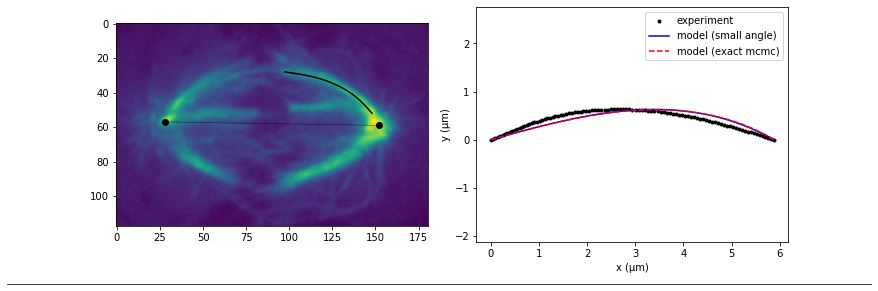

Fy_Mk_only
20180620_cell013 0
pole_left 14.625561527681594
P-K distance (L) =  5.89 um
Initial angle =  4.07 degrees


100%|████████████████████████████████████| 10000/10000 [00:27<00:00, 362.45it/s]


Exact method error (mcmc): 0.0217
Small-angle error: 0.0183


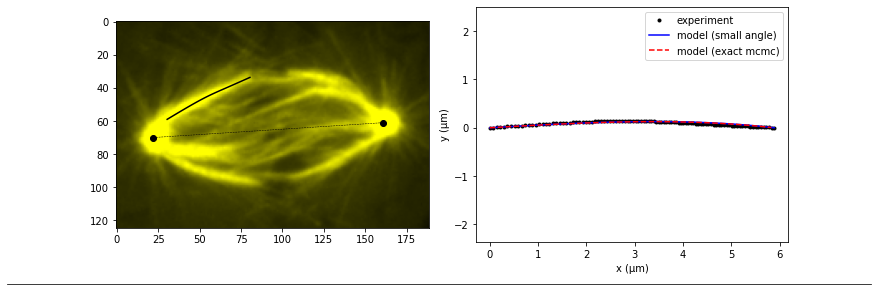

Fy_Mk_only
20180620_cell013 1
pole_left 14.625561527681594
P-K distance (L) =  6.28 um
Initial angle =  16.50 degrees


100%|████████████████████████████████████| 10000/10000 [00:28<00:00, 348.95it/s]


Exact method error (mcmc): 0.0789
Small-angle error: 0.0780


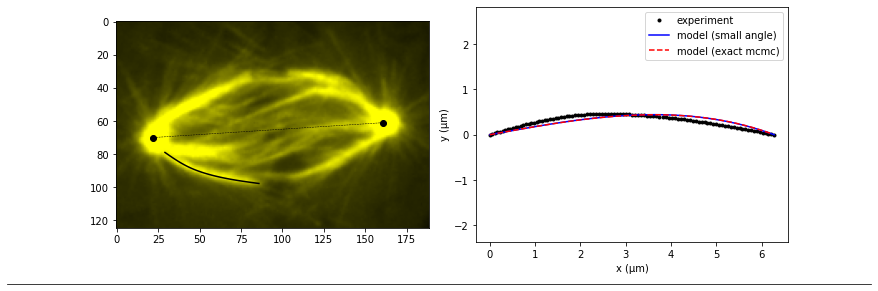

Fy_Mk_only
20180620_cell013 2
pole_right 14.625561527681594
P-K distance (L) =  6.07 um
Initial angle =  7.39 degrees


100%|████████████████████████████████████| 10000/10000 [00:28<00:00, 348.47it/s]


Exact method error (mcmc): 0.0083
Small-angle error: 0.0082


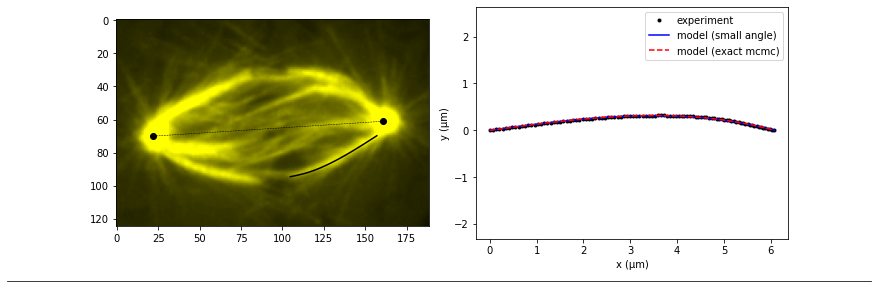

Fy_Mk_only
20180622_cell015 0
pole_left 16.388411301892564
P-K distance (L) =  7.51 um
Initial angle =  18.18 degrees


100%|████████████████████████████████████| 10000/10000 [00:28<00:00, 352.79it/s]


Exact method error (mcmc): 0.1047
Small-angle error: 0.1046


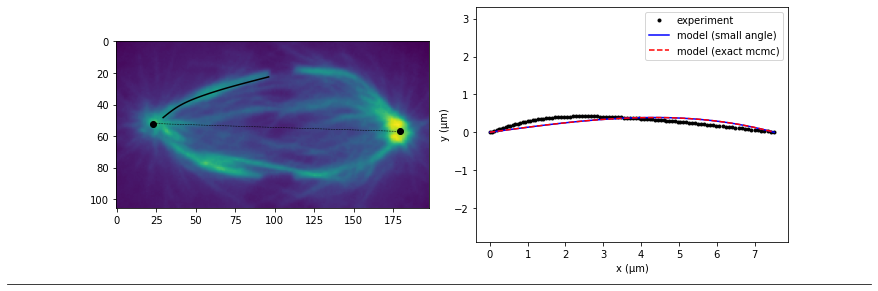

Fy_Mk_only
20180622_cell015 1
pole_left 16.388411301892564
P-K distance (L) =  7.19 um
Initial angle =  18.74 degrees


100%|████████████████████████████████████| 10000/10000 [00:27<00:00, 369.88it/s]


Exact method error (mcmc): 0.0967
Small-angle error: 0.0939


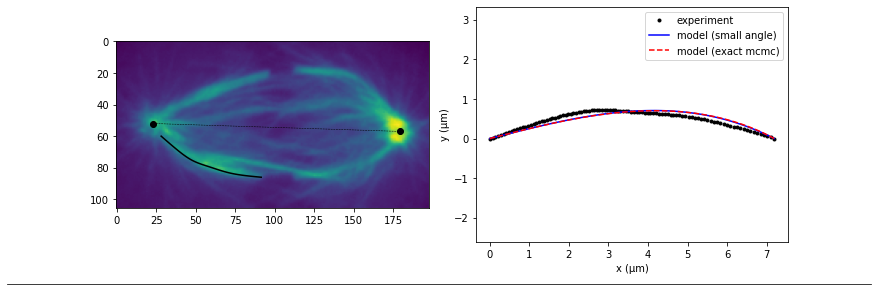

Fy_Mk_only
20180622_cell016 0
pole_left 15.225
P-K distance (L) =  6.11 um
Initial angle =  13.57 degrees


100%|████████████████████████████████████| 10000/10000 [00:27<00:00, 370.25it/s]


Exact method error (mcmc): 0.0570
Small-angle error: 0.0546


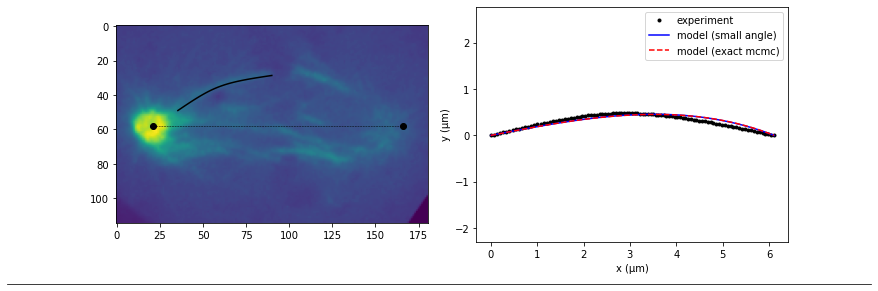

Fy_Mk_only
20180622_cell020 0
pole_left 12.401117893157858
P-K distance (L) =  6.69 um
Initial angle =  28.34 degrees


100%|████████████████████████████████████| 10000/10000 [00:27<00:00, 363.32it/s]


Exact method error (mcmc): 0.1209
Small-angle error: 0.1183


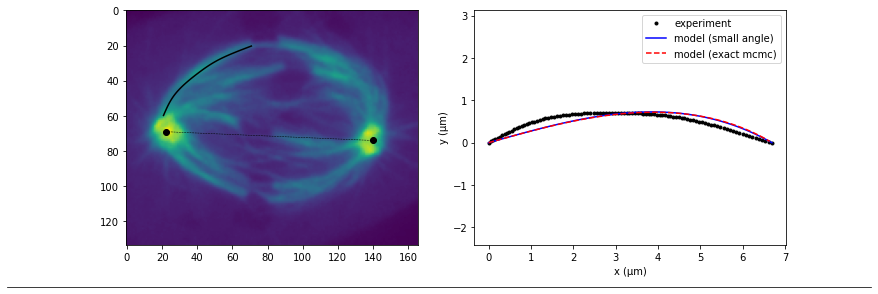

Fy_Mk_only
20180622_cell020 1
pole_right 12.401117893157858
P-K distance (L) =  6.03 um
Initial angle =  24.49 degrees


100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 378.44it/s]


Exact method error (mcmc): 0.0910
Small-angle error: 0.0821


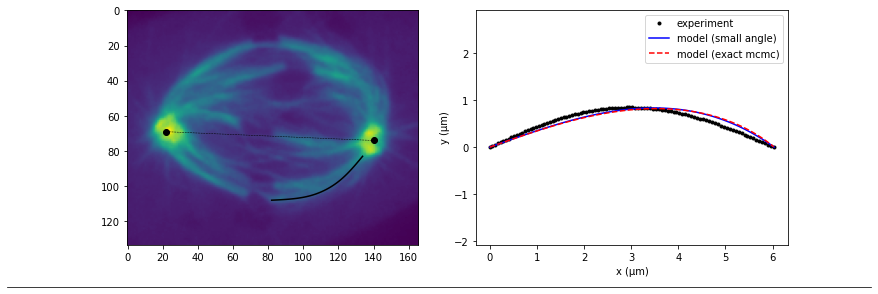

Fy_Mk_only
20180622_cell020 2
pole_left 12.401117893157858
P-K distance (L) =  5.00 um
Initial angle =  13.21 degrees


100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 378.46it/s]


Exact method error (mcmc): 0.0536
Small-angle error: 0.0526


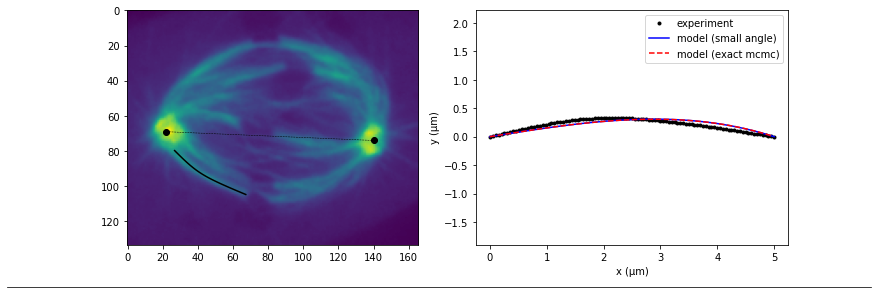

Fy_Mk_only
20180622_cell020 3
pole_right 12.401117893157858
P-K distance (L) =  5.47 um
Initial angle =  25.99 degrees


100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 374.51it/s]


Exact method error (mcmc): 0.0918
Small-angle error: 0.0882


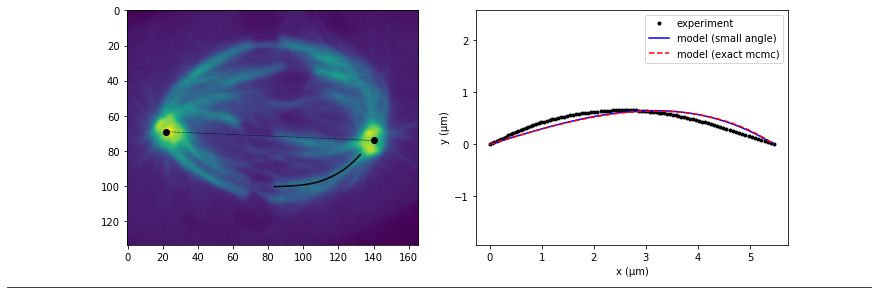

Fy_Mk_only
20180622_cell026 0
pole_left 14.598398884809251
P-K distance (L) =  5.74 um
Initial angle =  24.35 degrees


100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 376.61it/s]


Exact method error (mcmc): 0.0931
Small-angle error: 0.0925


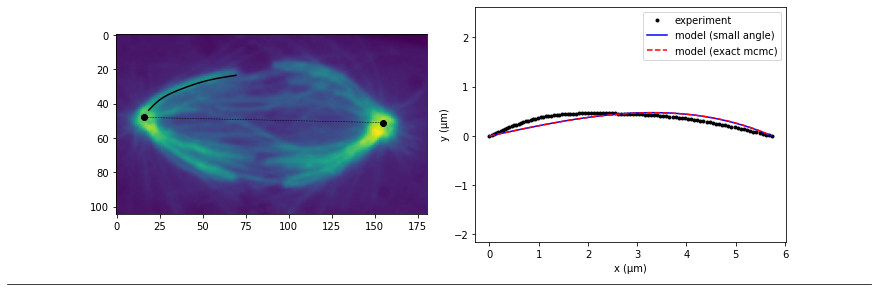

Fy_Mk_only
20180622_cell026 1
pole_left 14.598398884809251
P-K distance (L) =  5.88 um
Initial angle =  13.64 degrees


100%|████████████████████████████████████| 10000/10000 [00:27<00:00, 365.89it/s]


Exact method error (mcmc): 0.0518
Small-angle error: 0.0508


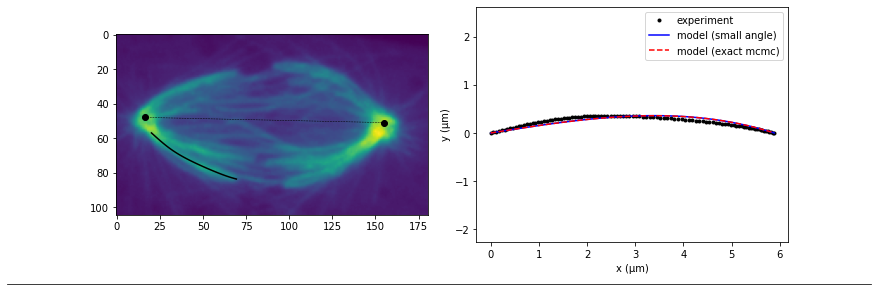

Fy_Mk_only
20180622_cell026 2
pole_right 14.598398884809251
P-K distance (L) =  6.41 um
Initial angle =  33.09 degrees


100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 379.78it/s]


Exact method error (mcmc): 0.1763
Small-angle error: 0.1685


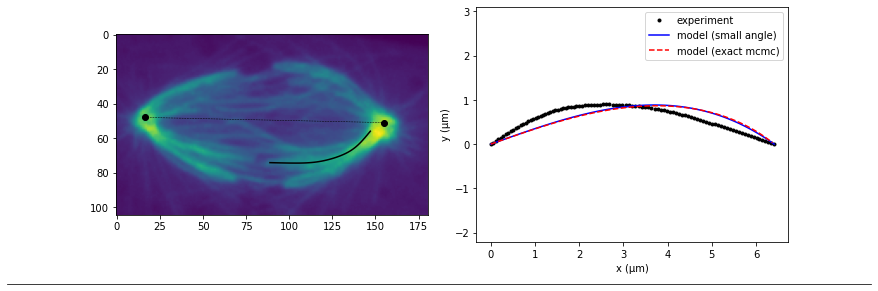

Fy_Mk_only
20180622_cell026 3
pole_right 14.598398884809251
P-K distance (L) =  6.13 um
Initial angle =  22.85 degrees


100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 371.01it/s]


Exact method error (mcmc): 0.0877
Small-angle error: 0.0821


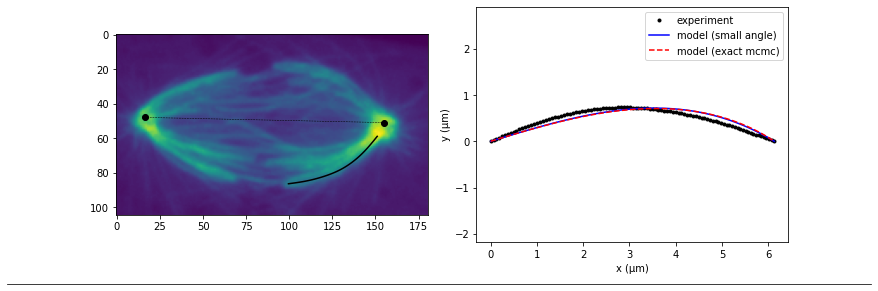

Fy_Mk_only
20180622_cell027 0
pole_left 14.181220857175873
P-K distance (L) =  4.89 um
Initial angle =  9.20 degrees


100%|████████████████████████████████████| 10000/10000 [00:27<00:00, 359.20it/s]


Exact method error (mcmc): 0.0429
Small-angle error: 0.0421


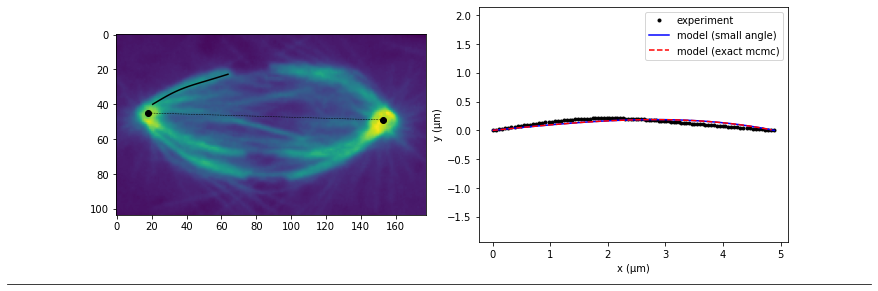

Fy_Mk_only
20180622_cell027 1
pole_left 14.181220857175873
P-K distance (L) =  5.44 um
Initial angle =  15.19 degrees


100%|████████████████████████████████████| 10000/10000 [00:36<00:00, 275.04it/s]


Exact method error (mcmc): 0.0477
Small-angle error: 0.0470


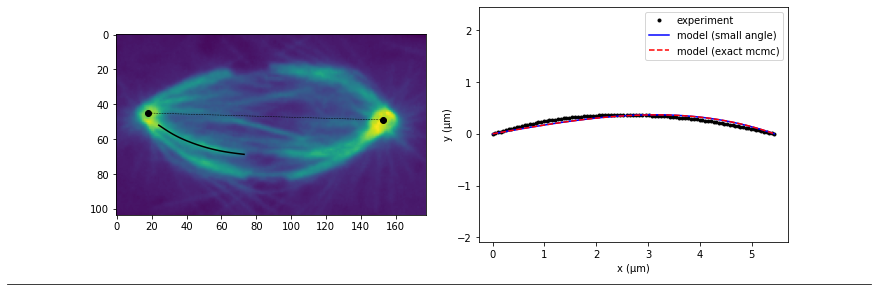

Fy_Mk_only
20180622_cell027 2
pole_left 14.181220857175873
P-K distance (L) =  6.23 um
Initial angle =  20.25 degrees


100%|████████████████████████████████████| 10000/10000 [00:30<00:00, 330.30it/s]


Exact method error (mcmc): 0.0709
Small-angle error: 0.0693


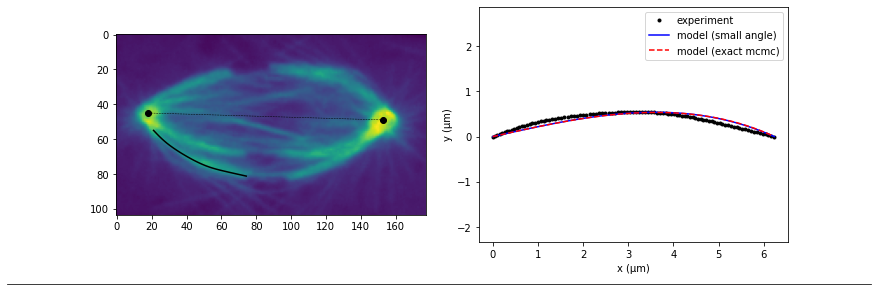

Fy_Mk_only
20180622_cell027 3
pole_right 14.181220857175873
P-K distance (L) =  6.82 um
Initial angle =  21.28 degrees


100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 375.68it/s]


Exact method error (mcmc): 0.1083
Small-angle error: 0.1046


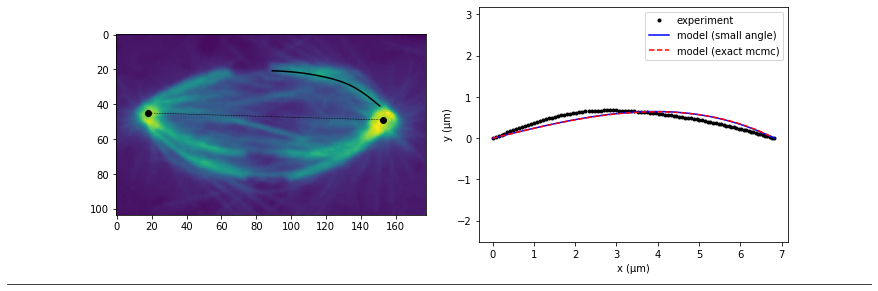

Fy_Mk_only
20180622_cell027 4
pole_right 14.181220857175873
P-K distance (L) =  5.78 um
Initial angle =  15.63 degrees


100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 376.72it/s]


Exact method error (mcmc): 0.0541
Small-angle error: 0.0512


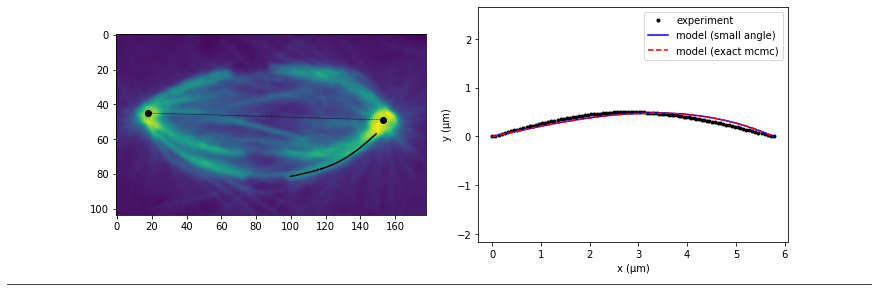

Fy_Mk_only
20180622_cell028 0
pole_left 16.907934527907305
P-K distance (L) =  7.63 um
Initial angle =  15.89 degrees


100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 378.45it/s]


Exact method error (mcmc): 0.0787
Small-angle error: 0.0767


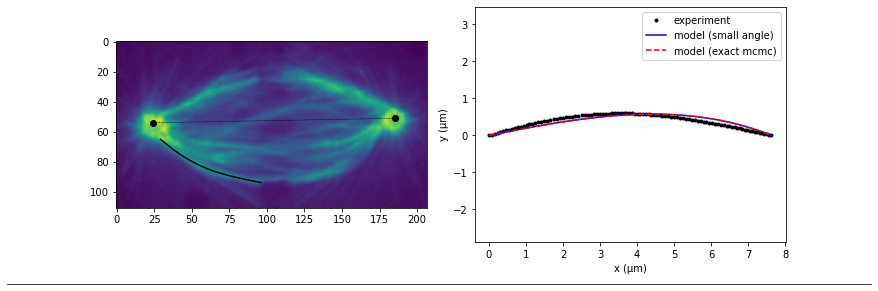

Fy_Mk_only
20180622_cell028 1
pole_right 16.907934527907305
P-K distance (L) =  5.90 um
Initial angle =  26.89 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 387.25it/s]


Exact method error (mcmc): 0.1349
Small-angle error: 0.1307


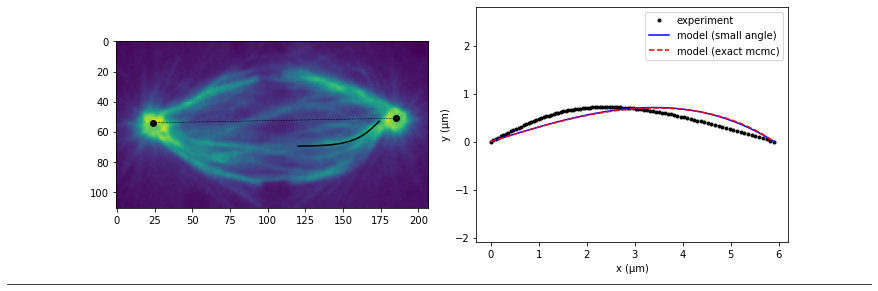

Fy_Mk_only
20180622_cell030 0
pole_left 14.071567076910801
P-K distance (L) =  5.60 um
Initial angle =  31.47 degrees


100%|████████████████████████████████████| 10000/10000 [00:27<00:00, 364.88it/s]


Exact method error (mcmc): 0.1322
Small-angle error: 0.1227


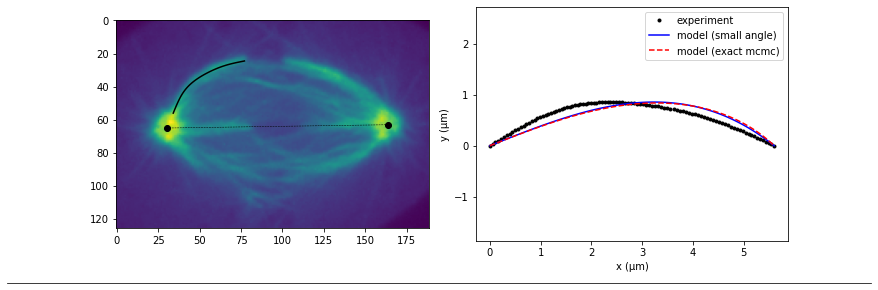

Fy_Mk_only
20180622_cell030 1
pole_right 14.071567076910801
P-K distance (L) =  6.70 um
Initial angle =  23.23 degrees


100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 376.21it/s]


Exact method error (mcmc): 0.1061
Small-angle error: 0.1036


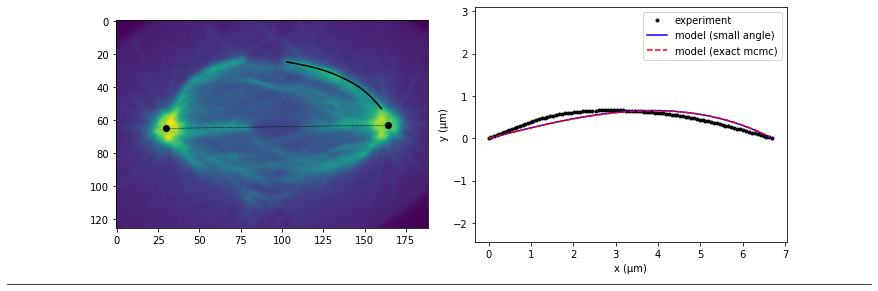

Fy_Mk_only
20180626_cell001 0
pole_left 14.286175135423758
P-K distance (L) =  6.04 um
Initial angle =  15.38 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 394.88it/s]


Exact method error (mcmc): 0.0805
Small-angle error: 0.0797


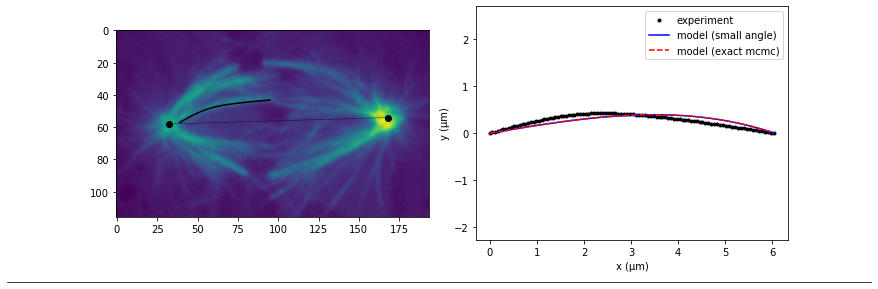

Fy_Mk_only
20180626_cell001 1
pole_left 14.286175135423758
P-K distance (L) =  5.18 um
Initial angle =  18.14 degrees


100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 375.77it/s]


Exact method error (mcmc): 0.0616
Small-angle error: 0.0587


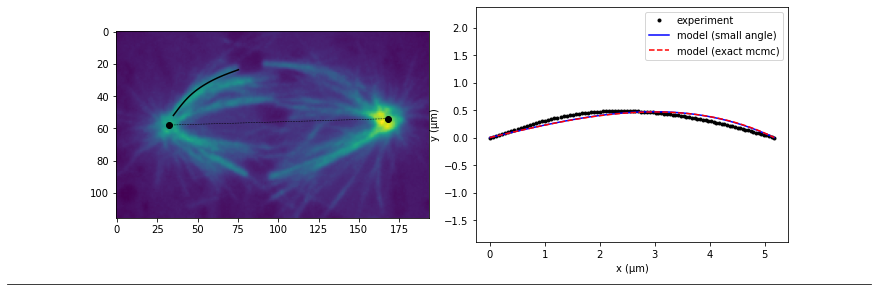

Fy_Mk_only
20180626_cell001 2
pole_right 14.286175135423758
P-K distance (L) =  6.93 um
Initial angle =  31.42 degrees


100%|████████████████████████████████████| 10000/10000 [00:27<00:00, 358.45it/s]


Exact method error (mcmc): 0.1778
Small-angle error: 0.1710


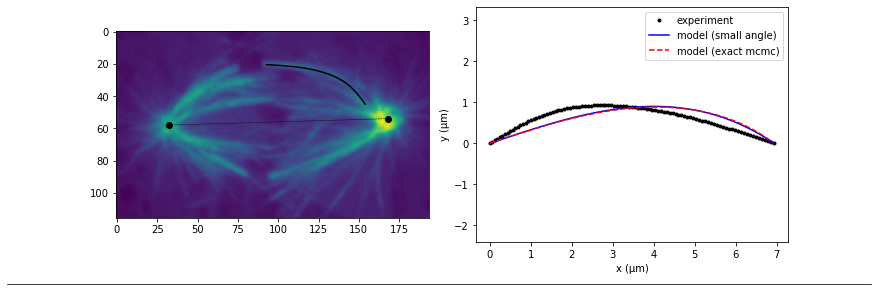

Fy_Mk_only
20180628_cell002 0
pole_left 13.236664987828316
P-K distance (L) =  7.16 um
Initial angle =  15.71 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 384.93it/s]


Exact method error (mcmc): 0.0693
Small-angle error: 0.0677


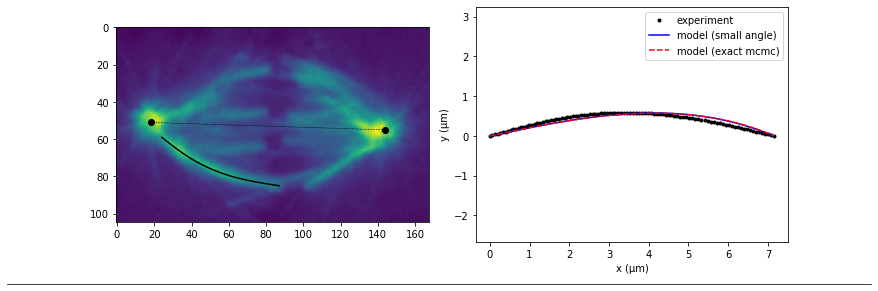

Fy_Mk_only
20180628_cell006 0
pole_left 16.826557134482385
P-K distance (L) =  6.16 um
Initial angle =  18.85 degrees


100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 382.96it/s]


Exact method error (mcmc): 0.1038
Small-angle error: 0.1021


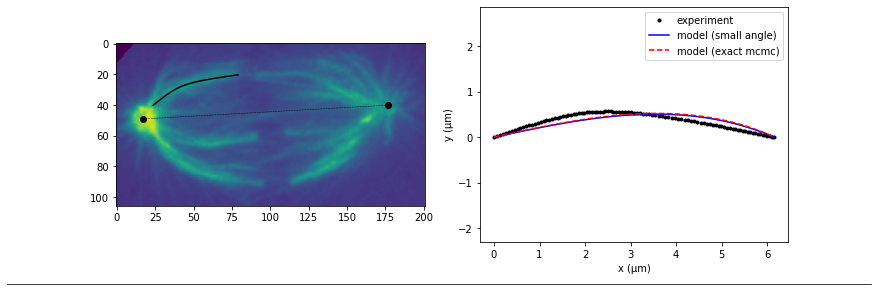

Fy_Mk_only
20180628_cell006 1
pole_left 16.826557134482385
P-K distance (L) =  6.62 um
Initial angle =  30.69 degrees


100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 375.37it/s]


Exact method error (mcmc): 0.1723
Small-angle error: 0.1683


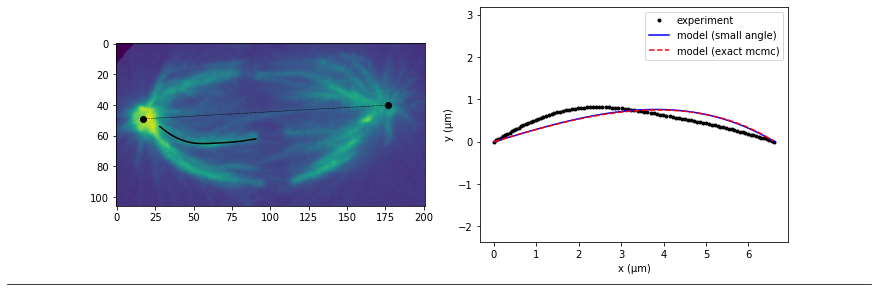

Fy_Mk_only
20180628_cell006 2
pole_left 16.826557134482385
P-K distance (L) =  8.07 um
Initial angle =  33.12 degrees


100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 381.93it/s]


Exact method error (mcmc): 0.2235
Small-angle error: 0.2143


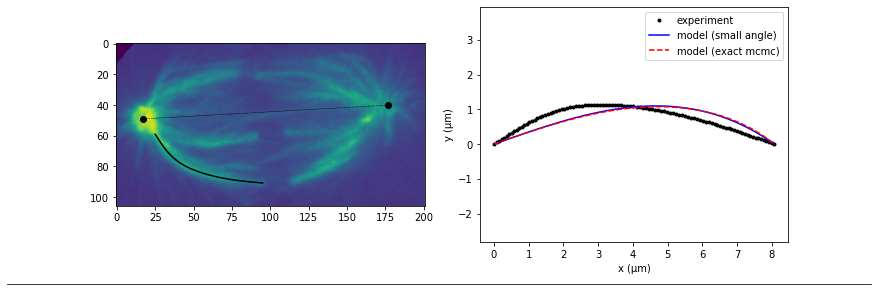

Fy_Mk_only
20180628_cell010 0
pole_left 12.8117211958425
P-K distance (L) =  5.65 um
Initial angle =  18.30 degrees


100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 381.96it/s]


Exact method error (mcmc): 0.0745
Small-angle error: 0.0700


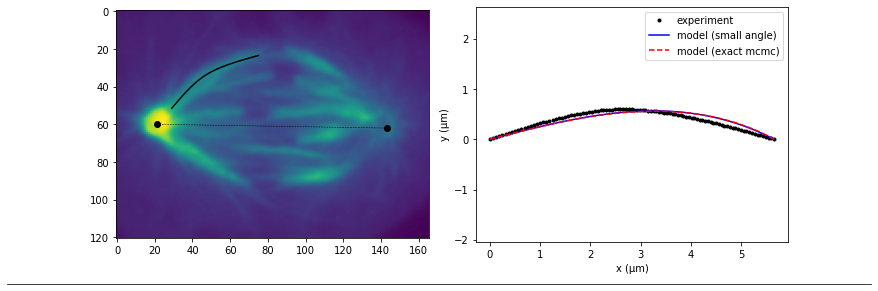

Fy_Mk_only
20180628_cell010 1
pole_left 12.8117211958425
P-K distance (L) =  3.77 um
Initial angle =  13.11 degrees


100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 375.54it/s]


Exact method error (mcmc): 0.0363
Small-angle error: 0.0362


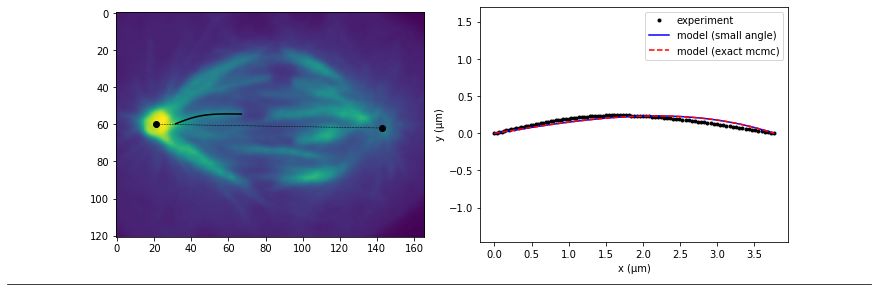

Fy_Mk_only
20180628_cell010 2
pole_left 12.8117211958425
P-K distance (L) =  5.36 um
Initial angle =  10.08 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 391.67it/s]


Exact method error (mcmc): 0.0218
Small-angle error: 0.0217


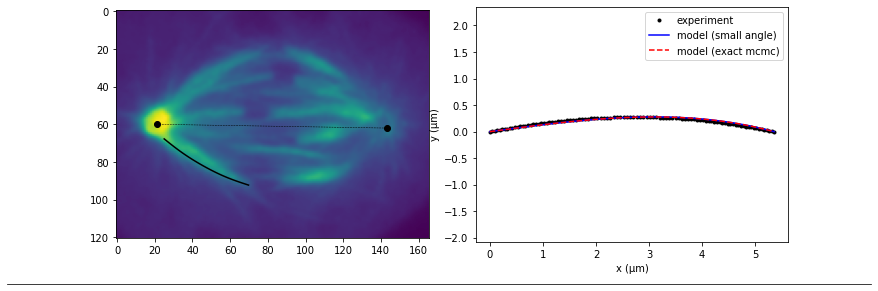

Fy_Mk_only
20180628_cell010 3
pole_right 12.8117211958425
P-K distance (L) =  5.25 um
Initial angle =  12.63 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 387.00it/s]


Exact method error (mcmc): 0.0642
Small-angle error: 0.0623


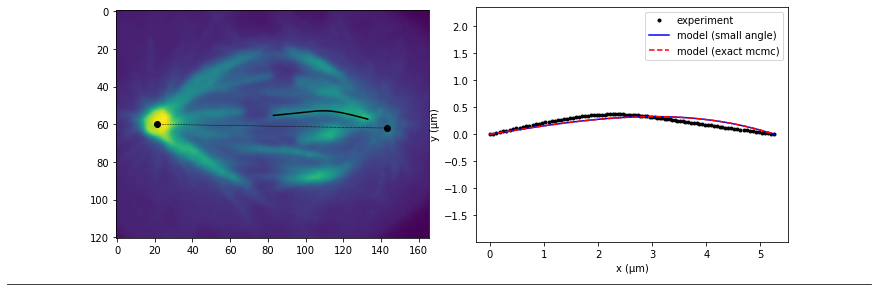

Fy_Mk_only
20180628_cell013 0
pole_left 15.015367128378845
P-K distance (L) =  7.91 um
Initial angle =  19.16 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 390.36it/s]


Exact method error (mcmc): 0.0903
Small-angle error: 0.0878


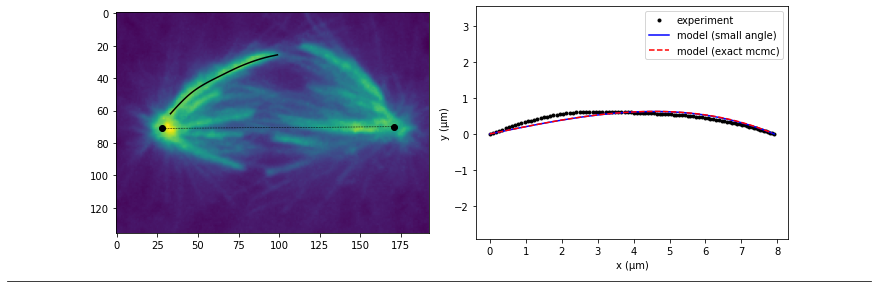

Fy_Mk_only
20180628_cell013 1
pole_left 15.015367128378845
P-K distance (L) =  3.82 um
Initial angle =  4.60 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 401.96it/s]


Exact method error (mcmc): 0.0069
Small-angle error: 0.0055


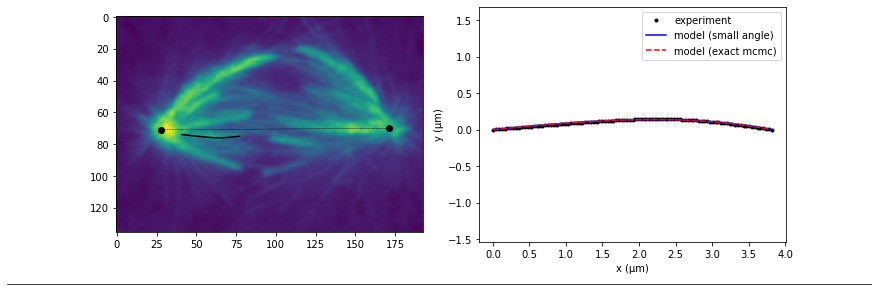

Fy_Mk_only
20180628_cell013 2
pole_left 15.015367128378845
P-K distance (L) =  4.54 um
Initial angle =  7.26 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 402.37it/s]


Exact method error (mcmc): 0.0267
Small-angle error: 0.0262


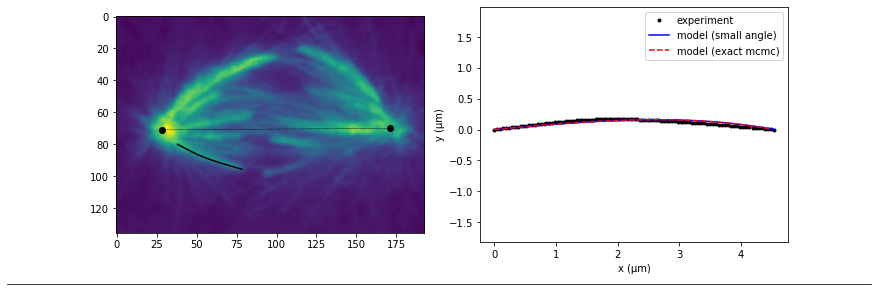

Fy_Mk_only
20180628_cell013 3
pole_right 15.015367128378845
P-K distance (L) =  6.59 um
Initial angle =  25.61 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 396.61it/s]


Exact method error (mcmc): 0.1228
Small-angle error: 0.1202


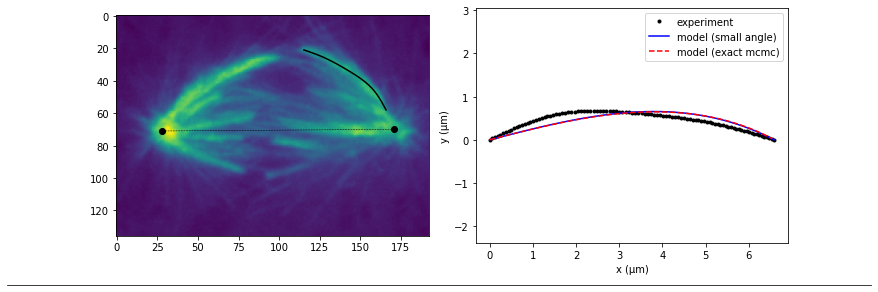

Fy_Mk_only
20180628_cell013 4
pole_right 15.015367128378845
P-K distance (L) =  6.37 um
Initial angle =  15.49 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 398.54it/s]


Exact method error (mcmc): 0.0627
Small-angle error: 0.0622


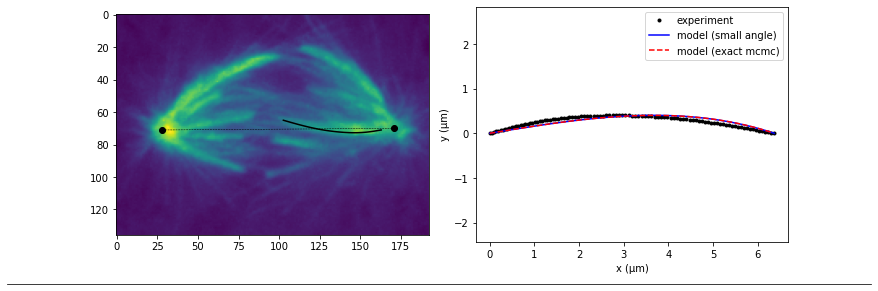

Fy_Mk_only
20180810_cell005 0
pole_left 14.527993667399501
P-K distance (L) =  5.53 um
Initial angle =  16.72 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 398.84it/s]


Exact method error (mcmc): 0.0623
Small-angle error: 0.0606


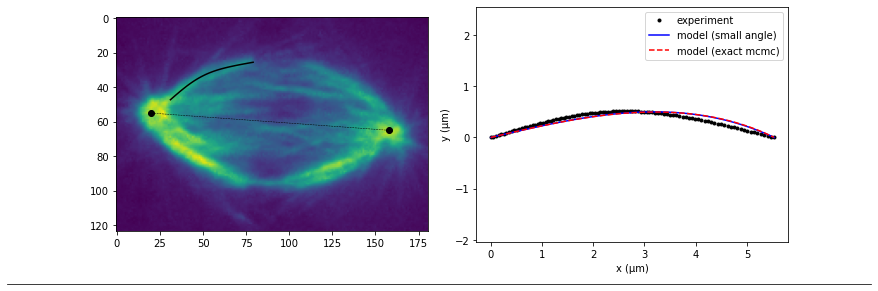

Fy_Mk_only
20180810_cell005 1
pole_right 14.527993667399501
P-K distance (L) =  5.86 um
Initial angle =  16.98 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 399.40it/s]


Exact method error (mcmc): 0.0712
Small-angle error: 0.0708


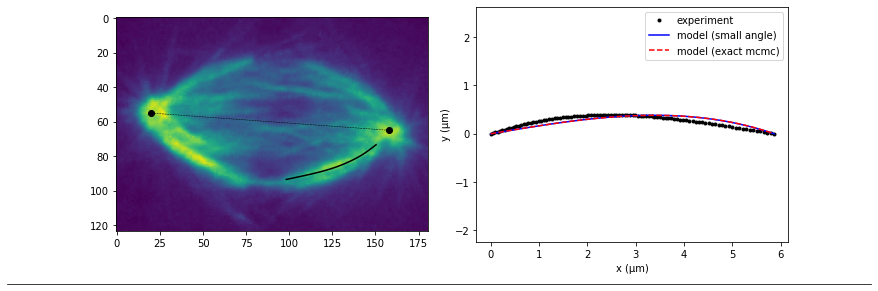

Fy_Mk_only
20180810_cell005 2
pole_left 14.527993667399501
P-K distance (L) =  6.05 um
Initial angle =  11.13 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 399.99it/s]


Exact method error (mcmc): 0.0366
Small-angle error: 0.0334


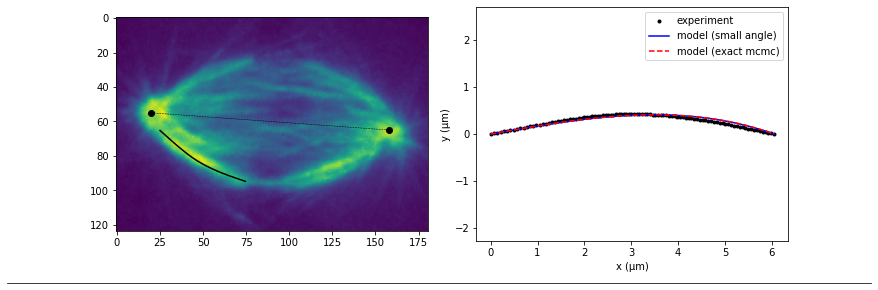

Fy_Mk_only
20180810_cell006 0
pole_left 16.811808350085364
P-K distance (L) =  5.45 um
Initial angle =  9.95 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 400.55it/s]


Exact method error (mcmc): 0.0293
Small-angle error: 0.0294


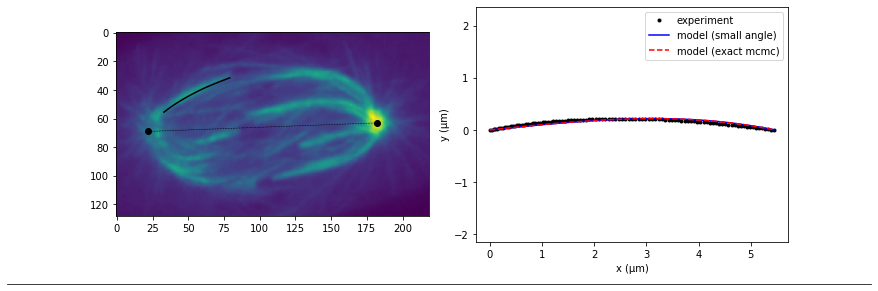

Fy_Mk_only
20180810_cell006 1
pole_right 16.811808350085364
P-K distance (L) =  8.93 um
Initial angle =  28.80 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 396.33it/s]


Exact method error (mcmc): 0.2265
Small-angle error: 0.2209


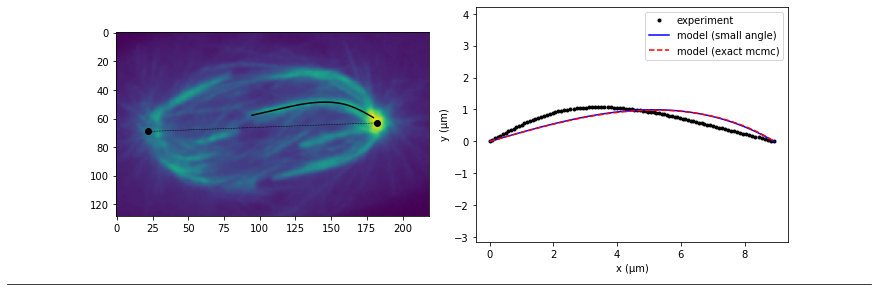

Fy_Mk_only
20180810_cell006 2
pole_right 16.811808350085364
P-K distance (L) =  4.95 um
Initial angle =  6.79 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 398.40it/s]


Exact method error (mcmc): 0.0232
Small-angle error: 0.0228


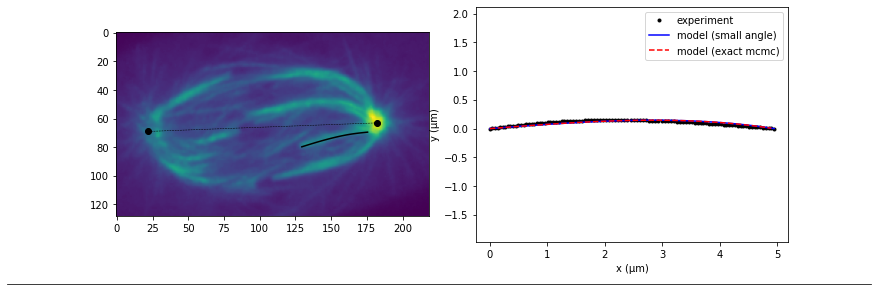

Fy_Mk_only
20180810_cell006 3
pole_right 16.811808350085364
P-K distance (L) =  8.32 um
Initial angle =  32.25 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 398.21it/s]


Exact method error (mcmc): 0.2353
Small-angle error: 0.2300


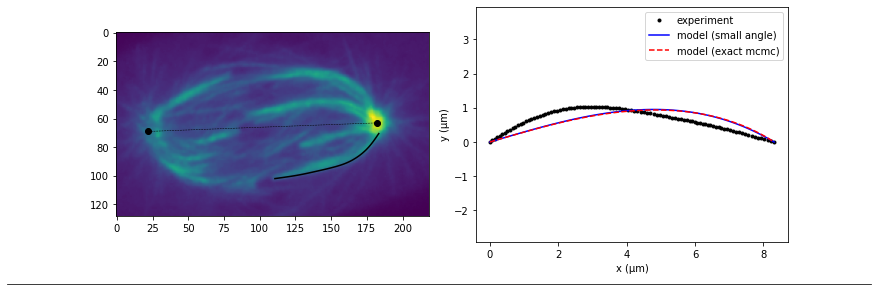

Fy_Mk_only
20210526_cell001 0
pole_left 20.895263817430017
P-K distance (L) =  7.11 um
Initial angle =  11.91 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 401.90it/s]


Exact method error (mcmc): 0.0566
Small-angle error: 0.0556


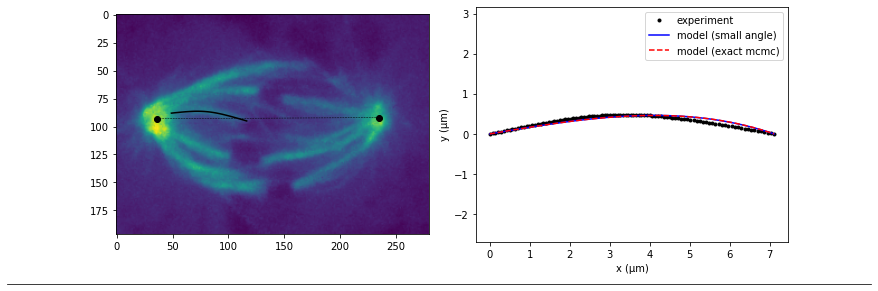

Fy_Mk_only
20210526_cell001 1
pole_right 20.895263817430017
P-K distance (L) =  10.57 um
Initial angle =  24.21 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 398.70it/s]


Exact method error (mcmc): 0.1924
Small-angle error: 0.1908


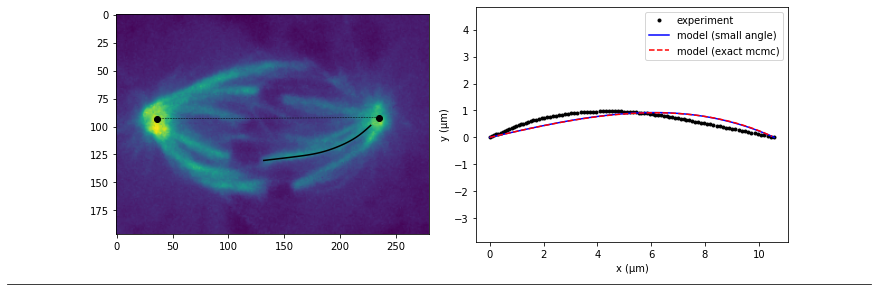

Fy_Mk_only
20210526_cell001 2
pole_right 20.895263817430017
P-K distance (L) =  8.96 um
Initial angle =  16.00 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 397.48it/s]


Exact method error (mcmc): 0.1220
Small-angle error: 0.1212


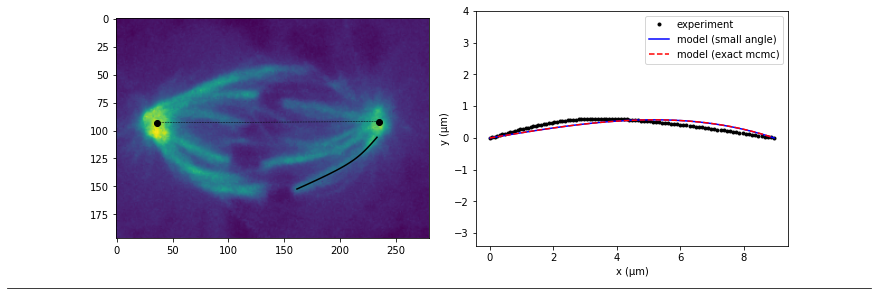

Fy_Mk_only
20210526_cell001 3
pole_left 20.895263817430017
P-K distance (L) =  13.48 um
Initial angle =  15.17 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 401.59it/s]


Exact method error (mcmc): 0.0807
Small-angle error: 0.0734


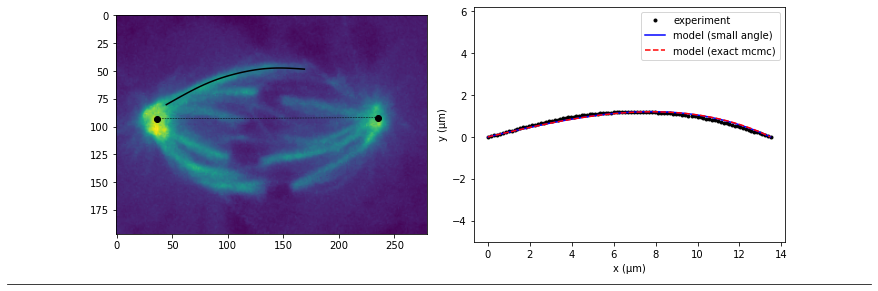

Fy_Mk_only
20210526_cell001 4
pole_right 20.895263817430017
P-K distance (L) =  7.30 um
Initial angle =  4.63 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 398.61it/s]


Exact method error (mcmc): 0.0207
Small-angle error: 0.0209


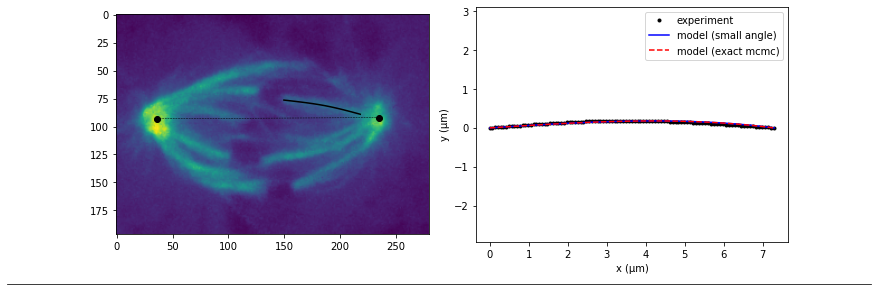

Fy_Mk_only
20210526_cell004 0
pole_left 28.035
P-K distance (L) =  10.42 um
Initial angle =  12.33 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 402.23it/s]


Exact method error (mcmc): 0.1035
Small-angle error: 0.1014


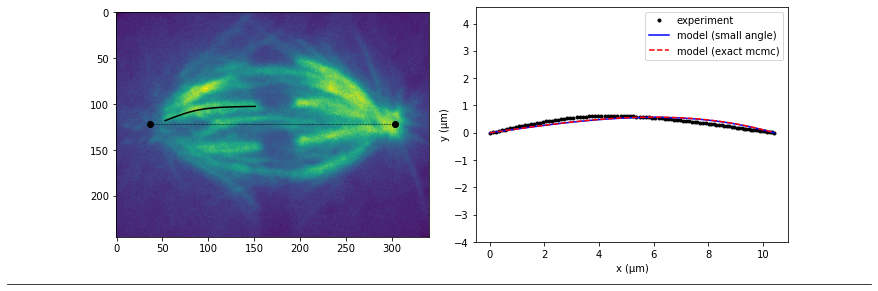

Fy_Mk_only
20210526_cell004 1
pole_left 28.035
P-K distance (L) =  10.60 um
Initial angle =  16.54 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 400.79it/s]


Exact method error (mcmc): 0.1412
Small-angle error: 0.1391


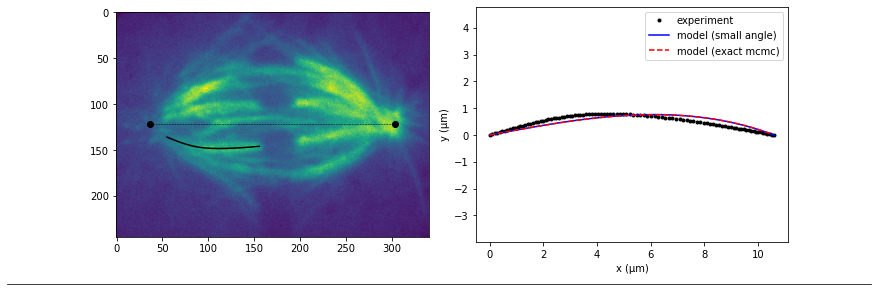

Fy_Mk_only
20210526_cell004 2
pole_right 28.035
P-K distance (L) =  10.32 um
Initial angle =  21.96 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 399.11it/s]


Exact method error (mcmc): 0.1969
Small-angle error: 0.1924


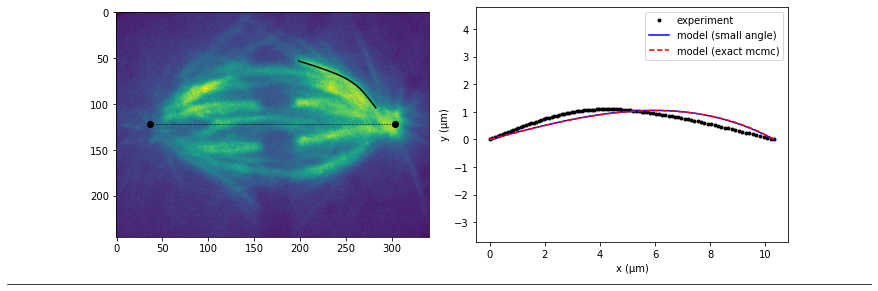

Fy_Mk_only
20210526_cell004 3
pole_right 28.035
P-K distance (L) =  7.48 um
Initial angle =  11.65 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 400.41it/s]


Exact method error (mcmc): 0.0628
Small-angle error: 0.0626


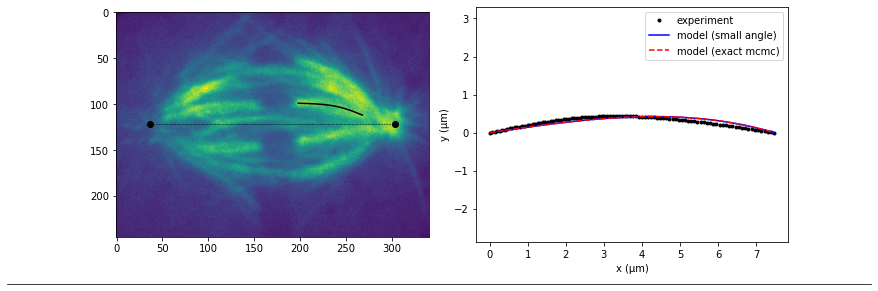

Fy_Mk_only
20210526_cell004 4
pole_right 28.035
P-K distance (L) =  8.60 um
Initial angle =  1.56 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 399.50it/s]


Exact method error (mcmc): 0.0071
Small-angle error: 0.0077


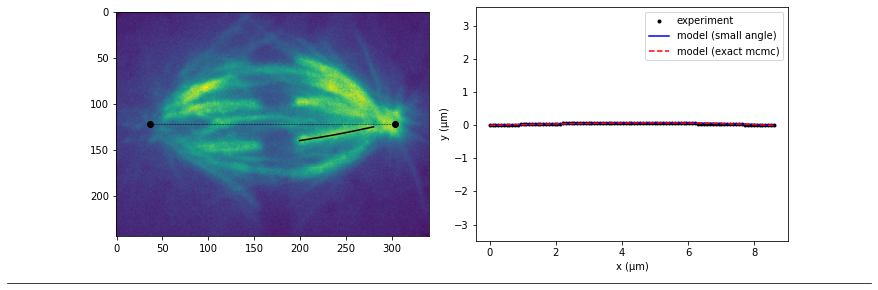

Fy_Mk_only
20210526_cell004 5
pole_right 28.035
P-K distance (L) =  10.24 um
Initial angle =  22.64 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 400.00it/s]


Exact method error (mcmc): 0.1587
Small-angle error: 0.1537


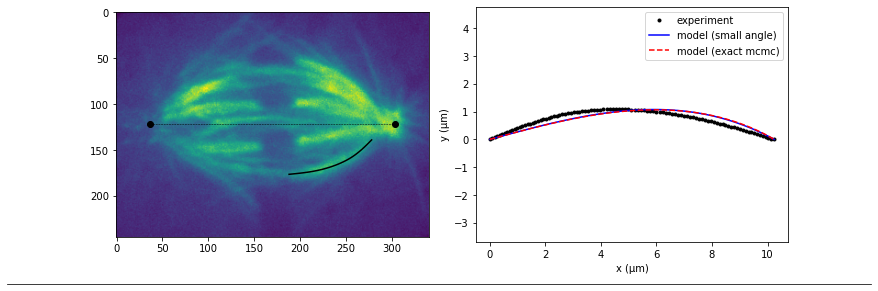

Fy_Mk_only
20210526_cell006 0
pole_left 23.998874973631576
P-K distance (L) =  8.55 um
Initial angle =  14.35 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 396.95it/s]


Exact method error (mcmc): 0.0841
Small-angle error: 0.0827


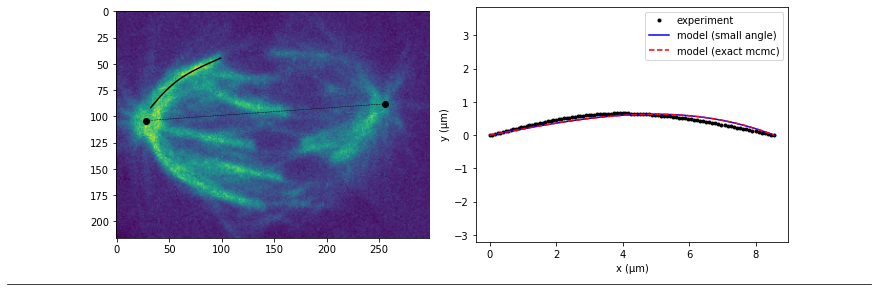

Fy_Mk_only
20210526_cell006 1
pole_left 23.998874973631576
P-K distance (L) =  13.26 um
Initial angle =  30.14 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 398.73it/s]


Exact method error (mcmc): 0.3623
Small-angle error: 0.3482


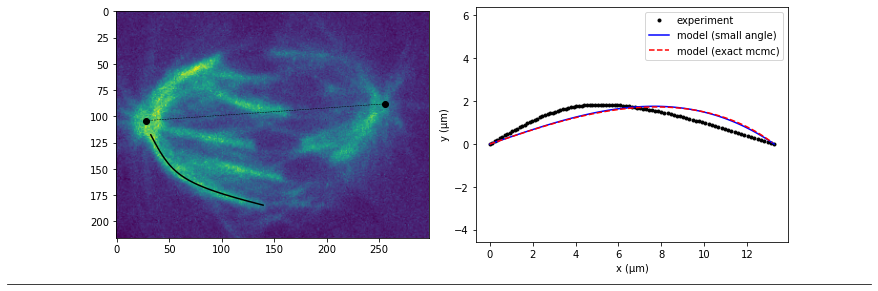

Fy_Mk_only
20210526_cell006 2
pole_left 23.998874973631576
P-K distance (L) =  9.00 um
Initial angle =  2.39 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 399.18it/s]


Exact method error (mcmc): 0.0136
Small-angle error: 0.0139


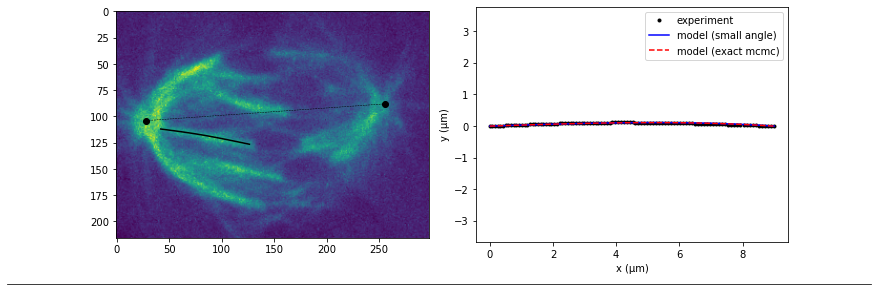

Fy_Mk_only
20210526_cell007 0
pole_left 26.275397713450506
P-K distance (L) =  8.61 um
Initial angle =  12.54 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 400.21it/s]


Exact method error (mcmc): 0.0848
Small-angle error: 0.0842


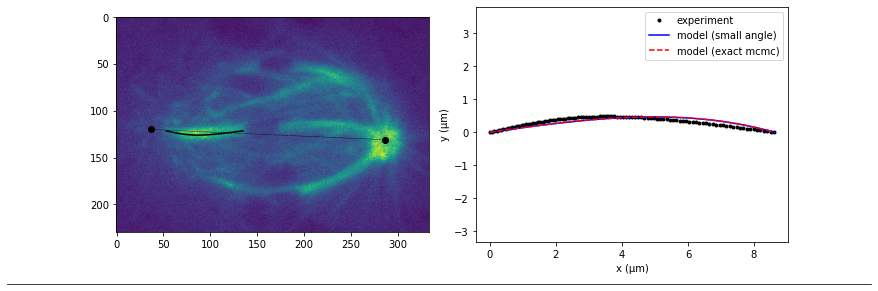

Fy_Mk_only
20210526_cell007 1
pole_right 26.275397713450506
P-K distance (L) =  10.99 um
Initial angle =  17.37 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 400.28it/s]


Exact method error (mcmc): 0.1431
Small-angle error: 0.1422


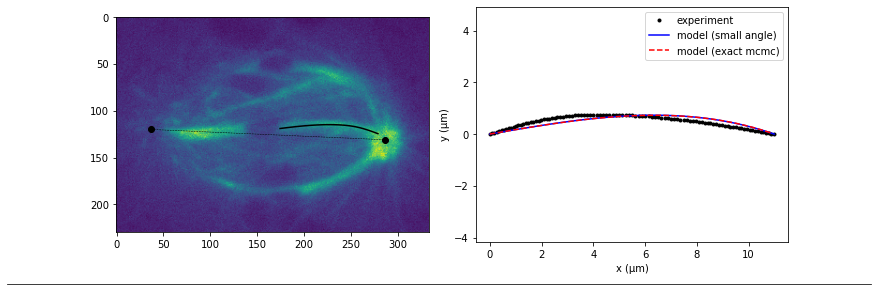

Fy_Mk_only
20210526_cell007 2
pole_right 26.275397713450506
P-K distance (L) =  8.85 um
Initial angle =  17.35 degrees


100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 402.25it/s]


Exact method error (mcmc): 0.0975
Small-angle error: 0.0948


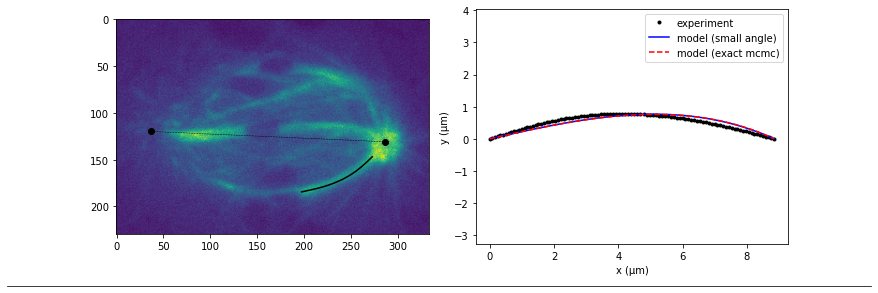

Fy_Mk_only
20210526_cell007 3
pole_right 26.275397713450506
P-K distance (L) =  11.33 um
Initial angle =  41.81 degrees


100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 398.23it/s]


Exact method error (mcmc): 0.4140
Small-angle error: 0.3760


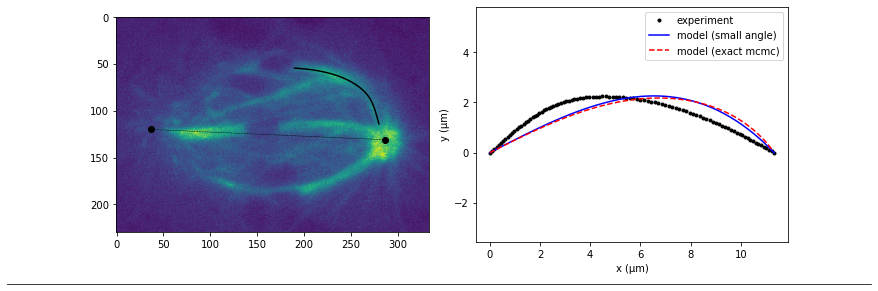

Fx_Fy_Mk
20171215_cell004 0
pole_left 14.979744078254473
P-K distance (L) =  6.39 um
Initial angle =  10.26 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 390.54it/s]


Exact method error (mcmc): 0.0259
Small-angle error: 0.0082


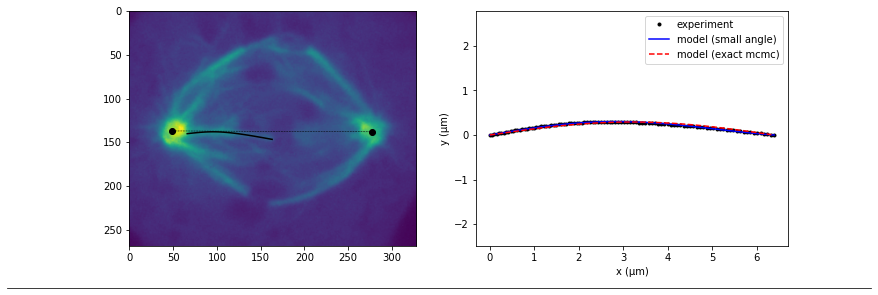

Fx_Fy_Mk
20171215_cell004 1
pole_right 14.979744078254473
P-K distance (L) =  6.69 um
Initial angle =  4.86 degrees


100%|████████████████████████████████████| 10000/10000 [00:28<00:00, 355.33it/s]


Exact method error (mcmc): 0.0017
Small-angle error: 0.0044


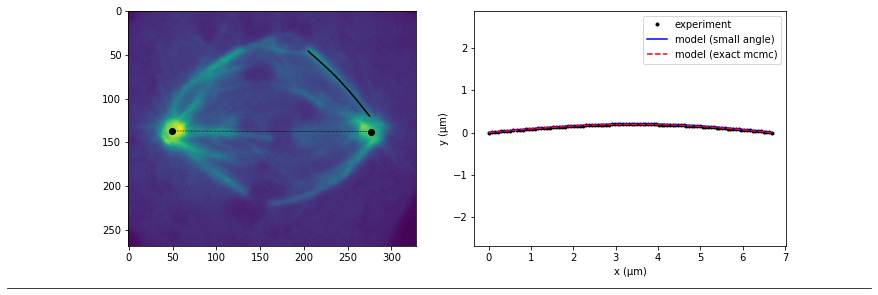

Fx_Fy_Mk
20171215_cell004 2
pole_right 14.979744078254473
P-K distance (L) =  8.38 um
Initial angle =  22.45 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 389.18it/s]


Exact method error (mcmc): 0.0368
Small-angle error: 0.0372


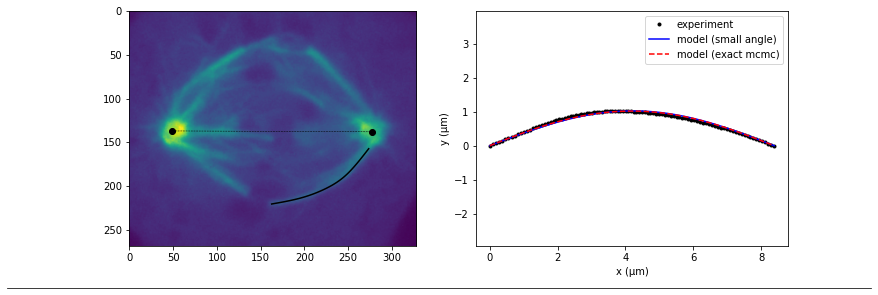

Fx_Fy_Mk
20171215_cell004 3
pole_right 14.979744078254473
P-K distance (L) =  8.35 um
Initial angle =  28.00 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 400.72it/s]


Exact method error (mcmc): 0.0494
Small-angle error: 0.0348


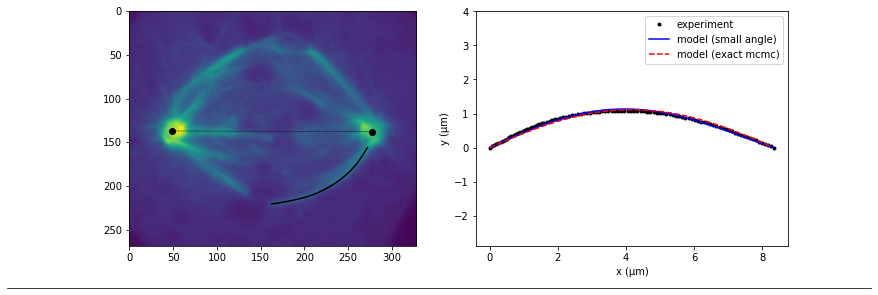

Fx_Fy_Mk
20171215_cell004a 0
pole_left 14.3883
P-K distance (L) =  8.23 um
Initial angle =  21.61 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 390.56it/s]


Exact method error (mcmc): 0.0441
Small-angle error: 0.0249


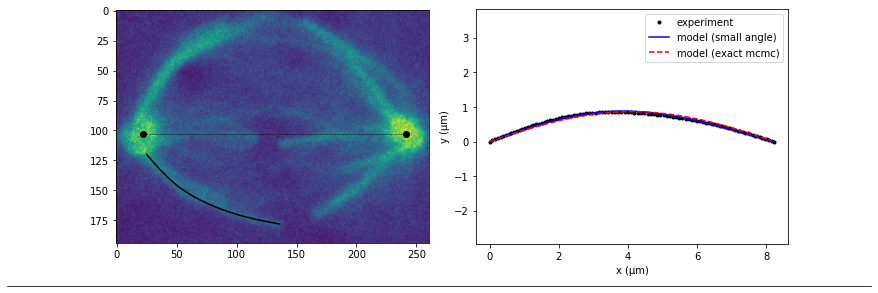

Fx_Fy_Mk
20171215_cell004a 1
pole_right 14.3883
P-K distance (L) =  5.78 um
Initial angle =  5.82 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 391.30it/s]


Exact method error (mcmc): 0.0082
Small-angle error: 0.0022


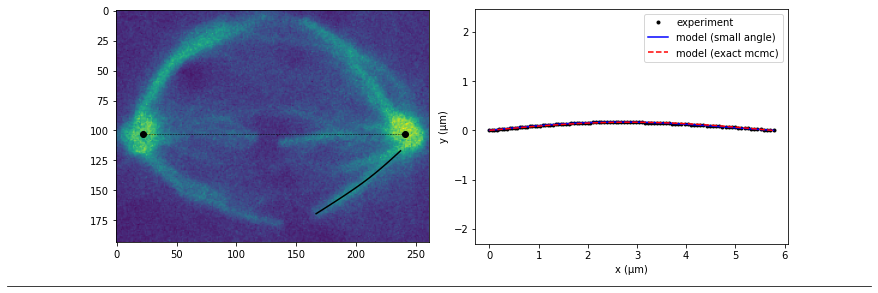

Fx_Fy_Mk
20171215_cell005 0
pole_left 13.807007798940361
P-K distance (L) =  6.22 um
Initial angle =  25.90 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 391.10it/s]


Exact method error (mcmc): 0.0472
Small-angle error: 0.0153


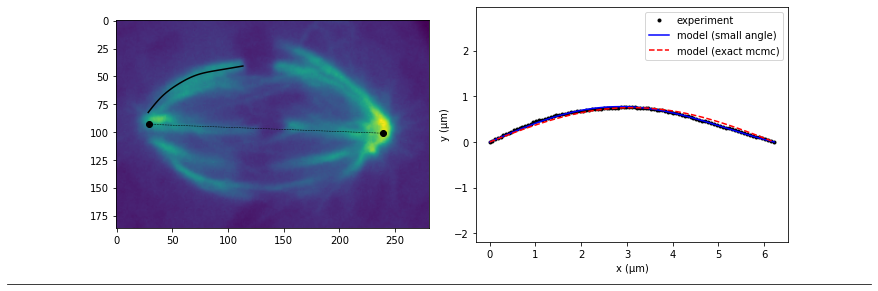

Fx_Fy_Mk
20171215_cell005 1
pole_right 13.807007798940361
P-K distance (L) =  7.42 um
Initial angle =  17.45 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 387.25it/s]


Exact method error (mcmc): 0.0206
Small-angle error: 0.0193


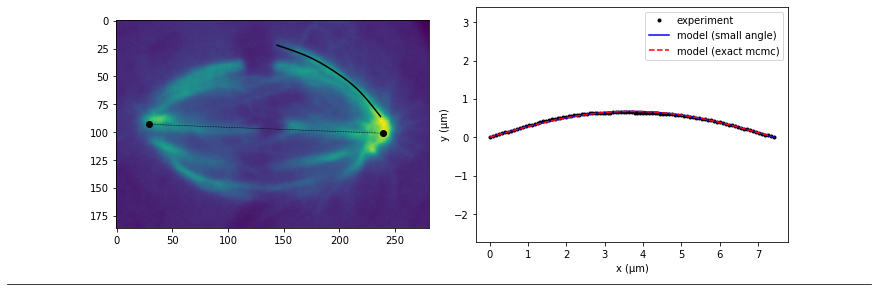

Fx_Fy_Mk
20171215_cell005 2
pole_right 13.807007798940361
P-K distance (L) =  5.44 um
Initial angle =  15.00 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:21<00:00, 473.35it/s]


Exact method error (mcmc): 0.0300
Small-angle error: 0.0088


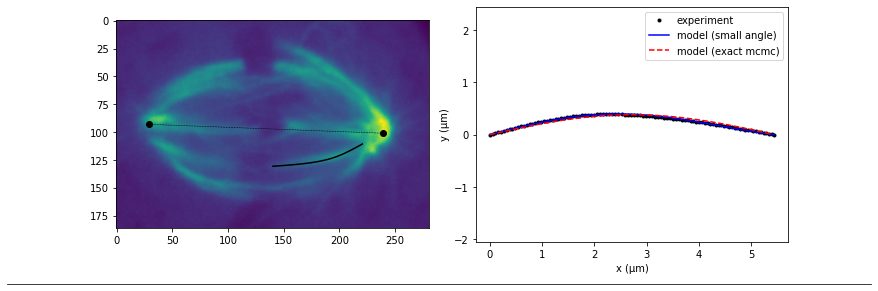

Fx_Fy_Mk
20171219_cell003 0
pole_left 16.766377403899746
P-K distance (L) =  8.12 um
Initial angle =  9.10 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 383.92it/s]


Exact method error (mcmc): 0.0121
Small-angle error: 0.0092


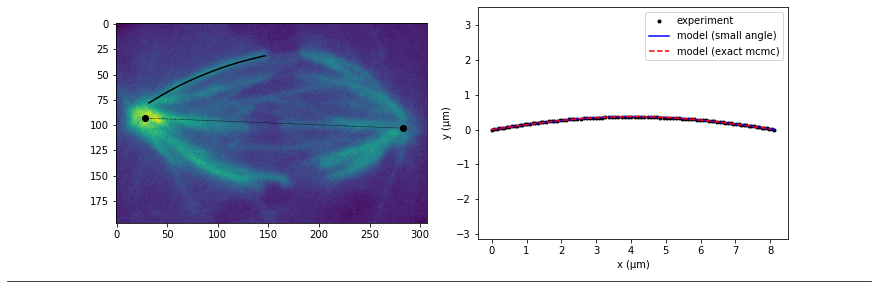

Fx_Fy_Mk
20171219_cell003 1
pole_left 16.766377403899746
P-K distance (L) =  5.50 um
Initial angle =  8.75 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 392.92it/s]


Exact method error (mcmc): 0.0104
Small-angle error: 0.0023


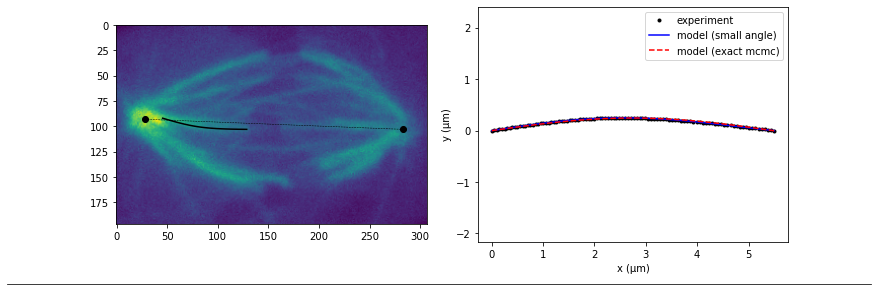

Fx_Fy_Mk
20180611_cell002 0
pole_left 14.283473842171588
P-K distance (L) =  6.64 um
Initial angle =  22.71 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 390.56it/s]


Exact method error (mcmc): 0.0574
Small-angle error: 0.0205


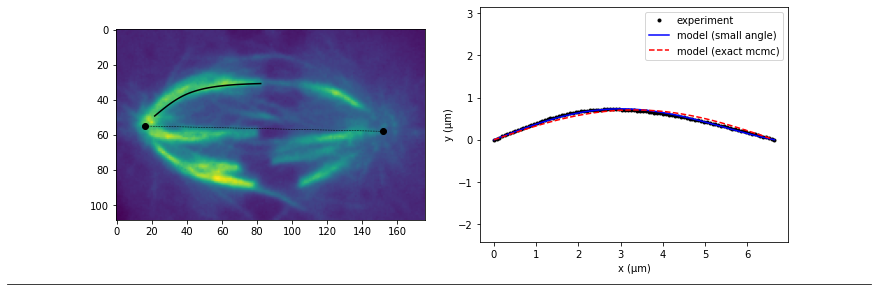

Fx_Fy_Mk
20180611_cell002 1
pole_left 14.283473842171588
P-K distance (L) =  6.59 um
Initial angle =  21.91 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 388.19it/s]


Exact method error (mcmc): 0.0274
Small-angle error: 0.0033


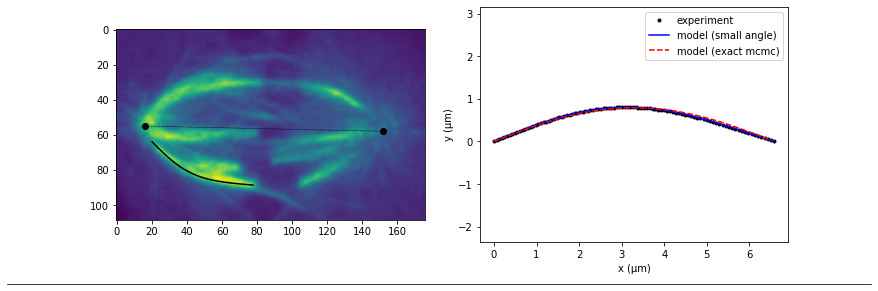

Fx_Fy_Mk
20180611_cell002 2
pole_left 14.283473842171588
P-K distance (L) =  6.59 um
Initial angle =  21.91 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 389.02it/s]


Exact method error (mcmc): 0.0274
Small-angle error: 0.0033


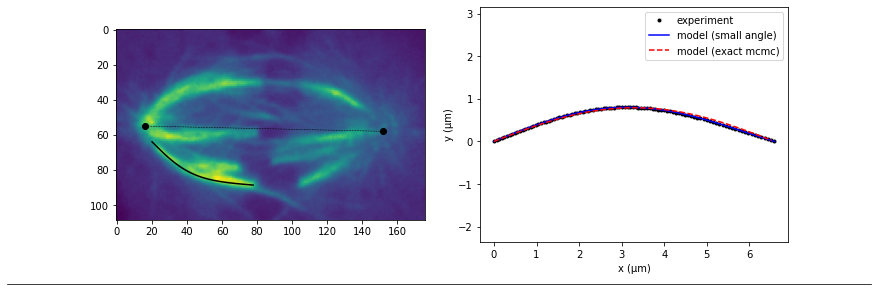

Fx_Fy_Mk
20180612_cell001 0
pole_left 14.806489286795841
P-K distance (L) =  7.85 um
Initial angle =  21.07 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 387.02it/s]


Exact method error (mcmc): 0.0349
Small-angle error: 0.0098


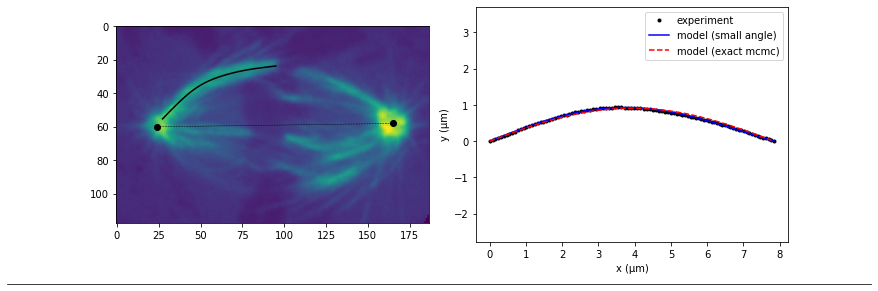

Fx_Fy_Mk
20180612_cell001 1
pole_left 14.806489286795841
P-K distance (L) =  4.69 um
Initial angle =  11.81 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 390.29it/s]


Exact method error (mcmc): 0.0369
Small-angle error: 0.0162


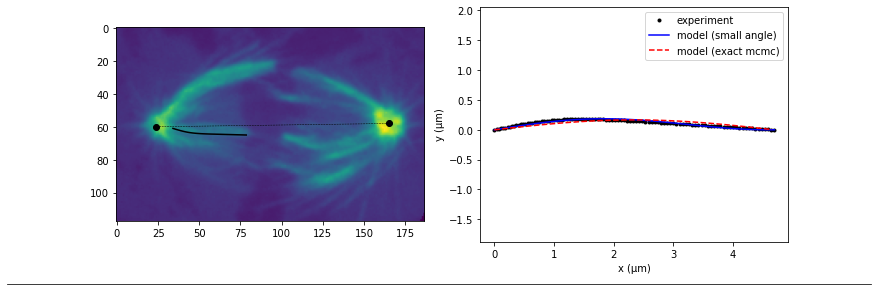

Fx_Fy_Mk
20180612_cell003 0
pole_left 13.021693438259096
P-K distance (L) =  5.70 um
Initial angle =  23.85 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 390.97it/s]


Exact method error (mcmc): 0.0417
Small-angle error: 0.0312


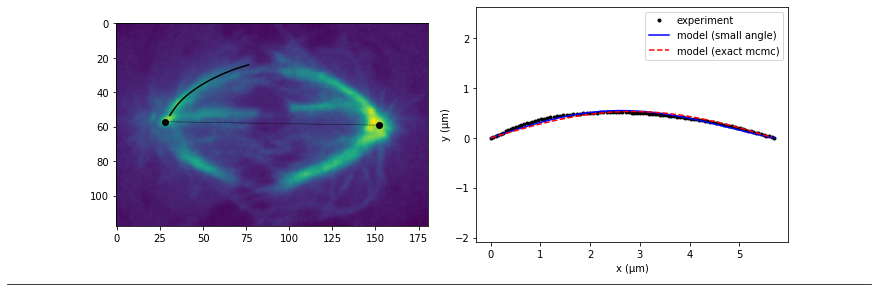

Fx_Fy_Mk
20180612_cell003 1
pole_left 13.021693438259096
P-K distance (L) =  4.84 um
Initial angle =  15.69 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 396.29it/s]


Exact method error (mcmc): 0.0544
Small-angle error: 0.0553


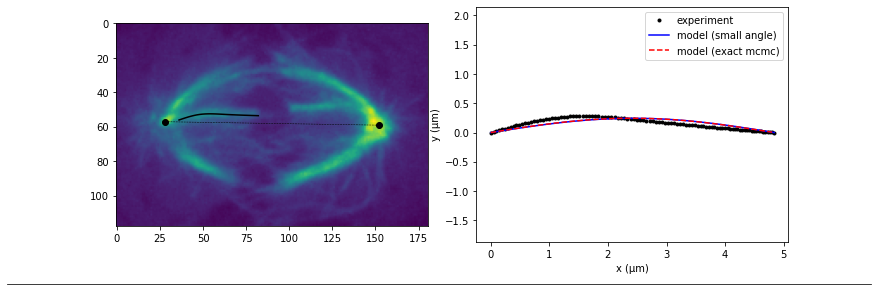

Fx_Fy_Mk
20180612_cell003 2
pole_right 13.021693438259096
P-K distance (L) =  5.89 um
Initial angle =  23.08 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 395.90it/s]


Exact method error (mcmc): 0.0340
Small-angle error: 0.0194


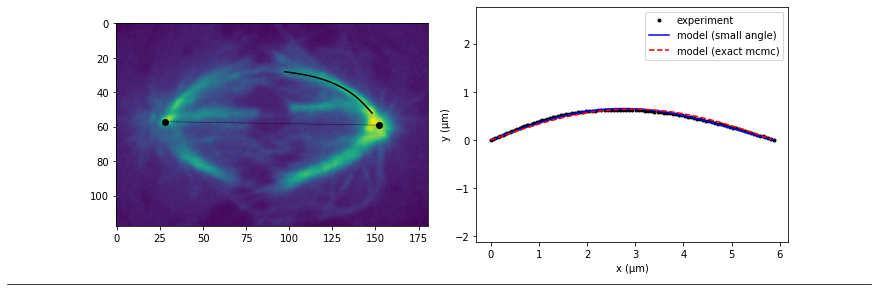

Fx_Fy_Mk
20180620_cell013 0
pole_left 14.625561527681594
P-K distance (L) =  5.89 um
Initial angle =  4.07 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 395.22it/s]


Exact method error (mcmc): 0.0099
Small-angle error: 0.0098


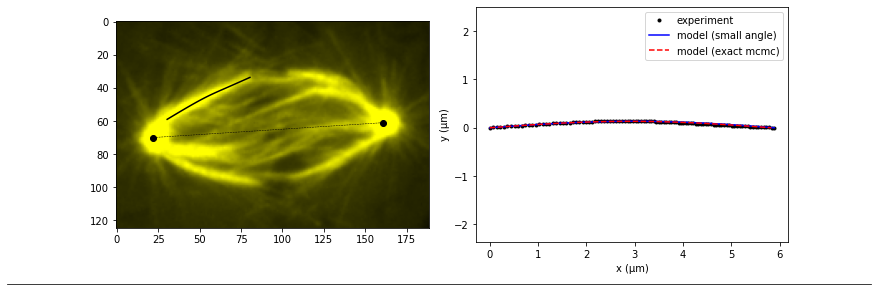

Fx_Fy_Mk
20180620_cell013 1
pole_left 14.625561527681594
P-K distance (L) =  6.28 um
Initial angle =  16.50 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 395.13it/s]


Exact method error (mcmc): 0.0390
Small-angle error: 0.0159


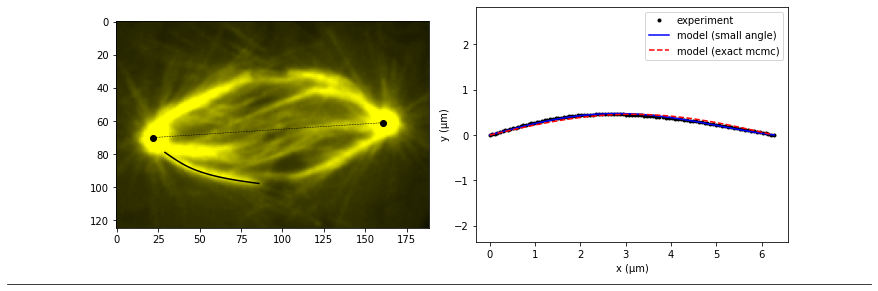

Fx_Fy_Mk
20180620_cell013 2
pole_right 14.625561527681594
P-K distance (L) =  6.07 um
Initial angle =  7.39 degrees


100%|████████████████████████████████████| 10000/10000 [00:27<00:00, 358.20it/s]


Exact method error (mcmc): 0.0024
Small-angle error: 0.0042


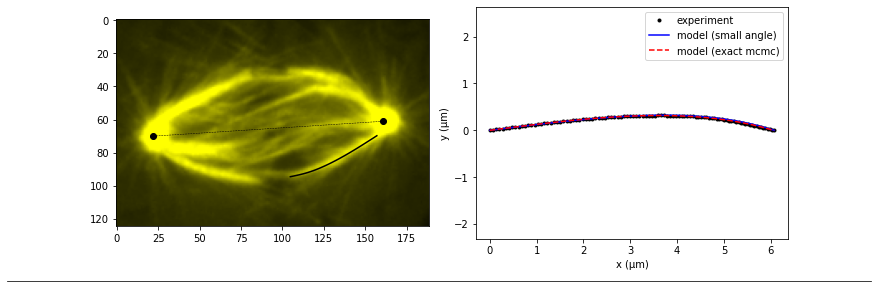

Fx_Fy_Mk
20180622_cell015 0
pole_left 16.388411301892564
P-K distance (L) =  7.51 um
Initial angle =  18.18 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 395.33it/s]


Exact method error (mcmc): 0.0729
Small-angle error: 0.0383


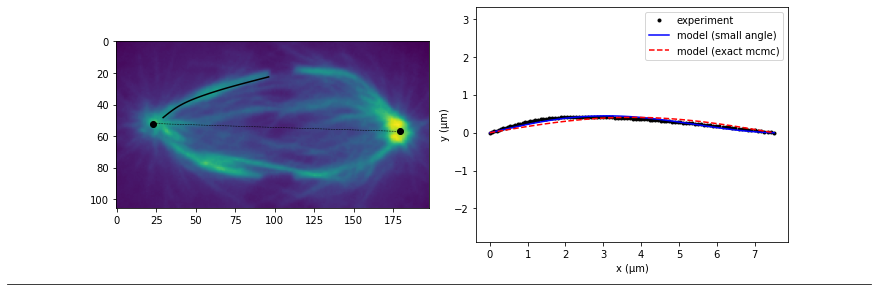

Fx_Fy_Mk
20180622_cell015 1
pole_left 16.388411301892564
P-K distance (L) =  7.19 um
Initial angle =  18.74 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 394.30it/s]


Exact method error (mcmc): 0.0380
Small-angle error: 0.0268


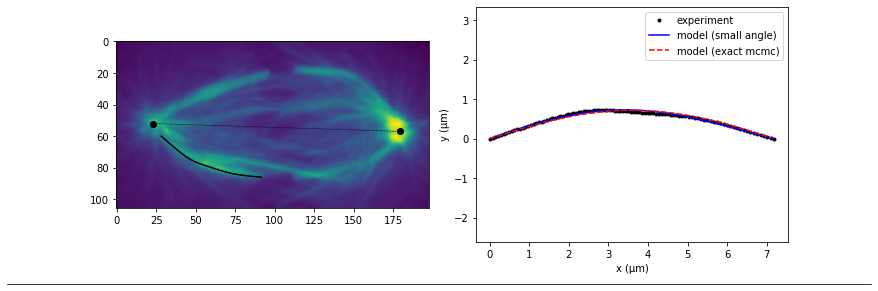

Fx_Fy_Mk
20180622_cell016 0
pole_left 15.225
P-K distance (L) =  6.11 um
Initial angle =  13.57 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:24<00:00, 401.60it/s]


Exact method error (mcmc): 0.0150
Small-angle error: 0.0052


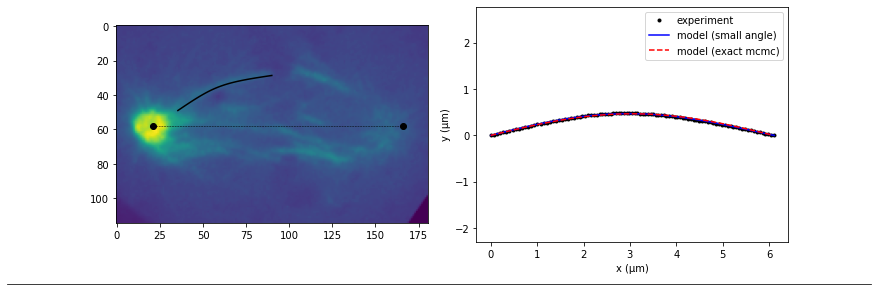

Fx_Fy_Mk
20180622_cell020 0
pole_left 12.401117893157858
P-K distance (L) =  6.69 um
Initial angle =  28.34 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 392.86it/s]


Exact method error (mcmc): 0.0628
Small-angle error: 0.0475


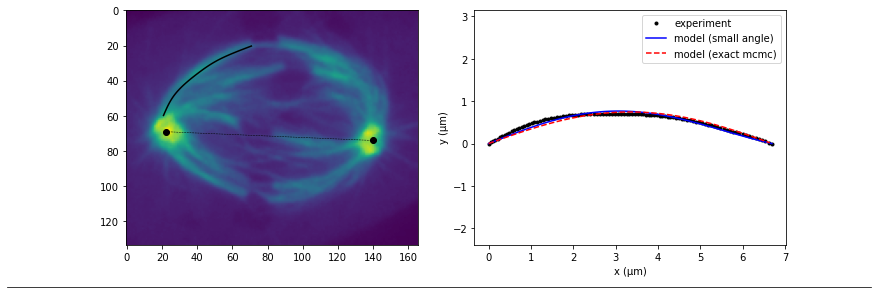

Fx_Fy_Mk
20180622_cell020 1
pole_right 12.401117893157858
P-K distance (L) =  6.03 um
Initial angle =  24.49 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 394.37it/s]


Exact method error (mcmc): 0.0078
Small-angle error: 0.0035


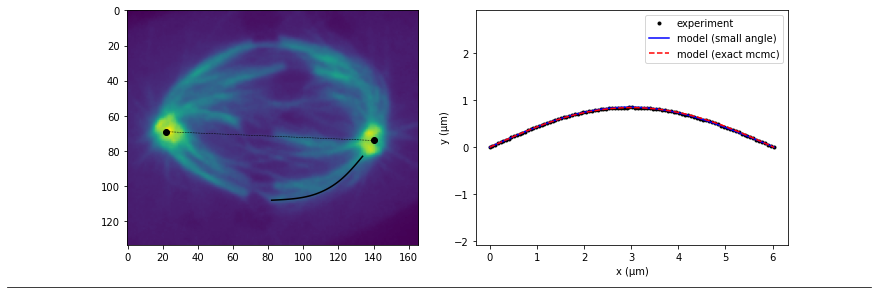

Fx_Fy_Mk
20180622_cell020 2
pole_left 12.401117893157858
P-K distance (L) =  5.00 um
Initial angle =  13.21 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 392.72it/s]


Exact method error (mcmc): 0.0247
Small-angle error: 0.0262


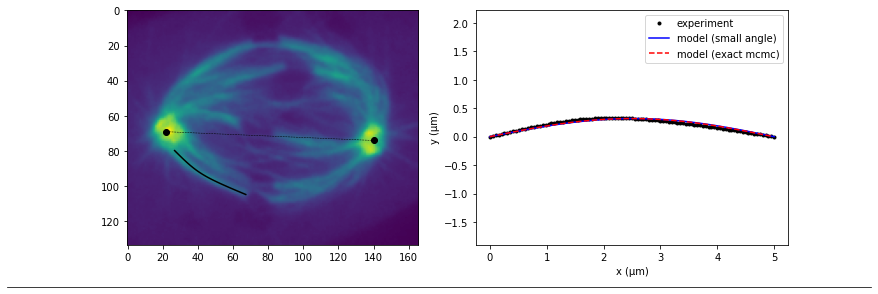

Fx_Fy_Mk
20180622_cell020 3
pole_right 12.401117893157858
P-K distance (L) =  5.47 um
Initial angle =  25.99 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 395.05it/s]


Exact method error (mcmc): 0.0324
Small-angle error: 0.0172


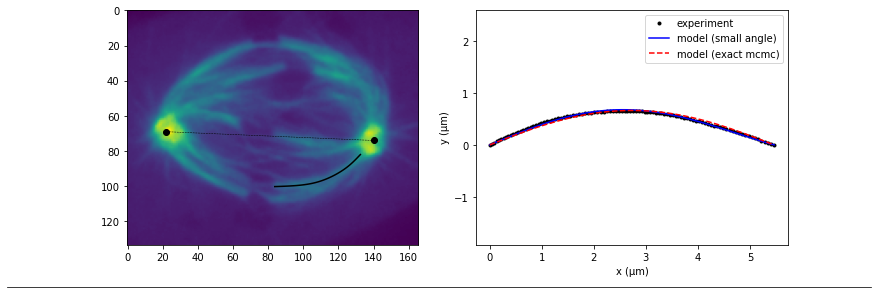

Fx_Fy_Mk
20180622_cell026 0
pole_left 14.598398884809251
P-K distance (L) =  5.74 um
Initial angle =  24.35 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 394.92it/s]


Exact method error (mcmc): 0.0564
Small-angle error: 0.0400


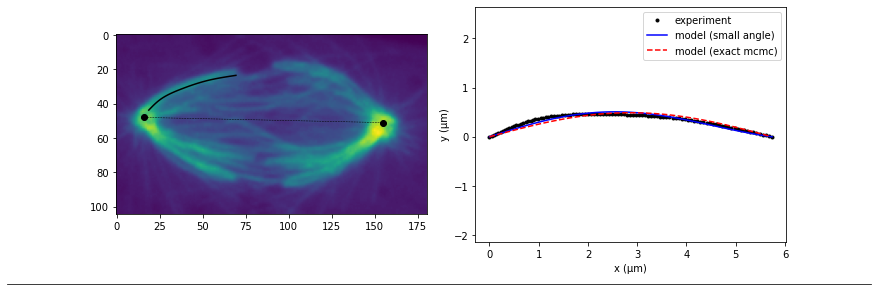

Fx_Fy_Mk
20180622_cell026 1
pole_left 14.598398884809251
P-K distance (L) =  5.88 um
Initial angle =  13.64 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 391.29it/s]


Exact method error (mcmc): 0.0243
Small-angle error: 0.0181


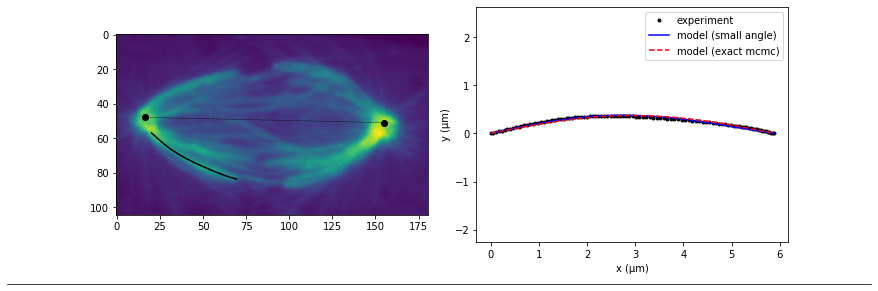

Fx_Fy_Mk
20180622_cell026 2
pole_right 14.598398884809251
P-K distance (L) =  6.41 um
Initial angle =  33.09 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 389.36it/s]


Exact method error (mcmc): 0.0935
Small-angle error: 0.0437


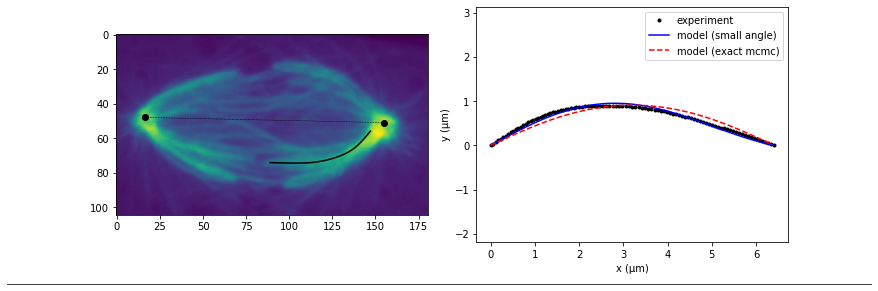

Fx_Fy_Mk
20180622_cell026 3
pole_right 14.598398884809251
P-K distance (L) =  6.13 um
Initial angle =  22.85 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:30<00:00, 330.03it/s]


Exact method error (mcmc): 0.0205
Small-angle error: 0.0272


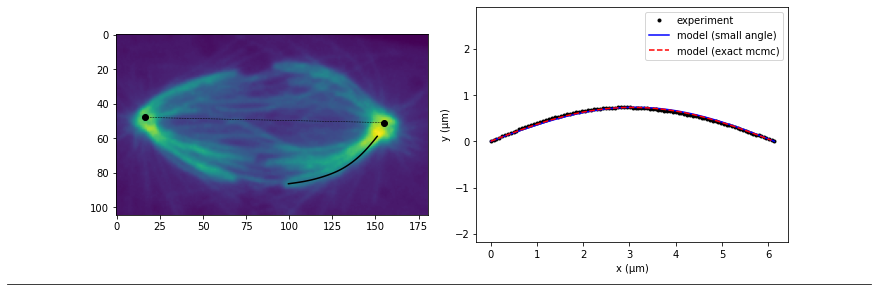

Fx_Fy_Mk
20180622_cell027 0
pole_left 14.181220857175873
P-K distance (L) =  4.89 um
Initial angle =  9.20 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 376.09it/s]


Exact method error (mcmc): 0.0255
Small-angle error: 0.0249


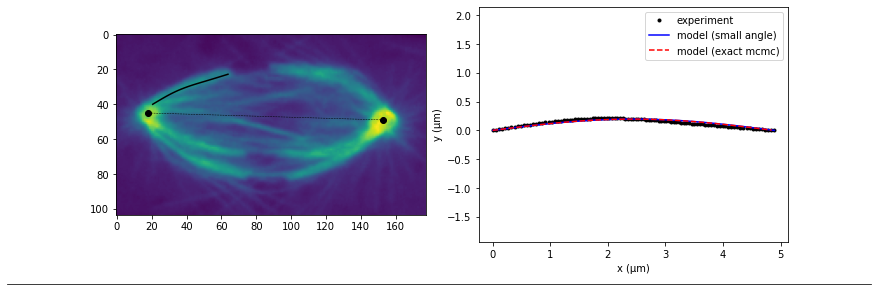

Fx_Fy_Mk
20180622_cell027 1
pole_left 14.181220857175873
P-K distance (L) =  5.44 um
Initial angle =  15.19 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:27<00:00, 364.58it/s]


Exact method error (mcmc): 0.0177
Small-angle error: 0.0135


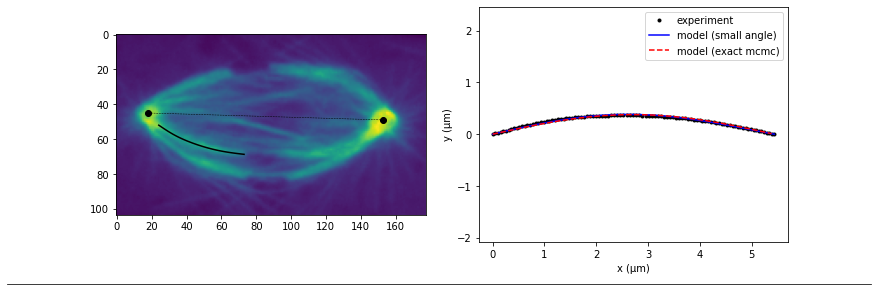

Fx_Fy_Mk
20180622_cell027 2
pole_left 14.181220857175873
P-K distance (L) =  6.23 um
Initial angle =  20.25 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:29<00:00, 337.20it/s]


Exact method error (mcmc): 0.0240
Small-angle error: 0.0171


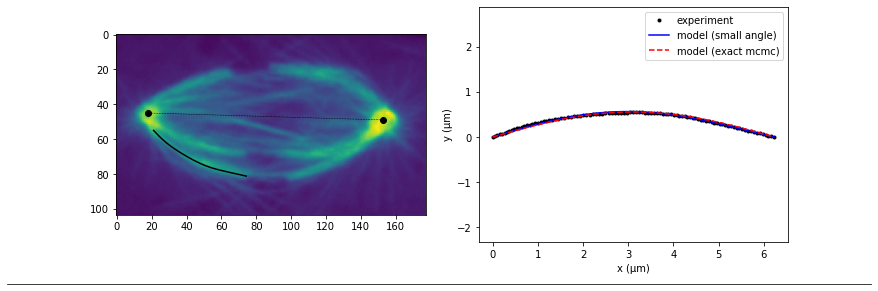

Fx_Fy_Mk
20180622_cell027 3
pole_right 14.181220857175873
P-K distance (L) =  6.82 um
Initial angle =  21.28 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:27<00:00, 368.56it/s]


Exact method error (mcmc): 0.0495
Small-angle error: 0.0245


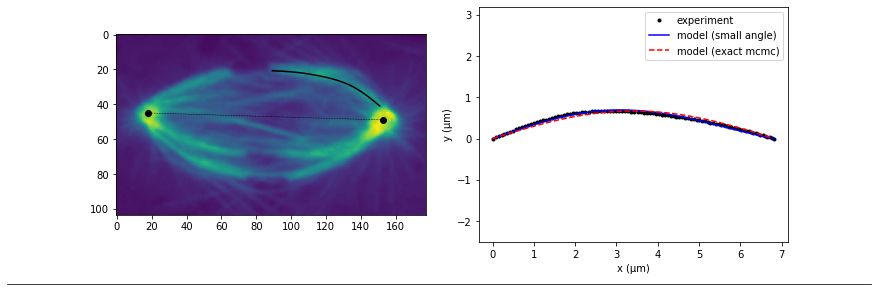

Fx_Fy_Mk
20180622_cell027 4
pole_right 14.181220857175873
P-K distance (L) =  5.78 um
Initial angle =  15.63 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:28<00:00, 345.19it/s]


Exact method error (mcmc): 0.0060
Small-angle error: 0.0067


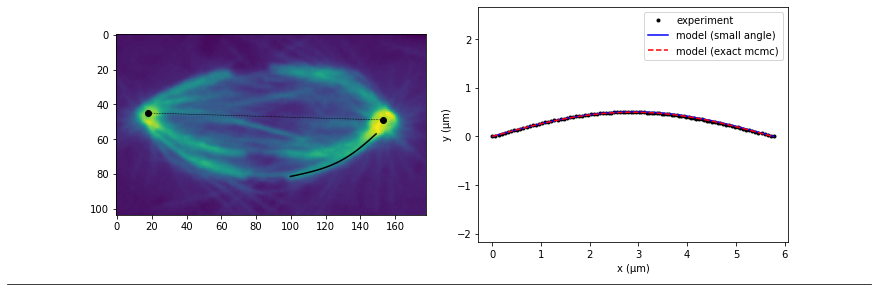

Fx_Fy_Mk
20180622_cell028 0
pole_left 16.907934527907305
P-K distance (L) =  7.63 um
Initial angle =  15.89 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:30<00:00, 330.73it/s]


Exact method error (mcmc): 0.0260
Small-angle error: 0.0085


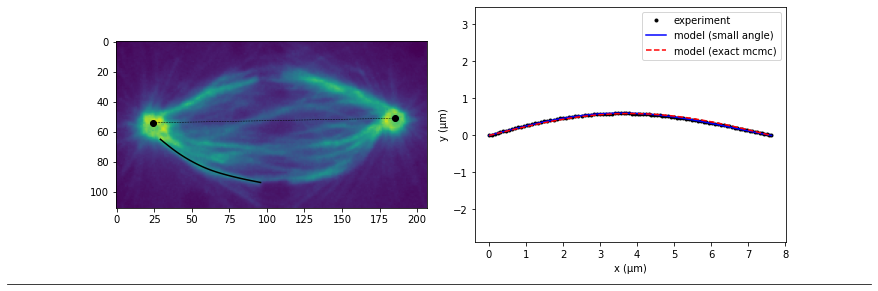

Fx_Fy_Mk
20180622_cell028 1
pole_right 16.907934527907305
P-K distance (L) =  5.90 um
Initial angle =  26.89 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:30<00:00, 323.52it/s]


Exact method error (mcmc): 0.0712
Small-angle error: 0.0252


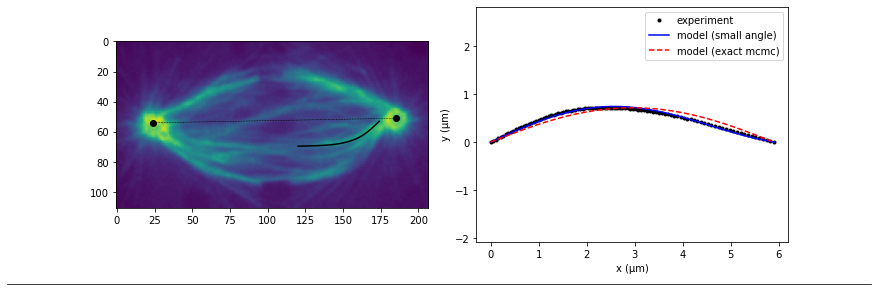

Fx_Fy_Mk
20180622_cell030 0
pole_left 14.071567076910801
P-K distance (L) =  5.60 um
Initial angle =  31.47 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:28<00:00, 355.50it/s]


Exact method error (mcmc): 0.0530
Small-angle error: 0.0549


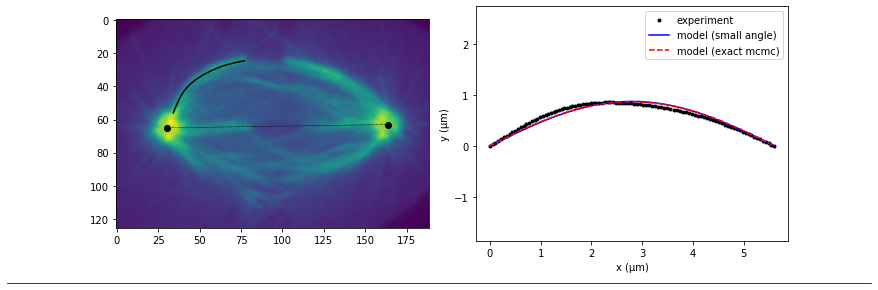

Fx_Fy_Mk
20180622_cell030 1
pole_right 14.071567076910801
P-K distance (L) =  6.70 um
Initial angle =  23.23 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 388.92it/s]


Exact method error (mcmc): 0.0484
Small-angle error: 0.0289


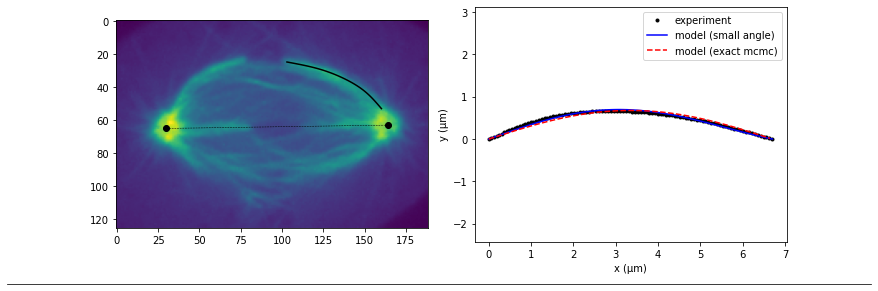

Fx_Fy_Mk
20180626_cell001 0
pole_left 14.286175135423758
P-K distance (L) =  6.04 um
Initial angle =  15.38 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 374.73it/s]


Exact method error (mcmc): 0.0445
Small-angle error: 0.0134


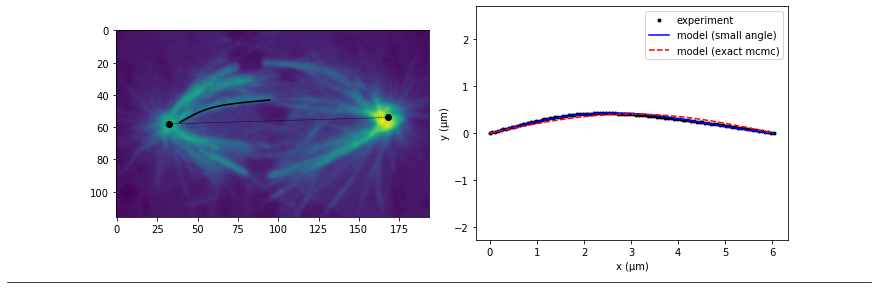

Fx_Fy_Mk
20180626_cell001 1
pole_left 14.286175135423758
P-K distance (L) =  5.18 um
Initial angle =  18.14 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 384.77it/s]


Exact method error (mcmc): 0.0176
Small-angle error: 0.1364


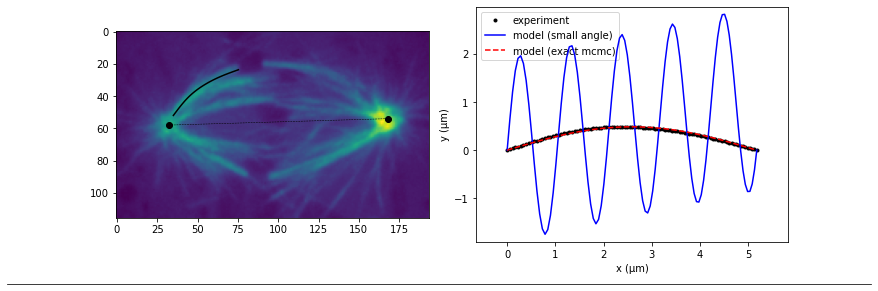

Fx_Fy_Mk
20180626_cell001 2
pole_right 14.286175135423758
P-K distance (L) =  6.93 um
Initial angle =  31.42 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 378.82it/s]


Exact method error (mcmc): 0.0954
Small-angle error: 0.0458


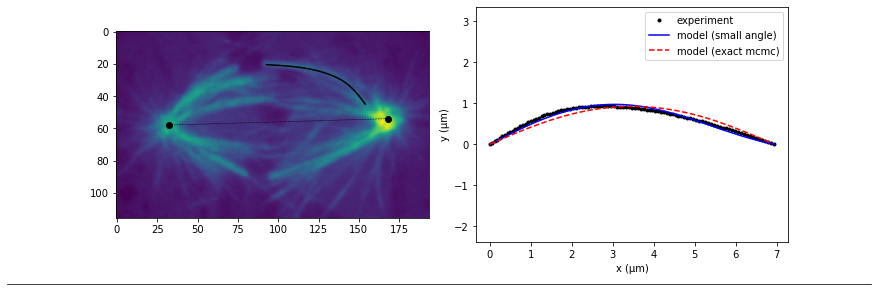

Fx_Fy_Mk
20180628_cell002 0
pole_left 13.236664987828316
P-K distance (L) =  7.16 um
Initial angle =  15.71 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 380.19it/s]


Exact method error (mcmc): 0.0147
Small-angle error: 0.0058


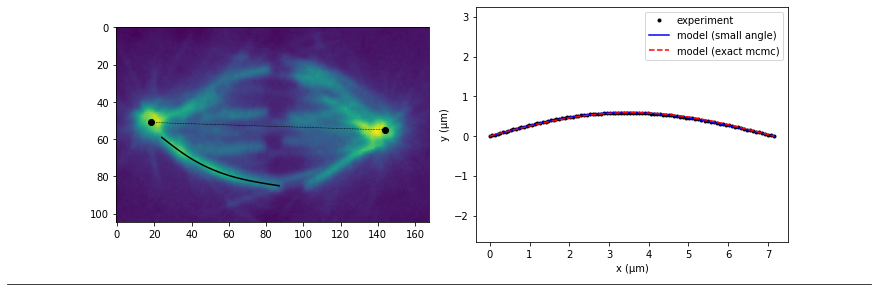

Fx_Fy_Mk
20180628_cell006 0
pole_left 16.826557134482385
P-K distance (L) =  6.16 um
Initial angle =  18.85 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 382.38it/s]


Exact method error (mcmc): 0.0543
Small-angle error: 0.0140


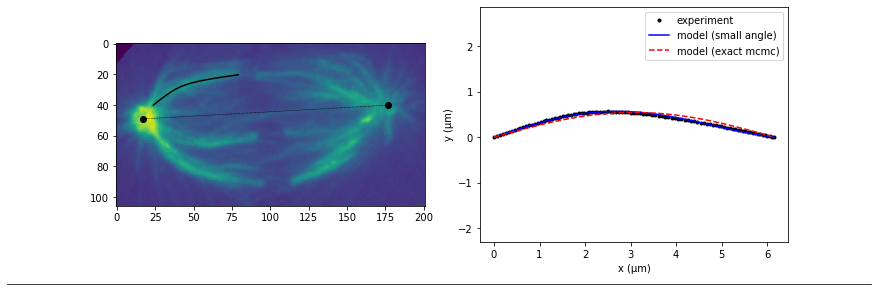

Fx_Fy_Mk
20180628_cell006 1
pole_left 16.826557134482385
P-K distance (L) =  6.62 um
Initial angle =  30.69 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 381.85it/s]


Exact method error (mcmc): 0.1049
Small-angle error: 0.0533


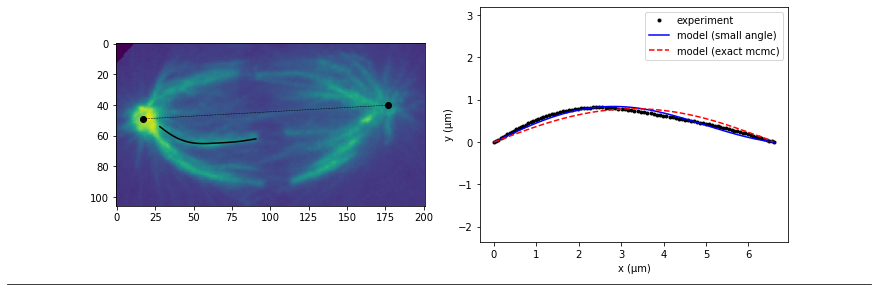

Fx_Fy_Mk
20180628_cell006 2
pole_left 16.826557134482385
P-K distance (L) =  8.07 um
Initial angle =  33.12 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 388.20it/s]


Exact method error (mcmc): 0.1222
Small-angle error: 0.0607


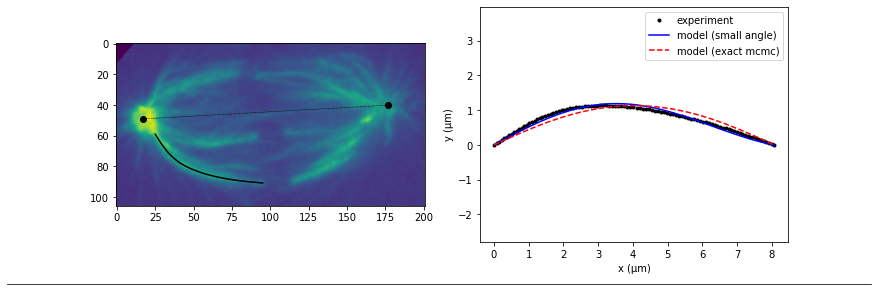

Fx_Fy_Mk
20180628_cell010 0
pole_left 12.8117211958425
P-K distance (L) =  5.65 um
Initial angle =  18.30 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 381.54it/s]


Exact method error (mcmc): 0.0206
Small-angle error: 0.0209


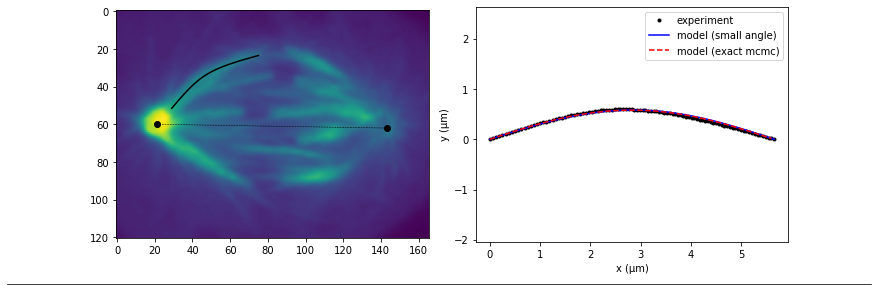

Fx_Fy_Mk
20180628_cell010 1
pole_left 12.8117211958425
P-K distance (L) =  3.77 um
Initial angle =  13.11 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:27<00:00, 370.07it/s]


Exact method error (mcmc): 0.0150
Small-angle error: 0.0040


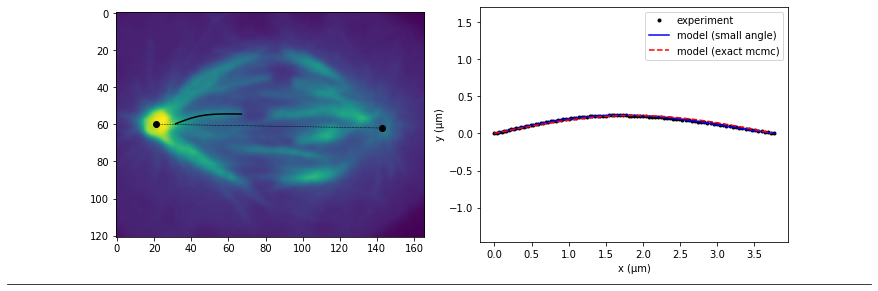

Fx_Fy_Mk
20180628_cell010 2
pole_left 12.8117211958425
P-K distance (L) =  5.36 um
Initial angle =  10.08 degrees


100%|████████████████████████████████████| 10000/10000 [00:29<00:00, 343.31it/s]


Exact method error (mcmc): 0.0080
Small-angle error: 0.0062


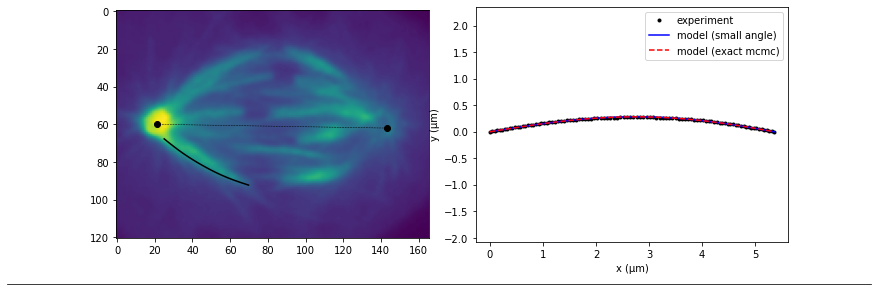

Fx_Fy_Mk
20180628_cell010 3
pole_right 12.8117211958425
P-K distance (L) =  5.25 um
Initial angle =  12.63 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 382.19it/s]


Exact method error (mcmc): 0.0338
Small-angle error: 0.0326


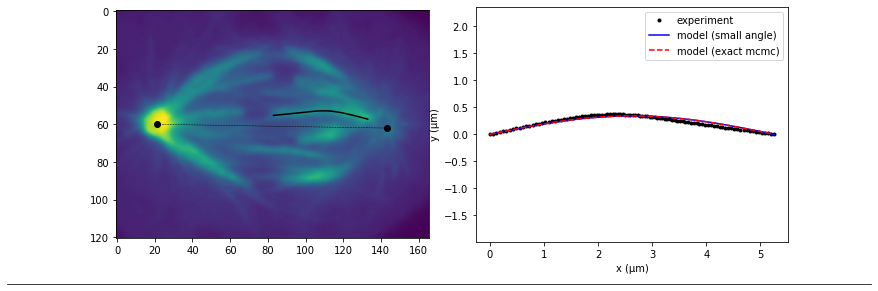

Fx_Fy_Mk
20180628_cell013 0
pole_left 15.015367128378845
P-K distance (L) =  7.91 um
Initial angle =  19.16 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 378.27it/s]


Exact method error (mcmc): 0.0488
Small-angle error: 0.0467


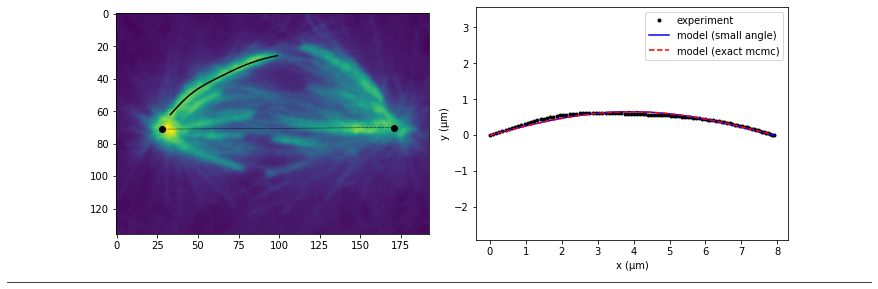

Fx_Fy_Mk
20180628_cell013 1
pole_left 15.015367128378845
P-K distance (L) =  3.82 um
Initial angle =  4.60 degrees


100%|████████████████████████████████████| 10000/10000 [00:28<00:00, 347.80it/s]


Exact method error (mcmc): 0.0053
Small-angle error: 0.0053


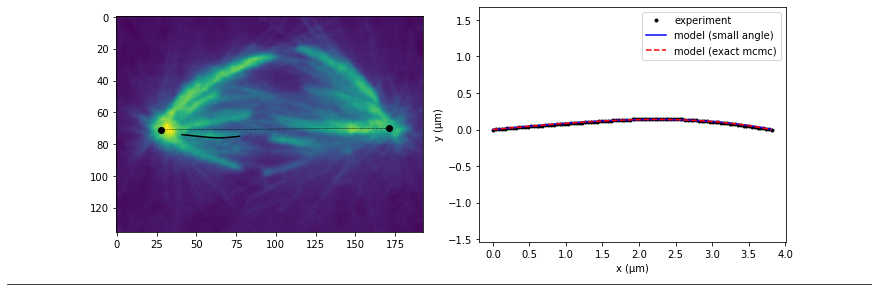

Fx_Fy_Mk
20180628_cell013 2
pole_left 15.015367128378845
P-K distance (L) =  4.54 um
Initial angle =  7.26 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 382.37it/s]


Exact method error (mcmc): 0.0119
Small-angle error: 0.0027


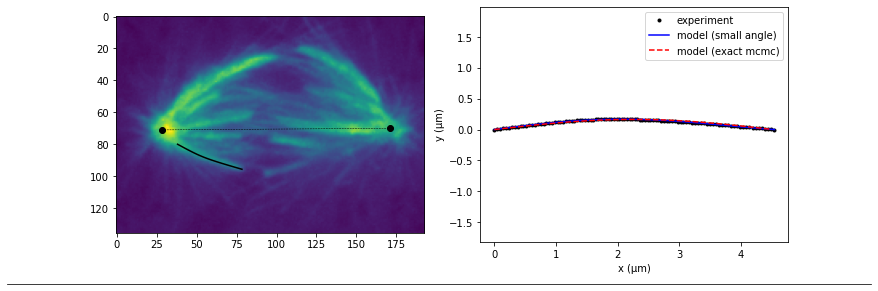

Fx_Fy_Mk
20180628_cell013 3
pole_right 15.015367128378845
P-K distance (L) =  6.59 um
Initial angle =  25.61 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 373.96it/s]


Exact method error (mcmc): 0.0688
Small-angle error: 0.0755


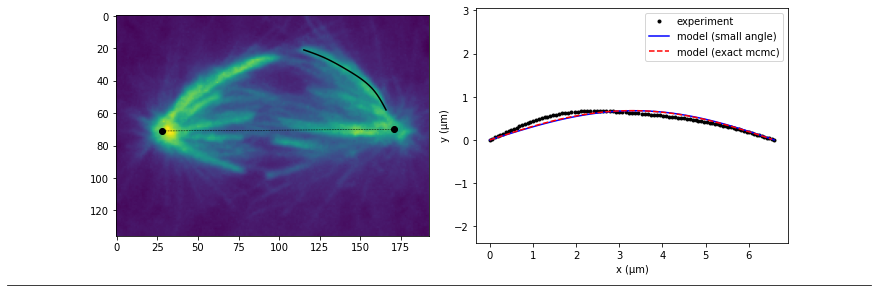

Fx_Fy_Mk
20180628_cell013 4
pole_right 15.015367128378845
P-K distance (L) =  6.37 um
Initial angle =  15.49 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:27<00:00, 369.65it/s]


Exact method error (mcmc): 0.0290
Small-angle error: 0.0175


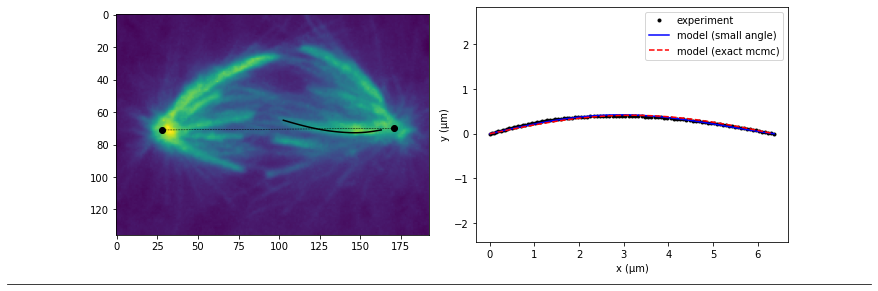

Fx_Fy_Mk
20180810_cell005 0
pole_left 14.527993667399501
P-K distance (L) =  5.53 um
Initial angle =  16.72 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:27<00:00, 367.37it/s]


Exact method error (mcmc): 0.0150
Small-angle error: 0.0021


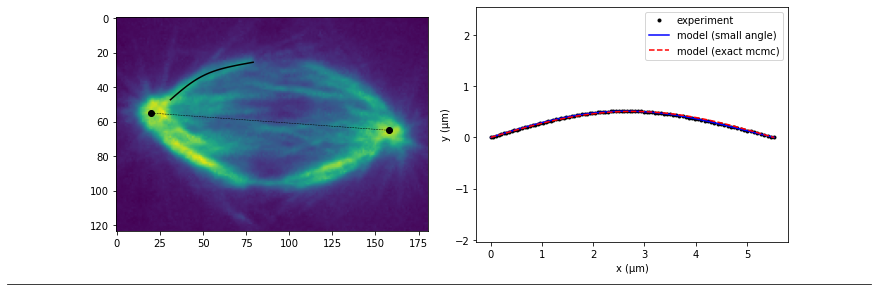

Fx_Fy_Mk
20180810_cell005 1
pole_right 14.527993667399501
P-K distance (L) =  5.86 um
Initial angle =  16.98 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:27<00:00, 369.84it/s]


Exact method error (mcmc): 0.0383
Small-angle error: 0.0166


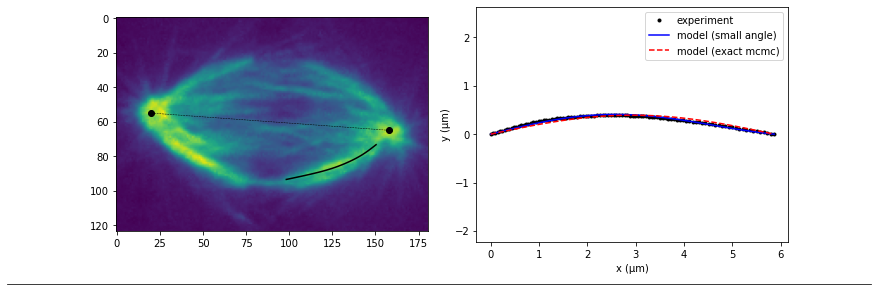

Fx_Fy_Mk
20180810_cell005 2
pole_left 14.527993667399501
P-K distance (L) =  6.05 um
Initial angle =  11.13 degrees


100%|████████████████████████████████████| 10000/10000 [00:28<00:00, 349.11it/s]


Exact method error (mcmc): 0.0073
Small-angle error: 0.0061


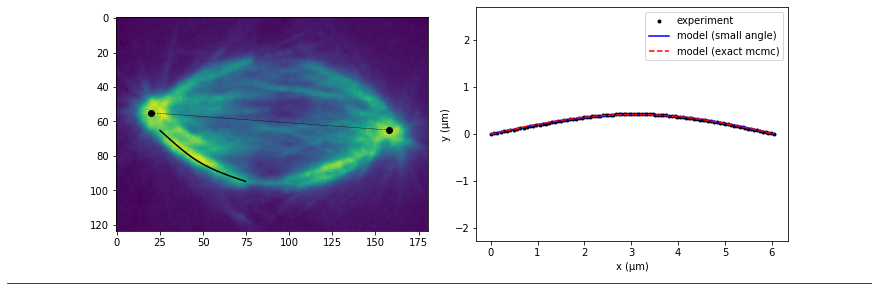

Fx_Fy_Mk
20180810_cell006 0
pole_left 16.811808350085364
P-K distance (L) =  5.45 um
Initial angle =  9.95 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:27<00:00, 363.90it/s]


Exact method error (mcmc): 0.0131
Small-angle error: 0.0089


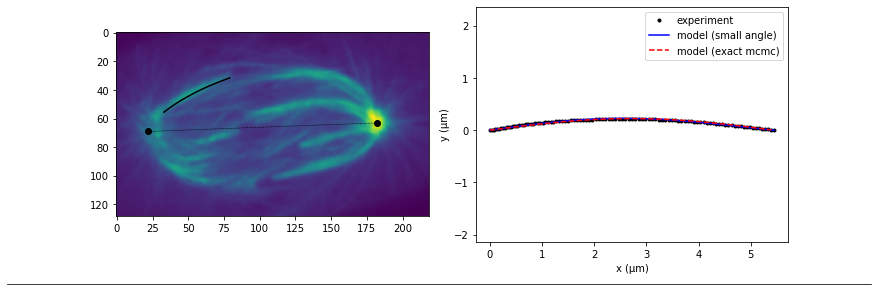

Fx_Fy_Mk
20180810_cell006 1
pole_right 16.811808350085364
P-K distance (L) =  8.93 um
Initial angle =  28.80 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 390.43it/s]


Exact method error (mcmc): 0.1350
Small-angle error: 0.0487


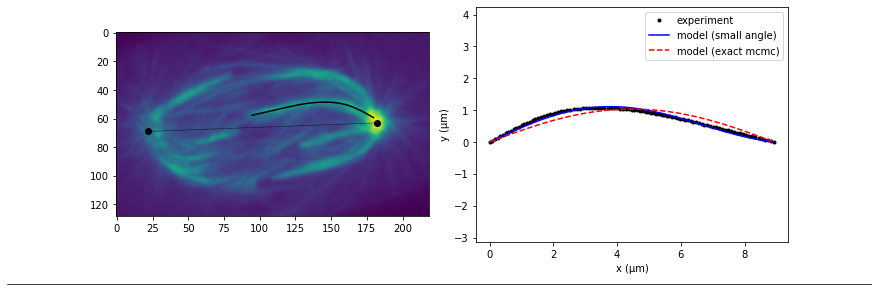

Fx_Fy_Mk
20180810_cell006 2
pole_right 16.811808350085364
P-K distance (L) =  4.95 um
Initial angle =  6.79 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:28<00:00, 351.70it/s]


Exact method error (mcmc): 0.0105
Small-angle error: 0.0046


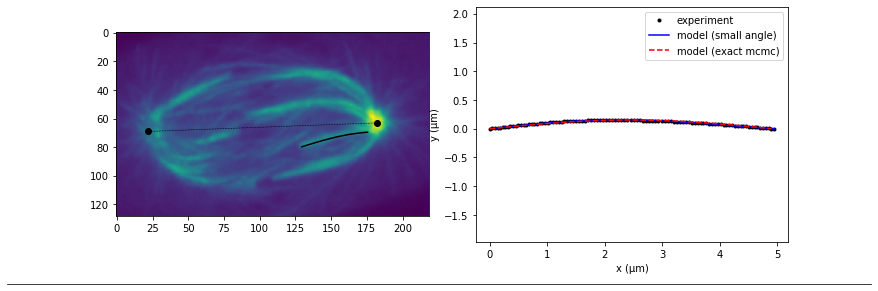

Fx_Fy_Mk
20180810_cell006 3
pole_right 16.811808350085364
P-K distance (L) =  8.32 um
Initial angle =  32.25 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:28<00:00, 353.95it/s]


Exact method error (mcmc): 0.1495
Small-angle error: 0.0718


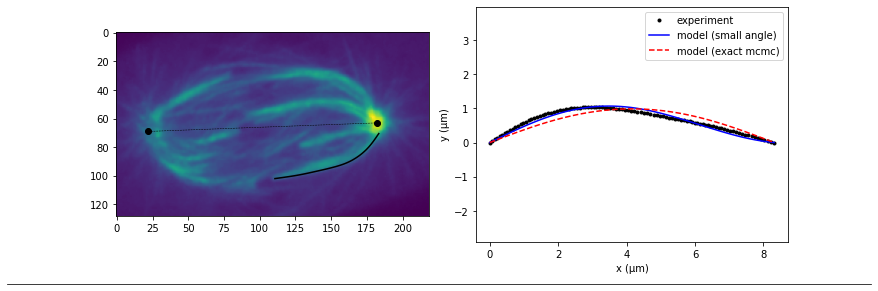

Fx_Fy_Mk
20210526_cell001 0
pole_left 20.895263817430017
P-K distance (L) =  7.11 um
Initial angle =  11.91 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 375.15it/s]


Exact method error (mcmc): 0.0133
Small-angle error: 0.0028


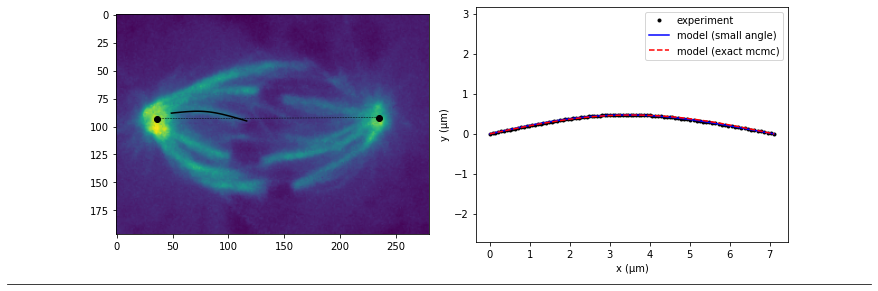

Fx_Fy_Mk
20210526_cell001 1
pole_right 20.895263817430017
P-K distance (L) =  10.57 um
Initial angle =  24.21 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 375.93it/s]


Exact method error (mcmc): 0.1105
Small-angle error: 0.0442


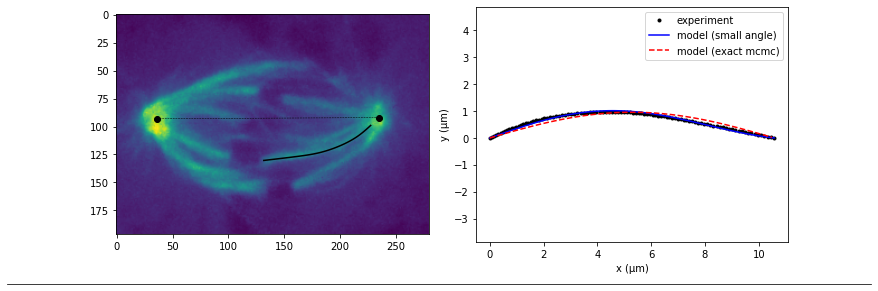

Fx_Fy_Mk
20210526_cell001 2
pole_right 20.895263817430017
P-K distance (L) =  8.96 um
Initial angle =  16.00 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 375.60it/s]


Exact method error (mcmc): 0.0711
Small-angle error: 0.0256


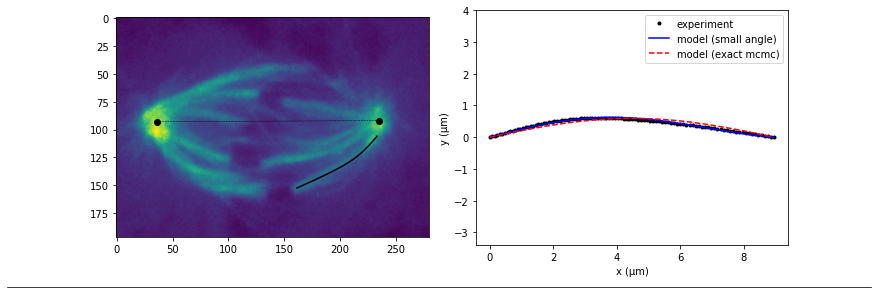

Fx_Fy_Mk
20210526_cell001 3
pole_left 20.895263817430017
P-K distance (L) =  13.48 um
Initial angle =  15.17 degrees


100%|████████████████████████████████████| 10000/10000 [00:29<00:00, 340.81it/s]


Exact method error (mcmc): 0.0170
Small-angle error: 0.0111


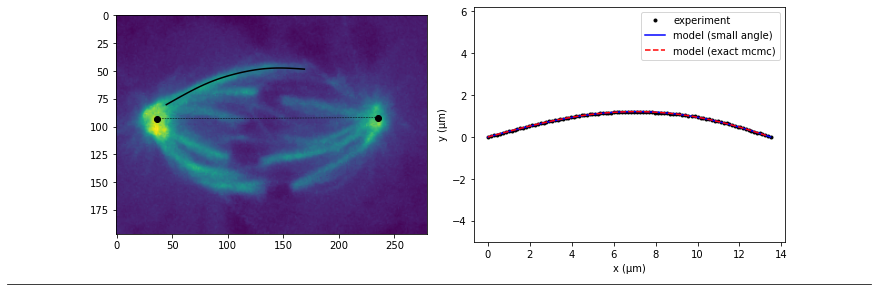

Fx_Fy_Mk
20210526_cell001 4
pole_right 20.895263817430017
P-K distance (L) =  7.30 um
Initial angle =  4.63 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 377.29it/s]


Exact method error (mcmc): 0.0029
Small-angle error: 0.0008


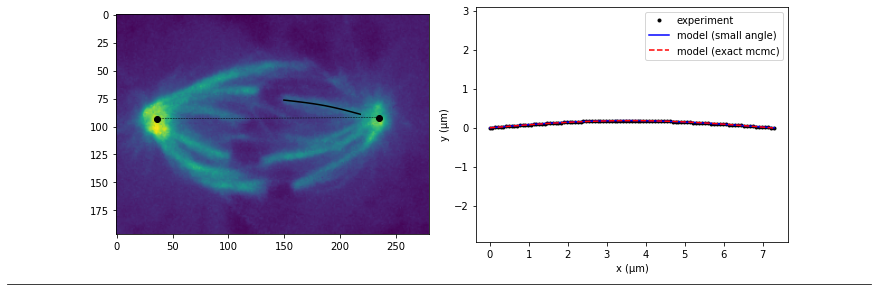

Fx_Fy_Mk
20210526_cell004 0
pole_left 28.035
P-K distance (L) =  10.42 um
Initial angle =  12.33 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 376.63it/s]


Exact method error (mcmc): 0.0491
Small-angle error: 0.0538


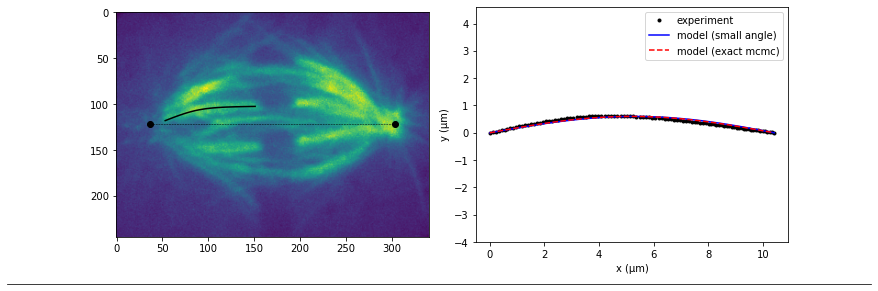

Fx_Fy_Mk
20210526_cell004 1
pole_left 28.035
P-K distance (L) =  10.60 um
Initial angle =  16.54 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 375.00it/s]


Exact method error (mcmc): 0.0716
Small-angle error: 0.0672


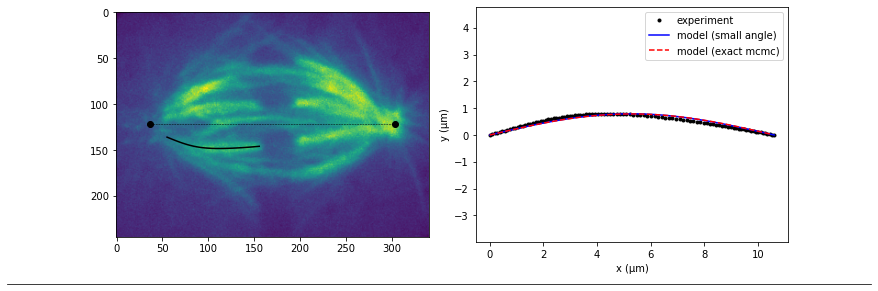

Fx_Fy_Mk
20210526_cell004 2
pole_right 28.035
P-K distance (L) =  10.32 um
Initial angle =  21.96 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:29<00:00, 342.66it/s]


Exact method error (mcmc): 0.1009
Small-angle error: 0.0276


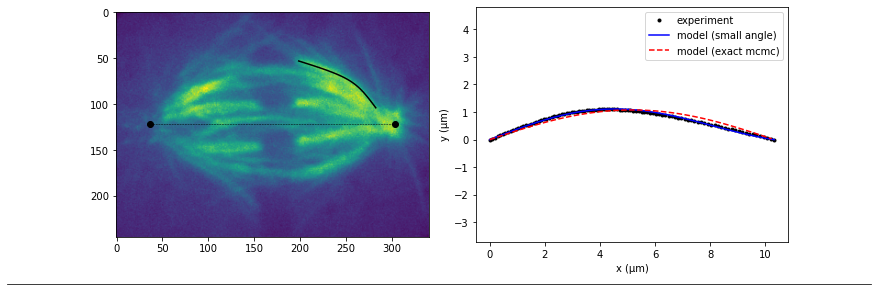

Fx_Fy_Mk
20210526_cell004 3
pole_right 28.035
P-K distance (L) =  7.48 um
Initial angle =  11.65 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:28<00:00, 350.22it/s]


Exact method error (mcmc): 0.0251
Small-angle error: 0.0059


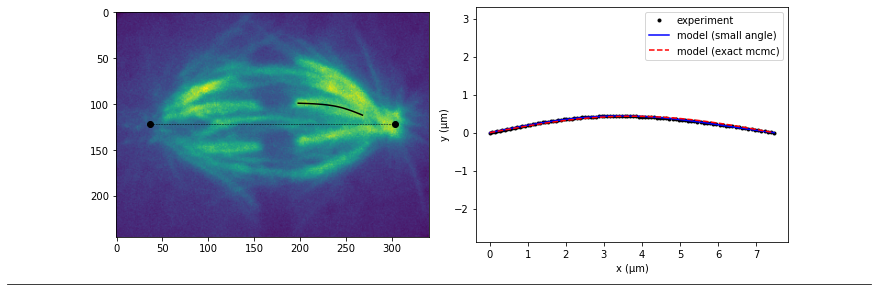

Fx_Fy_Mk
20210526_cell004 4
pole_right 28.035
P-K distance (L) =  8.60 um
Initial angle =  1.56 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:27<00:00, 359.34it/s]


Exact method error (mcmc): 0.0006
Small-angle error: 0.0005


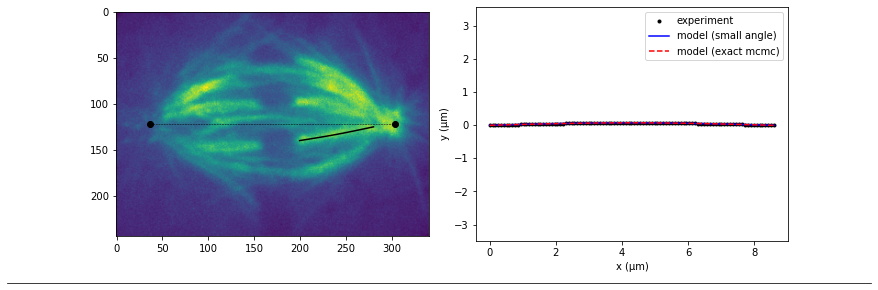

Fx_Fy_Mk
20210526_cell004 5
pole_right 28.035
P-K distance (L) =  10.24 um
Initial angle =  22.64 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:28<00:00, 348.50it/s]


Exact method error (mcmc): 0.0610
Small-angle error: 0.0328


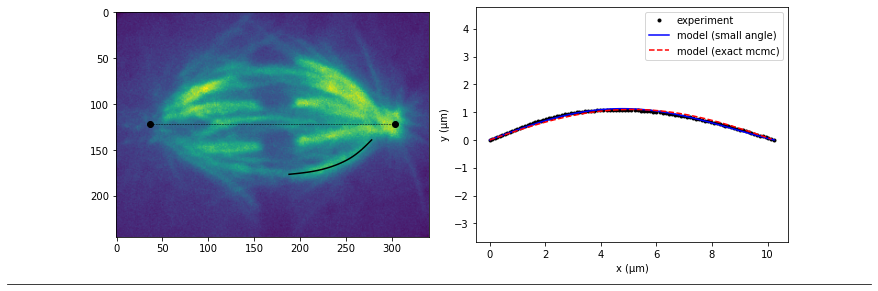

Fx_Fy_Mk
20210526_cell006 0
pole_left 23.998874973631576
P-K distance (L) =  8.55 um
Initial angle =  14.35 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:28<00:00, 350.75it/s]


Exact method error (mcmc): 0.0259
Small-angle error: 0.0046


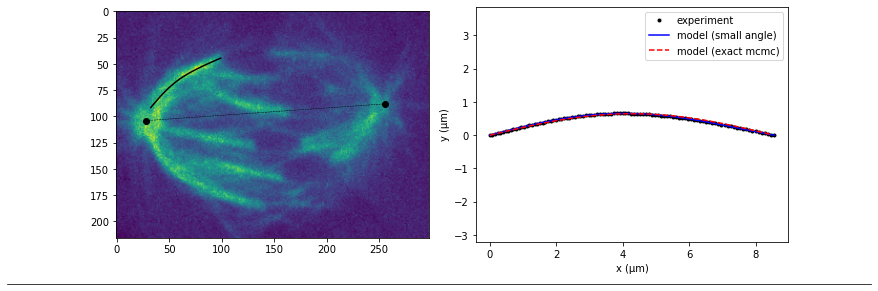

Fx_Fy_Mk
20210526_cell006 1
pole_left 23.998874973631576
P-K distance (L) =  13.26 um
Initial angle =  30.14 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:27<00:00, 368.34it/s]


Exact method error (mcmc): 0.1994
Small-angle error: 0.0722


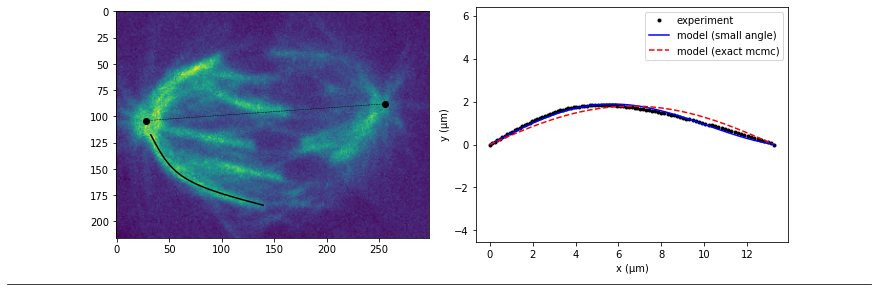

Fx_Fy_Mk
20210526_cell006 2
pole_left 23.998874973631576
P-K distance (L) =  9.00 um
Initial angle =  2.39 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:25<00:00, 390.72it/s]


Exact method error (mcmc): 0.0026
Small-angle error: 0.0006


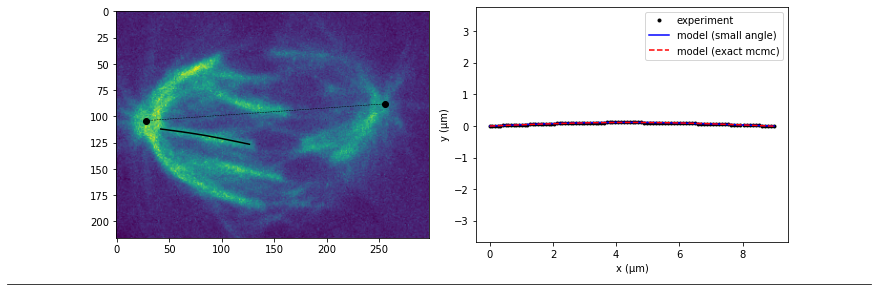

Fx_Fy_Mk
20210526_cell007 0
pole_left 26.275397713450506
P-K distance (L) =  8.61 um
Initial angle =  12.54 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:26<00:00, 378.49it/s]


Exact method error (mcmc): 0.0442
Small-angle error: 0.0147


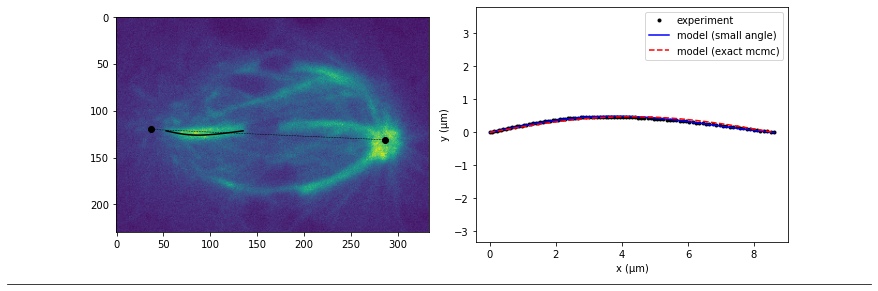

Fx_Fy_Mk
20210526_cell007 1
pole_right 26.275397713450506
P-K distance (L) =  10.99 um
Initial angle =  17.37 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:27<00:00, 368.89it/s]


Exact method error (mcmc): 0.0796
Small-angle error: 0.0398


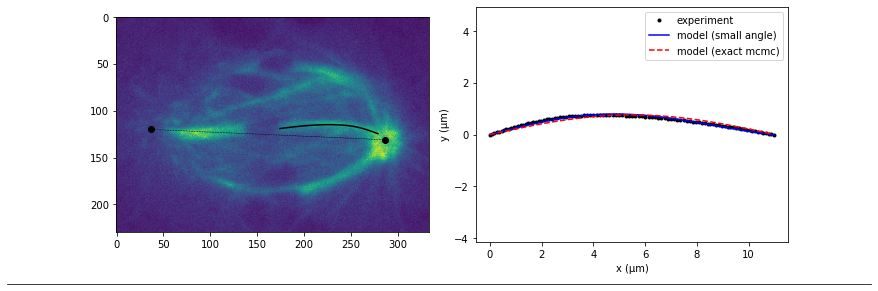

Fx_Fy_Mk
20210526_cell007 2
pole_right 26.275397713450506
P-K distance (L) =  8.85 um
Initial angle =  17.35 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:28<00:00, 351.16it/s]


Exact method error (mcmc): 0.0277
Small-angle error: 0.0135


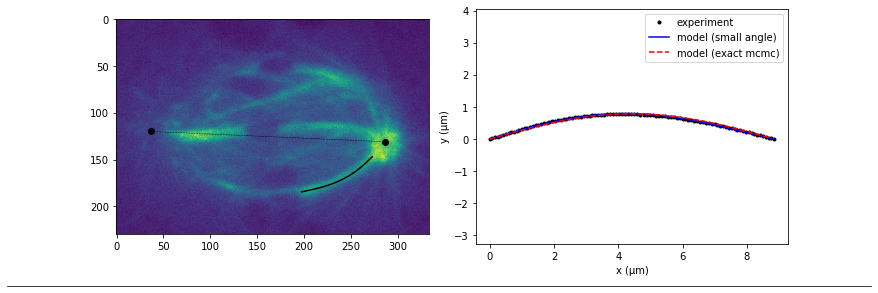

Fx_Fy_Mk
20210526_cell007 3
pole_right 26.275397713450506
P-K distance (L) =  11.33 um
Initial angle =  41.81 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:28<00:00, 353.41it/s]


Exact method error (mcmc): 0.1949
Small-angle error: 0.1147


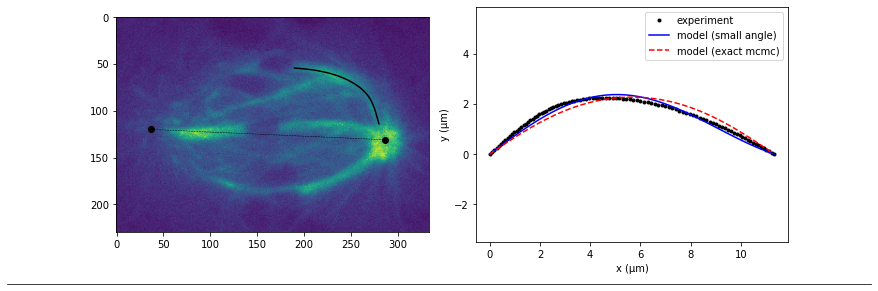

Fx_Fy_Mp
20171215_cell004 0
pole_left 14.979744078254473
P-K distance (L) =  6.39 um
Initial angle =  10.26 degrees


100%|████████████████████████████████████| 10000/10000 [00:43<00:00, 227.97it/s]


Exact method error (mcmc): 0.0060
Small-angle error: 0.0072


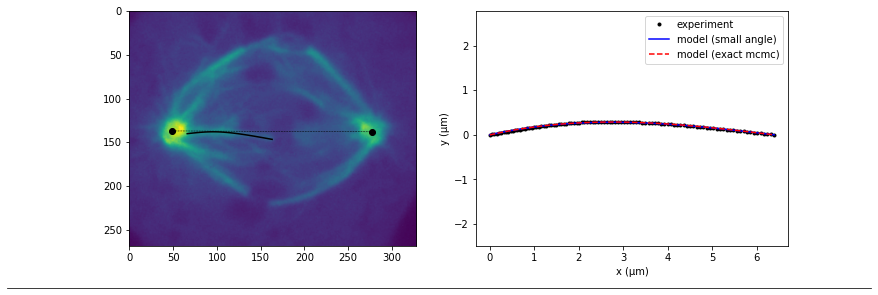

Fx_Fy_Mp
20171215_cell004 1
pole_right 14.979744078254473
P-K distance (L) =  6.69 um
Initial angle =  4.86 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:28<00:00, 356.38it/s]


Exact method error (mcmc): 0.0022
Small-angle error: 0.0063


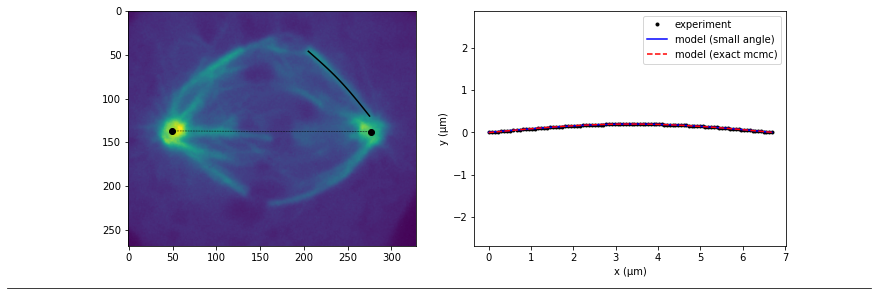

Fx_Fy_Mp
20171215_cell004 2
pole_right 14.979744078254473
P-K distance (L) =  8.38 um
Initial angle =  22.45 degrees


100%|████████████████████████████████████| 10000/10000 [00:28<00:00, 346.14it/s]


Exact method error (mcmc): 0.0139
Small-angle error: 0.0113


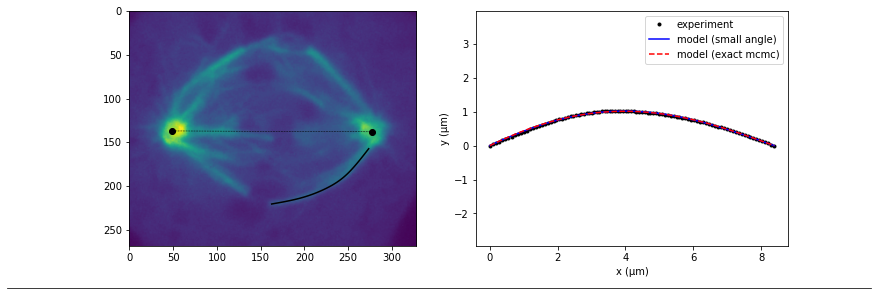

Fx_Fy_Mp
20171215_cell004 3
pole_right 14.979744078254473
P-K distance (L) =  8.35 um
Initial angle =  28.00 degrees


100%|████████████████████████████████████| 10000/10000 [00:29<00:00, 341.51it/s]


Exact method error (mcmc): 0.0109
Small-angle error: 0.0148


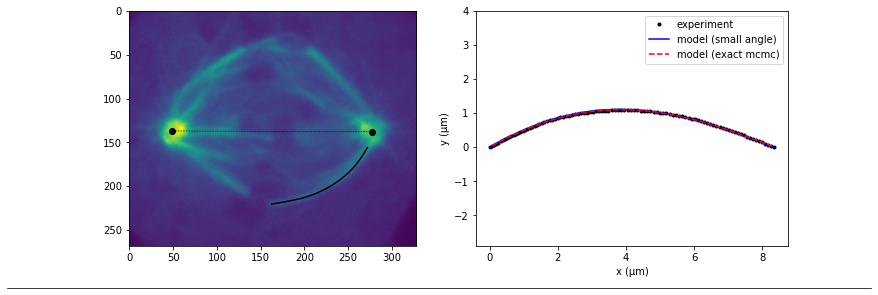

Fx_Fy_Mp
20171215_cell004a 0
pole_left 14.3883
P-K distance (L) =  8.23 um
Initial angle =  21.61 degrees


100%|████████████████████████████████████| 10000/10000 [00:30<00:00, 330.50it/s]


Exact method error (mcmc): 0.0086
Small-angle error: 0.0082


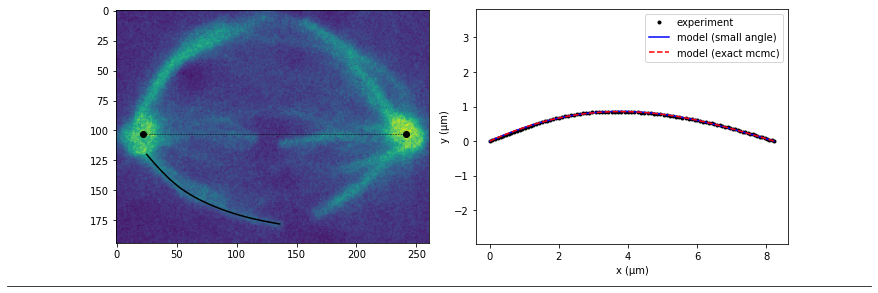

Fx_Fy_Mp
20171215_cell004a 1
pole_right 14.3883
P-K distance (L) =  5.78 um
Initial angle =  5.82 degrees


100%|████████████████████████████████████| 10000/10000 [00:32<00:00, 309.89it/s]


Exact method error (mcmc): 0.0028
Small-angle error: 0.0062


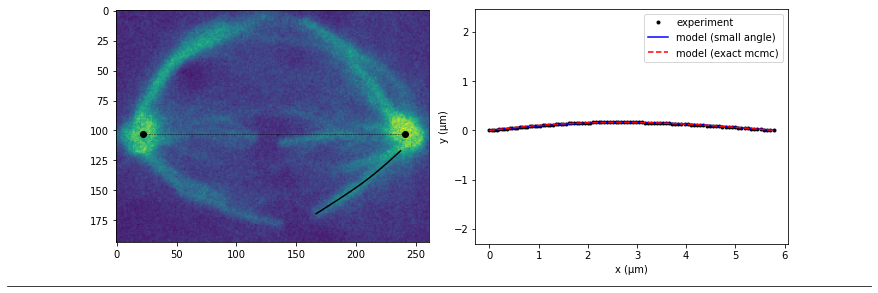

Fx_Fy_Mp
20171215_cell005 0
pole_left 13.807007798940361
P-K distance (L) =  6.22 um
Initial angle =  25.90 degrees


100%|████████████████████████████████████| 10000/10000 [00:29<00:00, 342.54it/s]


Exact method error (mcmc): 0.0173
Small-angle error: 0.0135


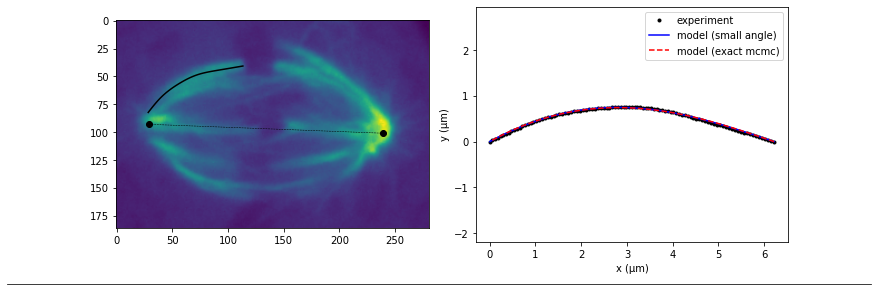

Fx_Fy_Mp
20171215_cell005 1
pole_right 13.807007798940361
P-K distance (L) =  7.42 um
Initial angle =  17.45 degrees


100%|████████████████████████████████████| 10000/10000 [00:29<00:00, 340.22it/s]


Exact method error (mcmc): 0.0144
Small-angle error: 0.0122


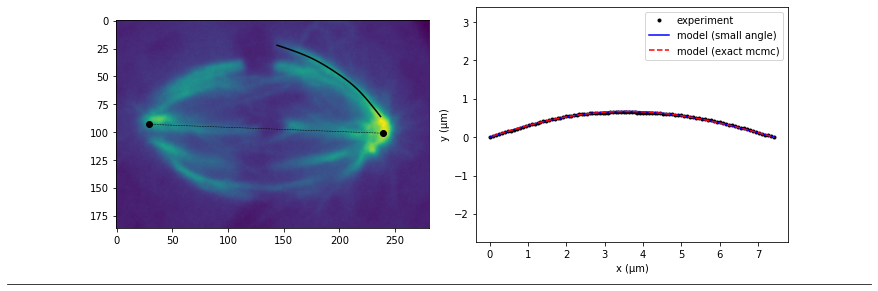

Fx_Fy_Mp
20171215_cell005 2
pole_right 13.807007798940361
P-K distance (L) =  5.44 um
Initial angle =  15.00 degrees


100%|████████████████████████████████████| 10000/10000 [00:29<00:00, 343.88it/s]


Exact method error (mcmc): 0.0089
Small-angle error: 0.0081


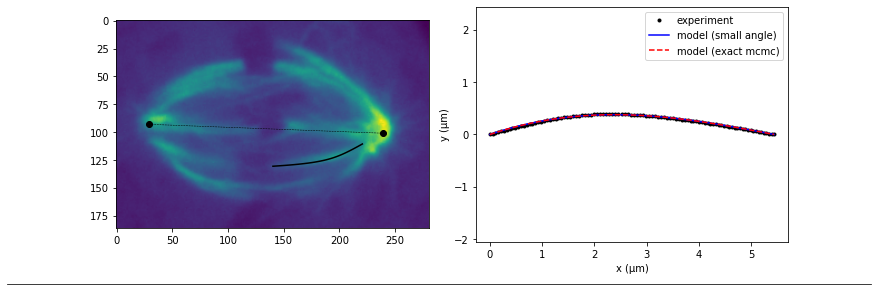

Fx_Fy_Mp
20171219_cell003 0
pole_left 16.766377403899746
P-K distance (L) =  8.12 um
Initial angle =  9.10 degrees


100%|████████████████████████████████████| 10000/10000 [00:27<00:00, 357.28it/s]


Exact method error (mcmc): 0.0114
Small-angle error: 0.0082


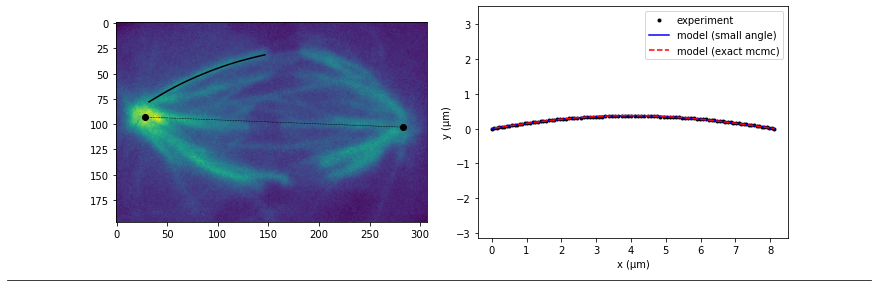

Fx_Fy_Mp
20171219_cell003 1
pole_left 16.766377403899746
P-K distance (L) =  5.50 um
Initial angle =  8.75 degrees


100%|████████████████████████████████████| 10000/10000 [00:28<00:00, 344.99it/s]


Exact method error (mcmc): 0.0041
Small-angle error: 0.0049


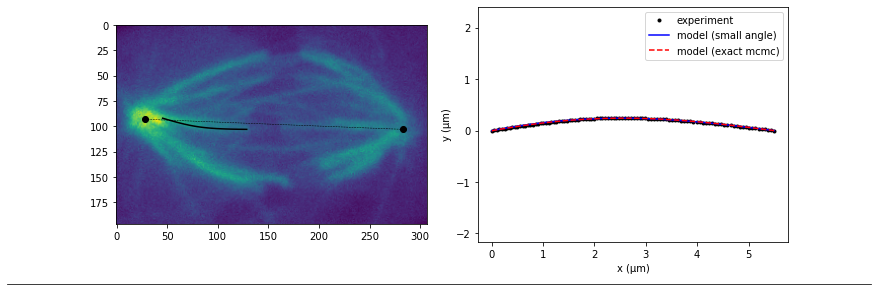

Fx_Fy_Mp
20180611_cell002 0
pole_left 14.283473842171588
P-K distance (L) =  6.64 um
Initial angle =  22.71 degrees


100%|████████████████████████████████████| 10000/10000 [00:29<00:00, 343.45it/s]


Exact method error (mcmc): 0.0162
Small-angle error: 0.0130


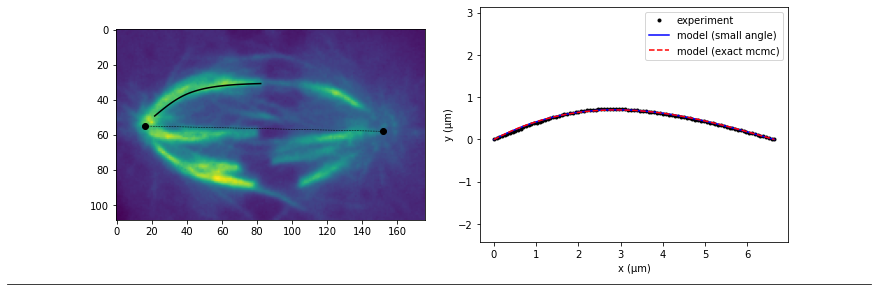

Fx_Fy_Mp
20180611_cell002 1
pole_left 14.283473842171588
P-K distance (L) =  6.59 um
Initial angle =  21.91 degrees


100%|████████████████████████████████████| 10000/10000 [00:28<00:00, 346.54it/s]


Exact method error (mcmc): 0.0149
Small-angle error: 0.0120


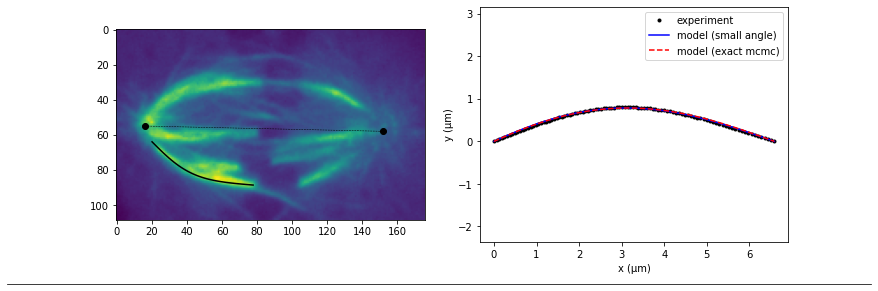

Fx_Fy_Mp
20180611_cell002 2
pole_left 14.283473842171588
P-K distance (L) =  6.59 um
Initial angle =  21.91 degrees


100%|████████████████████████████████████| 10000/10000 [00:28<00:00, 345.01it/s]


Exact method error (mcmc): 0.0149
Small-angle error: 0.0118


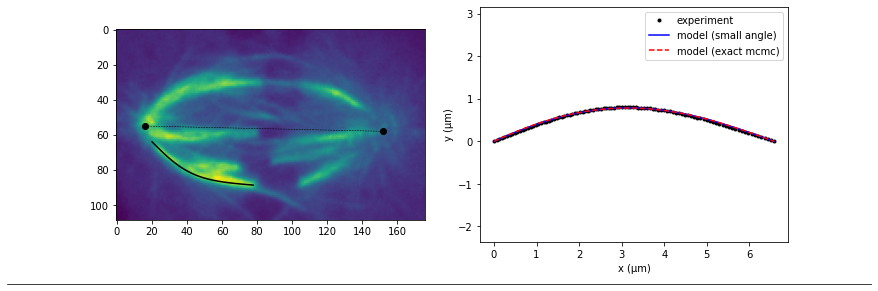

Fx_Fy_Mp
20180612_cell001 0
pole_left 14.806489286795841
P-K distance (L) =  7.85 um
Initial angle =  21.07 degrees


100%|████████████████████████████████████| 10000/10000 [00:29<00:00, 337.68it/s]


Exact method error (mcmc): 0.0204
Small-angle error: 0.0145


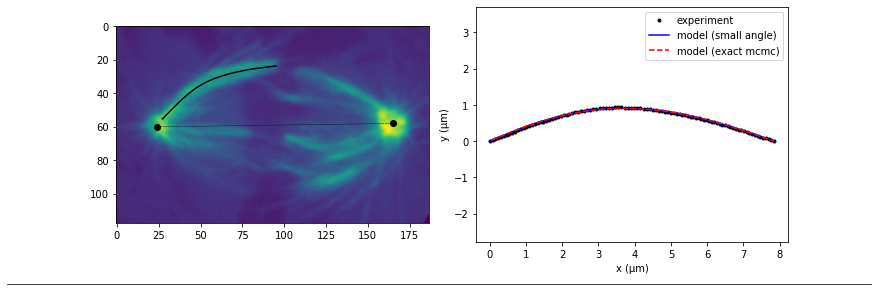

Fx_Fy_Mp
20180612_cell001 1
pole_left 14.806489286795841
P-K distance (L) =  4.69 um
Initial angle =  11.81 degrees


100%|████████████████████████████████████| 10000/10000 [00:28<00:00, 345.87it/s]


Exact method error (mcmc): 0.0068
Small-angle error: 0.0073


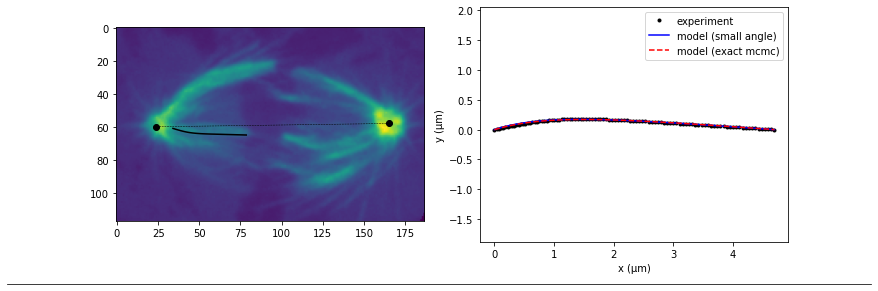

Fx_Fy_Mp
20180612_cell003 0
pole_left 13.021693438259096
P-K distance (L) =  5.70 um
Initial angle =  23.85 degrees


100%|████████████████████████████████████| 10000/10000 [00:28<00:00, 346.83it/s]


Exact method error (mcmc): 0.0124
Small-angle error: 0.0126


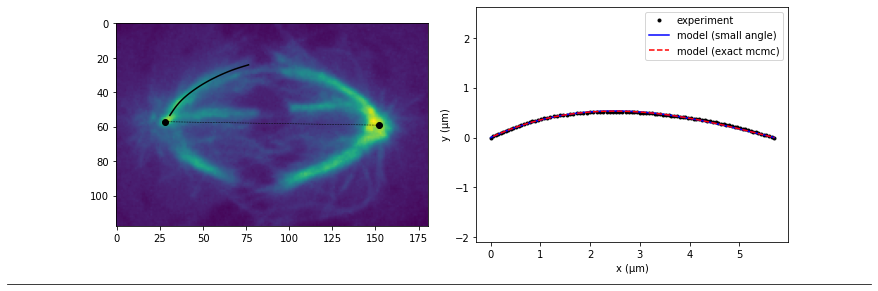

Fx_Fy_Mp
20180612_cell003 1
pole_left 13.021693438259096
P-K distance (L) =  4.84 um
Initial angle =  15.69 degrees


100%|████████████████████████████████████| 10000/10000 [00:29<00:00, 344.02it/s]


Exact method error (mcmc): 0.0154
Small-angle error: 0.0146


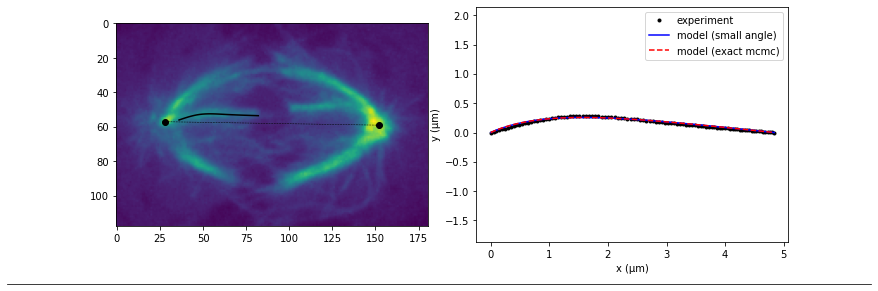

Fx_Fy_Mp
20180612_cell003 2
pole_right 13.021693438259096
P-K distance (L) =  5.89 um
Initial angle =  23.08 degrees


100%|████████████████████████████████████| 10000/10000 [00:30<00:00, 325.48it/s]


Exact method error (mcmc): 0.0033
Small-angle error: 0.0058


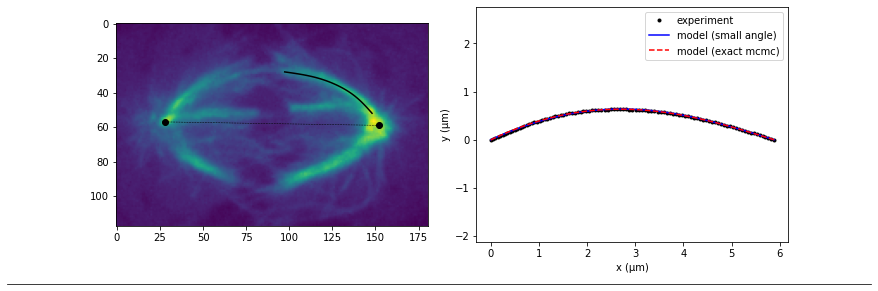

Fx_Fy_Mp
20180620_cell013 0
pole_left 14.625561527681594
P-K distance (L) =  5.89 um
Initial angle =  4.07 degrees


100%|████████████████████████████████████| 10000/10000 [00:28<00:00, 356.91it/s]


Exact method error (mcmc): 0.0094
Small-angle error: 0.0126


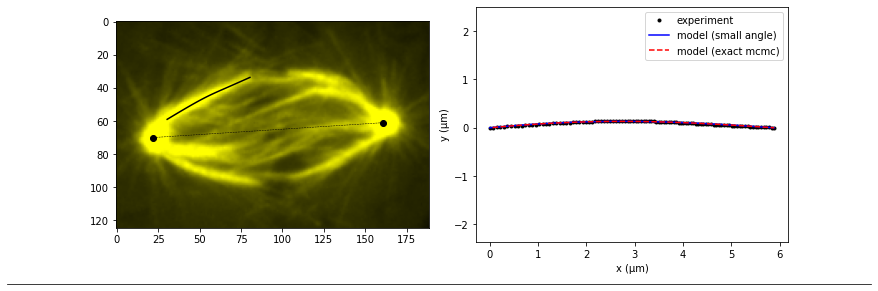

Fx_Fy_Mp
20180620_cell013 1
pole_left 14.625561527681594
P-K distance (L) =  6.28 um
Initial angle =  16.50 degrees


100%|████████████████████████████████████| 10000/10000 [00:29<00:00, 341.34it/s]


Exact method error (mcmc): 0.0071
Small-angle error: 0.0066


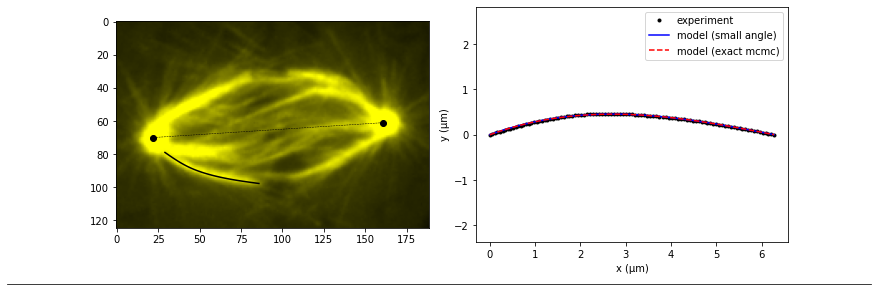

Fx_Fy_Mp
20180620_cell013 2
pole_right 14.625561527681594
P-K distance (L) =  6.07 um
Initial angle =  7.39 degrees


  0%|                                                 | 0/10000 [00:00<?, ?it/s]/Users/vahegalstyan/anaconda3/lib/python3.8/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|████████████████████████████████████| 10000/10000 [00:28<00:00, 352.42it/s]


Exact method error (mcmc): 0.0357
Small-angle error: 0.0150


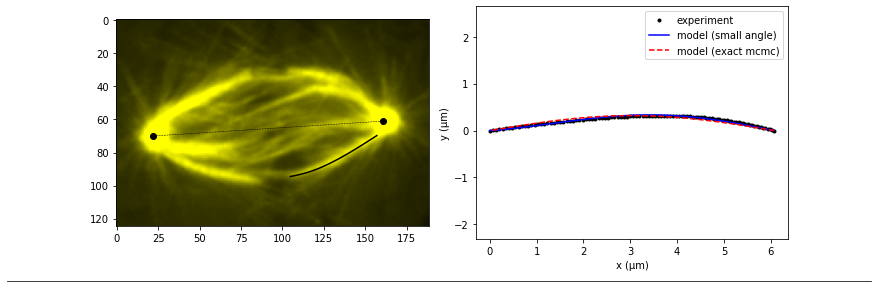

Fx_Fy_Mp
20180622_cell015 0
pole_left 16.388411301892564
P-K distance (L) =  7.51 um
Initial angle =  18.18 degrees


100%|████████████████████████████████████| 10000/10000 [00:32<00:00, 311.76it/s]


Exact method error (mcmc): 0.0053
Small-angle error: 0.0080


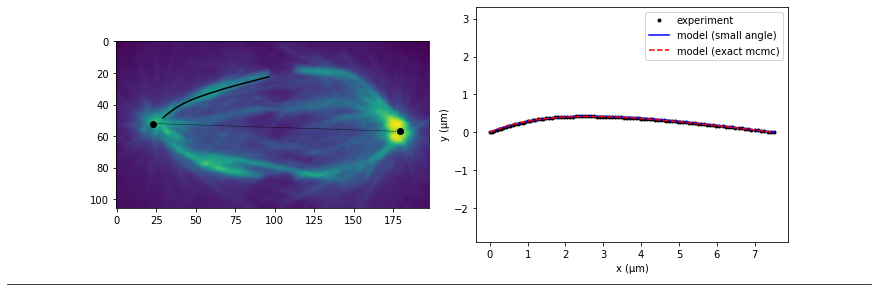

Fx_Fy_Mp
20180622_cell015 1
pole_left 16.388411301892564
P-K distance (L) =  7.19 um
Initial angle =  18.74 degrees


100%|████████████████████████████████████| 10000/10000 [00:30<00:00, 330.03it/s]


Exact method error (mcmc): 0.0215
Small-angle error: 0.0206


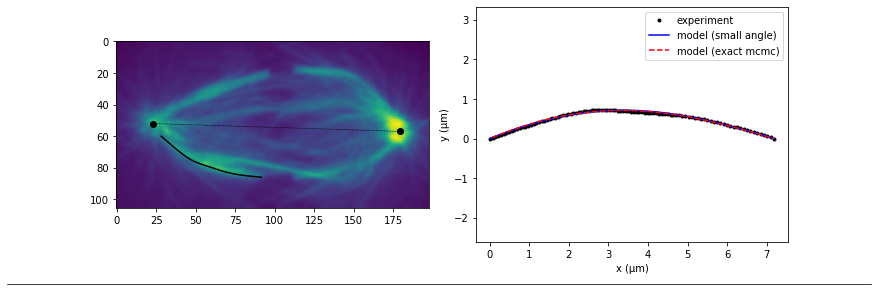

Fx_Fy_Mp
20180622_cell016 0
pole_left 15.225
P-K distance (L) =  6.11 um
Initial angle =  13.57 degrees


100%|████████████████████████████████████| 10000/10000 [00:30<00:00, 330.63it/s]


Exact method error (mcmc): 0.0122
Small-angle error: 0.0079


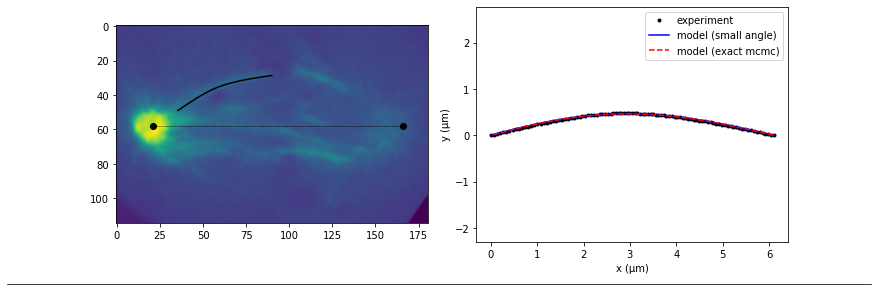

Fx_Fy_Mp
20180622_cell020 0
pole_left 12.401117893157858
P-K distance (L) =  6.69 um
Initial angle =  28.34 degrees


100%|████████████████████████████████████| 10000/10000 [00:30<00:00, 330.98it/s]


Exact method error (mcmc): 0.0190
Small-angle error: 0.0213


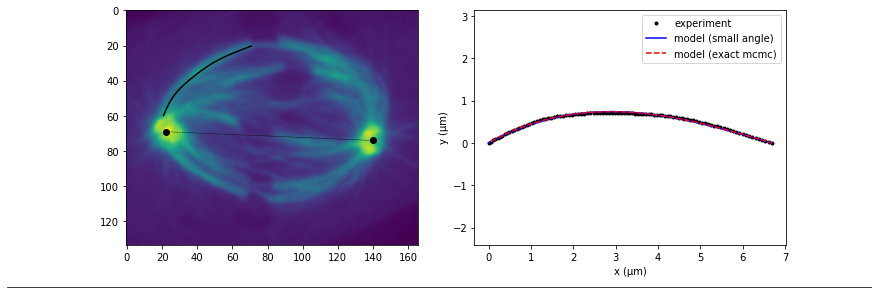

Fx_Fy_Mp
20180622_cell020 1
pole_right 12.401117893157858
P-K distance (L) =  6.03 um
Initial angle =  24.49 degrees


100%|████████████████████████████████████| 10000/10000 [00:30<00:00, 327.39it/s]


Exact method error (mcmc): 0.0055
Small-angle error: 0.0035


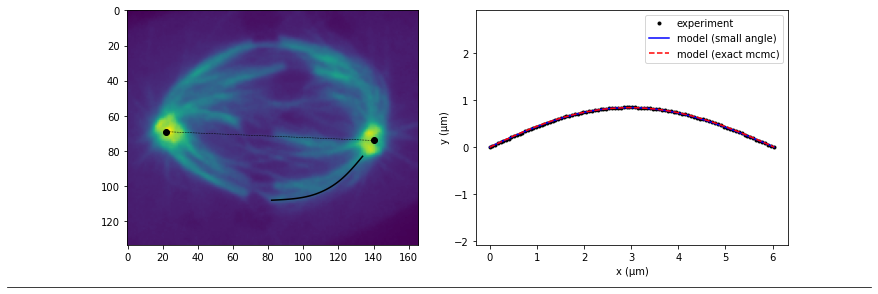

Fx_Fy_Mp
20180622_cell020 2
pole_left 12.401117893157858
P-K distance (L) =  5.00 um
Initial angle =  13.21 degrees


100%|████████████████████████████████████| 10000/10000 [00:28<00:00, 345.99it/s]


Exact method error (mcmc): 0.0096
Small-angle error: 0.0087


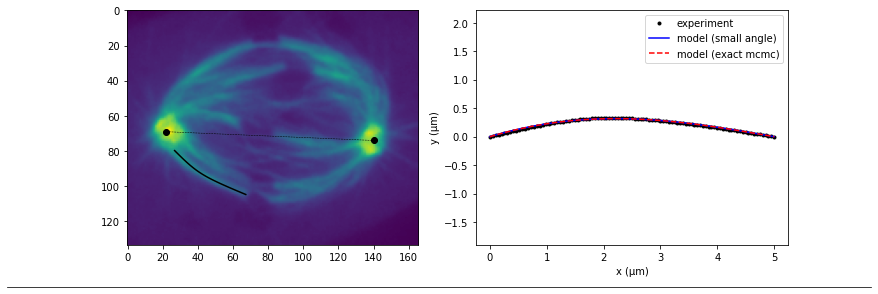

Fx_Fy_Mp
20180622_cell020 3
pole_right 12.401117893157858
P-K distance (L) =  5.47 um
Initial angle =  25.99 degrees


100%|████████████████████████████████████| 10000/10000 [00:28<00:00, 345.61it/s]


Exact method error (mcmc): 0.0038
Small-angle error: 0.0071


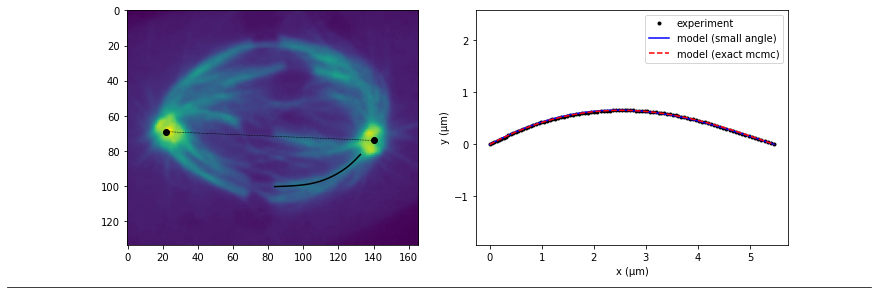

Fx_Fy_Mp
20180622_cell026 0
pole_left 14.598398884809251
P-K distance (L) =  5.74 um
Initial angle =  24.35 degrees


100%|████████████████████████████████████| 10000/10000 [00:28<00:00, 346.63it/s]


Exact method error (mcmc): 0.0146
Small-angle error: 0.0150


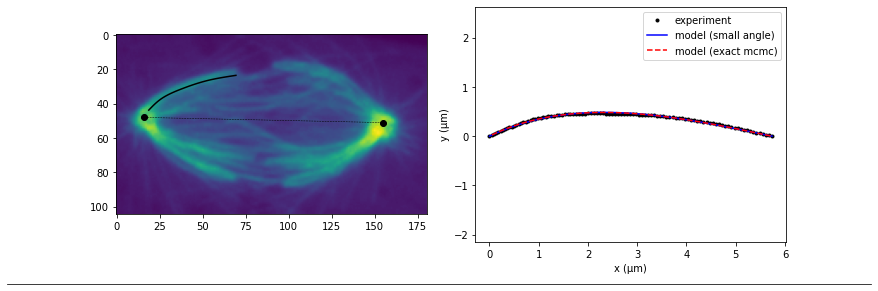

Fx_Fy_Mp
20180622_cell026 1
pole_left 14.598398884809251
P-K distance (L) =  5.88 um
Initial angle =  13.64 degrees


100%|████████████████████████████████████| 10000/10000 [00:29<00:00, 342.41it/s]


Exact method error (mcmc): 0.0120
Small-angle error: 0.0103


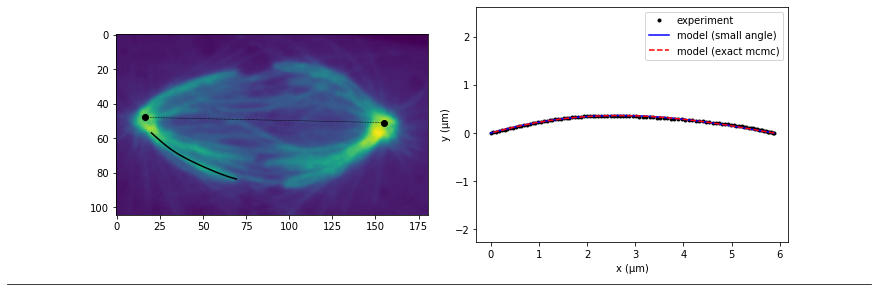

Fx_Fy_Mp
20180622_cell026 2
pole_right 14.598398884809251
P-K distance (L) =  6.41 um
Initial angle =  33.09 degrees


100%|████████████████████████████████████| 10000/10000 [00:29<00:00, 342.31it/s]


Exact method error (mcmc): 0.0135
Small-angle error: 0.0063


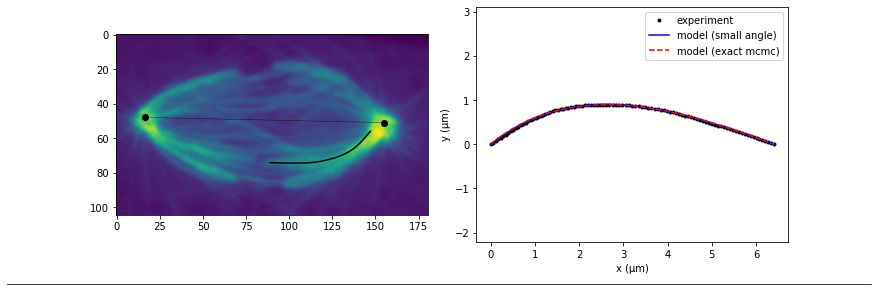

Fx_Fy_Mp
20180622_cell026 3
pole_right 14.598398884809251
P-K distance (L) =  6.13 um
Initial angle =  22.85 degrees


100%|████████████████████████████████████| 10000/10000 [00:28<00:00, 345.43it/s]


Exact method error (mcmc): 0.0046
Small-angle error: 0.0033


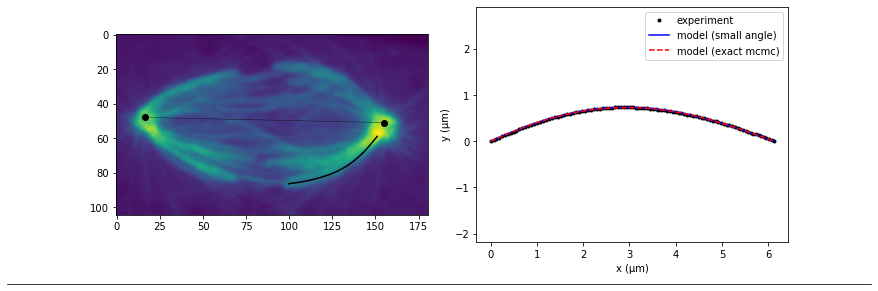

Fx_Fy_Mp
20180622_cell027 0
pole_left 14.181220857175873
P-K distance (L) =  4.89 um
Initial angle =  9.20 degrees


100%|████████████████████████████████████| 10000/10000 [00:27<00:00, 357.57it/s]


Exact method error (mcmc): 0.0105
Small-angle error: 0.0096


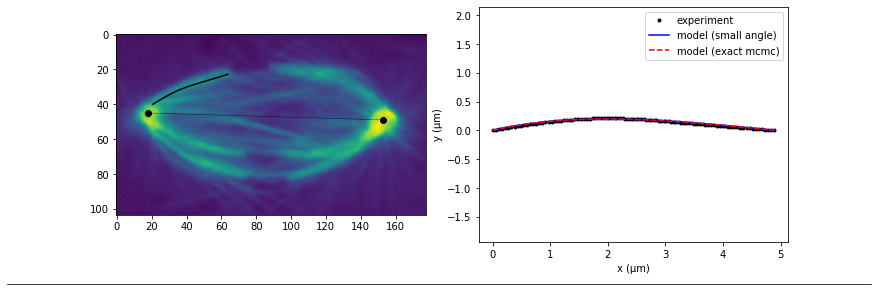

Fx_Fy_Mp
20180622_cell027 1
pole_left 14.181220857175873
P-K distance (L) =  5.44 um
Initial angle =  15.19 degrees


100%|████████████████████████████████████| 10000/10000 [00:28<00:00, 353.21it/s]


Exact method error (mcmc): 0.0082
Small-angle error: 0.0066


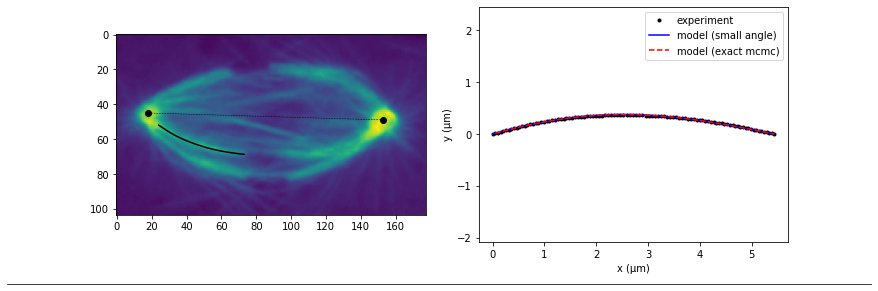

Fx_Fy_Mp
20180622_cell027 2
pole_left 14.181220857175873
P-K distance (L) =  6.23 um
Initial angle =  20.25 degrees


100%|████████████████████████████████████| 10000/10000 [00:29<00:00, 335.38it/s]


Exact method error (mcmc): 0.0116
Small-angle error: 0.0106


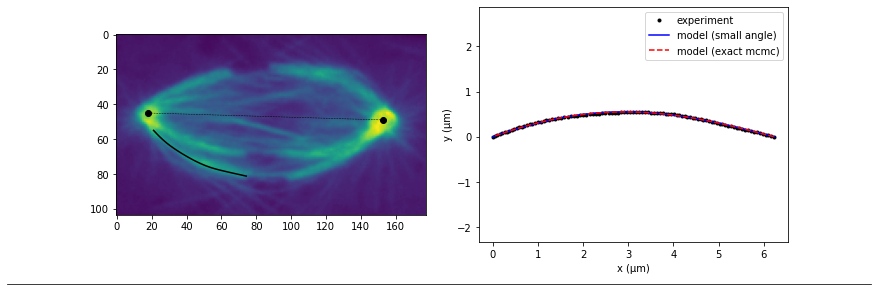

Fx_Fy_Mp
20180622_cell027 3
pole_right 14.181220857175873
P-K distance (L) =  6.82 um
Initial angle =  21.28 degrees


100%|████████████████████████████████████| 10000/10000 [00:28<00:00, 347.69it/s]


Exact method error (mcmc): 0.0110
Small-angle error: 0.0109


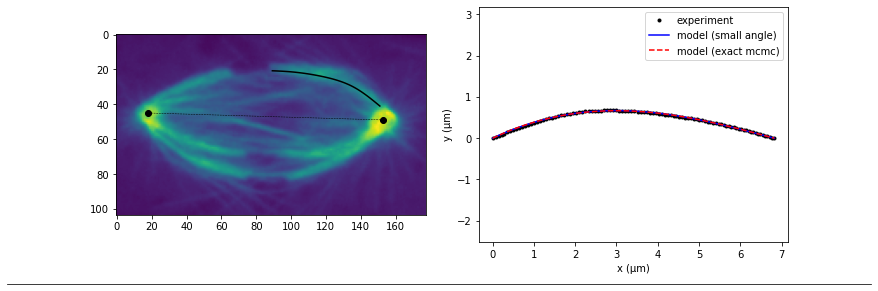

Fx_Fy_Mp
20180622_cell027 4
pole_right 14.181220857175873
P-K distance (L) =  5.78 um
Initial angle =  15.63 degrees


100%|████████████████████████████████████| 10000/10000 [00:29<00:00, 344.60it/s]


Exact method error (mcmc): 0.0040
Small-angle error: 0.0056


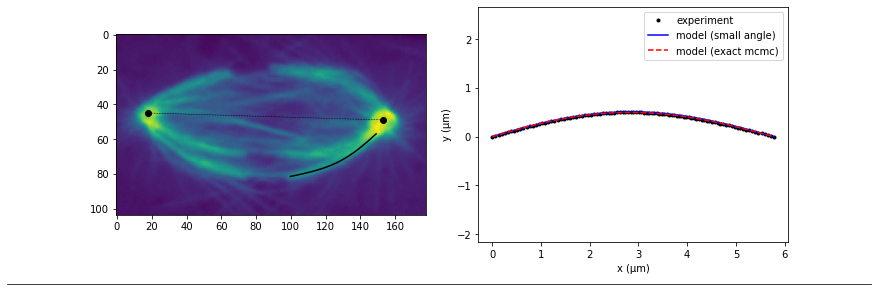

Fx_Fy_Mp
20180622_cell028 0
pole_left 16.907934527907305
P-K distance (L) =  7.63 um
Initial angle =  15.89 degrees


100%|████████████████████████████████████| 10000/10000 [00:29<00:00, 339.67it/s]


Exact method error (mcmc): 0.0054
Small-angle error: 0.0062


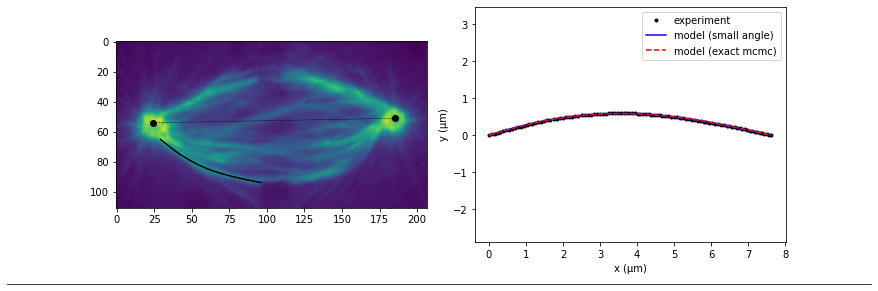

Fx_Fy_Mp
20180622_cell028 1
pole_right 16.907934527907305
P-K distance (L) =  5.90 um
Initial angle =  26.89 degrees


100%|████████████████████████████████████| 10000/10000 [00:30<00:00, 332.12it/s]


Exact method error (mcmc): 0.0179
Small-angle error: 0.0152


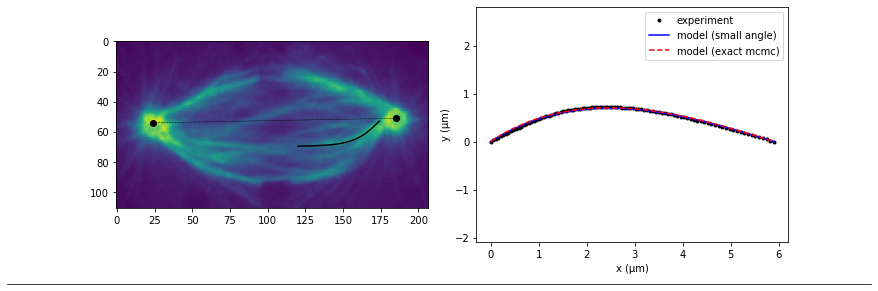

Fx_Fy_Mp
20180622_cell030 0
pole_left 14.071567076910801
P-K distance (L) =  5.60 um
Initial angle =  31.47 degrees


100%|████████████████████████████████████| 10000/10000 [00:30<00:00, 330.47it/s]


Exact method error (mcmc): 0.0129
Small-angle error: 0.0110


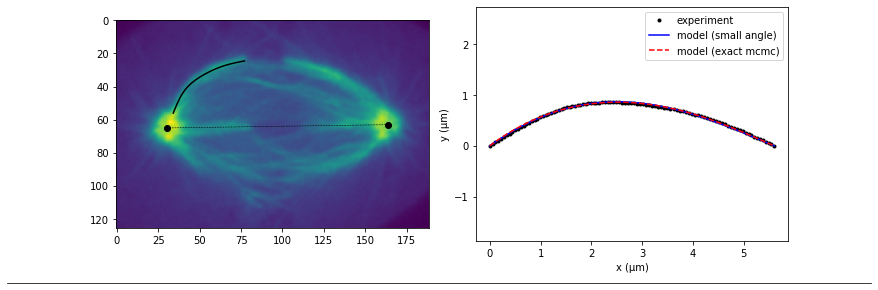

Fx_Fy_Mp
20180622_cell030 1
pole_right 14.071567076910801
P-K distance (L) =  6.70 um
Initial angle =  23.23 degrees


100%|████████████████████████████████████| 10000/10000 [00:29<00:00, 334.51it/s]


Exact method error (mcmc): 0.0059
Small-angle error: 0.0072


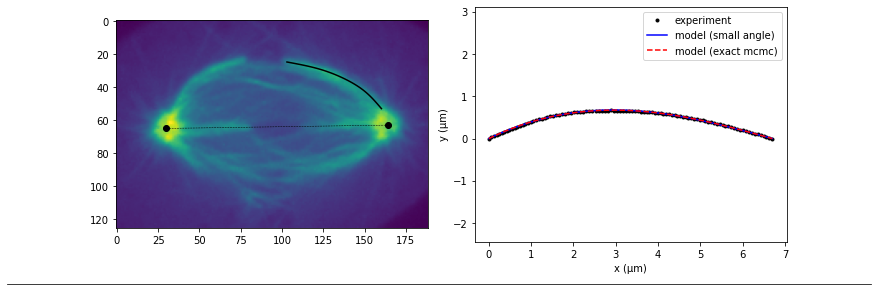

Fx_Fy_Mp
20180626_cell001 0
pole_left 14.286175135423758
P-K distance (L) =  6.04 um
Initial angle =  15.38 degrees


100%|████████████████████████████████████| 10000/10000 [00:28<00:00, 349.71it/s]


Exact method error (mcmc): 0.0133
Small-angle error: 0.0125


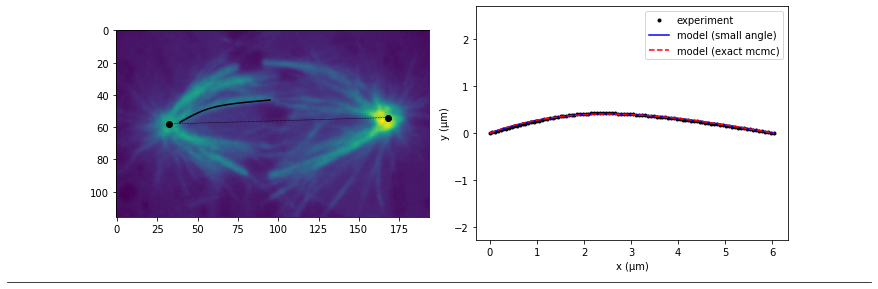

Fx_Fy_Mp
20180626_cell001 1
pole_left 14.286175135423758
P-K distance (L) =  5.18 um
Initial angle =  18.14 degrees


100%|████████████████████████████████████| 10000/10000 [00:28<00:00, 350.30it/s]


Exact method error (mcmc): 0.0038
Small-angle error: 0.0066


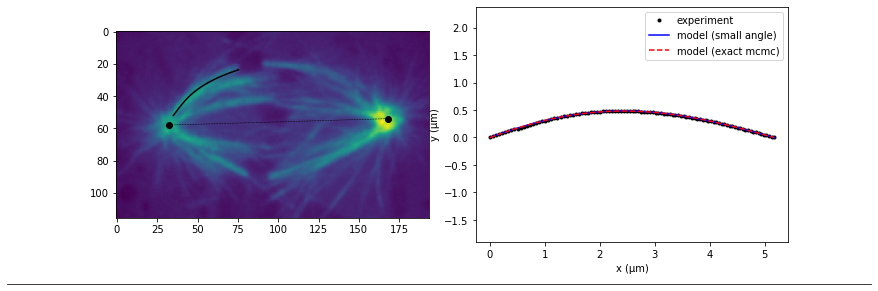

Fx_Fy_Mp
20180626_cell001 2
pole_right 14.286175135423758
P-K distance (L) =  6.93 um
Initial angle =  31.42 degrees


100%|████████████████████████████████████| 10000/10000 [00:29<00:00, 336.76it/s]


Exact method error (mcmc): 0.0147
Small-angle error: 0.0077


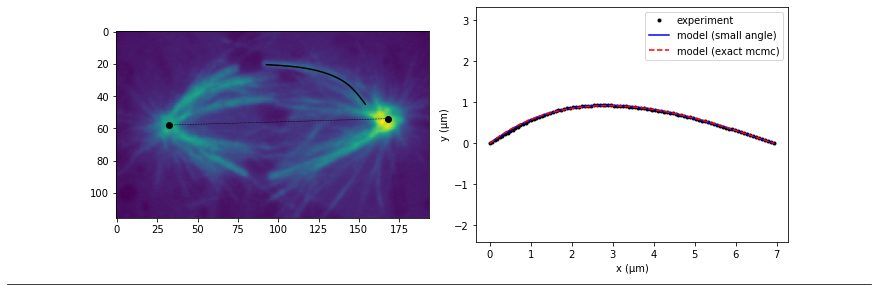

Fx_Fy_Mp
20180628_cell002 0
pole_left 13.236664987828316
P-K distance (L) =  7.16 um
Initial angle =  15.71 degrees


100%|████████████████████████████████████| 10000/10000 [00:29<00:00, 344.61it/s]


Exact method error (mcmc): 0.0031
Small-angle error: 0.0062


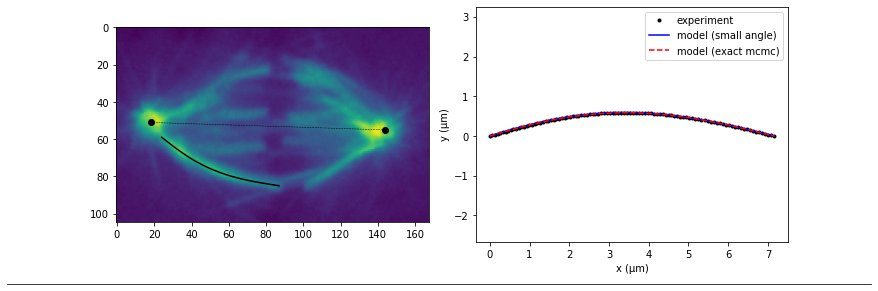

Fx_Fy_Mp
20180628_cell006 0
pole_left 16.826557134482385
P-K distance (L) =  6.16 um
Initial angle =  18.85 degrees


  1%|▍                                     | 126/10000 [00:00<00:32, 303.59it/s]

In [ ]:
cases = ['Fx_only', 'Fy_Mp_only', 'Fy_Mk_only', 'Fx_Fy_Mk', 'Fx_Fy_Mp', 'unconstrained']

for case in cases:

    np.random.seed(0)
    if case == 'Fx_only':
        Rx_zero = False
        M0_zero = True
        Ry_zero = True
        flip = False
    elif case == 'Fy_Mp_only':
        Rx_zero = True
        M0_zero = True
        Ry_zero = False
        flip = True
    elif case == 'Fy_Mk_only':
        Rx_zero = True
        M0_zero = True
        Ry_zero = False
        flip = False
    elif case == 'Fx_Fy_Mk':
        Rx_zero = False
        M0_zero = True
        Ry_zero = False
        flip = False
    elif case == 'Fx_Fy_Mp':
        Rx_zero = False
        M0_zero = True
        Ry_zero = False
        flip = True
    elif case == 'unconstrained':
        Rx_zero = False
        M0_zero = False
        Ry_zero = False
        flip = False

    df_fin = pd.DataFrame()

    for cell in cells:

        spindle = cell.split("/")[-1].split(".")[0]
        image = mpimg.imread("%s/%s_before.tif"%(cell,spindle))
        profiles = sorted(list(set(glob.glob("%s/*.csv"%cell)) - set(glob.glob("%s/*poles.csv"%cell))))
        pole_csv = glob.glob("%s/*poles.csv"%cell)[-1]

        for profile in profiles:

            kfiber_number = profile.split("/")[-1].split(".")[0].split("_")[-1]
            print(case)
            print(spindle, kfiber_number)

            fig, ax = plt.subplots(1, 2, figsize = (10, 4))

            # Raw data input
            df_profile = pd.read_csv(profile)
            df_pole = pd.read_csv(pole_csv)

            x_dat = np.array(df_profile["X"].values)
            y_dat = np.array(df_profile["Y"].values)

            # Show the spindle image & overlaid k-fiber profile
            ax[0].imshow(image)
            ax[0].plot(x_dat, y_dat, color = 'k')


            # Pole coordinates & plotting
            P1x = np.array(df_pole["X"].values)[0]
            P1y = np.array(df_pole["Y"].values)[0]
            P2x = np.array(df_pole["X"].values)[1]
            P2y = np.array(df_pole["Y"].values)[1]
            ax[0].scatter([P1x, P2x], [P1y, P2y], color='k')
            ax[0].plot([P1x, P2x], [P1y, P2y], color='k', ls='--', lw=0.5)

            # Angle that the pole-kinetochore line
            # forms with the pole-pole axis
            PP_vector = [P2x-P1x, P2y-P1y]
            K_vector = [x_dat[-1]-x_dat[0], y_dat[-1]-y_dat[0]]
            unit_PP_vector = PP_vector / np.linalg.norm(PP_vector)
            unit_K_vector = K_vector / np.linalg.norm(K_vector)
            dot_product = np.dot(unit_PP_vector, unit_K_vector)
            PP_K_angle = np.arccos(dot_product)
            if PP_K_angle > np.pi/2:
                PP_K_angle = np.pi - PP_K_angle

            # Identify the spindle side in which the k-fiber lies
            x_mean = np.mean(x_dat)
            y_mean = np.mean(y_dat)
            dist_P1 = np.sqrt((x_mean-P1x)**2 + (y_mean-P1y)**2)
            dist_P2 = np.sqrt((x_mean-P2x)**2 + (y_mean-P2y)**2)
            if dist_P2 < dist_P1:
                pole = "pole_right"
                x_dat = -x_dat
            else:
                pole = "pole_left"

            # Rotate to have the end-points at y=0
            angle = np.arctan((y_dat[-1] - y_dat[0]) / (x_dat[-1] - x_dat[0]))
            x_dat, y_dat = rotate(x_dat, y_dat, angle)

            # Translation to start at origin
            x_dat -= x_dat[0]
            y_dat -= y_dat[0]

            # Flipping to ensure a positive initial slope
            theta0 = np.arctan2(y_dat[3]-y_dat[0], x_dat[3]-x_dat[0])
            if theta0 < 0.0:
                y_dat = -y_dat
                angle = -angle

            # Convert from pixel to micron units based on scope camera calibration
            is_2017 = re.search('2017',profile)
            if is_2017:
                scope_calibration = 0.0657
            else:
                scope_calibration = 0.105

            x_dat = x_dat*scope_calibration
            y_dat = y_dat*scope_calibration


            # Pole-kinetochore (P-K) distance
            L = x_dat[-1] - x_dat[0]

            ## pole-pole distance
            PP_dist = np.sqrt((P2y-P1y)**2+(P2x-P1x)**2) * scope_calibration

            # Initial angle in the rotated profile
            theta_init = np.arctan2(y_dat[3]-y_dat[0], x_dat[3]-x_dat[0])

            if show_details:
                print(pole,PP_dist)
                print("P-K distance (L) =  %.2f um" % L)
                print("Initial angle =  %.2f degrees" % np.degrees(theta_init))


            if flip:
                # Flip the profile
                x_dat = L - x_dat
                x_dat = np.flip(x_dat)
                y_dat = np.flip(y_dat)



            # ----------------- Parameter inference: Large angle (least squares) ----------------- #
            error_min = np.inf
            args = (x_dat, y_dat, L, Rx_zero, M0_zero, Ry_zero)



            for Ry_init in np.linspace(-0.05, 0.05, 5):
                for Rx_init in [-0.02, 0.0, 0.02]:
                    param_init = np.array([Rx_init, 0.0, Ry_init, theta_init])
                    output = scipy.optimize.least_squares(res_fn_exact, param_init, args=args, method="lm")

                    if error_min > output.cost:
                        error_min = output.cost
                        p_opt_contour = output.x

            output = scipy.optimize.least_squares(res_fn_exact, p_opt_contour, args=args, method="lm")

            num_eval = output.nfev
            p_opt_exact = output.x

            if case == 'Fx_only':
                p_opt_exact[1] = 0
                p_opt_exact[2] = 0
            elif case == 'Fy_Mp_only':
                p_opt_exact[0] = 0
                p_opt_exact[1] = 0
            elif case == 'Fy_Mk_only':
                p_opt_exact[0] = 0
                p_opt_exact[1] = 0
            elif case == 'Fx_Fy_Mk':
                p_opt_exact[1] = 0
            elif case == 'Fx_Fy_Mp':
                p_opt_exact[1] = 0
            
            x_exact, y_exact = deflection_exact(p_opt_exact, x_dat, y_dat, L)
            
            y_exact = y_exact[x_exact <= L]
            x_exact = x_exact[x_exact <= L]
            
            if flip:
                # Flip the profile back
                x_exact = L - x_exact
                x_exact = np.flip(x_exact)
                y_exact = np.flip(y_exact)
            
            
            # ----------------- Parameter inference: Large angle (MCMC) ----------------- #
            p_init = np.copy(p_opt_exact)
            p_init_mat = np.tile(p_init, (n_walkers, 1))

            args = (x_dat, y_dat, L, Rx_zero, M0_zero, Ry_zero, end_to_end)
            sampler = emcee.EnsembleSampler(n_walkers, n_dim, logpost_exact, args=args, threads=3)

            p_opt_mat = p_init_mat

            for j in range(n_dim):
                p_opt_mat[:,j] *= np.random.normal(1.0, sigma_start, n_walkers)
                p_opt_mat[:,j] += np.random.normal(1e-4, 1e-5, n_walkers)
            for n in range(n_walkers):
                if p_opt_mat[n,1] < 0:
                    p_opt_mat[n,1] = np.abs(np.random.normal(0, 1e-5))
                if p_opt_mat[n,1] - p_opt_mat[n,2]*L < 0:
                    p_opt_mat[n,2] = np.abs(np.random.normal(0, 1e-7))
                Fc = np.pi**2/L**2
                if p_opt_mat[n,0] > 1.3*Fc:
                    p_opt_mat[n,0] = 1.2*Fc*np.random.normal(1.0, sigma_start)
                    
            _ = sampler.run_mcmc(p_opt_mat, n_steps, progress=True)

            df_mcmc = sampler_to_dataframe(sampler, columns=cols)
            p_opt_mcmc = df_mcmc[df_mcmc['lnprob']==df_mcmc['lnprob'].max()].values[0][:-2]

            if case == 'Fx_only':
                p_opt_mcmc[1] = 0
                p_opt_mcmc[2] = 0
            elif case == 'Fy_Mp_only':
                p_opt_mcmc[0] = 0
                p_opt_mcmc[1] = 0
            elif case == 'Fy_Mk_only':
                p_opt_mcmc[0] = 0
                p_opt_mcmc[1] = 0
            elif case == 'Fx_Fy_Mk':
                p_opt_mcmc[1] = 0
            elif case == 'Fx_Fy_Mp':
                p_opt_mcmc[1] = 0

            Rx_opt_mcmc, M0_opt_mcmc, Ry_opt_mcmc, theta0_opt_mcmc = p_opt_mcmc

            res = res_fn_exact(p_opt_mcmc, x_dat, y_dat, L, Rx_zero=Rx_zero, M0_zero=M0_zero, Ry_zero=Ry_zero)

            x_mcmc, y_mcmc = deflection_exact(p_opt_mcmc, x_dat, y_dat, L)

            y_mcmc = y_mcmc[x_mcmc <= L]
            x_mcmc = x_mcmc[x_mcmc <= L]

            if flip:
                x_mcmc = L - x_mcmc
                x_mcmc = np.flip(x_mcmc)
                y_mcmc = np.flip(y_mcmc)


            # ----------------- Parameter inference: Small angle ----------------- #
            param_init = np.array([0.90*p_opt_mcmc[0], p_opt_mcmc[1]+1e-6, p_opt_mcmc[2]])
            args = (x_dat, y_dat, L, Rx_zero, M0_zero, Ry_zero)
            output = scipy.optimize.least_squares(residual_small_angle, param_init, args=args, method="lm")
            p_opt = output.x

            if case == 'Fx_only':
                p_opt[1] = 0
                p_opt[2] = 0
            elif case == 'Fy_Mp_only':
                p_opt[0] = 0
            elif case == 'Fy_Mk_only':
                p_opt[0] = 0
                p_opt[1] = 0
            elif case == 'Fx_Fy_Mk':
                p_opt[1] = 0
            elif case == 'Fx_Fy_Mp':
                p_opt[1] = 0

            y_approx = deflection_small_angle(p_opt, x_dat, L)
            x_approx = x_dat.copy()

            y_approx = y_approx[x_approx <= L]
            x_approx = x_approx[x_approx <= L]

            if case == 'Fx_only':
                p_opt[0] = np.pi**2/L**2

            Rx_opt, M0_opt, Ry_opt = p_opt

            if flip:
                # Flip the profile back
                x_approx = L - x_approx
                x_approx = np.flip(x_approx)
                y_approx = np.flip(y_approx)

                x_dat = L - x_dat
                x_dat = np.flip(x_dat)
                y_dat = np.flip(y_dat)


                M0_opt_mcmc = -Ry_opt_mcmc*L
                Ry_opt_mcmc *= -1

                M0_opt = -Ry_opt*L
                Ry_opt *= -1


            # --------- Error metrics --------- #
            res_mcmc = distances_pair_min_new(x_dat, y_dat, x_mcmc, y_mcmc)
            err_mcmc = np.sqrt(np.mean(res_mcmc**2))

            res = distances_pair_min_new(x_dat, y_dat, x_approx, y_approx)
            err = np.sqrt(np.mean(res**2))

            if show_details:
                print("Exact method error (mcmc): %.4f"%err_mcmc)
                print("Small-angle error: %.4f"%err)


            df_fin = df_fin.append({'Spindle': spindle,
                                    'Kfiber': kfiber_number,
                                    'PP distance': PP_dist,
                                    'Pole': pole, 
                                    'PP-K angle (deg)': np.degrees(PP_K_angle), 
                                    'x_dat': x_dat,
                                    'y_dat': y_dat,
                                    'L': L,
                                    'x (mcmc)': x_mcmc,
                                    'y (mcmc)': y_mcmc,
                                    'Rx (mcmc)': Rx_opt_mcmc,
                                    'M0 (mcmc)': M0_opt_mcmc,
                                    'Ry (mcmc)': Ry_opt_mcmc,
                                    'theta0 (mcmc)': theta0_opt_mcmc,
                                    'RMSE (mcmc)': err_mcmc,
                                    'x (small angle)': x_approx,
                                    'y (small angle)': y_approx,
                                    'Rx (small angle)': Rx_opt,
                                    'M0 (small angle)': M0_opt,
                                    'Ry (small angle)': Ry_opt,
                                    'RMSE (small angle)': err}, ignore_index=True)


            ax[1].plot(x_dat, y_dat, '.', color = 'k', lw = 2, label = 'experiment', zorder=2)
            ax[1].plot(x_approx, y_approx, '-', color = 'blue', label = 'model (small angle)', zorder=10)
            ax[1].plot(x_mcmc, y_mcmc, '--', color = 'red', label = 'model (exact mcmc)', zorder=20)
            ax[1].legend()
            ax[1].set_xlabel('x (μm)')
            ax[1].set_ylabel('y (μm)')
            ax[1].axis('equal')

            plt.tight_layout()
            line = plt.Line2D([-0.1,1.1], [0,0], transform=fig.transFigure, color="black", lw = 0.75)
            fig.add_artist(line)

            plt.show()
    
    pkl_name = 'noforce_' + case + '.pkl'
    df_fin.to_pickle(pkl_name)